In [7]:
import csv
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy import stats
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from scipy.stats import normaltest
from scipy.stats import mannwhitneyu
import statsmodels.api as sm
from scipy.stats import ttest_ind, ttest_rel
from statsmodels.stats.anova import AnovaRM
from statsmodels.stats.anova import anova_lm
import seaborn as sns
from scipy.stats import spearmanr
from sklearn.linear_model import LinearRegression
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
import statsmodels.api as sm
from statsmodels.formula.api import ols
import patsy
from statsmodels.stats.mediation import Mediation
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import pandas as pd
#import statsmodels.formula.api as smf
from scipy.stats import chi2_contingency, f_oneway, ttest_ind
import statsmodels.formula.api as smf
from statsmodels.stats.anova import anova_lm
import statsmodels.stats.api as sms
import pingouin as pg


In [38]:
!python --version
!conda list statsmodels


Python 3.11.9
# packages in environment at /Users/mahsanabbasi/anaconda3:
#
# Name                    Version                   Build  Channel
statsmodels               0.14.0          py311hb9f6ed7_0  


In [2]:
week_indices
#np.max([week_indices[-1]-week_indices[0]+1,7])
print(np.nanmin(participant_week['Calories Burned'].values))
#week_indices
np.nanmin(participant_data['Calories Burned'].values)
print(np.nanmean(np.sort(participant_week['Calories Burned'])[1:]))
print(np.nanmean(np.sort(participant_week['Calories Burned'][~np.isnan(participant_week['Calories Burned'])])[1:]))
np.sort(participant_week['Calories Burned'])#[1:]
np.sort(participant_week['Calories Burned'][~np.isnan(participant_week['Calories Burned'])])[1:]

NameError: name 'week_indices' is not defined

In [348]:
df_fitbit = pd.read_excel('SEED_fitbit_data_02.09.2023.xlsx', header=0)
df_fitbit['Participant number'] = df_fitbit['Participant number'].astype(str).str.strip()

i=17
participant_id = 'SG{}'.format(i)
next_participant_id = 'SG{}'.format(i+1)

# Check if it is the last participant
if i == 41:
    indices_participant = df_fitbit[(df_fitbit['Participant number'] == participant_id)].index
    participant_data = df_fitbit.iloc[indices_participant[0]+1:-1]
else:
    if next_participant_id not in df_fitbit['Participant number'].unique():
        next_participant_id = 'SG{}'.format(i+2)
    indices_participant = df_fitbit[(df_fitbit['Participant number'] == participant_id) | (df_fitbit['Participant number'] == next_participant_id)].index
    participant_data = df_fitbit.iloc[indices_participant[0]+1:indices_participant[-1]-2]

participant_weekly_data = []
for w in range(7, 11):
    week_indices = participant_data[participant_data['Week Number Outline'] == w].index
    print(f"participant{i}, Week{w}")
    metrics = {
        'Participant ID': i,
        'Week': w,
        'recorded': 0,
        'percentage_recorded': 0
    }
    if (i == 41 and w==13) or week_indices.empty:
        # If no days meet the criteria, we fill with NaN or some other default value
        print("\n Wrong \n",metrics)
        continue
    # Extract data for this week
    participant_week = df_fitbit.iloc[week_indices[0]:week_indices[-1]+1]  
    recorded_days = participant_week['Total Days Possible'].iloc[-1:].values[0]
    total_days = np.max([week_indices[-1]-week_indices[0]+1,7])

    check_cols = ['Date','Steps', 'Activity Calories', 'Calories Burned', 'Active Minutes', 'Minutes Lightly Active','Minutes Sedentary','Recorded Days','Distance']
    participant_week = participant_week[check_cols]
    numeric_cols = ['Steps', 'Activity Calories', 'Calories Burned', 'Active Minutes', 'Minutes Lightly Active']
    for col in numeric_cols:
        participant_week[col] = pd.to_numeric(participant_week[col], errors='coerce')

    participant_week.loc[participant_week['Calories Burned'] == np.nanmin(participant_data['Calories Burned'].values), ['Recorded Days']] = 0
    participant_week.loc[participant_week['Recorded Days'] == 0, ['Steps', 'Activity Calories', 'Calories Burned', 'Active Minutes', 'Minutes Lightly Active']] = np.nan
#     participant_week.loc[participant_week['Minutes Sedentary'] == 1440, ['Activity Calories', 'Active Minutes', 'Minutes Lightly Active']] = np.nan
        
    correctly_recorded_days = np.sum(participant_week['Steps'].notna())
    print(correctly_recorded_days)
    total_days = np.max([week_indices[-1]-week_indices[0]+1,7])

    if recorded_days<2 or np.sum(participant_week['Steps'].notna())<2:
        metrics.update({
            'recorded': recorded_days,
            'percentage_recorded': 100*recorded_days/total_days
        })
        print("\n print if NoT Valid Week \n",metrics)
        participant_weekly_data.append(metrics)
    else:
        participant_week['total_active_minutes'] = participant_week['Active Minutes'] + participant_week['Minutes Lightly Active']
        participant_week['total_active_minutes'] = participant_week['Active Minutes'] + participant_week['Minutes Lightly Active']
        metrics.update({
            'recorded': recorded_days,
            'percentage_recorded': 100*recorded_days/total_days,
            'firstday_calories': participant_week['Calories Burned'].iloc[:1].mean(),
            'avg2days_calories': participant_week['Calories Burned'].iloc[:2].mean(),
            'avg3days_calories': participant_week['Calories Burned'].iloc[:3].mean(),
            'highavg_calories': np.nanmean(np.sort(participant_week['Calories Burned'])[1:]),
            'highestavg_calories': np.nanmean(np.sort(participant_week['Calories Burned'])[2:]),
            'lastday_calories': participant_week['Calories Burned'].iloc[-1],
            'max_calories': participant_week['Calories Burned'].nlargest(1).mean(),
            'max2days_calories': participant_week['Calories Burned'].nlargest(2).mean(),
            'max3days_calories': np.nanmean(participant_week['Calories Burned'].nlargest(3)),

            'firstday_steps': participant_week['Steps'].iloc[:1].mean(),
            'avg2days_steps': participant_week['Steps'].iloc[:2].mean(),
            'avg3days_steps': participant_week['Steps'].iloc[:3].mean(),
            'lastday_steps': participant_week['Steps'].iloc[-1],
            'max_steps': participant_week['Steps'].nlargest(1).mean(),
            'max2days_steps': participant_week['Steps'].nlargest(2).mean(),
            'max3days_steps': np.nanmean(participant_week['Steps'].nlargest(3))
        })
        print("\n print if Valid Week \n",metrics)
        participant_weekly_data.append(metrics)

participant_weekly_data = pd.DataFrame(participant_weekly_data)
participant_weekly_data


participant17, Week7
7

 print if Valid Week 
 {'Participant ID': 17, 'Week': 7, 'recorded': 7.0, 'percentage_recorded': 100.0, 'firstday_calories': 1701.0, 'avg2days_calories': 2062.5, 'avg3days_calories': 2366.6666666666665, 'highavg_calories': 2385.0, 'highestavg_calories': 2521.8, 'lastday_calories': 1690.0, 'max_calories': 2975.0, 'max2days_calories': 2819.5, 'max3days_calories': 2687.6666666666665, 'firstday_steps': 60.0, 'avg2days_steps': 3307.0, 'avg3days_steps': 5537.333333333333, 'lastday_steps': 121.0, 'max_steps': 9998.0, 'max2days_steps': 9493.0, 'max3days_steps': 8983.0}
participant17, Week8
0

 print if NoT Valid Week 
 {'Participant ID': 17, 'Week': 8, 'recorded': 0.0, 'percentage_recorded': 0.0}
participant17, Week9
2

 print if Valid Week 
 {'Participant ID': 17, 'Week': 9, 'recorded': 2.0, 'percentage_recorded': 28.571428571428573, 'firstday_calories': nan, 'avg2days_calories': 1707.0, 'avg3days_calories': 1704.0, 'highavg_calories': 1707.0, 'highestavg_calories': na

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_39382/1623276642.py:68: RuntimeWarning: Mean of empty slice
  'highestavg_calories': np.nanmean(np.sort(participant_week['Calories Burned'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_39382/1623276642.py:68: RuntimeWarning: Mean of empty slice
  'highestavg_calories': np.nanmean(np.sort(participant_week['Calories Burned'])[2:]),


,Participant ID,Week,recorded,percentage_recorded,firstday_calories,avg2days_calories,avg3days_calories,highavg_calories,highestavg_calories,lastday_calories,max_calories,max2days_calories,max3days_calories,firstday_steps,avg2days_steps,avg3days_steps,lastday_steps,max_steps,max2days_steps,max3days_steps
0,17,7,7.0,100.000000,1701.0,2062.5,2366.666667,2385.0,2521.8,1690.0,2975.0,2819.5,2687.666667,60.0,3307.0,5537.333333,121.0,9998.0,9493.0,8983.0
1,17,8,0.0,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,17,9,2.0,28.571429,NaN,1707.0,1704.000000,1707.0,NaN,NaN,1707.0,1704.0,1704.000000,NaN,285.0,203.500000,NaN,285.0,203.5,203.5
3,17,10,2.0,28.571429,NaN,NaN,NaN,1686.0,NaN,1682.0,1686.0,1684.0,1684.000000,NaN,NaN,NaN,46.0,150.0,98.0,98.0


In [282]:
participant_data#['Condition']

,Participant number,Date,Calories Burned,Steps,Distance,Floors,Minutes Sedentary,Minutes Lightly Active,Minutes Fairly Active,Minutes Very Active,...,Active Minutes,Week Number Outline,Total Days Possible,Act_Min_Weekly_Avg,Steps_Weekly_Avg,SedentaPy_Weekly_Avg,Light_Act_Weekly_Avg,Fairly_Act_Weekly_avg,Very_Act_Weekly_avg,Activity_Cal_Weekly_Avg
3663,nan,2022-09-26 00:00:00,2176,3759,1.69,0,1281,145,13,1,...,14.0,*,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3664,nan,2022-09-27 00:00:00,2281,6081,2.73,0,756,249,0,0,...,0.0,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3665,nan,2022-09-28 00:00:00,2108,4285,1.93,0,810,179,0,0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3666,nan,2022-09-29 00:00:00,2250,5058,2.27,0,760,219,0,0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3667,nan,2022-09-30 00:00:00,2144,4606,2.07,0,823,198,0,0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3742,nan,2022-12-14 00:00:00,2195,4795,2.16,0,771,213,0,0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3743,nan,2022-12-15 00:00:00,2346,5219,2.35,0,799,263,0,0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3744,nan,2022-12-16 00:00:00,2070,3502,1.57,0,798,174,0,0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3745,nan,2022-12-17 00:00:00,2289,5559,2.5,0,831,249,0,0,...,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [2]:
df_fitbit = pd.read_excel('SEED_fitbit_data_02.09.2023.xlsx', header=0)
df_fitbit['Participant number'] = df_fitbit['Participant number'].astype(str).str.strip()

np.unique(df_fitbit['Participant number'])

all_participants_data = []

for i in range(1, 42):
    participant_id = 'SG{}'.format(i)
    next_participant_id = 'SG{}'.format(i+1)
    
    if i == 27:
        continue
    # Check if it is the last participant
    if i == 41:
        indices_participant = df_fitbit[(df_fitbit['Participant number'] == participant_id)].index
        participant_data = df_fitbit.iloc[indices_participant[0]+1:-1]
    else:
        if next_participant_id not in df_fitbit['Participant number'].unique():
            next_participant_id = 'SG{}'.format(i+2)
        indices_participant = df_fitbit[(df_fitbit['Participant number'] == participant_id) | (df_fitbit['Participant number'] == next_participant_id)].index
        participant_data = df_fitbit.iloc[indices_participant[0]+1:indices_participant[-1]-2]
    
    participant_weekly_data = []
    for w in range(1, 14):
        week_indices = participant_data[participant_data['Week Number Outline'] == w].index
        metrics = {
            'Participant ID': i,
            'Week': w,
            'recorded': 0,
            'percentage_recorded': 0
        }
        print(f"participant{i}, Week{w}")
        if (i == 41 and w==13) or week_indices.empty:
            # If no days meet the criteria, we fill with NaN or some other default value
            participant_weekly_data.append(metrics)
            continue
        # Extract data for this week
        participant_week = df_fitbit.iloc[week_indices[0]:week_indices[-1]+1]  
        recorded_days = participant_week['Total Days Possible'].iloc[-1:].values[0]

        check_cols = ['Date','Steps', 'Activity Calories', 'Calories Burned', 'Active Minutes', 'Minutes Lightly Active','Minutes Fairly Active','Minutes Very Active','Minutes Sedentary','Recorded Days','Distance']
        participant_week = participant_week[check_cols]
        numeric_cols = ['Steps', 'Activity Calories', 'Calories Burned', 'Active Minutes', 'Minutes Lightly Active','Minutes Fairly Active','Minutes Very Active']
        for col in numeric_cols:
            participant_week[col] = pd.to_numeric(participant_week[col], errors='coerce')
        
        participant_week.loc[participant_week['Calories Burned'] == np.nanmin(participant_data['Calories Burned'].values), ['Recorded Days']] = 0
#         participant_week.loc[participant_week['Minutes Sedentary'] > 1430, ['Recorded Days']] = 0
        participant_week.loc[participant_week['Recorded Days'] == 0, ['Steps', 'Activity Calories', 'Calories Burned', 'Active Minutes', 'Minutes Lightly Active','Minutes Fairly Active','Minutes Very Active']] = np.nan
#         participant_week.loc[participant_week['Minutes Sedentary'] == 1440, ['Activity Calories', 'Active Minutes', 'Minutes Lightly Active','Minutes Fairly Active','Minutes Very Active']] = np.nan
        
        correctly_recorded_days = np.sum(participant_week['Steps'].notna())
        total_days = np.max([week_indices[-1]-week_indices[0]+1,7])
        
        if recorded_days<2 or np.sum(participant_week['Steps'].notna())<2:
            metrics.update({
                'recorded': recorded_days,
                'percentage_recorded': 100*recorded_days/total_days
            })
            participant_weekly_data.append(metrics)
            continue
        else:

            participant_week['total_active_minutes'] = participant_week['Active Minutes'] + participant_week['Minutes Lightly Active']
            metrics.update({
                'recorded': recorded_days,
                'percentage_recorded': 100*correctly_recorded_days/total_days,
                'avg_steps': participant_week['Steps'].mean(),
                'avg_calories': participant_week['Calories Burned'].mean(),
                'avg_total_active_minutes': participant_week['total_active_minutes'].mean(),
                'avg_lightly_active_minutes': participant_week['Minutes Lightly Active'].mean(),
                'avg_fairly_active_minutes': participant_week['Minutes Fairly Active'].mean(),
                'avg_very_active_minutes': participant_week['Minutes Very Active'].mean(),
                'avg_act_calories': participant_week['Activity Calories'].mean(),
                'avg_active_minutes': participant_week['Active Minutes'].mean(),
                'avg_minutes_lightly_active': participant_week['Minutes Lightly Active'].mean(),
                
                'firstday_steps': participant_week['Steps'].iloc[:1].mean(),
                'avg2days_steps': participant_week['Steps'].iloc[:2].mean(),
                'avg3days_steps': participant_week['Steps'].iloc[:3].mean(),
                'highavg_steps': np.nanmean(np.sort(participant_week['Steps'])[1:]),
                'highestavg_steps': np.nanmean(np.sort(participant_week['Steps'])[2:]),
                'lastday_steps': participant_week['Steps'].iloc[-1],
                'max_steps': participant_week['Steps'].nlargest(1).mean(),
                'max2days_steps': participant_week['Steps'].nlargest(2).mean(),
                'max3days_steps': np.nanmean(participant_week['Steps'].nlargest(3)),
                'firstday_calories': participant_week['Calories Burned'].iloc[:1].mean(),
                'avg2days_calories': participant_week['Calories Burned'].iloc[:2].mean(),
                'avg3days_calories': participant_week['Calories Burned'].iloc[:3].mean(),
                'highavg_calories': np.nanmean(np.sort(participant_week['Calories Burned'][~np.isnan(participant_week['Calories Burned'])])[1:]),
                'highestavg_calories': np.nanmean(np.sort(participant_week['Calories Burned'][~np.isnan(participant_week['Calories Burned'])])[2:]),
                'lastday_calories': participant_week['Calories Burned'].iloc[-1],
                'max_calories': participant_week['Calories Burned'].nlargest(1).mean(),
                'max2days_calories': participant_week['Calories Burned'].nlargest(2).mean(),
                'max3days_calories': np.nanmean(participant_week['Calories Burned'].nlargest(3)),
               
                'firstday_total_active_minutes': participant_week['total_active_minutes'].iloc[:1].mean(),
                'avg2days_total_active_minutes': participant_week['total_active_minutes'].iloc[:2].mean(),
                'avg3days_total_active_minutes': participant_week['total_active_minutes'].iloc[:3].mean(),
                'highavg_total_active_minutes': np.nanmean(np.sort(participant_week['total_active_minutes'])[1:]),
                'highestavg_total_active_minutes': np.nanmean(np.sort(participant_week['total_active_minutes'])[2:]),
                'lastday_total_active_minutes': participant_week['total_active_minutes'].iloc[-1],
                'max_active_total_minutes': participant_week['total_active_minutes'].nlargest(1).mean(),
                'max2days_total_active_minutes': participant_week['total_active_minutes'].nlargest(2).mean(),
                'max3days_total_active_minutes': np.nanmean(participant_week['total_active_minutes'].nlargest(3)),
                'firstday_act_calories': participant_week['Activity Calories'].iloc[:1].mean(),
                'avg2days_act_calories': participant_week['Activity Calories'].iloc[:2].mean(),
                'avg3days_act_calories': participant_week['Activity Calories'].iloc[:3].mean(),
                'highavg_act_calories': np.nanmean(np.sort(participant_week['Activity Calories'])[1:]),
                'highestavg_act_calories': np.nanmean(np.sort(participant_week['Activity Calories'])[2:]),
                'lastday_act_calories': participant_week['Activity Calories'].iloc[-1],
                'max_act_calories': participant_week['Activity Calories'].nlargest(1).mean(),
                'max2days_act_calories': participant_week['Activity Calories'].nlargest(2).mean(),
                'max3days_act_calories': np.nanmean(participant_week['Activity Calories'].nlargest(3)),
                
                'firstday_active_minutes': participant_week['Active Minutes'].iloc[:1].mean(),
                'avg2days_active_minutes': participant_week['Active Minutes'].iloc[:2].mean(),
                'avg3days_active_minutes': participant_week['Active Minutes'].iloc[:3].mean(),
                'highavg_active_minutes': np.nanmean(np.sort(participant_week['Active Minutes'])[1:]),
                'highestavg_active_minutes': np.nanmean(np.sort(participant_week['Active Minutes'])[2:]),
                'lastday_active_minutes': participant_week['Active Minutes'].iloc[-1],
                'max_active_minutes': participant_week['Active Minutes'].nlargest(1).mean(),
                'max2days_active_minutes': participant_week['Active Minutes'].nlargest(2).mean(),
                'max3days_active_minutes': np.nanmean(participant_week['Active Minutes'].nlargest(3)),
                'firstday_minutes_lightly_active': participant_week['Minutes Lightly Active'].iloc[:1].mean(),
                'avg2days_minutes_lightly_active': participant_week['Minutes Lightly Active'].iloc[:2].mean(),
                'avg3days_minutes_lightly_active': participant_week['Minutes Lightly Active'].iloc[:3].mean(),
                'highavg_lightly_active': np.nanmean(np.sort(participant_week['Minutes Lightly Active'])[1:]),
                'highestavg_lightly_active': np.nanmean(np.sort(participant_week['Minutes Lightly Active'])[2:]),
                'lastday_minutes_lightly_active': participant_week['Minutes Lightly Active'].iloc[-1],
                'max_minutes_lightly_active': participant_week['Minutes Lightly Active'].nlargest(1).mean(),
                'max2days_minutes_lightly_active': participant_week['Minutes Lightly Active'].nlargest(2).mean(),
                'max3days_minutes_lightly_active': np.nanmean(participant_week['Minutes Lightly Active'].nlargest(3))
            })
            participant_weekly_data.append(metrics)
    
    # Create a DataFrame for the current participant's weekly data and append to the list
    participant_weekly_df = pd.DataFrame(participant_weekly_data)
    all_participants_data.append(participant_weekly_df)

result_df = pd.concat(all_participants_data, ignore_index=True)
# id_map = {f'SG{i}': i for i in range(1, 42)}
# result_df['Participant ID'] = result_df['Participant ID'].map(id_map)
print(result_df)

participant1, Week1
participant1, Week2
participant1, Week3
participant1, Week4
participant1, Week5
participant1, Week6
participant1, Week7
participant1, Week8
participant1, Week9
participant1, Week10
participant1, Week11
participant1, Week12
participant1, Week13
participant2, Week1
participant2, Week2
participant2, Week3
participant2, Week4
participant2, Week5
participant2, Week6
participant2, Week7
participant2, Week8
participant2, Week9
participant2, Week10
participant2, Week11
participant2, Week12
participant2, Week13
participant3, Week1
participant3, Week2
participant3, Week3
participant3, Week4
participant3, Week5
participant3, Week6
participant3, Week7
participant3, Week8
participant3, Week9
participant3, Week10
participant3, Week11
participant3, Week12
participant3, Week13
participant4, Week1
participant4, Week2
participant4, Week3
participant4, Week4
participant4, Week5
participant4, Week6
participant4, Week7
participant4, Week8
participant4, Week9
participant4, Week10
partici

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:83: RuntimeWarning: Mean of empty slice
  'highestavg_steps': np.nanmean(np.sort(participant_week['Steps'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:92: RuntimeWarning: Mean of empty slice
  'highestavg_calories': np.nanmean(np.sort(participant_week['Calories Burned'][~np.isnan(participant_week['Calories Burned'])])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:102: RuntimeWarning: Mean of empty slice
  'highestavg_total_active_minutes': np.nanmean(np.sort(participant_week['total_active_minutes'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:111: RuntimeWarning: Mean of empty slice
  'highestavg_act_calories': np.nanmean(np.sort(participant_week['Activity Calories'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:121: RuntimeWarning: Mean of empty sl

participant14, Week13
participant15, Week1
participant15, Week2
participant15, Week3
participant15, Week4
participant15, Week5
participant15, Week6
participant15, Week7
participant15, Week8
participant15, Week9
participant15, Week10
participant15, Week11
participant15, Week12
participant15, Week13
participant16, Week1
participant16, Week2
participant16, Week3
participant16, Week4
participant16, Week5
participant16, Week6
participant16, Week7
participant16, Week8
participant16, Week9
participant16, Week10
participant16, Week11
participant16, Week12
participant16, Week13
participant17, Week1
participant17, Week2
participant17, Week3
participant17, Week4
participant17, Week5
participant17, Week6
participant17, Week7
participant17, Week8
participant17, Week9
participant17, Week10
participant17, Week11
participant17, Week12
participant17, Week13
participant18, Week1
participant18, Week2
participant18, Week3
participant18, Week4
participant18, Week5
participant18, Week6
participant18, Week7


/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:83: RuntimeWarning: Mean of empty slice
  'highestavg_steps': np.nanmean(np.sort(participant_week['Steps'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:92: RuntimeWarning: Mean of empty slice
  'highestavg_calories': np.nanmean(np.sort(participant_week['Calories Burned'][~np.isnan(participant_week['Calories Burned'])])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:102: RuntimeWarning: Mean of empty slice
  'highestavg_total_active_minutes': np.nanmean(np.sort(participant_week['total_active_minutes'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:111: RuntimeWarning: Mean of empty slice
  'highestavg_act_calories': np.nanmean(np.sort(participant_week['Activity Calories'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:121: RuntimeWarning: Mean of empty sl

participant18, Week13
participant19, Week1
participant19, Week2
participant19, Week3
participant19, Week4
participant19, Week5
participant19, Week6
participant19, Week7
participant19, Week8
participant19, Week9
participant19, Week10
participant19, Week11
participant19, Week12
participant19, Week13
participant20, Week1
participant20, Week2
participant20, Week3
participant20, Week4
participant20, Week5
participant20, Week6
participant20, Week7
participant20, Week8
participant20, Week9
participant20, Week10
participant20, Week11
participant20, Week12
participant20, Week13
participant21, Week1
participant21, Week2
participant21, Week3
participant21, Week4
participant21, Week5
participant21, Week6
participant21, Week7
participant21, Week8
participant21, Week9
participant21, Week10
participant21, Week11
participant21, Week12
participant21, Week13
participant22, Week1
participant22, Week2
participant22, Week3
participant22, Week4
participant22, Week5
participant22, Week6
participant22, Week7


/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:83: RuntimeWarning: Mean of empty slice
  'highestavg_steps': np.nanmean(np.sort(participant_week['Steps'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:92: RuntimeWarning: Mean of empty slice
  'highestavg_calories': np.nanmean(np.sort(participant_week['Calories Burned'][~np.isnan(participant_week['Calories Burned'])])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:102: RuntimeWarning: Mean of empty slice
  'highestavg_total_active_minutes': np.nanmean(np.sort(participant_week['total_active_minutes'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:111: RuntimeWarning: Mean of empty slice
  'highestavg_act_calories': np.nanmean(np.sort(participant_week['Activity Calories'])[2:]),
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/1464214043.py:121: RuntimeWarning: Mean of empty sl

In [46]:
check_columns = ['Week','recorded','percentage_recorded','avg_steps','avg_calories','avg_total_active_minutes','avg_act_calories','avg_active_minutes','avg_minutes_lightly_active']
# 'firstday_total_active_minutes', 'avg2days_total_active_minutes','avg3days_total_active_minutes', 'highavg_total_active_minutes',
# 'highestavg_total_active_minutes', 'lastday_total_active_minutes','max_active_total_minutes', 'max2days_total_active_minutes',
# 'max3days_total_active_minutes', 'firstday_steps', 'avg2days_steps','avg3days_steps', 'highavg_steps', 'highestavg_steps', 'lastday_steps',
# 'max_steps', 'max2days_steps', 'max3days_steps', 'firstday_calories','avg2days_calories', 'avg3days_calories', 'highavg_calories',
# 'highestavg_calories', 'lastday_calories', 'max_calories','max2days_calories', 'max3days_calories']
double_check_columns = ['Participant_ID','Week','recorded','Condition','Weekly_Active_Minute_average', 'Weekly_Steps_average', 'Weekly_Sedentary_Minute_average', 'Weekly_Light_Minute_average',
'Weekly_Active_Calories_burned_average', 'Weekly_Very_Active_Minute_average',
'avg_steps','avg_calories','avg_total_active_minutes','avg_act_calories','avg_active_minutes','avg_minutes_lightly_active']

result_df[result_df['Participant ID']==41][check_columns]
df[df['Participant_ID']==36][double_check_columns]


,Participant_ID,Week,recorded,Condition,Weekly_Active_Minute_average,Weekly_Steps_average,Weekly_Sedentary_Minute_average,Weekly_Light_Minute_average,Weekly_Active_Calories_burned_average,Weekly_Very_Active_Minute_average,avg_steps,avg_calories,avg_total_active_minutes,avg_act_calories,avg_active_minutes,avg_minutes_lightly_active
464,36,0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
465,36,1,6.0,1.0,3.833333,5924.000000,737.500000,225.833333,617.000000,2.333333,5924.000000,1714.000000,229.666667,617.000000,3.833333,225.833333
466,36,2,7.0,1.0,8.285714,6670.571429,757.428571,267.142857,753.285714,0.857143,6670.571429,1836.428571,275.428571,753.285714,8.285714,267.142857
467,36,3,7.0,1.0,42.285714,11114.714290,697.142857,272.571429,969.000000,13.857143,11114.714286,2014.000000,314.857143,969.000000,42.285714,272.571429
468,36,4,7.0,1.0,28.857143,8264.857143,767.285714,229.428571,767.142857,11.857143,8264.857143,1849.571429,258.285714,767.142857,28.857143,229.428571
469,36,5,7.0,1.0,26.142857,8794.142857,708.857143,268.285714,864.857143,15.857143,8794.142857,1922.285714,294.428571,864.857143,26.142857,268.285714
470,36,6,7.0,1.0,41.142857,10353.571430,722.857143,227.714286,852.285714,16.857143,10353.571429,1925.142857,268.857143,852.285714,41.142857,227.714286
471,36,7,7.0,1.0,37.571429,9697.000000,747.142857,237.000000,850.714286,29.000000,9697.000000,1934.142857,274.571429,850.714286,37.571429,237.000000
472,36,8,7.0,1.0,16.571429,7134.428571,824.857143,214.428571,689.571429,5.285714,7134.428571,1824.000000,231.000000,689.571429,16.571429,214.428571
473,36,9,7.0,1.0,8.714286,7976.857143,667.000000,309.000000,873.857143,4.285714,8900.000000,1968.166667,345.333333,958.666667,10.166667,335.166667


In [3]:
activity_columns = ['Weekly_Active_Minute_average', 'Weekly_Steps_average', 'Weekly_Sedentary_Minute_average', 'Weekly_Light_Minute_average',
'Weekly_Active_Calories_burned_average', 'Weekly_Very_Active_Minute_average',
'avg_lightly_active_minutes','avg_fairly_active_minutes', 'avg_very_active_minutes' ,
'avg_steps','avg_calories','avg_total_active_minutes','avg_act_calories','avg_active_minutes','avg_minutes_lightly_active',
'firstday_total_active_minutes', 'avg2days_total_active_minutes','avg3days_total_active_minutes', 'highavg_total_active_minutes',
'highestavg_total_active_minutes', 'lastday_total_active_minutes','max_active_total_minutes', 'max2days_total_active_minutes',
'max3days_total_active_minutes', 'firstday_steps', 'avg2days_steps','avg3days_steps', 'highavg_steps', 'highestavg_steps', 'lastday_steps',
'max_steps', 'max2days_steps', 'max3days_steps', 'firstday_calories','avg2days_calories', 'avg3days_calories', 'highavg_calories',
'highestavg_calories', 'lastday_calories', 'max_calories','max2days_calories', 'max3days_calories', 'firstday_act_calories',
'avg2days_act_calories', 'avg3days_act_calories','highavg_act_calories', 'highestavg_act_calories',
'lastday_act_calories', 'max_act_calories', 'max2days_act_calories','max3days_act_calories', 'firstday_active_minutes',
'avg2days_active_minutes', 'avg3days_active_minutes','highavg_active_minutes', 'highestavg_active_minutes',
'lastday_active_minutes', 'max_active_minutes','max2days_active_minutes', 'max3days_active_minutes',
'firstday_minutes_lightly_active', 'avg2days_minutes_lightly_active','avg3days_minutes_lightly_active', 'highavg_lightly_active',
'highestavg_lightly_active', 'lastday_minutes_lightly_active','max_minutes_lightly_active', 'max2days_minutes_lightly_active',
'max3days_minutes_lightly_active']

CF_columns = ['Overall_CF1', 'Overall_CF2', 'Overall_CF3','Overall_CF_potency_score','Overall_CF_Intention','Overall_Engagement_LastWeek','CF1_if_potency', 'Recode_of_CF1_"if"_potency_Weeks_2_14',
'CF1_then_potency', 'CF2_if_potency', 'CF2_then_potency','CF3_if_potency', 'CF3_then_potency', 'CF1_intention', 'CF2_intention',
'CF3_intention', 'Overall_CF_engagement', 'Potency_score_for_CF1','Potency_score_for_CF2', 'Potency_score_for_CF3']

Survey_columns = ['Recode_of_contemplation_ladder', 'Self-Efficacy:_Coping_score',
'Self-Efficacy:_Task_score', 'Self_Efficacy:_Scheduling_score','Motivation:_Intrinsic_score', 'Motivation:_Extrinsic_score',
'Intention_to_Engage_in_Physical_Activity_score', 'Motivation', 'Self-Efficacy','Overall_Intention']

prescreening_columns = ['Are_you_currently_a_college_student?',
       'Are_you_currently_financially_supported_by_a_parent/guardian/or_other_individual(s)?',
       'Are_you_currently_financially_supported_by_one_parent/guardian/or_other_individual_or_more_than_one_parent/guardian/or_other_individual?',
       'Are_your_parents/_guardians/_or_other_individuals_currently_living_together?',
       'What_was_your_primary_parent/_guardian/_or_other_supporterâ€™s_estimated_financial_earnings_from_the_previous_year?',
       'What_was_your_secondary_parent/_guardian/_or_other_supporterâ€™s_estimated_financial_earnings_from_the_previous_year?',
       'How_would_you_describe_your_familys_social_class?',
       'What_is_the_highest_level_of_education_your_primary_parent_or_guardian/caregiver_attained?',
       'What_is_the_highest_level_of_education_your_secondary_parent_or_guardian/caregiver_attained?',
       'What_was_your_total_household_income_during_the_last_12_months?',
       'What_is_your_highest_level_of_education_attained?',
       'How_would_you_describe_your_current_social_class?',
       'The_higher_up_you_are_on_this_ladder,_the_closer_you_are_to_the_people_at_the_top;_the_lower_you_are,_the_closer_you_are_to_the_people_at_the_bottom._Where_would_you_place_yourself_on_this_ladder?_Select_the_rung_where_you_think_you_stand_at_this_time_of',
       'What_is_your_current_age_in_years?',
       'What_is_your_current_height_(feet_and_inches)?___Feet',
       'What_is_your_current_height_(feet_and_inches)?___Inches',
       'What_is_your_current_weight_in_pounds_(lbs)?',
       'Which_of_the_following_best_defines_your_current_gender_identity?_Select_all_that_apply___Selected_Choice',
       'Which_of_the_following_best_describes_your_race_or_ethnicity?_Select_all_that_apply___Selected_Choice',
       'What_was_your_first_language_spoken?___Selected_Choice']
categorical_columns = ['Are_you_currently_a_college_student?',
       'Are_you_currently_financially_supported_by_a_parent/guardian/or_other_individual(s)?',
       'Are_you_currently_financially_supported_by_one_parent/guardian/or_other_individual_or_more_than_one_parent/guardian/or_other_individual?',
       'Are_your_parents/_guardians/_or_other_individuals_currently_living_together?',
       'What_was_your_primary_parent/_guardian/_or_other_supporterâ€™s_estimated_financial_earnings_from_the_previous_year?',
       'What_was_your_secondary_parent/_guardian/_or_other_supporterâ€™s_estimated_financial_earnings_from_the_previous_year?',
       'How_would_you_describe_your_familys_social_class?',
       'What_is_the_highest_level_of_education_your_primary_parent_or_guardian/caregiver_attained?',
       'What_is_the_highest_level_of_education_your_secondary_parent_or_guardian/caregiver_attained?',
       'What_was_your_total_household_income_during_the_last_12_months?',
       'What_is_your_highest_level_of_education_attained?',
       'How_would_you_describe_your_current_social_class?',
       'The_higher_up_you_are_on_this_ladder,_the_closer_you_are_to_the_people_at_the_top;_the_lower_you_are,_the_closer_you_are_to_the_people_at_the_bottom._Where_would_you_place_yourself_on_this_ladder?_Select_the_rung_where_you_think_you_stand_at_this_time_of',
       'Are_you_currently_participating_in_another_study_or_focus_group_that_requires_you_to_change_or_modify_your_physical_activity_levels_in_any_way?',
       'Which_of_the_following_best_defines_your_current_gender_identity?_Select_all_that_apply___Selected_Choice',
       'Which_of_the_following_best_describes_your_race_or_ethnicity?_Select_all_that_apply___Selected_Choice',
       'What_was_your_first_language_spoken?___Selected_Choice']

activity_columns = [col.replace(' ', '_') for col in activity_columns]
CF_columns = [col.replace(' ', '_') for col in CF_columns]
CF_columns = [col.replace('-', '_') for col in CF_columns]
CF_columns = [col.replace('"', '') for col in CF_columns]

Survey_columns = [col.replace(' ', '_') for col in Survey_columns]
Survey_columns = [col.replace('-', '_') for col in Survey_columns]
Survey_columns = [col.replace(':', '') for col in Survey_columns]

prescreening_columns = [col.replace(' ', '_') for col in prescreening_columns]
prescreening_columns = [col.replace('-', '_') for col in prescreening_columns]
prescreening_columns = [col.replace(':', '') for col in prescreening_columns]
prescreening_columns = [col.replace("'", "") for col in prescreening_columns]

df = pd.read_excel('SEED_data_long_03.21.2023.xlsx',skiprows=1, header=0)
df = df[df['Participant ID'].astype(str).str.strip() != '']
for column in df.columns:
    df[column] = df[column].replace('', np.nan)  # Replace empty strings with NaN
    df[column] = df[column].replace(-99, np.nan) # Replace -99 with NaN
    df[column] = pd.to_numeric(df[column], errors='coerce')  # Convert to numeric, coercing errors to NaN

df = df.merge(result_df, on=['Participant ID', 'Week'], how='outer', suffixes=('', '_'))
#df = df.dropna(subset=['Condition'])
df.loc[(df['Week'] == 13) & (df['Participant ID'] == 41), 'Condition'] = 1
#df.loc[(df['Week'] == 3) & (df['Participant ID'] == 33), 'Condition'] = 1
df.loc[(df['Participant ID'] == 33), 'Condition'] = 1
df.loc[(df['Participant ID'] == 19), 'Condition'] = 1

df = df[~df['Participant ID'].isin([9, 19,33])].reset_index()  #. 7, 9, 19, 33
df['Overall_CF1'] = df[['Recode of CF1 "if" potency Weeks 2-14','CF1 then potency','CF1 intention']].mean(axis=1, skipna=True)
df['Overall_CF2'] = df[['CF2 if potency','CF2 then potency','CF2 intention']].mean(axis=1, skipna=True)
df['Overall_CF3'] = df[['CF3 if potency','CF3 then potency','CF3 intention']].mean(axis=1, skipna=True)
df['Overall_CF_Intention'] = df[['CF1 intention','CF2 intention','CF3 intention']].mean(axis=1, skipna=True)

df['Motivation'] = df[['Motivation: Intrinsic score', 'Motivation: Extrinsic score']].mean(axis=1, skipna=True)
df['Self_Efficacy'] = df[['Self-Efficacy: Coping score','Self-Efficacy: Task score', 'Self-Efficacy: Scheduling score']].mean(axis=1, skipna=True)

df['Overall_Intention'] = df[['Overall intention to use CFs in upcoming week', 'Intention to Engage in Physical Activity score']].mean(axis=1, skipna=True)
df['Overall_Engagement_LastWeek'] = df[['Fitbit engagement from past week','CF1 engagement from past week', 'CF2 engagement from past week','CF3 engagement from past week']].mean(axis=1, skipna=True)

df.columns = df.columns.str.replace(' ', '_')
df.columns = df.columns.str.replace('-', '_')
df.columns = df.columns.str.replace(':', '')
df.columns = df.columns.str.replace("'", "")
df.columns = df.columns.str.replace('"', '')

df#.columns[10:30]



,index,Variable_item_descriptions,Researcher_comments,Participant_ID,Week,Condition,Are_you_currently_a_college_student?,Are_you_currently_financially_supported_by_a_parent/guardian/or_other_individual(s)?,Are_you_currently_financially_supported_by_one_parent/guardian/or_other_individual_or_more_than_one_parent/guardian/or_other_individual?,Are_your_parents/_guardians/_or_other_individuals_currently_living_together?,...,max2days_minutes_lightly_active,max3days_minutes_lightly_active,Overall_CF1,Overall_CF2,Overall_CF3,Overall_CF_Intention,Motivation,Self_Efficacy,Overall_Intention,Overall_Engagement_LastWeek
0,0,NaN,NaN,1,0,1.0,2.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,NaN,NaN,1,1,1.0,NaN,NaN,NaN,NaN,...,466.5,392.666667,NaN,NaN,NaN,NaN,2.875,5.222222,7.000000,NaN
2,2,NaN,NaN,1,2,1.0,NaN,NaN,NaN,NaN,...,535.5,474.000000,7.000000,5.666667,7.000000,7.000000,3.750,6.888889,6.833333,NaN
3,3,NaN,NaN,1,3,1.0,NaN,NaN,NaN,NaN,...,606.5,496.333333,5.666667,4.333333,6.333333,4.666667,4.000,4.777778,5.833333,1.666667
4,4,NaN,NaN,1,4,1.0,NaN,NaN,NaN,NaN,...,526.0,506.000000,6.000000,5.000000,6.000000,7.000000,3.750,4.972222,5.500000,1.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
548,592,NaN,NaN,41,9,1.0,NaN,NaN,NaN,NaN,...,388.0,331.666667,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
549,593,NaN,NaN,41,10,1.0,NaN,NaN,NaN,NaN,...,252.0,236.333333,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
550,594,NaN,NaN,41,11,1.0,NaN,NaN,NaN,NaN,...,261.5,253.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
551,595,NaN,NaN,41,12,1.0,NaN,NaN,NaN,NaN,...,256.0,249.000000,4.333333,6.666667,6.000000,5.666667,3.625,7.555556,5.500000,2.333333


In [53]:
df = pd.read_excel('SEED_data_long_03.21.2023.xlsx',skiprows=1, header=0)
df = df[df['Participant ID'].astype(str).str.strip() != '']
for column in df.columns:
    df[column] = df[column].replace('', np.nan)  # Replace empty strings with NaN
    df[column] = df[column].replace(-99, np.nan) # Replace -99 with NaN
    df[column] = pd.to_numeric(df[column], errors='coerce')  # Convert to numeric, coercing errors to NaN

df = df.merge(result_df, on=['Participant ID', 'Week'], how='outer', suffixes=('', '_'))
df.loc[(df['Week'] == 13) & (df['Participant ID'] == 41), 'Condition'] = 1
df.loc[(df['Participant ID'] == 33), 'Condition'] = 1
df.loc[(df['Participant ID'] == 19), 'Condition'] = 1
df.columns = df.columns.str.replace(' ', '_')
df.columns = df.columns.str.replace('-', '_')
df.columns = df.columns.str.replace(':', '')
df.columns = df.columns.str.replace("'", "")
df.columns = df.columns.str.replace('"', '')

df_baseline = df[df['Week'] == 1]

# feet_to_cm = 30.48
# inch_to_cm = 2.54
# pounds_to_kg = 0.453592
# # Step 1: Convert height from feet and inches to cm
# df_baseline['Height_cm'] = (df_baseline['What_is_your_current_height_(feet_and_inches)?___Feet'] * feet_to_cm) + \
#                             (df_baseline['What_is_your_current_height_(feet_and_inches)?___Inches'] * inch_to_cm)
# df_baseline['Height_cm'][df_baseline['Participant_ID']==10] = 164
# df_baseline['What_is_your_current_weight_in_pounds_(lbs)?'][df_baseline['Participant_ID']==10] = 130.07
# # Step 2: Convert weight from pounds to kg
# df_baseline['Weight_kg'] = df_baseline['What_is_your_current_weight_in_pounds_(lbs)?'] * pounds_to_kg
# df_baseline['BMI'] = df_baseline['Weight_kg'] / (df_baseline['Height_cm'] / 100) ** 2

column = 'avg_act_calories'
# column = 'Weekly_Active_Minute_average'

double_check_missing = np.sum(df_baseline[column].isna())
print('\nMissing: ', double_check_missing)
baseline_column = df_baseline.dropna(subset=[column]) #[~np.isnan(df_baseline[column])]

if column in categorical_columns:
    # Group by Condition and get the count for each response option in the column
    distribution = df_baseline.groupby(['Condition'])[column].value_counts().unstack(fill_value=0)
    double_check_1 = np.sum(df_baseline[column]==1)
    double_check_2 = np.sum(df_baseline[column]==2)
    double_check_3 = np.sum(df_baseline[column]==3)
    double_check_4 = np.sum(df_baseline[column]==4)
    # Store the distribution for later use or printing
    distribution_results[column] = distribution
    print('column:')
    print(distribution, '\n')
    print('Response==1: ', double_check_1)
    print('Response==2: ', double_check_2)
    print('Response==3: ', double_check_3)
    print('Response==4: ', double_check_4) 
    print("\nchi2_test:")
    # For categorical variables (e.g., Gender, Ethnicity) use Chi-Square test
    contingency_table = pd.crosstab(baseline_column['Condition'], baseline_column[column])
    chi2_stat, p_value, dof, expected = chi2_contingency(contingency_table)
# Now, calculate the p-value based on whether the column is categorical or continuous
else:
    # For continuous variables (e.g., Age)
    # If there are only two conditions, use a t-test
    group1 = baseline_column[baseline_column['Condition'] == 1][column]
    group2 = baseline_column[baseline_column['Condition'] == 2][column]
    t_stat, p_value = ttest_ind(group1, group2)
    print("\nCF Group:",group1.describe())
    print("\nControl Group:",group2.describe())
    
    print(f"\nP-value: {p_value:.4f}")

#df[['Participant_ID', 'Week', 'Condition']+ check_columns]#[df['Participant_ID'] == 17]
# 'avg_lightly_active_minutes','avg_fairly_active_minutes', 'avg_very_active_minutes' ,
#'avg_steps','avg_calories','avg_total_active_minutes','avg_act_calories','avg_active_minutes','avg_minutes_lightly_active',

#[['Participant_ID','BMI','What_is_your_current_age_in_years?','What_is_your_current_height_(feet_and_inches)?___Feet','What_is_your_current_height_(feet_and_inches)?___Inches','Height_cm','What_is_your_current_weight_in_pounds_(lbs)?']]




Missing:  0

CF Group: count      20.000000
mean     1116.437143
std       536.185745
min       564.000000
25%       706.187500
50%       947.642857
75%      1201.650000
max      2520.857143
Name: avg_act_calories, dtype: float64

Control Group: count      20.000000
mean      926.855693
std       378.654266
min         0.000000
25%       689.133929
50%       944.607143
75%      1174.562500
max      1553.400000
Name: avg_act_calories, dtype: float64

P-value: 0.2043


In [4]:
df['What_is_your_current_age_in_years?'] = df.groupby('Participant_ID')['What_is_your_current_age_in_years?'].transform('first')
df['What_is_your_current_height_(feet_and_inches)?___Feet'] = df.groupby('Participant_ID')['What_is_your_current_height_(feet_and_inches)?___Feet'].transform('first')
df['What_is_your_current_height_(feet_and_inches)?___Inches'] = df.groupby('Participant_ID')['What_is_your_current_height_(feet_and_inches)?___Inches'].transform('first')
df['What_is_your_current_weight_in_pounds_(lbs)?'] = df.groupby('Participant_ID')['What_is_your_current_weight_in_pounds_(lbs)?'].transform('first')

feet_to_cm = 30.48
inch_to_cm = 2.54
pounds_to_kg = 0.453592
df['Height_cm'] = (df['What_is_your_current_height_(feet_and_inches)?___Feet'] * feet_to_cm) + \
                            (df['What_is_your_current_height_(feet_and_inches)?___Inches'] * inch_to_cm)
df['Height_cm'][df['Participant_ID']==10] = 164
df['What_is_your_current_weight_in_pounds_(lbs)?'][df['Participant_ID']==10] = 130.07
# Step 2: Convert weight from pounds to kg
df['Weight_kg'] = df['What_is_your_current_weight_in_pounds_(lbs)?'] * pounds_to_kg

# Step 3: Calculate BMI
df['BMI'] = df['Weight_kg'] / (df['Height_cm'] / 100) ** 2

df['age']=df['What_is_your_current_age_in_years?']
df

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/3851233726.py:11: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df['Height_cm'][df['Participant_ID']==10] = 164
/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651

,index,Variable_item_descriptions,Researcher_comments,Participant_ID,Week,Condition,Are_you_currently_a_college_student?,Are_you_currently_financially_supported_by_a_parent/guardian/or_other_individual(s)?,Are_you_currently_financially_supported_by_one_parent/guardian/or_other_individual_or_more_than_one_parent/guardian/or_other_individual?,Are_your_parents/_guardians/_or_other_individuals_currently_living_together?,...,Overall_CF3,Overall_CF_Intention,Motivation,Self_Efficacy,Overall_Intention,Overall_Engagement_LastWeek,Height_cm,Weight_kg,BMI,age
0,0,NaN,NaN,1,0,1.0,2.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,165.10,104.32616,38.273579,26.0
1,1,NaN,NaN,1,1,1.0,NaN,NaN,NaN,NaN,...,NaN,NaN,2.875,5.222222,7.000000,NaN,165.10,104.32616,38.273579,26.0
2,2,NaN,NaN,1,2,1.0,NaN,NaN,NaN,NaN,...,7.000000,7.000000,3.750,6.888889,6.833333,NaN,165.10,104.32616,38.273579,26.0
3,3,NaN,NaN,1,3,1.0,NaN,NaN,NaN,NaN,...,6.333333,4.666667,4.000,4.777778,5.833333,1.666667,165.10,104.32616,38.273579,26.0
4,4,NaN,NaN,1,4,1.0,NaN,NaN,NaN,NaN,...,6.000000,7.000000,3.750,4.972222,5.500000,1.000000,165.10,104.32616,38.273579,26.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
548,592,NaN,NaN,41,9,1.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,176.53,88.45044,28.383304,37.0
549,593,NaN,NaN,41,10,1.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,176.53,88.45044,28.383304,37.0
550,594,NaN,NaN,41,11,1.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,176.53,88.45044,28.383304,37.0
551,595,NaN,NaN,41,12,1.0,NaN,NaN,NaN,NaN,...,6.000000,5.666667,3.625,7.555556,5.500000,2.333333,176.53,88.45044,28.383304,37.0


In [156]:
df_physical_activity = df[['Participant_ID', 'Week', 'Condition']+ activity_columns]

for activity_col in activity_columns:
    df_activity = df_physical_activity[['Participant_ID', 'Week', 'Condition', activity_col]].dropna()
        # Check if data is consistent
    print(f"Processing column: {activity_col}")
    print(f"Number of rows after dropping NaNs: {len(df_activity)}")
    print(df_activity.head())
    print(df_activity.dtypes)
    
    formula = f"{activity_col} ~ {' * '.join(['Week', 'Condition'])}"
    print(len(df_activity))
    model = smf.mixedlm(formula, df_activity, groups=df_activity['Participant_ID']).fit()
    
    print(model.summary())

Processing column: Weekly_Active_Minute_average
Number of rows after dropping NaNs: 460
   Participant_ID  Week Condition  Weekly_Active_Minute_average
1               1   1.0         1                      5.285714
2               1   2.0         1                      1.857143
3               1   3.0         1                      2.000000
4               1   4.0         1                      6.571429
5               1   5.0         1                     22.285714
Participant_ID                    int64
Week                            float64
Condition                        object
Weekly_Active_Minute_average    float64
dtype: object
460
                  Mixed Linear Model Regression Results
Model:            MixedLM Dependent Variable: Weekly_Active_Minute_average
No. Observations: 460     Method:             REML                        
No. Groups:       36      Scale:              295.6524                    
Min. group size:  10      Log-Likelihood:     -2009.5076             

                   Mixed Linear Model Regression Results
Model:            MixedLM Dependent Variable: avg3days_total_active_minutes
No. Observations: 451     Method:             REML                         
No. Groups:       36      Scale:              3835.5863                    
Min. group size:  6       Log-Likelihood:     -2537.8086                   
Max. group size:  13      Converged:          Yes                          
Mean group size:  12.5                                                     
----------------------------------------------------------------------------
                          Coef.    Std.Err.    z     P>|z|   [0.025   0.975]
----------------------------------------------------------------------------
Intercept                 268.071    17.611  15.221  0.000  233.553  302.589
Condition[T.2]            -15.691    25.003  -0.628  0.530  -64.697   33.315
Week                       -1.764     1.089  -1.621  0.105   -3.897    0.370
Week:Condition[T.2]      

                   Mixed Linear Model Regression Results
Model:            MixedLM Dependent Variable: max2days_total_active_minutes
No. Observations: 451     Method:             REML                         
No. Groups:       36      Scale:              5006.0787                    
Min. group size:  6       Log-Likelihood:     -2595.3891                   
Max. group size:  13      Converged:          Yes                          
Mean group size:  12.5                                                     
----------------------------------------------------------------------------
                          Coef.    Std.Err.    z     P>|z|   [0.025   0.975]
----------------------------------------------------------------------------
Intercept                 338.671    19.211  17.629  0.000  301.018  376.324
Condition[T.2]            -27.849    27.284  -1.021  0.307  -81.326   25.627
Week                       -0.666     1.244  -0.536  0.592   -3.103    1.771
Week:Condition[T.2]      

                 Mixed Linear Model Regression Results
Model:                 MixedLM     Dependent Variable:     highavg_steps
No. Observations:      446         Method:                 REML         
No. Groups:            36          Scale:                  4271590.4323 
Min. group size:       5           Log-Likelihood:         -4069.3401   
Max. group size:       13          Converged:              Yes          
Mean group size:       12.4                                             
------------------------------------------------------------------------
                       Coef.    Std.Err.   z    P>|z|   [0.025   0.975] 
------------------------------------------------------------------------
Intercept              8152.283  738.891 11.033 0.000  6704.083 9600.484
Condition[T.2]         -826.251 1047.636 -0.789 0.430 -2879.579 1227.076
Week                    -22.041   36.701 -0.601 0.548   -93.975   49.892
Week:Condition[T.2]     178.448   53.759  3.319 0.001    73.082  283.

                Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   avg2days_calories
No. Observations:    451       Method:               REML             
No. Groups:          36        Scale:                85052.7270       
Min. group size:     6         Log-Likelihood:       -3249.4116       
Max. group size:     13        Converged:            Yes              
Mean group size:     12.5                                             
----------------------------------------------------------------------
                      Coef.    Std.Err.   z    P>|z|  [0.025   0.975] 
----------------------------------------------------------------------
Intercept             2580.724  135.761 19.009 0.000 2314.638 2846.810
Condition[T.2]        -273.135  192.278 -1.421 0.155 -649.993  103.722
Week                   -19.502    5.126 -3.805 0.000  -29.548   -9.455
Week:Condition[T.2]     32.274    7.519  4.292 0.000   17.537   47.010
Group Var           302

                Mixed Linear Model Regression Results
Model:               MixedLM   Dependent Variable:   max3days_calories
No. Observations:    451       Method:               REML             
No. Groups:          36        Scale:                81081.6640       
Min. group size:     6         Log-Likelihood:       -3241.9453       
Max. group size:     13        Converged:            Yes              
Mean group size:     12.5                                             
----------------------------------------------------------------------
                      Coef.    Std.Err.   z    P>|z|  [0.025   0.975] 
----------------------------------------------------------------------
Intercept             2790.352  144.861 19.262 0.000 2506.429 3074.276
Condition[T.2]        -302.367  205.118 -1.474 0.140 -704.391   99.658
Week                   -17.135    5.005 -3.424 0.001  -26.944   -7.325
Week:Condition[T.2]     30.215    7.342  4.116 0.000   15.826   44.605
Group Var           349

                Mixed Linear Model Regression Results
Model:             MixedLM  Dependent Variable:  max2days_act_calories
No. Observations:  451      Method:              REML                 
No. Groups:        36       Scale:               128858.3607          
Min. group size:   6        Log-Likelihood:      -3329.9821           
Max. group size:   13       Converged:           Yes                  
Mean group size:   12.5                                               
----------------------------------------------------------------------
                      Coef.    Std.Err.   z    P>|z|  [0.025   0.975] 
----------------------------------------------------------------------
Intercept             1518.717  120.577 12.595 0.000 1282.391 1755.044
Condition[T.2]        -263.929  171.002 -1.543 0.123 -599.086   71.228
Week                   -12.403    6.309 -1.966 0.049  -24.769   -0.037
Week:Condition[T.2]     32.588    9.251  3.523 0.000   14.458   50.719
Group Var           216

              Mixed Linear Model Regression Results
Model:              MixedLM Dependent Variable: max_active_minutes
No. Observations:   451     Method:             REML              
No. Groups:         36      Scale:              2483.9010         
Min. group size:    6       Log-Likelihood:     -2435.3801        
Max. group size:    13      Converged:          Yes               
Mean group size:    12.5                                          
------------------------------------------------------------------
                     Coef.   Std.Err.   z    P>|z|  [0.025  0.975]
------------------------------------------------------------------
Intercept             85.314   12.520  6.814 0.000  60.774 109.853
Condition[T.2]       -20.624   17.794 -1.159 0.246 -55.500  14.252
Week                  -0.327    0.876 -0.373 0.709  -2.044   1.390
Week:Condition[T.2]    1.123    1.283  0.875 0.381  -1.392   3.638
Group Var           1958.304   10.910                             

Processin

                    Mixed Linear Model Regression Results
Model:            MixedLM Dependent Variable: avg3days_minutes_lightly_active
No. Observations: 451     Method:             REML                           
No. Groups:       36      Scale:              2741.0940                      
Min. group size:  6       Log-Likelihood:     -2463.7628                     
Max. group size:  13      Converged:          Yes                            
Mean group size:  12.5                                                       
-------------------------------------------------------------------------------
                        Coef.     Std.Err.     z      P>|z|    [0.025    0.975]
-------------------------------------------------------------------------------
Intercept               233.303     15.268   15.280   0.000   203.379   263.228
Condition[T.2]           -8.631     21.672   -0.398   0.690   -51.108    33.847
Week                     -0.893      0.920   -0.971   0.332    -2.697     

KeyboardInterrupt: 


 avg_lightly_active_minutes

Experimental Group Mean (Std) Activity by Week:
Week 2: 223.09 (79.23)
Week 3: 207.51 (75.32)
Week 4: 227.32 (70.98)
Week 5: 208.35 (58.56)
Week 6: 215.53 (61.88)
Week 7: 220.56 (73.76)
Week 8: 219.16 (59.86)
Week 9: 224.86 (64.40)
Week 10: 221.17 (48.66)
Week 11: 226.33 (57.09)
Week 12: 214.32 (48.45)
Week 13: 217.93 (63.33)
Week 14: nan (nan)

Control Group Mean (Std) Activity by Week:
Week 2: 207.59 (89.73)
Week 3: 196.28 (85.07)
Week 4: 201.75 (87.42)
Week 5: 181.61 (80.56)
Week 6: 206.08 (87.31)
Week 7: 218.99 (80.11)
Week 8: 208.72 (83.47)
Week 9: 208.99 (63.67)
Week 10: 224.16 (85.50)
Week 11: 204.01 (87.26)
Week 12: 238.48 (88.88)
Week 13: 193.14 (80.17)
Week 14: nan (nan)

T-test Mean Difference over all Weeks:
T-statistic: 2.4305
P-value: 0.0281


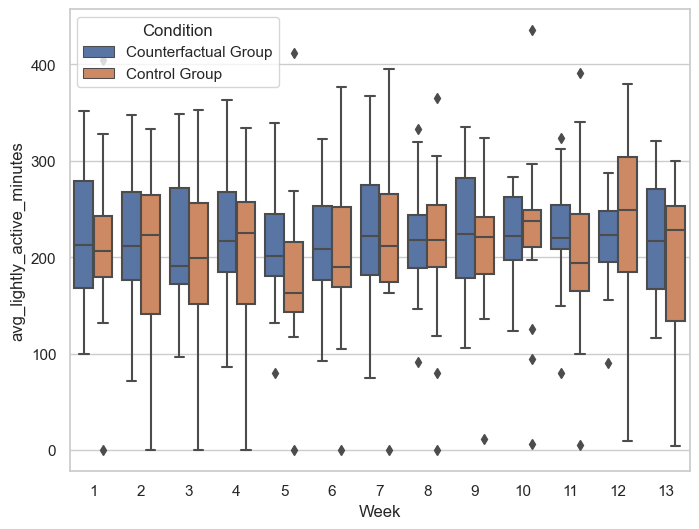

Significant Results found for avg_lightly_active_minutes:

                                Mixed Linear Model Regression Results
Model:                       MixedLM          Dependent Variable:          avg_lightly_active_minutes
No. Observations:            467              Method:                      ML                        
No. Groups:                  37               Scale:                       1604.7321                 
Min. group size:             10               Log-Likelihood:              -2444.9081                
Max. group size:             13               Converged:                   Yes                       
Mean group size:             12.6                                                                    
-----------------------------------------------------------------------------------------------------
                                                         Coef.   Std.Err.   z    P>|z|  [0.025 0.975]
-------------------------------------------------------

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/3127634739.py:141: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{activity_col}', hue='Condition', data=df_activity, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed

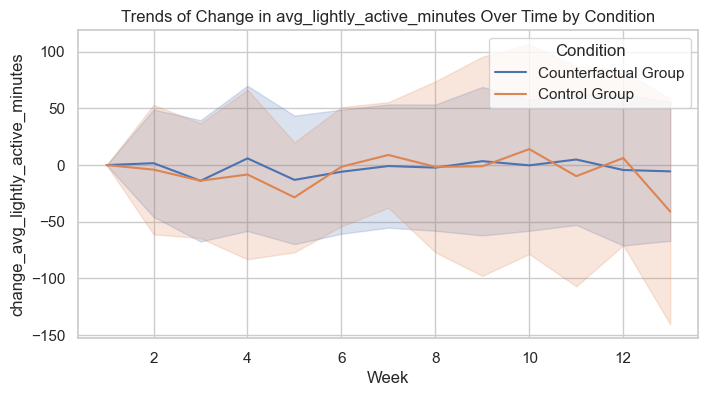

Week 5 Different to Base for Control: p-value = 0.0198


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

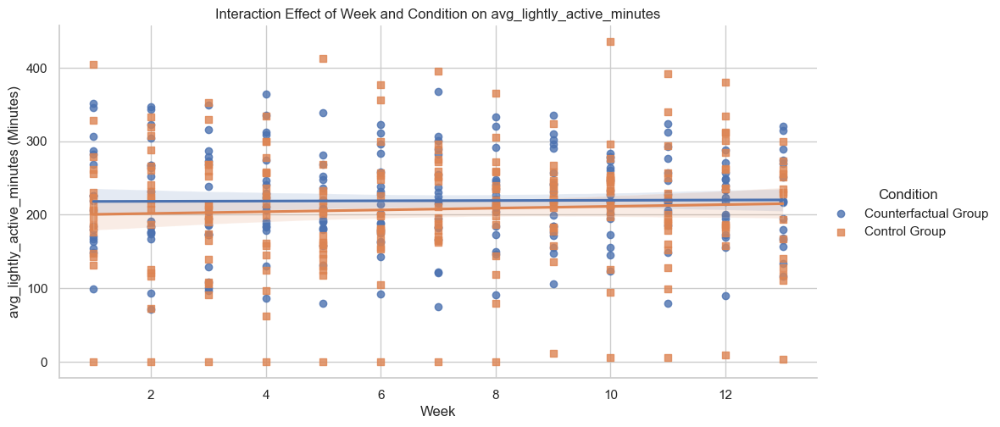

        Source      F  p-unc    ng2
0    Condition  0.616  0.440  0.015
1         Week  1.374  0.177  0.020
2  Interaction  1.240  0.255  0.018


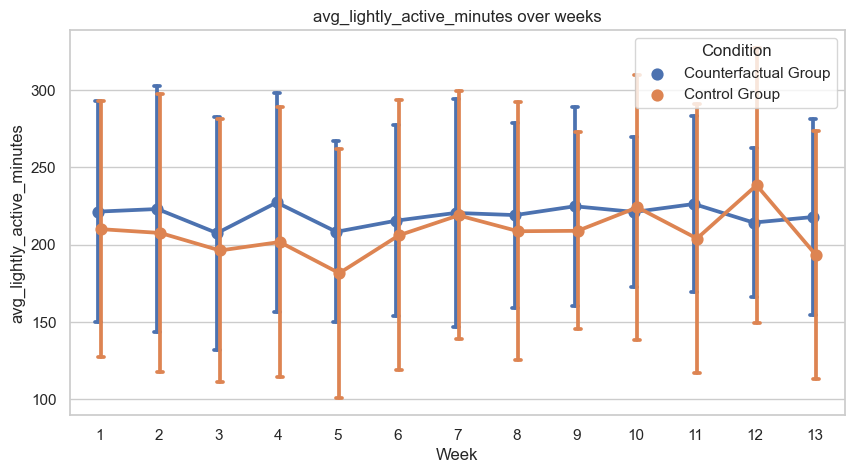


 avg_fairly_active_minutes

Experimental Group Mean (Std) Activity by Week:
Week 2: 16.71 (16.00)
Week 3: 11.48 (9.12)
Week 4: 17.25 (17.53)
Week 5: 16.31 (12.50)
Week 6: 15.94 (12.24)
Week 7: 16.92 (15.54)
Week 8: 15.52 (11.14)
Week 9: 18.78 (16.09)
Week 10: 12.54 (10.75)
Week 11: 13.71 (10.34)
Week 12: 12.95 (12.42)
Week 13: 11.59 (8.65)
Week 14: nan (nan)

Control Group Mean (Std) Activity by Week:
Week 2: 11.05 (11.48)
Week 3: 13.09 (12.11)
Week 4: 11.61 (10.62)
Week 5: 11.57 (9.61)
Week 6: 13.30 (15.60)
Week 7: 12.88 (12.53)
Week 8: 13.42 (11.14)
Week 9: 16.92 (13.30)
Week 10: 17.91 (13.71)
Week 11: 14.34 (12.62)
Week 12: 16.52 (18.97)
Week 13: 12.37 (12.70)
Week 14: nan (nan)

T-test Mean Difference over all Weeks:
T-statistic: 1.2874
P-value: 0.2114


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(


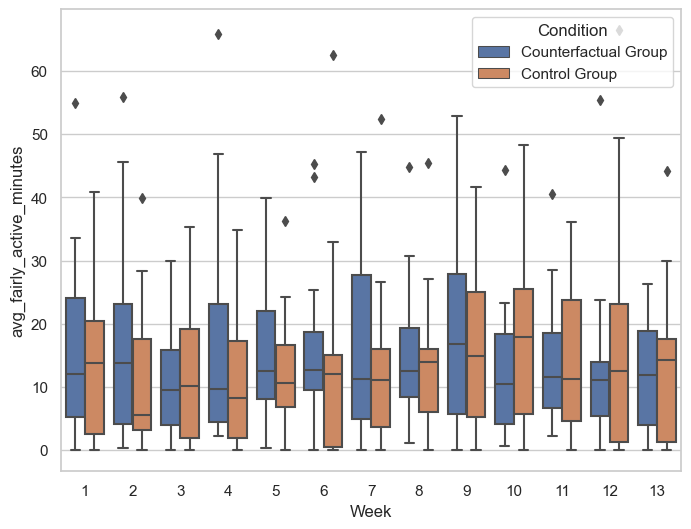

Significant Results found for avg_fairly_active_minutes:

                              Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_fairly_active_minutes
No. Observations:           467             Method:                     ML                       
No. Groups:                 37              Scale:                      88.0701                  
Min. group size:            10              Log-Likelihood:             -1732.9194               
Max. group size:            13              Converged:                  Yes                      
Mean group size:            12.6                                                                 
-------------------------------------------------------------------------------------------------
                                                       Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------------------

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/3127634739.py:141: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{activity_col}', hue='Condition', data=df_activity, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed

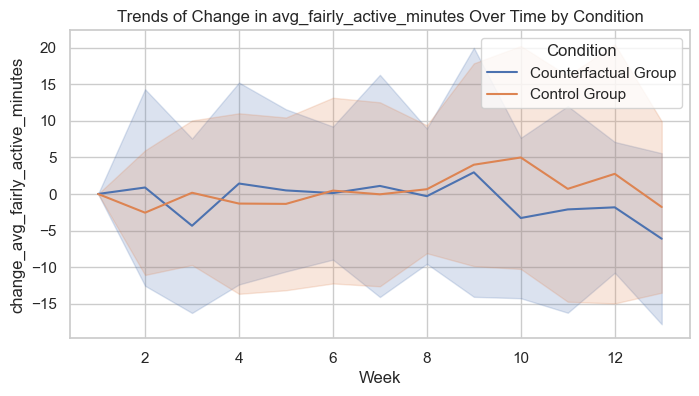

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

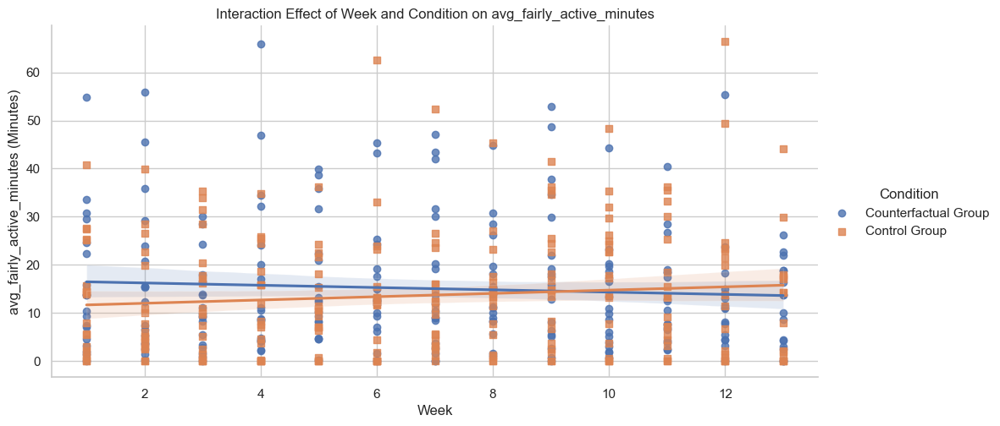

        Source      F  p-unc    ng2
0    Condition  0.014  0.905  0.000
1         Week  0.921  0.526  0.020
2  Interaction  0.669  0.781  0.015


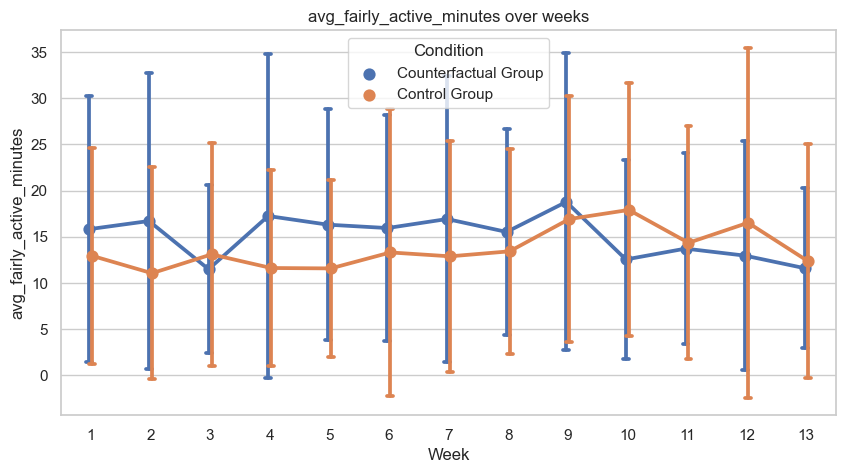


 avg_very_active_minutes

Experimental Group Mean (Std) Activity by Week:
Week 2: 16.30 (15.90)
Week 3: 14.57 (16.93)
Week 4: 17.30 (19.04)
Week 5: 18.52 (18.83)
Week 6: 16.78 (15.99)
Week 7: 16.81 (14.49)
Week 8: 17.55 (16.40)
Week 9: 15.12 (11.31)
Week 10: 12.13 (10.51)
Week 11: 13.74 (11.58)
Week 12: 13.73 (17.32)
Week 13: 13.20 (12.44)
Week 14: nan (nan)

Control Group Mean (Std) Activity by Week:
Week 2: 9.80 (11.53)
Week 3: 17.23 (23.76)
Week 4: 11.10 (13.61)
Week 5: 10.33 (14.30)
Week 6: 11.65 (14.47)
Week 7: 15.09 (28.55)
Week 8: 15.54 (32.33)
Week 9: 15.32 (28.28)
Week 10: 15.60 (21.61)
Week 11: 10.55 (12.38)
Week 12: 12.11 (15.97)
Week 13: 9.48 (20.53)
Week 14: nan (nan)

T-test Mean Difference over all Weeks:
T-statistic: 2.7165
P-value: 0.0132


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(


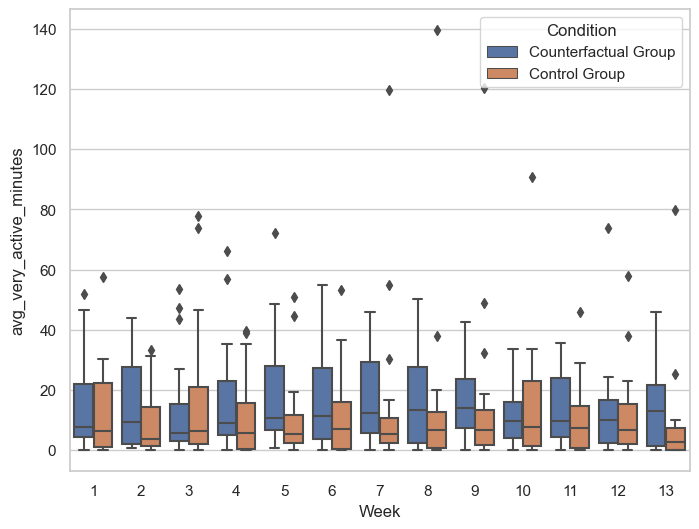

Significant Results found for avg_very_active_minutes:

                             Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_very_active_minutes
No. Observations:           467             Method:                     ML                     
No. Groups:                 37              Scale:                      91.5054                
Min. group size:            10              Log-Likelihood:             -1755.2867             
Max. group size:            13              Converged:                  Yes                    
Mean group size:            12.6                                                               
-----------------------------------------------------------------------------------------------
                                                     Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------------------------------
Intercept    

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/3127634739.py:141: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{activity_col}', hue='Condition', data=df_activity, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed

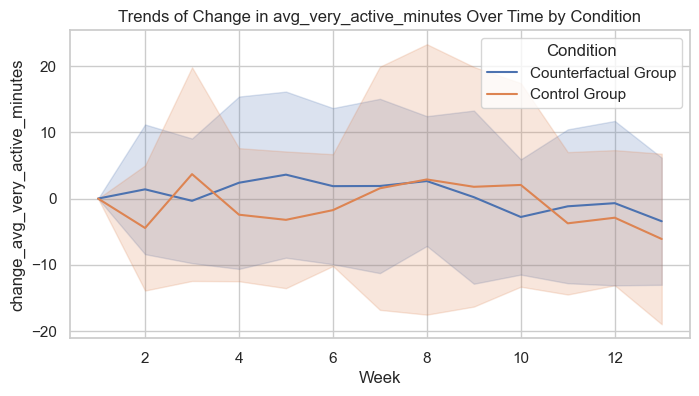

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

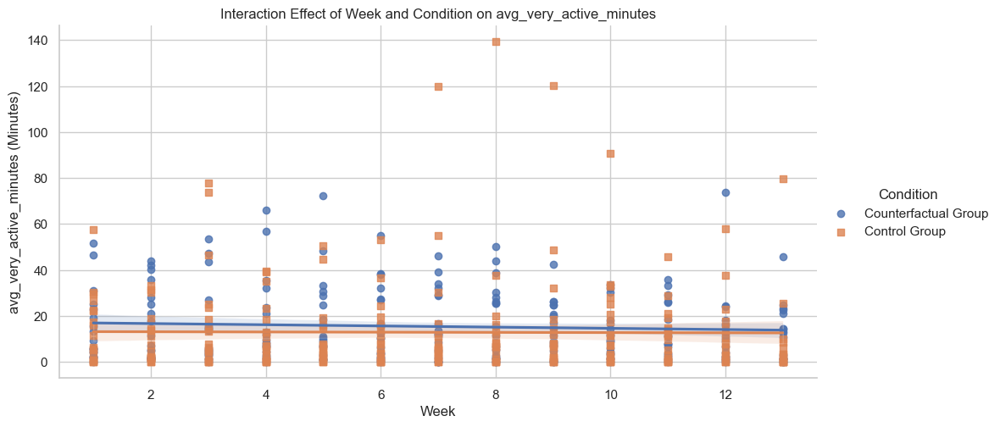

        Source      F  p-unc    ng2
0    Condition  0.000  0.994  0.000
1         Week  1.108  0.353  0.011
2  Interaction  1.288  0.225  0.012


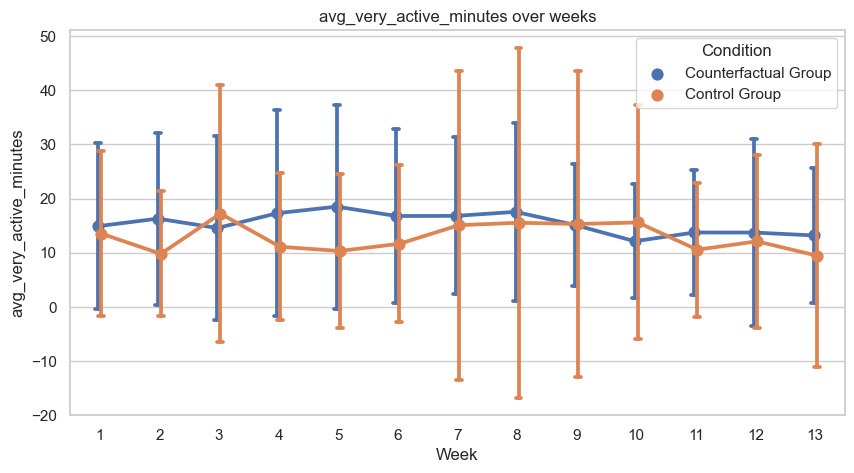


 avg_active_minutes

Experimental Group Mean (Std) Activity by Week:
Week 2: 33.01 (29.38)
Week 3: 26.05 (24.27)
Week 4: 34.55 (34.83)
Week 5: 34.83 (29.77)
Week 6: 32.73 (24.81)
Week 7: 33.73 (27.57)
Week 8: 33.07 (26.44)
Week 9: 33.90 (24.80)
Week 10: 24.67 (18.57)
Week 11: 27.45 (17.97)
Week 12: 26.68 (29.25)
Week 13: 24.79 (18.63)
Week 14: nan (nan)

Control Group Mean (Std) Activity by Week:
Week 2: 20.84 (21.40)
Week 3: 30.32 (32.49)
Week 4: 22.72 (21.21)
Week 5: 21.90 (20.02)
Week 6: 24.95 (25.51)
Week 7: 27.97 (37.81)
Week 8: 28.96 (39.32)
Week 9: 32.24 (35.93)
Week 10: 33.50 (30.16)
Week 11: 24.90 (22.47)
Week 12: 28.62 (28.79)
Week 13: 21.85 (27.33)
Week 14: nan (nan)

T-test Mean Difference over all Weeks:
T-statistic: 2.2679
P-value: 0.0335


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:1635: UserWarning: Random effects covariance is singular
  warnings.warn(msg)


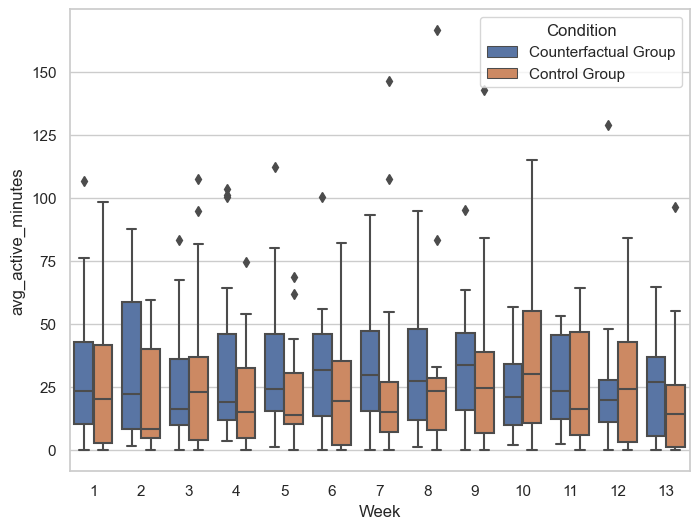

Significant Results found for avg_active_minutes:

                           Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_active_minutes
No. Observations:          467              Method:                      ML                
No. Groups:                37               Scale:                       272.3730          
Min. group size:           10               Log-Likelihood:              -1997.7885        
Max. group size:           13               Converged:                   Yes               
Mean group size:           12.6                                                            
-------------------------------------------------------------------------------------------
                                                Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
-------------------------------------------------------------------------------------------
Intercept                                       10.200  

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/3127634739.py:141: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{activity_col}', hue='Condition', data=df_activity, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed

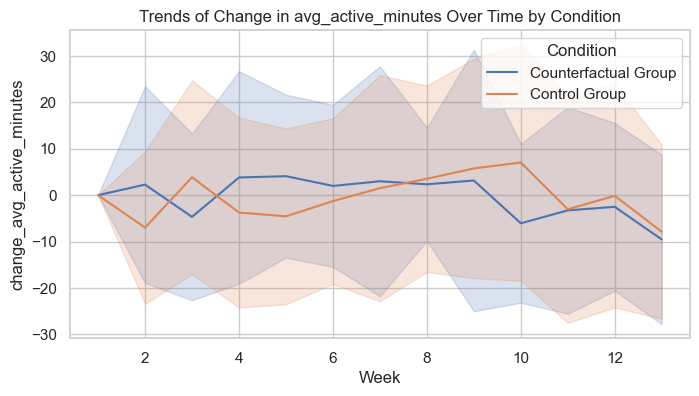

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

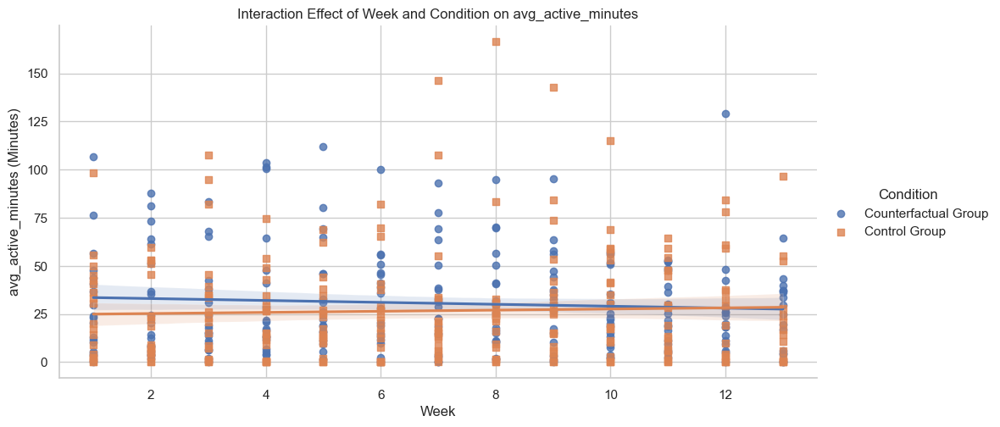

        Source      F  p-unc    ng2
0    Condition  0.002  0.961  0.000
1         Week  1.073  0.382  0.014
2  Interaction  1.023  0.428  0.014


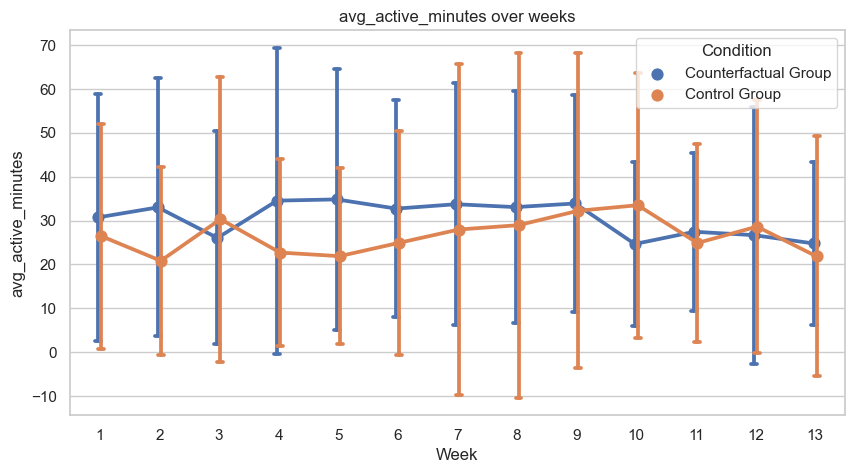


 avg_total_active_minutes

Experimental Group Mean (Std) Activity by Week:
Week 2: 256.10 (87.12)
Week 3: 233.56 (78.89)
Week 4: 261.87 (83.94)
Week 5: 243.17 (69.56)
Week 6: 248.25 (75.69)
Week 7: 254.29 (92.96)
Week 8: 252.23 (74.96)
Week 9: 258.76 (77.36)
Week 10: 245.84 (52.50)
Week 11: 253.78 (66.49)
Week 12: 241.00 (54.66)
Week 13: 242.72 (70.28)
Week 14: nan (nan)

Control Group Mean (Std) Activity by Week:
Week 2: 228.43 (93.78)
Week 3: 226.59 (86.45)
Week 4: 224.46 (91.61)
Week 5: 203.51 (89.21)
Week 6: 231.03 (96.79)
Week 7: 246.96 (93.57)
Week 8: 237.68 (97.62)
Week 9: 241.23 (77.69)
Week 10: 257.66 (95.00)
Week 11: 228.91 (97.63)
Week 12: 267.11 (97.28)
Week 13: 214.99 (89.78)
Week 14: nan (nan)

T-test Mean Difference over all Weeks:
T-statistic: 2.7201
P-value: 0.0153


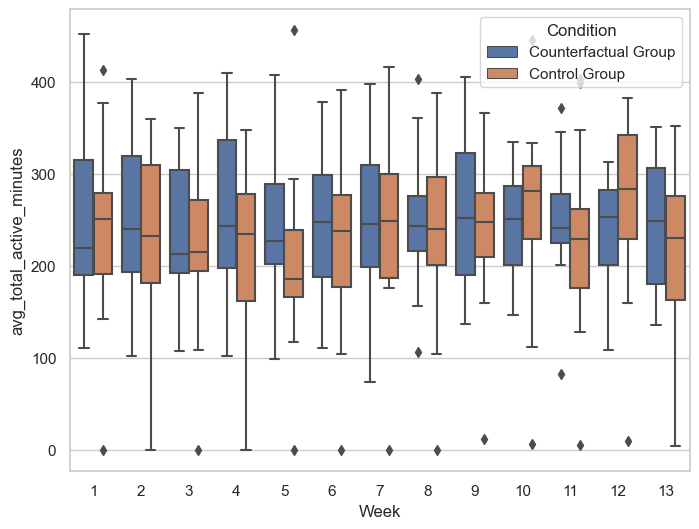

Significant Results found for avg_total_active_minutes:

                               Mixed Linear Model Regression Results
Model:                      MixedLM           Dependent Variable:           avg_total_active_minutes
No. Observations:           467               Method:                       ML                      
No. Groups:                 37                Scale:                        2184.7739               
Min. group size:            10                Log-Likelihood:               -2513.4692              
Max. group size:            13                Converged:                    Yes                     
Mean group size:            12.6                                                                    
----------------------------------------------------------------------------------------------------
                                                       Coef.   Std.Err.   z    P>|z|  [0.025  0.975]
------------------------------------------------------------------

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/3127634739.py:141: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{activity_col}', hue='Condition', data=df_activity, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed

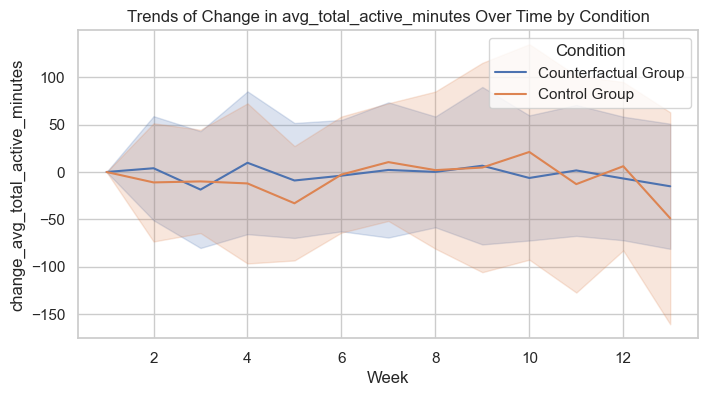

Week 5 Different to Base for Control: p-value = 0.0282


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

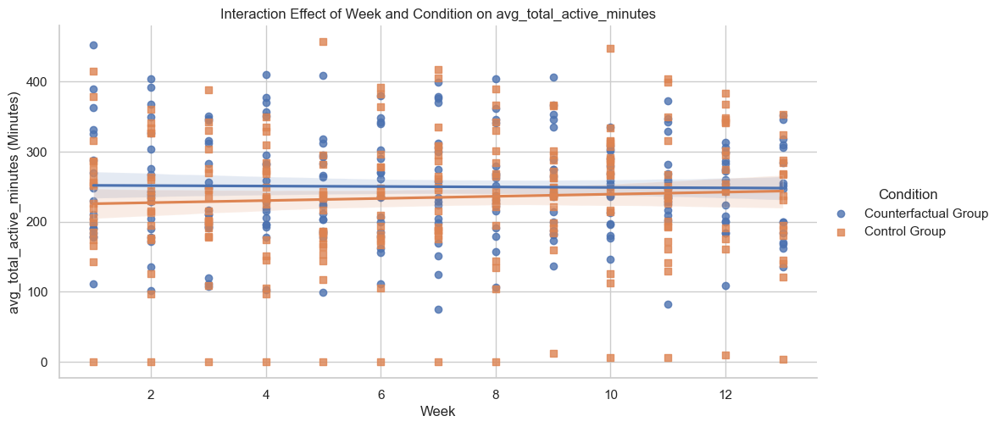

        Source      F  p-unc    ng2
0    Condition  0.559  0.462  0.013
1         Week  1.175  0.300  0.019
2  Interaction  1.376  0.176  0.022


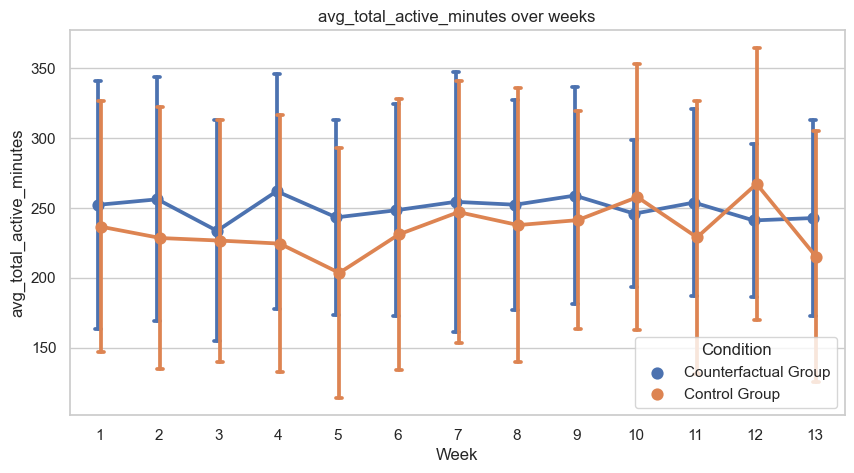


 avg_act_calories

Experimental Group Mean (Std) Activity by Week:
Week 2: 1089.39 (490.73)
Week 3: 967.85 (408.50)
Week 4: 1091.69 (437.92)
Week 5: 1027.60 (432.50)
Week 6: 1043.73 (425.52)
Week 7: 1050.61 (459.32)
Week 8: 1040.37 (460.81)
Week 9: 1026.37 (368.64)
Week 10: 986.94 (334.02)
Week 11: 999.80 (363.52)
Week 12: 957.70 (362.76)
Week 13: 976.62 (387.64)
Week 14: nan (nan)

Control Group Mean (Std) Activity by Week:
Week 2: 888.66 (387.68)
Week 3: 923.06 (405.32)
Week 4: 878.51 (414.76)
Week 5: 788.74 (370.63)
Week 6: 892.49 (410.47)
Week 7: 984.91 (509.88)
Week 8: 954.48 (533.73)
Week 9: 973.21 (468.72)
Week 10: 1045.05 (502.01)
Week 11: 924.00 (520.64)
Week 12: 1049.96 (494.82)
Week 13: 849.70 (485.29)
Week 14: nan (nan)

T-test Mean Difference over all Weeks:
T-statistic: 3.5839
P-value: 0.0022


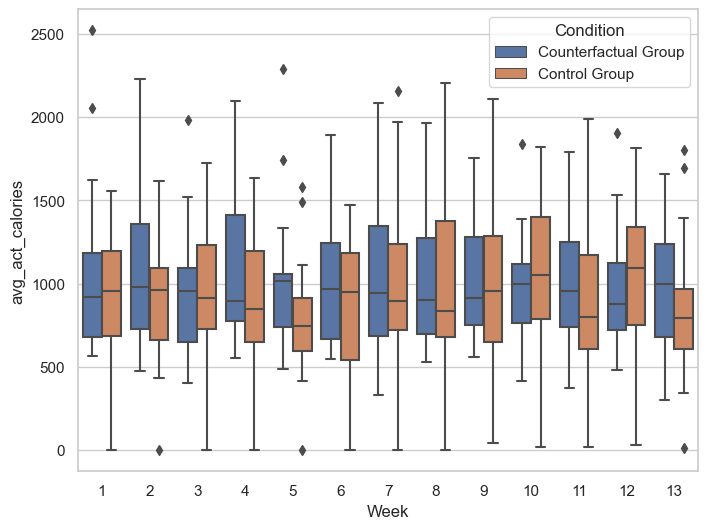

Significant Results found for avg_act_calories:

                            Mixed Linear Model Regression Results
Model:                        MixedLM           Dependent Variable:           avg_act_calories
No. Observations:             467               Method:                       ML              
No. Groups:                   37                Scale:                        46900.6811      
Min. group size:              10                Log-Likelihood:               -3229.9055      
Max. group size:              13                Converged:                    Yes             
Mean group size:              12.6                                                            
----------------------------------------------------------------------------------------------
                                                Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
----------------------------------------------------------------------------------------------
Intercept                     

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/3127634739.py:141: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{activity_col}', hue='Condition', data=df_activity, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed

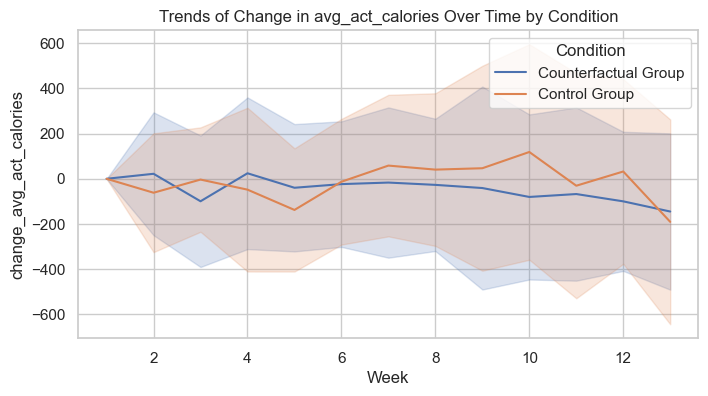

Week 5 Diference between CF & Control Groups: p-value = 0.0810
Week 5 Different to Base for Control: p-value = 0.0407


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

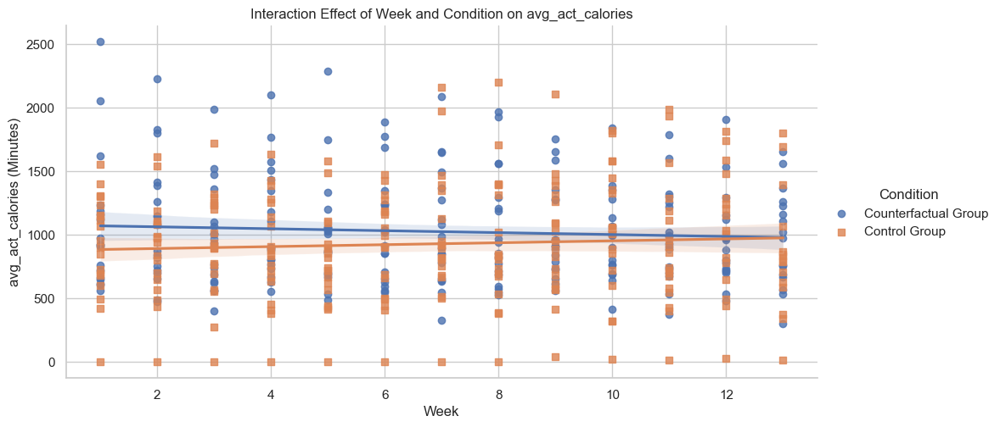

        Source      F  p-unc    ng2
0    Condition  0.011  0.917  0.000
1         Week  0.889  0.559  0.011
2  Interaction  1.617  0.086  0.020


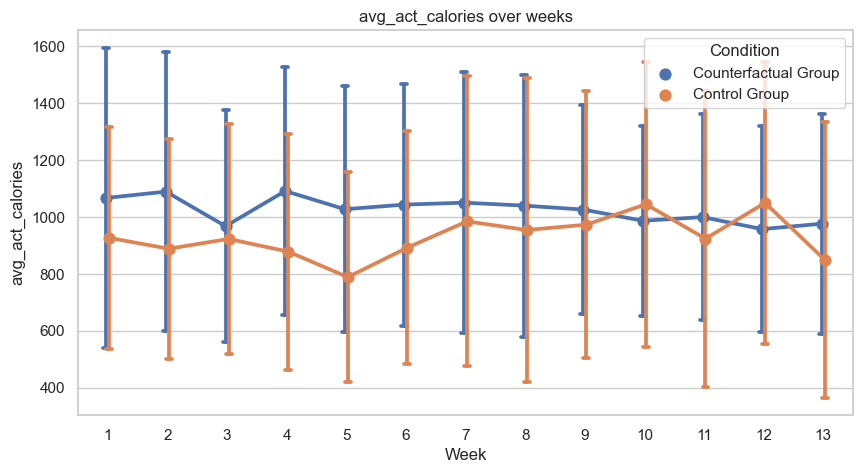


 avg_calories

Experimental Group Mean (Std) Activity by Week:
Week 2: 2525.31 (597.17)
Week 3: 2433.48 (532.82)
Week 4: 2493.56 (522.61)
Week 5: 2454.86 (551.51)
Week 6: 2466.33 (532.38)
Week 7: 2469.81 (518.99)
Week 8: 2423.66 (615.48)
Week 9: 2405.09 (540.60)
Week 10: 2370.12 (556.46)
Week 11: 2370.77 (546.04)
Week 12: 2352.08 (567.82)
Week 13: 2367.37 (600.30)
Week 14: nan (nan)

Control Group Mean (Std) Activity by Week:
Week 2: 2312.15 (427.81)
Week 3: 2329.44 (498.94)
Week 4: 2292.85 (470.38)
Week 5: 2224.27 (436.82)
Week 6: 2287.54 (472.26)
Week 7: 2385.78 (568.96)
Week 8: 2381.52 (606.61)
Week 9: 2346.93 (616.68)
Week 10: 2371.44 (617.16)
Week 11: 2331.30 (658.12)
Week 12: 2397.18 (634.94)
Week 13: 2241.55 (571.69)
Week 14: nan (nan)

T-test Mean Difference over all Weeks:
T-statistic: 4.4898
P-value: 0.0002


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(


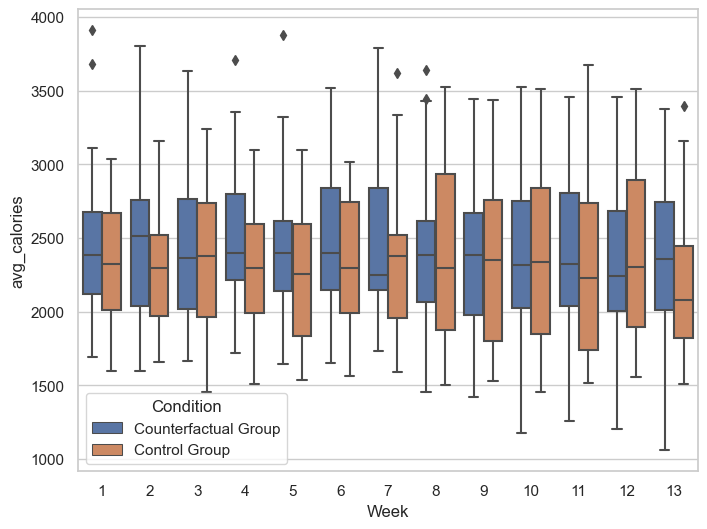

Significant Results found for avg_calories:

                          Mixed Linear Model Regression Results
Model:                        MixedLM           Dependent Variable:           avg_calories
No. Observations:             467               Method:                       ML          
No. Groups:                   37                Scale:                        29453.6169  
Min. group size:              10                Log-Likelihood:               -3134.8816  
Max. group size:              13                Converged:                    Yes         
Mean group size:              12.6                                                        
------------------------------------------------------------------------------------------
                                            Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
------------------------------------------------------------------------------------------
Intercept                                   262.291  148.700  1.764 0.07

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/3127634739.py:141: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{activity_col}', hue='Condition', data=df_activity, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed

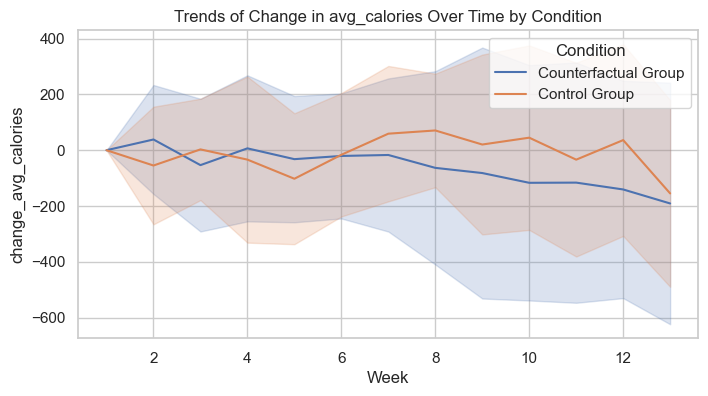

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

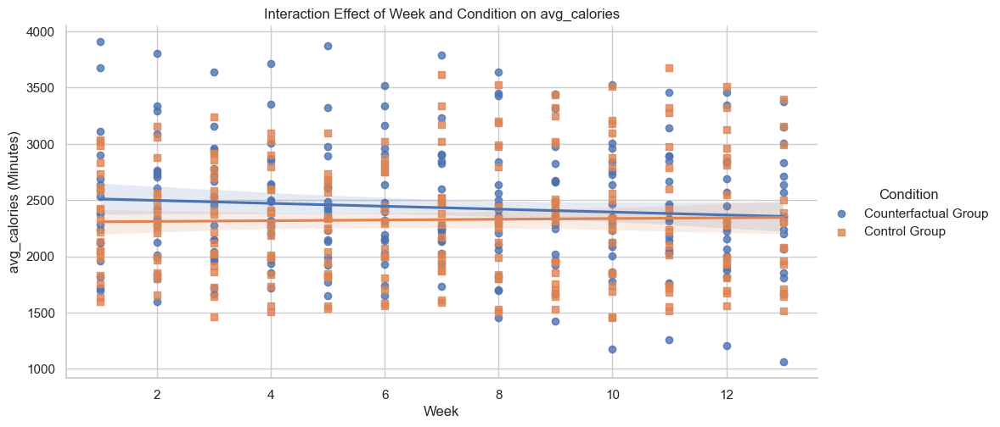

        Source      F  p-unc    ng2
0    Condition  0.069  0.795  0.002
1         Week  0.949  0.498  0.005
2  Interaction  2.194  0.012  0.012


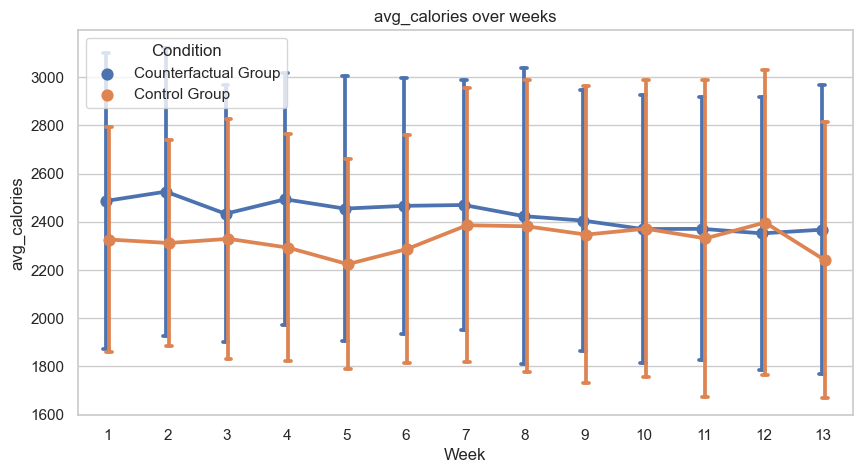


 avg_steps

Experimental Group Mean (Std) Activity by Week:
Week 2: 7426.57 (3097.54)
Week 3: 7000.63 (2932.32)
Week 4: 7513.21 (3189.55)
Week 5: 7281.62 (2984.47)
Week 6: 7393.27 (3390.44)
Week 7: 7529.74 (3736.85)
Week 8: 7459.83 (3097.87)
Week 9: 7358.89 (2573.42)
Week 10: 6911.97 (2041.36)
Week 11: 6929.61 (2375.41)
Week 12: 6877.90 (2785.22)
Week 13: 6948.40 (2648.54)
Week 14: nan (nan)

Control Group Mean (Std) Activity by Week:
Week 2: 6886.66 (2242.21)
Week 3: 7224.64 (2513.14)
Week 4: 6705.43 (2401.48)
Week 5: 6288.87 (2447.68)
Week 6: 7151.35 (3124.71)
Week 7: 8098.25 (4118.31)
Week 8: 7894.70 (4530.27)
Week 9: 7406.04 (4500.63)
Week 10: 7368.48 (3978.79)
Week 11: 6883.72 (3774.87)
Week 12: 8349.73 (4105.35)
Week 13: 6345.95 (3903.77)
Week 14: nan (nan)

T-test Mean Difference over all Weeks:
T-statistic: 0.0114
P-value: 0.9910


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(


In [101]:
# Function to check significant interaction in the mixed-effects model
def check_significant_interaction(model):
    # Check if the p-value for the interaction term (Week:Condition) is significant
    for param, pvalue in model.pvalues.items():
        if "Condition" in param and pvalue <= 0.1:
            return True
    return False

def run_spearman_correlation(df, col1, col2):
    corr, p_value = spearmanr(df[col1], df[col2])
    return corr, p_value

def run_linear_regression(df, X_cols, y_col):
    X = df[X_cols]
    y = df[y_col]
    X = sm.add_constant(X)
    model = sm.OLS(y, X).fit()
    return model

######### Hypothesis 1: Longitudinal Analysis of Physical Activity Metrics over the interview weeks
#'Weekly_Active_Minute_average','Weekly_Light_Minute_average','Weekly_Active_Calories_burned_average',
main_activity_columns = ['avg_lightly_active_minutes','avg_fairly_active_minutes','avg_very_active_minutes','avg_active_minutes','avg_total_active_minutes','avg_act_calories','avg_calories','avg_steps']

secondary_activity_column = ['firstday_total_active_minutes', 'avg2days_total_active_minutes','avg3days_total_active_minutes', 'highavg_total_active_minutes',
'highestavg_total_active_minutes', 'lastday_total_active_minutes','max_active_total_minutes', 'max2days_total_active_minutes',
'max3days_total_active_minutes', 
'firstday_active_minutes','avg2days_active_minutes', 'avg3days_active_minutes','highavg_active_minutes', 'highestavg_active_minutes',
'lastday_active_minutes', 'max_active_minutes','max2days_active_minutes', 'max3days_active_minutes',
'firstday_minutes_lightly_active', 'avg2days_minutes_lightly_active','avg3days_minutes_lightly_active', 'highavg_lightly_active',
'highestavg_lightly_active', 'lastday_minutes_lightly_active','max_minutes_lightly_active', 'max2days_minutes_lightly_active',
'max3days_minutes_lightly_active',
'avg_lightly_active_minutes','avg_fairly_active_minutes','avg_very_active_minutes',
'avg_active_minutes','avg_total_active_minutes','avg_minutes_lightly_active','avg_steps', 'avg_act_calories','avg_calories',
'firstday_steps', 'avg2days_steps','avg3days_steps', 'highavg_steps', 'highestavg_steps', 'lastday_steps','max_steps', 'max2days_steps', 'max3days_steps']

df_physical_activity = df[['Participant_ID', 'Week', 'Condition','BMI']+ main_activity_columns][df['Week']<15]

for activity_col in main_activity_columns:
    df_activity = df_physical_activity[['Participant_ID', 'Week', 'Condition','BMI', activity_col]]
    
    df_activity_baseline = df_activity[df_activity['Week'] == 1][['Participant_ID', activity_col]].rename(columns={activity_col: 'baseline_' + activity_col})
    # Merge baseline with the main dataframe
    df_activity = df_activity.merge(df_activity_baseline, on='Participant_ID')
    df_activity[f'change_{activity_col}'] = df_activity[activity_col] - df_activity[f'baseline_{activity_col}']

    metric_col = activity_col
    change_col = f'change_{activity_col}'
    print( '\n', metric_col)

    experimental_group = df_activity[df_activity['Condition'] == 1]
    control_group = df_activity[df_activity['Condition'] == 2]
    
    # Group by 'Week' and calculate the mean activity for each group
    mean_experimental = experimental_group[experimental_group['Week']>1].groupby('Week')[activity_col].mean()
    mean_control = control_group[control_group['Week']>1].groupby('Week')[activity_col].mean()

    # Perform an independent t-test to compare the means of the two groups
    # Drop any NaN values if necessary (in case there are weeks with missing data)
    t_stat_weekly, p_value_weekly = ttest_ind(mean_experimental.dropna(), mean_control.dropna(), equal_var=False)

    # Calculate mean and standard deviation for each week 
    experimental_stats = experimental_group[experimental_group['Week']>1].groupby('Week')[activity_col].agg(['mean', 'std'])
    control_stats = control_group[control_group['Week']>1].groupby('Week')[activity_col].agg(['mean', 'std'])

    # Print the mean and std for the experimental group in the format: mean (std)
    print("\nExperimental Group Mean (Std) Activity by Week:")
    for week, row in experimental_stats.iterrows():
        print(f"Week {week}: {row['mean']:.2f} ({row['std']:.2f})")

    # Print the mean and std for the control group in the format: mean (std)
    print("\nControl Group Mean (Std) Activity by Week:")
    for week, row in control_stats.iterrows():
        print(f"Week {week}: {row['mean']:.2f} ({row['std']:.2f})")

    print(f"\nT-test Mean Difference over all Weeks:")
    print(f"T-statistic: {t_stat_weekly:.4f}")
    print(f"P-value: {p_value_weekly:.4f}")

    baseline_experimental = experimental_group[activity_col][experimental_group['Week'] == 1]
    baseline_control = control_group[activity_col][control_group['Week'] == 1]
#     week2_experimental = experimental_group[f'change_{activity_col}'][experimental_group['Week'] == 2]
#     week2_control = control_group[f'change_{activity_col}'][control_group['Week'] == 2]
    
#     week7_experimental = experimental_group[f'change_{activity_col}'][experimental_group['Week'] == 7]
#     week7_control = control_group[f'change_{activity_col}'][control_group['Week'] == 7]
#     week13_experimental = experimental_group[f'change_{activity_col}'][experimental_group['Week'] == 13]
#     week13_control = control_group[f'change_{activity_col}'][control_group['Week'] == 13]
    
    # Perform t-test for each week
    t_stats_groups = []
    p_values_groups = []
    t_stats_prepost_experimental, p_values_prepost_experimental = [], []
    t_stats_prepost_control, p_values_prepost_control = [], []
    for week in range(1, 14):  # Weeks 1 to 13
        exp_week_data = experimental_group[experimental_group['Week'] == week][activity_col]
        ctrl_week_data = control_group[control_group['Week'] == week][activity_col]
        if week != 1 :
            t_stat_prepost, p_value_prepost = ttest_rel(baseline_experimental, exp_week_data, nan_policy='omit')
            t_stats_prepost_experimental.append(t_stat_prepost)
            p_values_prepost_experimental.append(p_value_prepost)
            
        if week != 1 :
            t_stat_prepost, p_value_prepost = ttest_rel(baseline_control, ctrl_week_data, nan_policy='omit')
            t_stats_prepost_control.append(t_stat_prepost)
            p_values_prepost_control.append(p_value_prepost)
            
        if len(exp_week_data) > 0 and len(ctrl_week_data) > 0:
            t_stat_groups, p_value_groups = ttest_ind(exp_week_data, ctrl_week_data, equal_var=False, nan_policy='omit')
            t_stats_groups.append(t_stat_groups)
            p_values_groups.append(p_value_groups)
    df_activity = df_activity.dropna(subset=[activity_col]).reset_index(drop=True) #[['Participant_ID', 'Week', 'Condition','age','BMI', activity_col]]

    fixed_effects=[ 'Week','Condition']
    random_effect_col='Participant_ID'
    df_activity['Condition'] = df_activity['Condition'].astype('category')

    formula = f"{activity_col} ~ {' * '.join(fixed_effects)}"
    formula = f"{activity_col} ~  Condition + Week +BMI+ {'baseline_' + activity_col} + Week:Condition + Week:Condition:{'baseline_' + activity_col}+Week:Condition:BMI"  #+ Week:Condition:{'baseline_' + activity_col}
    model = smf.mixedlm(formula, df_activity, groups=df_activity[random_effect_col], re_formula="~Week").fit(reml=False) #reml=False

    if check_significant_interaction(model) and p_value_weekly<=0.4:
        plt.figure(figsize=(8,6))
        df_activity['Condition'] = df_activity['Condition'].map({1: 'Counterfactual Group', 2: 'Control Group'})
        sns.boxplot(x='Week', y=activity_col, 
                    hue='Condition', data=df_activity)
        plt.show()
        print(f"Significant Results found for {activity_col}:\n")
        print(model.summary())
#         coef_table = model.summary2().tables[1]
#         print(coef_table)
        print(f"AIC: {model.aic}")
        # Likelihood Ratio Test (for model comparison if needed)
        # Fit another model (e.g., without random slope for comparison)
        null_model = smf.mixedlm(f"{activity_col} ~ Condition + Week + BMI+{'baseline_' + activity_col} + Week:Condition + Week:Condition:{'baseline_' + activity_col}+Week:Condition:BMI", df_activity, groups=df_activity[random_effect_col], re_formula="1").fit(reml=False)
        lr_stat = -2 * (null_model.llf - model.llf)
        p_value = stats.chi2.sf(lr_stat, df=1)  # degrees of freedom = 1 if comparing two models
        print(f"Likelihood Ratio Test Stat: {lr_stat}, p-value: {p_value}")

        sns.set(style="whitegrid")
        plt.figure(figsize=(8, 4))
        sns.lineplot(x='Week', y=f'change_{activity_col}', hue='Condition', data=df_activity, ci="sd")
        plt.title(f'Trends of Change in {activity_col} Over Time by Condition')
        plt.xlabel('Week')
        plt.ylabel(f'change_{activity_col}')
        plt.show()

            # Weeks with significant CF Control Differences
        for week, p_value in enumerate(p_values_groups, start=1):
            if p_value < 0.1:
                print(f'Week {week} Diference between CF & Control Groups: p-value = {p_value:.4f}')
                
            # Weeks with significant Pre Post Differences for CF Group
        for week, p_value in enumerate(p_values_prepost_experimental, start=2):
            if p_value < 0.05:
                print(f'Week {week} Different to Base for Experimental: p-value = {p_value:.4f}')
            # Weeks with significant Pre Post Differences for Control Group
        for week, p_value in enumerate(p_values_prepost_control, start=2):
            if p_value < 0.05:
                print(f'Week {week} Different to Base for Control: p-value = {p_value:.4f}')

        # Interaction plot
        plt.figure(figsize=(10, 5))
        sns.lmplot(x='Week', y=activity_col, hue='Condition', data=df_activity, aspect=2, markers=["o", "s"])
        plt.title(f'Interaction Effect of Week and Condition on {activity_col}')
        plt.xlabel('Week')
        plt.ylabel(f'{activity_col} (Minutes)')
        plt.show()

        # Fit repeated measures ANOVA
        rm_anova = pg.mixed_anova(dv=activity_col, 
                               within='Week', 
                               subject='Participant_ID', 
                               between='Condition', 
                               data=df_activity, effsize='ng2')
        # Filter the rm_anova results to show only the relevant columns
        important_columns = ['Source', 'F', 'p-unc', 'ng2']  # Only show Source, F-value, p-value, and effect size (η²)
        print(rm_anova[important_columns].round(3))
        
        plt.figure(figsize=(10, 5))
        sns.pointplot(data=df_activity, x='Week', y=activity_col, hue='Condition', dodge=True, capsize=.1, errorbar='sd')
        _ = plt.title(f'{activity_col} over weeks')
        plt.show()


In [100]:
for activity_col in main_activity_columns:
    df_activity = df_physical_activity[['Participant_ID', 'Week', 'Condition','BMI', activity_col]]
    print( '\n', activity_col)
    
    df_activity_baseline = df_activity[df_activity['Week'] == 1][['Participant_ID', activity_col]].rename(columns={activity_col: 'baseline_' + activity_col})
    # Merge baseline with the main dataframe
    df_activity = df_activity.merge(df_activity_baseline, on='Participant_ID')
    df_activity[f'change_{activity_col}'] = df_activity[activity_col] - df_activity[f'baseline_{activity_col}']
    baseline_activity_col = 'baseline_' + activity_col

    df_activity = df_activity.dropna(subset=[activity_col]).reset_index(drop=True) #[['Participant_ID', 'Week', 'Condition','age','BMI', activity_col]]
#     df_activity = df_activity.groupby('Participant_ID').filter(lambda x: x['Week'].notnull().sum() > 11)

    fixed_effects=[ 'Week','Condition']
    random_effect_col='Participant_ID'
    df_activity['Condition'] = df_activity['Condition'].astype('category')

    formula = f"{activity_col} ~ {' * '.join(fixed_effects)}"
    formula1 = f"{activity_col} ~ {baseline_activity_col} + Week + Condition+BMI"
    formula2 = f"{activity_col} ~ {baseline_activity_col} + Week + Condition+BMI + Week:Condition"
    formula3 = f"{activity_col} ~ {baseline_activity_col} + Week + Condition+BMI + Week:Condition:BMI"
    formula4 = f"{activity_col} ~ {baseline_activity_col} +Condition + Week +BMI+ Week:Condition + Week:Condition:{baseline_activity_col}" 
    formula = f"{activity_col} ~  {baseline_activity_col} + Condition + Week+BMI + Week:Condition + Week:Condition:{baseline_activity_col} +Week:Condition:BMI"  #+ Week:Condition:{'baseline_' + activity_col}
    
    model = smf.mixedlm(formula, df_activity, groups=df_activity[random_effect_col], re_formula="~Week").fit(reml=False)
    print(f"Main Model AIC: {model.aic}")
    log_likelihood = model.llf  # Log-likelihood
    k = len(model.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
#     print(f"Manual AIC: {aic_manual}")
    print(f"Main Model BIC: {model.bic}")
    print("Main Model Converged:", model.converged)

    model_ = smf.mixedlm(formula, df_activity, groups=df_activity[random_effect_col]).fit(reml=False)
    print(f"\n2 Model AIC: {model_.aic}")
    log_likelihood = model_.llf  # Log-likelihood
    k = len(model_.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
#     print(f"Manual AIC: {aic_manual}")
    print("2 Model Converged:", model_.converged)
    
    
    # Model 1: Random intercept
    model1 = smf.mixedlm(formula1, df_activity, groups=df_activity['Participant_ID'], re_formula="~Week").fit(reml=False)
    print(f"\nModel 1 AIC: {model1.aic}")
    log_likelihood = model1.llf  # Log-likelihood
    k = len(model1.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
#     print(f"Manual AIC: {aic_manual}")
    print(f"Model 1 BIC: {model1.bic}")
    print("Model Converged:", model1.converged)


    # Model 2: Random intercept + random slope for Week
    model2 = smf.mixedlm(formula2, df_activity, groups=df_activity['Participant_ID'], re_formula="~Week").fit(reml=False)
    print(f"\nModel 2 AIC: {model2.aic}")
    log_likelihood = model2.llf  # Log-likelihood
    k = len(model2.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
#     print(f"Manual AIC: {aic_manual}")
    print(f"Model 2 BIC: {model2.bic}")
    print("Model Converged:", model2.converged)


    # Model 3: Random intercept for participants + random intercept for baseline activity
    re_formula = f"~{baseline_activity_col}"
    model3 = smf.mixedlm(formula3, df_activity, groups=df_activity['Participant_ID'], re_formula="~Week").fit(reml=False)
    print(f"\nModel 3 AIC: {model3.aic}")
    log_likelihood = model3.llf  # Log-likelihood
    k = len(model3.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
#     print(f"Manual AIC: {aic_manual}")
    print(f"Model 3 BIC: {model3.bic}")
    print("Model Converged:", model3.converged)

    
    # Model 2: Random intercept + random slope for Week
    model4 = smf.mixedlm(formula4, df_activity, groups=df_activity['Participant_ID'], re_formula="~Week").fit(reml=False)
    print(f"\nModel 4 AIC: {model4.aic}")
    log_likelihood = model1.llf  # Log-likelihood
    k = len(model1.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
#     print(f"Manual AIC: {aic_manual}")
    print(f"Model 4 BIC: {model4.bic}")
    print("Model Converged:", model4.converged)


#     # Model 3: Random intercept for participants + random intercept for baseline activity
#     model3 = smf.mixedlm(formula3, df_activity, groups=df_activity['Participant_ID'], re_formula="~Week:Condition").fit(reml=True)
#     print(f"Model 3 AIC: {model3.aic}")
    
    
    best_model = min([model,model_, model1, model2, model3, model4], key=lambda x: x.aic)

    # Print the summary of the best model
    print(best_model.summary())




 avg_lightly_active_minutes
Main Model AIC: 4917.816141193561
Main Model BIC: 4975.864750800925
Main Model Converged: True

2 Model AIC: 4961.253381980254
2 Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 1 AIC: 4930.5521542707
Model 1 BIC: 4967.86911758972
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 2 AIC: 4932.434691894681
Model 2 BIC: 4973.89798447137
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 3 AIC: 4932.217467353151
Model 3 BIC: 4977.827089187509
Model Converged: True

Model 4 AIC: 4922.479054704606
Model 4 BIC: 4972.235005796632
Model Converged: True
                                Mixed Linear Model Regression Results
Model:                       MixedLM          Dependent Variable:          avg_lightly_active_minutes
No. Observations:            467              Method:                      ML                        
No. Groups:                  37               Scale:                       1604.7321                 
Min. group size:             10               Log-Likelihood:              -2444.9081                
Max. group size:             13               Converged:                   Yes                       
Mean group size:             12.6                                                                    
-----------------------------------------------------------------------------------------------------
                                              

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(


Main Model AIC: 3493.8387183578316
Main Model BIC: 3551.887327965196
Main Model Converged: True

2 Model AIC: 3499.179737621357
2 Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization fai


Model 1 AIC: 3500.0298413614055
Model 1 BIC: 3537.3468046804255
Model Converged: False

Model 2 AIC: 3496.05400097044
Model 2 BIC: 3537.517293547129
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 3 AIC: 3493.645159468001
Model 3 BIC: 3539.254781302359
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 4 AIC: 3493.500634496345
Model 4 BIC: 3543.2565855883718
Model Converged: True
                              Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_fairly_active_minutes
No. Observations:           467             Method:                     ML                       
No. Groups:                 37              Scale:                      88.3903                  
Min. group size:            10              Log-Likelihood:             -1734.7503               
Max. group size:            13              Converged:                  Yes                      
Mean group size:            12.6                                                                 
-------------------------------------------------------------------------------------------------
                                                       Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(


Main Model AIC: 3538.5734396032776
Main Model BIC: 3596.622049210642
Main Model Converged: True

2 Model AIC: 3546.9751491461175
2 Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization fai


Model 1 AIC: 3542.5169256365134
Model 1 BIC: 3579.8338889555334
Model Converged: False


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2207: ConvergenceWarning: MixedLM optimization failed, trying a different optimizer may help.
  warnings.warn(msg, ConvergenceWarning)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear


Model 2 AIC: 3544.603880845282
Model 2 BIC: 3586.0671734219713
Model Converged: False


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization fai


Model 3 AIC: 3547.316101911395
Model 3 BIC: 3592.9257237457527
Model Converged: False


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 4 AIC: 3538.2975028559913
Model 4 BIC: 3588.053453948018
Model Converged: True
                             Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_very_active_minutes
No. Observations:           467             Method:                     ML                     
No. Groups:                 37              Scale:                      90.5319                
Min. group size:            10              Log-Likelihood:             -1757.1488             
Max. group size:            13              Converged:                  Yes                    
Mean group size:            12.6                                                               
-----------------------------------------------------------------------------------------------
                                                     Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-------------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:1635: UserWarning: Random effects covariance is singular
  warnings.warn(msg)


Main Model AIC: 4023.5770201575206
Main Model BIC: 4081.625629764885
Main Model Converged: True

2 Model AIC: 4028.830174373067
2 Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 1 AIC: 4025.7640308130203
Model 1 BIC: 4063.0809941320404
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization fai


Model 2 AIC: 4031.2809702778504
Model 2 BIC: 4072.7442628545396
Model Converged: False


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 3 AIC: 4024.6458655945435
Model 3 BIC: 4070.2554874289012
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 4 AIC: 4023.591286033139
Model 4 BIC: 4073.347237125166
Model Converged: True
                           Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_active_minutes
No. Observations:          467              Method:                      ML                
No. Groups:                37               Scale:                       272.3716          
Min. group size:           10               Log-Likelihood:              -1997.7885        
Max. group size:           13               Converged:                   Yes               
Mean group size:           12.6                                                            
-------------------------------------------------------------------------------------------
                                                Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
-------------------------------------------------------------------------------------------
Intercept             

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 1 AIC: 5066.930062916009
Model 1 BIC: 5104.247026235029
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 2 AIC: 5068.582194349593
Model 2 BIC: 5110.045486926282
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 3 AIC: 5067.764354024352
Model 3 BIC: 5113.37397585871
Model Converged: True

Model 4 AIC: 5058.973620225373
Model 4 BIC: 5108.7295713174
Model Converged: True
                               Mixed Linear Model Regression Results
Model:                      MixedLM           Dependent Variable:           avg_total_active_minutes
No. Observations:           467               Method:                       ML                      
No. Groups:                 37                Scale:                        2184.7739               
Min. group size:            10                Log-Likelihood:               -2513.4692              
Max. group size:            13                Converged:                    Yes                     
Mean group size:            12.6                                                                    
----------------------------------------------------------------------------------------------------
                                                       Co

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 1 AIC: 6493.122360478226
Model 1 BIC: 6530.439323797246
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 2 AIC: 6493.820337233357
Model 2 BIC: 6535.2836298100465
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 3 AIC: 6492.229921671058
Model 3 BIC: 6537.839543505416
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 4 AIC: 6491.904186235084
Model 4 BIC: 6541.6601373271105
Model Converged: True
                            Mixed Linear Model Regression Results
Model:                        MixedLM           Dependent Variable:           avg_act_calories
No. Observations:             467               Method:                       ML              
No. Groups:                   37                Scale:                        46900.6811      
Min. group size:              10                Log-Likelihood:               -3229.9055      
Max. group size:              13                Converged:                    Yes             
Mean group size:              12.6                                                            
----------------------------------------------------------------------------------------------
                                                Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
----------------------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(


Main Model AIC: 6297.763118052451
Main Model BIC: 6355.811727659816
Main Model Converged: True

2 Model AIC: 6423.358449741045
2 Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 1 AIC: 6295.71164704261
Model 1 BIC: 6333.02861036163
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 2 AIC: 6295.838704679987
Model 2 BIC: 6337.301997256676
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 3 AIC: 6295.883510330823
Model 3 BIC: 6341.493132165181
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 4 AIC: 6295.647778417921
Model 4 BIC: 6345.403729509947
Model Converged: True
                          Mixed Linear Model Regression Results
Model:                        MixedLM           Dependent Variable:           avg_calories
No. Observations:             467               Method:                       ML          
No. Groups:                   37                Scale:                        29454.6971  
Min. group size:              10                Log-Likelihood:               -3135.8239  
Max. group size:              13                Converged:                    Yes         
Mean group size:              12.6                                                        
------------------------------------------------------------------------------------------
                                            Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
------------------------------------------------------------------------------------------
Intercept                       

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(


Main Model AIC: 8415.81607316558
Main Model BIC: 8473.864682772944
Main Model Converged: True

2 Model AIC: 8462.22532350396
2 Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 1 AIC: 8416.324852988395
Model 1 BIC: 8453.641816307416
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 2 AIC: 8418.00268438805
Model 2 BIC: 8459.465976964739
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 3 AIC: 8417.780130843877
Model 3 BIC: 8463.389752678235
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(



Model 4 AIC: 8418.993900240646
Model 4 BIC: 8468.749851332674
Model Converged: True
                          Mixed Linear Model Regression Results
Model:                        MixedLM           Dependent Variable:           avg_steps   
No. Observations:             467               Method:                       ML          
No. Groups:                   37                Scale:                        3010417.0318
Min. group size:              10                Log-Likelihood:               -4193.9080  
Max. group size:              13                Converged:                    Yes         
Mean group size:              12.6                                                        
------------------------------------------------------------------------------------------
                                         Coef.    Std.Err.   z    P>|z|   [0.025   0.975] 
------------------------------------------------------------------------------------------
Intercept                       

In [502]:
from statsmodels.formula.api import mixedlm
df_activity['Week'] = pd.to_numeric(df_activity['Week'], errors='coerce')
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
# df_activity[['Week', 'BMI', baseline_activity_col]] = scaler.fit_transform(df_activity[['Week', 'BMI', baseline_activity_col]])

formula = f"{activity_col} ~  Condition + Week +BMI+ Week:Condition"  #+ Week:Condition:{'baseline_' + activity_col}

model1 = mixedlm(formula, df_activity, groups=df_activity['Participant_ID'], re_formula="~Week").fit(method='lbfgs')

print("Model Converged:", model1.converged)
print(model1.aic)

print(df_activity.isnull().sum())

# Also check for specific columns involved in the model formula
print(df_activity[[activity_col, 'BMI', 'Condition', 'Week', baseline_activity_col]].isnull().sum())

X = df_activity[['BMI', 'Condition', 'Week', baseline_activity_col]]
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Calculate VIF for each predictor
vif = pd.DataFrame()
vif['Variable'] = X.columns
vif['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

print(vif)
#model3.mle_retvals['converged']

residuals = model1.resid
sns.histplot(residuals, kde=True)
plt.title('Model Residuals')
plt.show()
model1.summary()


Model Converged: True
nan
Participant_ID                         0
Week                                   0
Condition                              0
BMI                                    0
avg_lightly_active_minutes             0
baseline_avg_lightly_active_minutes    3
change_avg_lightly_active_minutes      3
dtype: int64


KeyError: "['baseline_avg_steps'] not in index"


 avg_fairly_active_minutes
Significant Results found for avg_fairly_active_minutes:

                              Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_fairly_active_minutes
No. Observations:          405              Method:                      REML                     
No. Groups:                37               Scale:                       77.5716                  
Min. group size:           2                Log-Likelihood:              -1493.9732               
Max. group size:           13               Converged:                   Yes                      
Mean group size:           10.9                                                                   
--------------------------------------------------------------------------------------------------
                                                       Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

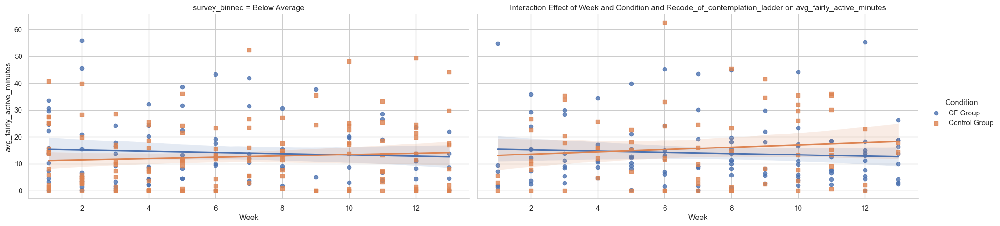

Significant Results found for avg_fairly_active_minutes:

                              Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_fairly_active_minutes
No. Observations:           407             Method:                     REML                     
No. Groups:                 37              Scale:                      77.2624                  
Min. group size:            2               Log-Likelihood:             -1501.8561               
Max. group size:            13              Converged:                  Yes                      
Mean group size:            11.0                                                                 
-------------------------------------------------------------------------------------------------
                                                       Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

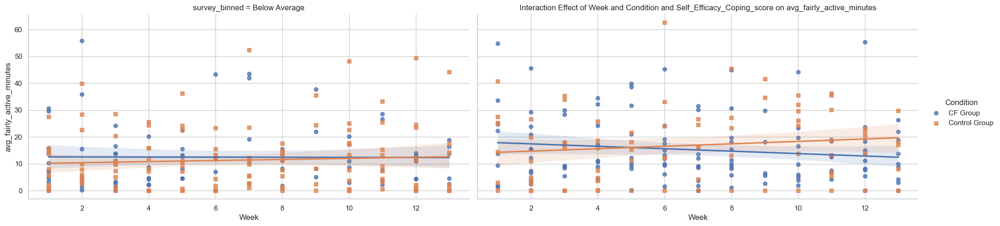

Significant Results found for avg_fairly_active_minutes:

                              Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_fairly_active_minutes
No. Observations:          407              Method:                      REML                     
No. Groups:                37               Scale:                       77.1075                  
Min. group size:           2                Log-Likelihood:              -1497.3117               
Max. group size:           13               Converged:                   Yes                      
Mean group size:           11.0                                                                   
--------------------------------------------------------------------------------------------------
                                                       Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
----------------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

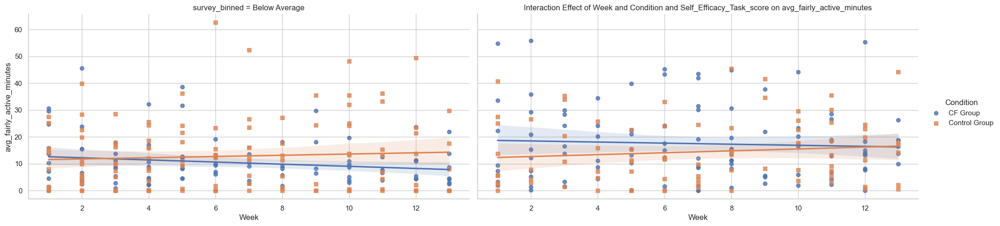

Significant Results found for avg_fairly_active_minutes:

                              Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_fairly_active_minutes
No. Observations:           407             Method:                     REML                     
No. Groups:                 37              Scale:                      77.4813                  
Min. group size:            2               Log-Likelihood:             -1501.5548               
Max. group size:            13              Converged:                  Yes                      
Mean group size:            11.0                                                                 
-------------------------------------------------------------------------------------------------
                                                       Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

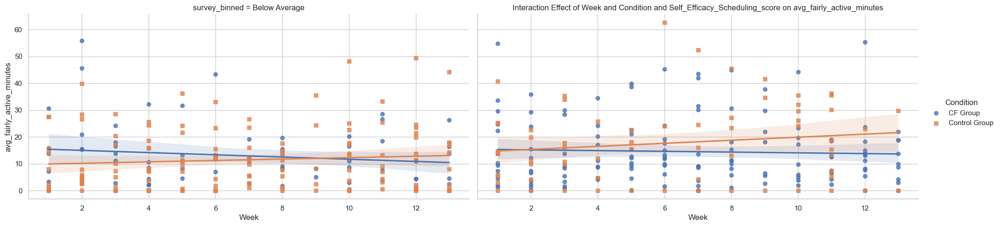

Significant Results found for avg_fairly_active_minutes:

                              Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_fairly_active_minutes
No. Observations:           406             Method:                     REML                     
No. Groups:                 37              Scale:                      77.4824                  
Min. group size:            2               Log-Likelihood:             -1494.8436               
Max. group size:            13              Converged:                  Yes                      
Mean group size:            11.0                                                                 
-------------------------------------------------------------------------------------------------
                                                       Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

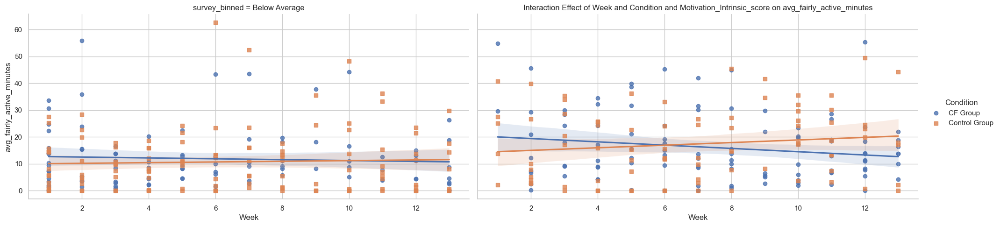

Significant Results found for avg_fairly_active_minutes:

                              Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_fairly_active_minutes
No. Observations:           406             Method:                     REML                     
No. Groups:                 37              Scale:                      77.0237                  
Min. group size:            2               Log-Likelihood:             -1495.6455               
Max. group size:            13              Converged:                  Yes                      
Mean group size:            11.0                                                                 
-------------------------------------------------------------------------------------------------
                                                       Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

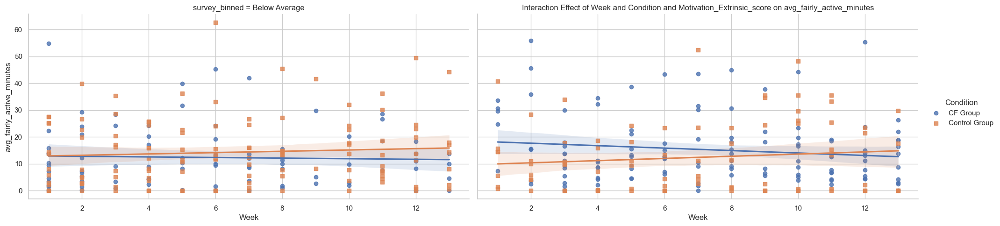

Significant Results found for avg_fairly_active_minutes:

                                    Mixed Linear Model Regression Results
Model:                          MixedLM             Dependent Variable:             avg_fairly_active_minutes
No. Observations:               406                 Method:                         REML                     
No. Groups:                     37                  Scale:                          77.8082                  
Min. group size:                2                   Log-Likelihood:                 -1496.8739               
Max. group size:                13                  Converged:                      Yes                      
Mean group size:                11.0                                                                         
-------------------------------------------------------------------------------------------------------------
                                                                   Coef.  Std.Err.   z    P>|z| [0

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

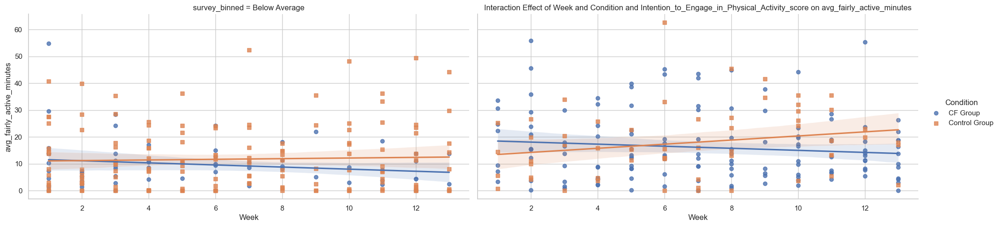


 avg_very_active_minutes
Significant Results found for avg_very_active_minutes:

                             Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_very_active_minutes
No. Observations:          405              Method:                      REML                   
No. Groups:                37               Scale:                       90.6109                
Min. group size:           2                Log-Likelihood:              -1531.6136             
Max. group size:           13               Converged:                   Yes                    
Mean group size:           10.9                                                                 
------------------------------------------------------------------------------------------------
                                                     Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
---------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

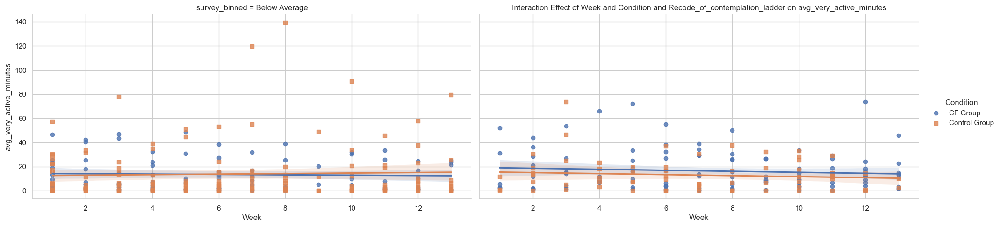

Significant Results found for avg_very_active_minutes:

                             Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_very_active_minutes
No. Observations:          407              Method:                      REML                   
No. Groups:                37               Scale:                       90.6910                
Min. group size:           2                Log-Likelihood:              -1539.6147             
Max. group size:           13               Converged:                   Yes                    
Mean group size:           11.0                                                                 
------------------------------------------------------------------------------------------------
                                                     Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
------------------------------------------------------------------------------------------------
Inte

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

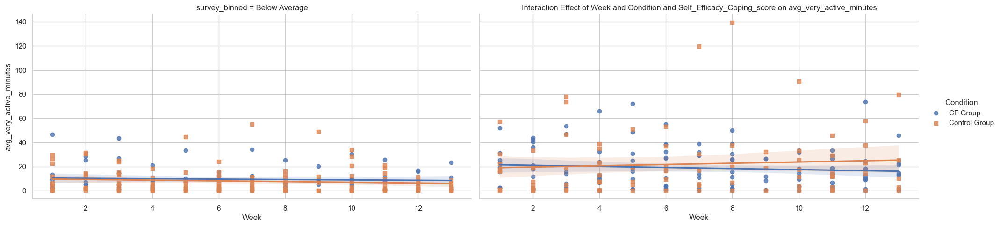

Significant Results found for avg_very_active_minutes:

                             Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_very_active_minutes
No. Observations:          407              Method:                      REML                   
No. Groups:                37               Scale:                       90.4927                
Min. group size:           2                Log-Likelihood:              -1536.9921             
Max. group size:           13               Converged:                   Yes                    
Mean group size:           11.0                                                                 
------------------------------------------------------------------------------------------------
                                                     Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
------------------------------------------------------------------------------------------------
Inte

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

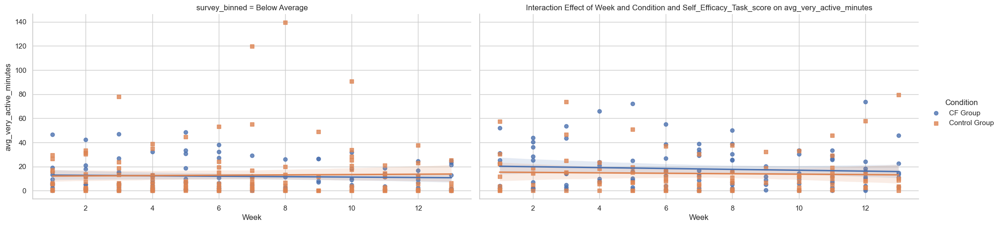

Significant Results found for avg_very_active_minutes:

                             Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_very_active_minutes
No. Observations:           407             Method:                     REML                   
No. Groups:                 37              Scale:                      91.0011                
Min. group size:            2               Log-Likelihood:             -1540.4997             
Max. group size:            13              Converged:                  Yes                    
Mean group size:            11.0                                                               
-----------------------------------------------------------------------------------------------
                                                     Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------------------------------
Intercept    

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

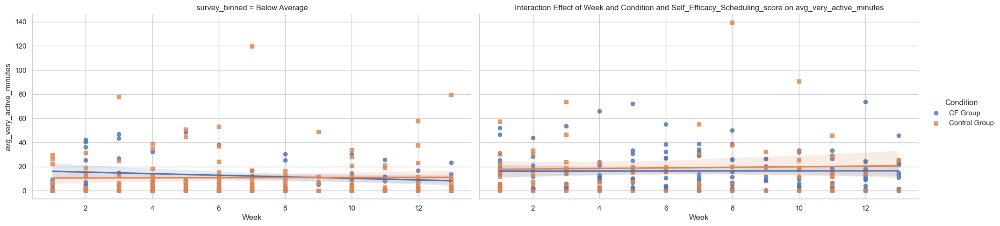

Significant Results found for avg_very_active_minutes:

                             Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_very_active_minutes
No. Observations:          406              Method:                      REML                   
No. Groups:                37               Scale:                       89.1744                
Min. group size:           2                Log-Likelihood:              -1529.5508             
Max. group size:           13               Converged:                   Yes                    
Mean group size:           11.0                                                                 
------------------------------------------------------------------------------------------------
                                                     Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
------------------------------------------------------------------------------------------------
Inte

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

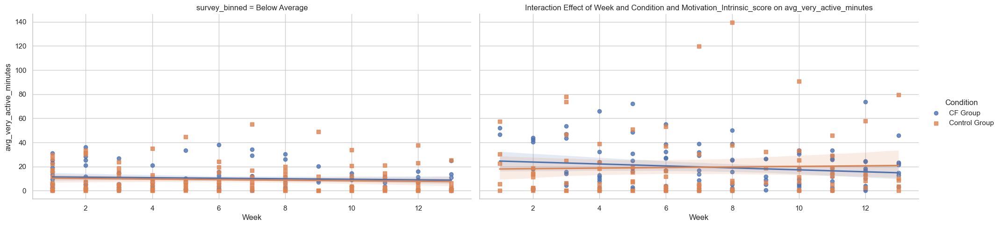

Significant Results found for avg_very_active_minutes:

                             Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         avg_very_active_minutes
No. Observations:           406             Method:                     REML                   
No. Groups:                 37              Scale:                      89.4470                
Min. group size:            2               Log-Likelihood:             -1532.0853             
Max. group size:            13              Converged:                  Yes                    
Mean group size:            11.0                                                               
-----------------------------------------------------------------------------------------------
                                                     Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------------------------------------
Intercept    

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

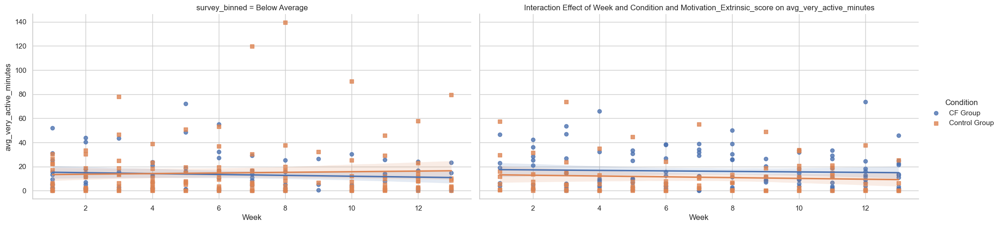

Significant Results found for avg_very_active_minutes:

                                    Mixed Linear Model Regression Results
Model:                           MixedLM              Dependent Variable:              avg_very_active_minutes
No. Observations:                406                  Method:                          REML                   
No. Groups:                      37                   Scale:                           89.2522                
Min. group size:                 2                    Log-Likelihood:                  -1530.9760             
Max. group size:                 13                   Converged:                       Yes                    
Mean group size:                 11.0                                                                         
--------------------------------------------------------------------------------------------------------------
                                                                   Coef.  Std.Err.   z    P>|

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

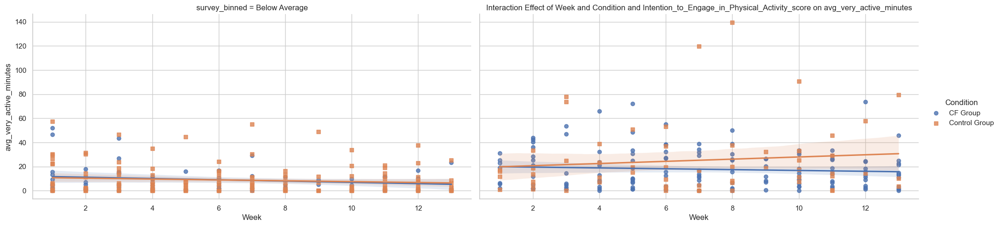


 avg_active_minutes
Significant Results found for avg_active_minutes:

                            Mixed Linear Model Regression Results
Model:                      MixedLM           Dependent Variable:           avg_active_minutes
No. Observations:           405               Method:                       REML              
No. Groups:                 37                Scale:                        249.2575          
Min. group size:            2                 Log-Likelihood:               -1725.2638        
Max. group size:            13                Converged:                    Yes               
Mean group size:            10.9                                                              
----------------------------------------------------------------------------------------------
                                                   Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
----------------------------------------------------------------------------------------------
Interce

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

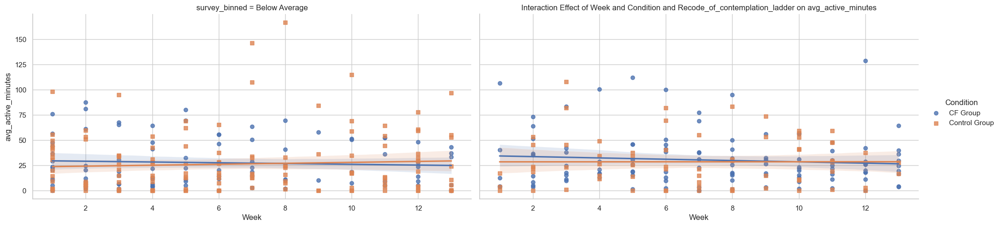

Significant Results found for avg_active_minutes:

                           Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_active_minutes
No. Observations:          407              Method:                      REML              
No. Groups:                37               Scale:                       249.1307          
Min. group size:           2                Log-Likelihood:              -1734.2073        
Max. group size:           13               Converged:                   Yes               
Mean group size:           11.0                                                            
-------------------------------------------------------------------------------------------
                                                Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
-------------------------------------------------------------------------------------------
Intercept                                        6.157  

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

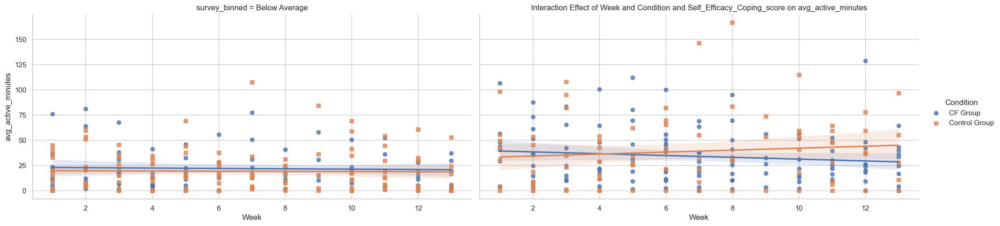

Significant Results found for avg_active_minutes:

                           Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_active_minutes
No. Observations:          407              Method:                      REML              
No. Groups:                37               Scale:                       248.6524          
Min. group size:           2                Log-Likelihood:              -1729.6692        
Max. group size:           13               Converged:                   Yes               
Mean group size:           11.0                                                            
-------------------------------------------------------------------------------------------
                                                Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
-------------------------------------------------------------------------------------------
Intercept                                       -9.803  

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

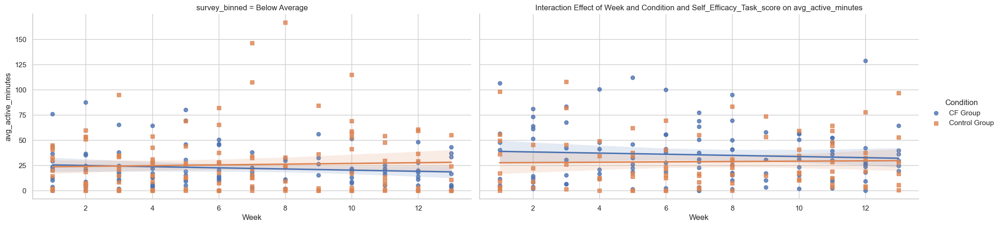

Significant Results found for avg_active_minutes:

                            Mixed Linear Model Regression Results
Model:                      MixedLM           Dependent Variable:           avg_active_minutes
No. Observations:           407               Method:                       REML              
No. Groups:                 37                Scale:                        250.5529          
Min. group size:            2                 Log-Likelihood:               -1734.9738        
Max. group size:            13                Converged:                    Yes               
Mean group size:            11.0                                                              
----------------------------------------------------------------------------------------------
                                                   Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
----------------------------------------------------------------------------------------------
Intercept                   

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

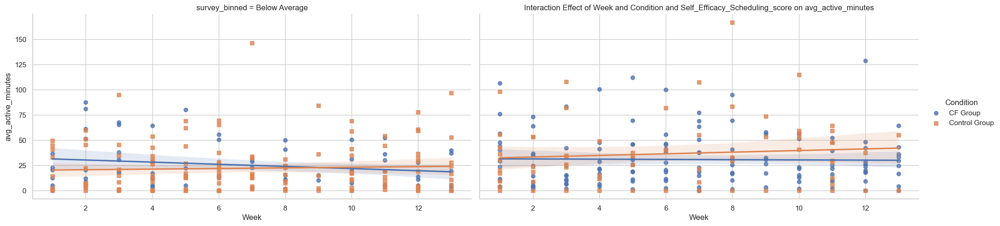

Significant Results found for avg_active_minutes:

                           Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_active_minutes
No. Observations:          406              Method:                      REML              
No. Groups:                37               Scale:                       247.2924          
Min. group size:           2                Log-Likelihood:              -1724.0203        
Max. group size:           13               Converged:                   Yes               
Mean group size:           11.0                                                            
-------------------------------------------------------------------------------------------
                                                Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
-------------------------------------------------------------------------------------------
Intercept                                        4.011  

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

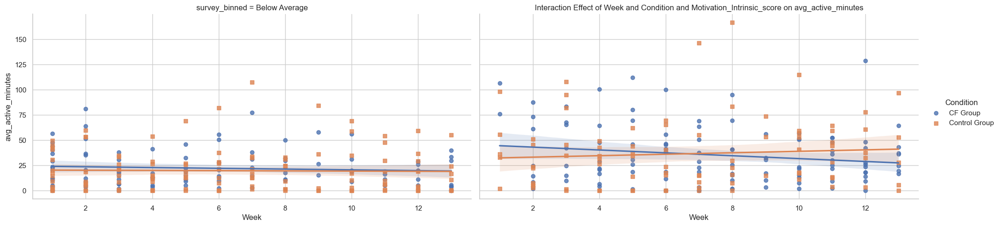

Significant Results found for avg_active_minutes:

                           Mixed Linear Model Regression Results
Model:                     MixedLM          Dependent Variable:          avg_active_minutes
No. Observations:          406              Method:                      REML              
No. Groups:                37               Scale:                       248.0114          
Min. group size:           2                Log-Likelihood:              -1728.1375        
Max. group size:           13               Converged:                   Yes               
Mean group size:           11.0                                                            
-------------------------------------------------------------------------------------------
                                                Coef.  Std.Err.   z    P>|z|  [0.025 0.975]
-------------------------------------------------------------------------------------------
Intercept                                        8.620  

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

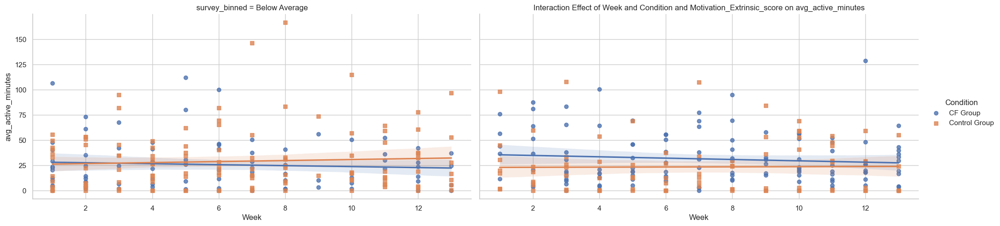

Significant Results found for avg_active_minutes:

                                    Mixed Linear Model Regression Results
Model:                            MixedLM                Dependent Variable:                avg_active_minutes
No. Observations:                 406                    Method:                            REML              
No. Groups:                       37                     Scale:                             248.2297          
Min. group size:                  2                      Log-Likelihood:                    -1727.0890        
Max. group size:                  13                     Converged:                         Yes               
Mean group size:                  11.0                                                                        
--------------------------------------------------------------------------------------------------------------
                                                                   Coef.  Std.Err.   z    P>|z|  [

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

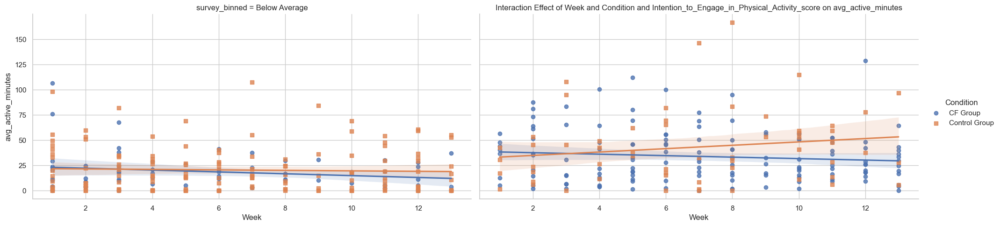


 avg_act_calories
Significant Results found for avg_act_calories:

                               Mixed Linear Model Regression Results
Model:                         MixedLM             Dependent Variable:             avg_act_calories
No. Observations:              405                 Method:                         REML            
No. Groups:                    37                  Scale:                          57631.8765      
Min. group size:               2                   Log-Likelihood:                 -2805.2498      
Max. group size:               13                  Converged:                      Yes             
Mean group size:               10.9                                                                
---------------------------------------------------------------------------------------------------
                                                     Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
---------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

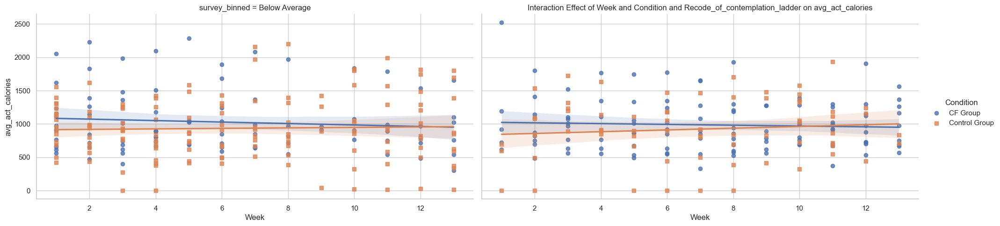

Significant Results found for avg_act_calories:

                             Mixed Linear Model Regression Results
Model:                       MixedLM            Dependent Variable:            avg_act_calories
No. Observations:            407                Method:                        REML            
No. Groups:                  37                 Scale:                         56439.6970      
Min. group size:             2                  Log-Likelihood:                -2814.4174      
Max. group size:             13                 Converged:                     Yes             
Mean group size:             11.0                                                              
-----------------------------------------------------------------------------------------------
                                                 Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
-----------------------------------------------------------------------------------------------
Intercept           

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

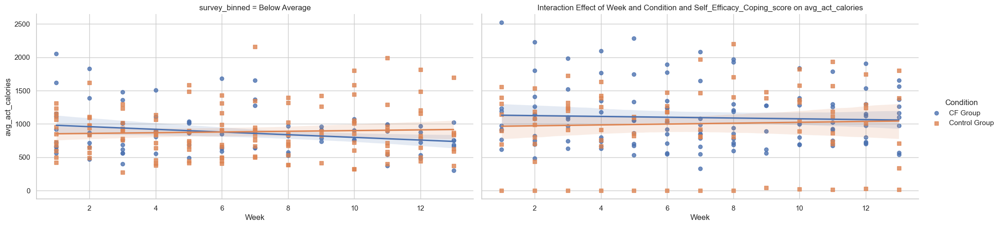

Significant Results found for avg_act_calories:

                            Mixed Linear Model Regression Results
Model:                        MixedLM           Dependent Variable:           avg_act_calories
No. Observations:             407               Method:                       REML            
No. Groups:                   37                Scale:                        56752.5070      
Min. group size:              2                 Log-Likelihood:               -2814.5276      
Max. group size:              13                Converged:                    Yes             
Mean group size:              11.0                                                            
----------------------------------------------------------------------------------------------
                                                Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
----------------------------------------------------------------------------------------------
Intercept                     

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

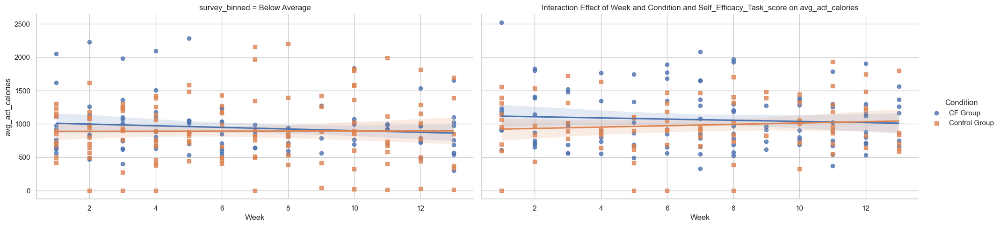

Significant Results found for avg_act_calories:

                               Mixed Linear Model Regression Results
Model:                         MixedLM             Dependent Variable:             avg_act_calories
No. Observations:              407                 Method:                         REML            
No. Groups:                    37                  Scale:                          57646.3981      
Min. group size:               2                   Log-Likelihood:                 -2819.1974      
Max. group size:               13                  Converged:                      Yes             
Mean group size:               11.0                                                                
---------------------------------------------------------------------------------------------------
                                                     Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
----------------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

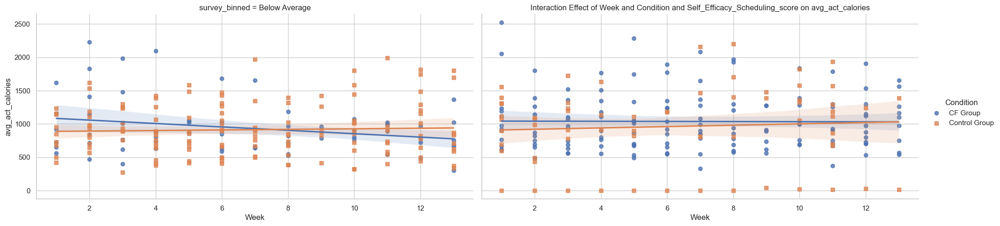

Significant Results found for avg_act_calories:

                             Mixed Linear Model Regression Results
Model:                       MixedLM            Dependent Variable:            avg_act_calories
No. Observations:            406                Method:                        REML            
No. Groups:                  37                 Scale:                         56842.6390      
Min. group size:             2                  Log-Likelihood:                -2806.6534      
Max. group size:             13                 Converged:                     Yes             
Mean group size:             11.0                                                              
-----------------------------------------------------------------------------------------------
                                                 Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
-----------------------------------------------------------------------------------------------
Intercept           

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

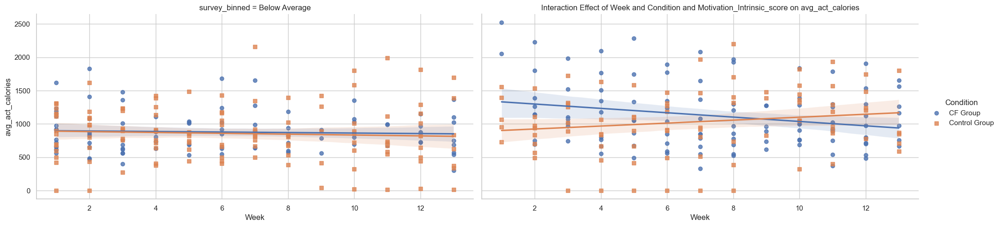

Significant Results found for avg_act_calories:

                             Mixed Linear Model Regression Results
Model:                       MixedLM            Dependent Variable:            avg_act_calories
No. Observations:            406                Method:                        REML            
No. Groups:                  37                 Scale:                         56447.2696      
Min. group size:             2                  Log-Likelihood:                -2806.6144      
Max. group size:             13                 Converged:                     Yes             
Mean group size:             11.0                                                              
-----------------------------------------------------------------------------------------------
                                                 Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
-----------------------------------------------------------------------------------------------
Intercept           

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

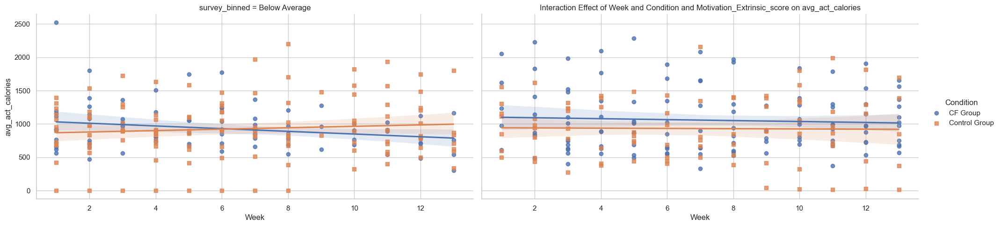

Significant Results found for avg_act_calories:

                                       Mixed Linear Model Regression Results
Model:                               MixedLM                  Dependent Variable:                  avg_act_calories
No. Observations:                    406                      Method:                              REML            
No. Groups:                          37                       Scale:                               56417.6222      
Min. group size:                     2                        Log-Likelihood:                      -2805.8159      
Max. group size:                     13                       Converged:                           Yes             
Mean group size:                     11.0                                                                          
-------------------------------------------------------------------------------------------------------------------
                                                              

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

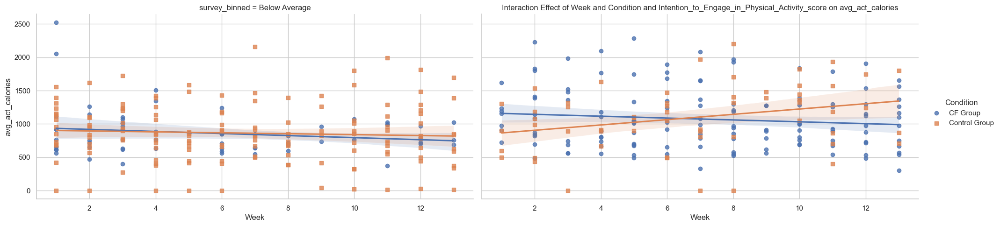


 avg_calories
Significant Results found for avg_calories:

                               Mixed Linear Model Regression Results
Model:                           MixedLM              Dependent Variable:              avg_calories
No. Observations:                405                  Method:                          REML        
No. Groups:                      37                   Scale:                           42641.0244  
Min. group size:                 2                    Log-Likelihood:                  -2752.4061  
Max. group size:                 13                   Converged:                       Yes         
Mean group size:                 10.9                                                              
---------------------------------------------------------------------------------------------------
                                                     Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
-----------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

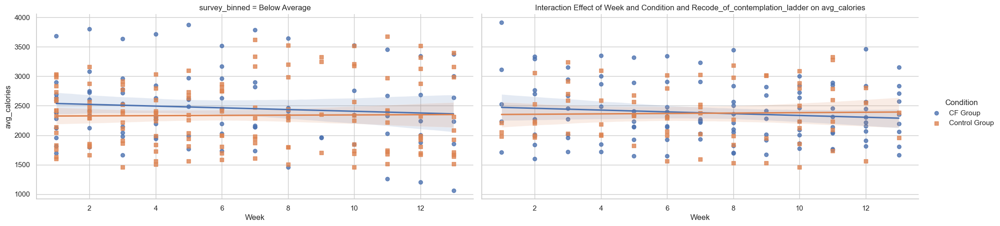

Significant Results found for avg_calories:

                             Mixed Linear Model Regression Results
Model:                         MixedLM             Dependent Variable:             avg_calories
No. Observations:              407                 Method:                         REML        
No. Groups:                    37                  Scale:                          40600.1577  
Min. group size:               2                   Log-Likelihood:                 -2756.2754  
Max. group size:               13                  Converged:                      Yes         
Mean group size:               11.0                                                            
-----------------------------------------------------------------------------------------------
                                                 Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
-----------------------------------------------------------------------------------------------
Intercept               

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

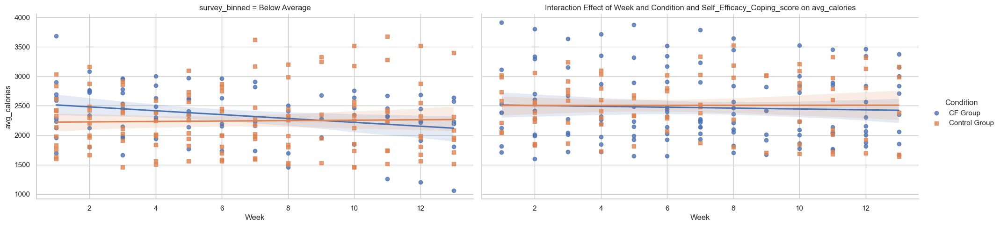

Significant Results found for avg_calories:

                            Mixed Linear Model Regression Results
Model:                         MixedLM            Dependent Variable:            avg_calories
No. Observations:              407                Method:                        REML        
No. Groups:                    37                 Scale:                         41398.4329  
Min. group size:               2                  Log-Likelihood:                -2760.1769  
Max. group size:               13                 Converged:                     Yes         
Mean group size:               11.0                                                          
---------------------------------------------------------------------------------------------
                                               Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
---------------------------------------------------------------------------------------------
Intercept                                  

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

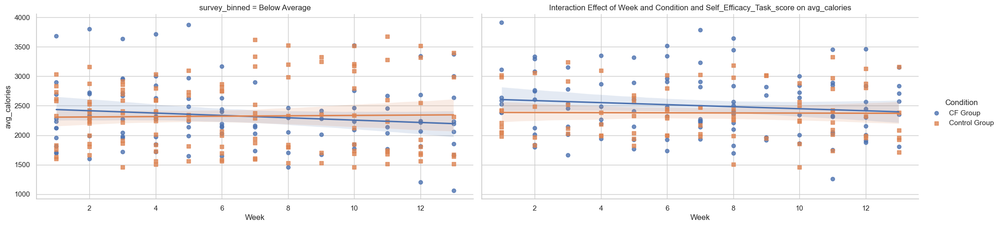

Significant Results found for avg_calories:

                               Mixed Linear Model Regression Results
Model:                           MixedLM              Dependent Variable:              avg_calories
No. Observations:                407                  Method:                          REML        
No. Groups:                      37                   Scale:                           41794.3282  
Min. group size:                 2                    Log-Likelihood:                  -2763.3676  
Max. group size:                 13                   Converged:                       Yes         
Mean group size:                 11.0                                                              
---------------------------------------------------------------------------------------------------
                                                     Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
--------------------------------------------------------------------------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

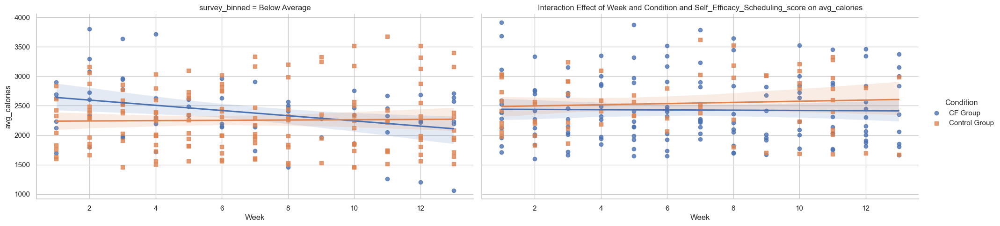

Significant Results found for avg_calories:

                             Mixed Linear Model Regression Results
Model:                         MixedLM             Dependent Variable:             avg_calories
No. Observations:              406                 Method:                         REML        
No. Groups:                    37                  Scale:                          42657.3311  
Min. group size:               2                   Log-Likelihood:                 -2757.0485  
Max. group size:               13                  Converged:                      Yes         
Mean group size:               11.0                                                            
-----------------------------------------------------------------------------------------------
                                                 Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
-----------------------------------------------------------------------------------------------
Intercept               

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

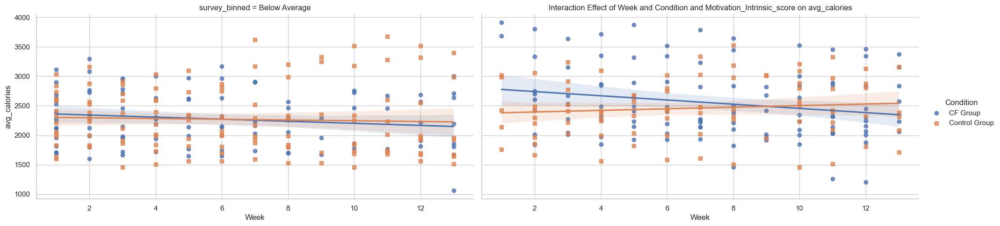

Significant Results found for avg_calories:

                             Mixed Linear Model Regression Results
Model:                         MixedLM             Dependent Variable:             avg_calories
No. Observations:              406                 Method:                         REML        
No. Groups:                    37                  Scale:                          40295.5590  
Min. group size:               2                   Log-Likelihood:                 -2747.5681  
Max. group size:               13                  Converged:                      Yes         
Mean group size:               11.0                                                            
-----------------------------------------------------------------------------------------------
                                                 Coef.   Std.Err.   z    P>|z|  [0.025   0.975]
-----------------------------------------------------------------------------------------------
Intercept               

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

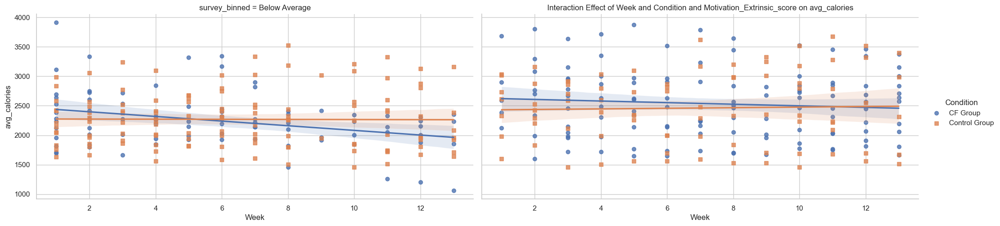

Significant Results found for avg_calories:

                                       Mixed Linear Model Regression Results
Model:                               MixedLM                    Dependent Variable:                    avg_calories
No. Observations:                    406                        Method:                                REML        
No. Groups:                          37                         Scale:                                 42603.1809  
Min. group size:                     2                          Log-Likelihood:                        -2757.4805  
Max. group size:                     13                         Converged:                             Yes         
Mean group size:                     11.0                                                                          
-------------------------------------------------------------------------------------------------------------------
                                                                  

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1500x1000 with 0 Axes>

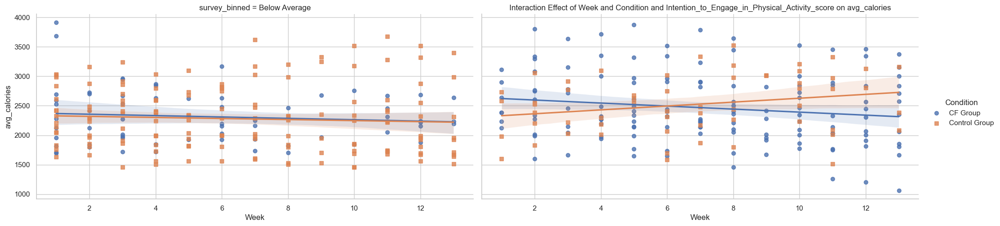

In [83]:
# Function to check significant interaction in the mixed-effects model
def check_significant_interaction(model):
    # Check if the p-value for the interaction term (Week:Condition) is significant
    for param, pvalue in model.pvalues.items():
        if "Condition" in param and pvalue <= 0.1:
            return True
    return False

######### Hypothesis 1: Longitudinal Analysis of Physical Activity Metrics over the interview weeks
main_activity_columns = ['avg_fairly_active_minutes','avg_very_active_minutes','avg_active_minutes','avg_act_calories','avg_calories']
main_Survey_columns = ['Recode_of_contemplation_ladder', 'Self_Efficacy_Coping_score',
'Self_Efficacy_Task_score', 'Self_Efficacy_Scheduling_score','Motivation_Intrinsic_score', 'Motivation_Extrinsic_score',
'Intention_to_Engage_in_Physical_Activity_score']
main_CF_columns = ['Overall_CF1', 'Overall_CF2', 'Overall_CF3','Overall_CF_potency_score','Overall_CF_Intention']

df_survey_activity = df[['Participant_ID', 'Week', 'Condition', 'BMI']+ main_activity_columns+main_Survey_columns]

for activity_col in main_activity_columns:
    df_activity = df_survey_activity[['Participant_ID', 'Week', 'Condition', 'BMI', activity_col]+main_Survey_columns]
    
    df_activity_baseline = df_activity[df_activity['Week'] == 1][['Participant_ID', activity_col]].rename(columns={activity_col: 'baseline_' + activity_col})
    # Merge baseline with the main dataframe
    df_activity = df_activity.merge(df_activity_baseline, on='Participant_ID')
    df_activity[f'change_{activity_col}'] = df_activity[activity_col] - df_activity[f'baseline_{activity_col}']

    metric_col = activity_col
    change_col = f'change_{activity_col}'
    print( '\n', metric_col)

    df_activity = df_activity.dropna(subset=[activity_col]).reset_index(drop=True) #[['Participant_ID', 'Week', 'Condition', activity_col]]
    
    for survey_col in main_Survey_columns:
        df_activity_s = df_activity.dropna(subset=[survey_col]).reset_index(drop=True) #[['Participant_ID', 'Week', 'Condition', activity_col]]

        fixed_effects=[ survey_col, 'Week', 'Condition' ]
        random_effect_col= 'Participant_ID'
        df_activity_s['Condition'] = df_activity_s['Condition'].astype('category')

        formula = f"{activity_col} ~  {survey_col} * Week * Condition "
        formula = f"{activity_col} ~  {survey_col}+Condition + Week +{'baseline_' + activity_col} + BMI + Week:Condition + Week:Condition:{'baseline_' + activity_col}+ Week:Condition:BMI+ Week:Condition:{survey_col}"  #+ Week:Condition:{'baseline_' + activity_col}
        model = smf.mixedlm(formula, df_activity_s, groups=df_activity_s[random_effect_col]).fit()

        if check_significant_interaction(model):

            print(f"Significant Results found for {activity_col}:\n")
            print(model.summary())

            # Plot the trends over time for each group
            df_activity_s['Condition'] = df_activity_s['Condition'].map({1: 'CF Group', 2: 'Control Group'})
            # Define bins and labels
            bins = [-float('inf'), df_activity_s[survey_col].median(), float('inf')]
            labels = ["Below Average", "Above Average"]

            # Create the binned column
            df_activity_s['survey_binned'] = pd.cut(df_activity_s[survey_col], bins=bins, labels=labels)
            sns.set(style="whitegrid")

            # Interaction plot
            plt.figure(figsize=(15, 10))
            sns.lmplot(x='Week', y=activity_col, hue='Condition', col='survey_binned', 
                       data=df_activity_s, aspect=2, markers=["o", "s"])
            plt.title(f'Interaction Effect of Week and Condition and {survey_col} on {activity_col}')
            plt.xlabel('Week')
            plt.ylabel(f'{activity_col} (Minutes)')
            plt.show()




 Recode_of_contemplation_ladder

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 7.94 (1.47)
Week 2: 8.50 (0.99)
Week 3: 8.41 (1.23)
Week 4: 8.25 (1.29)
Week 5: 8.69 (1.14)
Week 6: 8.29 (1.57)
Week 7: 8.81 (1.11)
Week 8: 8.50 (1.75)
Week 9: 9.22 (0.83)
Week 10: 8.57 (1.65)
Week 11: 8.86 (1.29)
Week 12: 8.75 (1.18)
Week 13: 8.81 (0.91)
Week 14: 9.06 (1.09)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 6.68 (2.40)
Week 2: 7.68 (2.11)
Week 3: 7.56 (2.28)
Week 4: 6.89 (3.14)
Week 5: 7.53 (2.59)
Week 6: 7.67 (2.20)
Week 7: 7.13 (2.42)
Week 8: 7.47 (2.18)
Week 9: 8.50 (0.93)
Week 10: 7.61 (2.48)
Week 11: 7.65 (2.42)
Week 12: 7.59 (2.48)
Week 13: 7.43 (2.17)
Week 14: 7.94 (2.48)

T-test result:
T-statistic: 8.2158
P-value: 0.0000


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


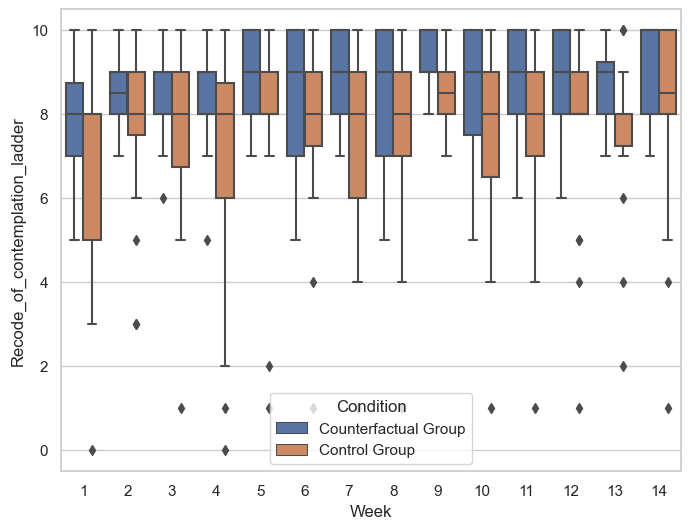

Significant Results found for Recode_of_contemplation_ladder:

                      Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Recode_of_contemplation_ladder
No. Observations:   449       Method:               ML                            
No. Groups:         37        Scale:                0.9734                        
Min. group size:    3         Log-Likelihood:       -695.0160                     
Max. group size:    14        Converged:            Yes                           
Mean group size:    12.1                                                          
----------------------------------------------------------------------------------
                                        Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------------
Intercept                                2.421    0.702  3.448 0.001  1.045  3.797
Condition[T.2.0]                        -0.123 

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

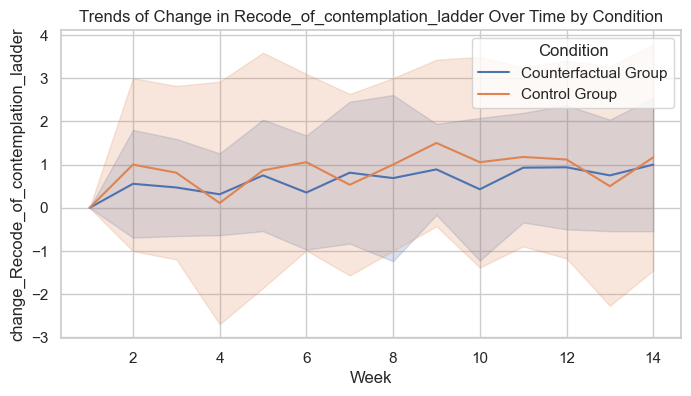

Week 1 Diference between CF & Control Groups:t-stat = 1.9328, p-value = 0.0627
Week 7 Diference between CF & Control Groups:t-stat = 2.4597, p-value = 0.0235
Week 11 Diference between CF & Control Groups:t-stat = 1.7756, p-value = 0.0879
Week 12 Diference between CF & Control Groups:t-stat = 1.7353, p-value = 0.0959
Week 13 Diference between CF & Control Groups:t-stat = 2.2179, p-value = 0.0405
Week 5 Different to Base for Experimental: p-value = 0.0346
Week 9 Different to Base for Experimental: p-value = 0.0353
Week 11 Different to Base for Experimental: p-value = 0.0169
Week 12 Different to Base for Experimental: p-value = 0.0197
Week 13 Different to Base for Experimental: p-value = 0.0346
Week 2 Different to Base for Control: p-value = 0.0428
Week 6 Different to Base for Control: p-value = 0.0426
Week 11 Different to Base for Control: p-value = 0.0323


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

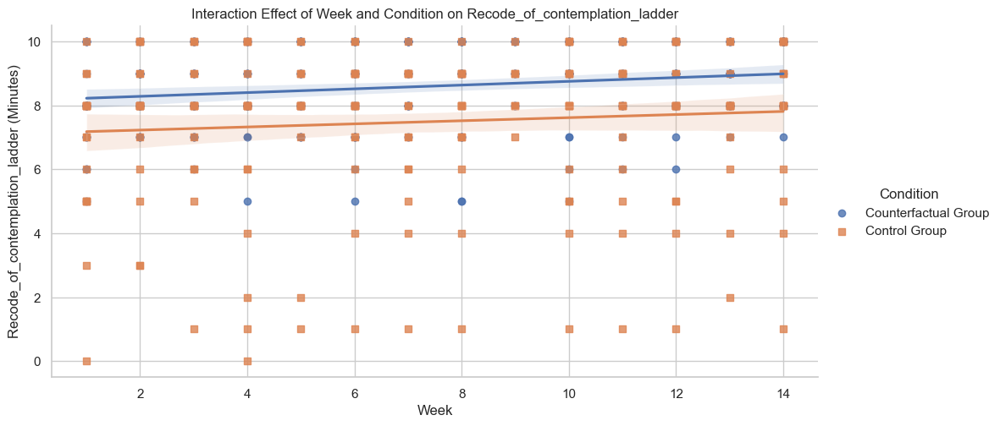

        Source      F  p-unc    ng2
0    Condition  3.193  0.101  0.106
1         Week  1.625  0.085  0.080
2  Interaction  0.552  0.888  0.029


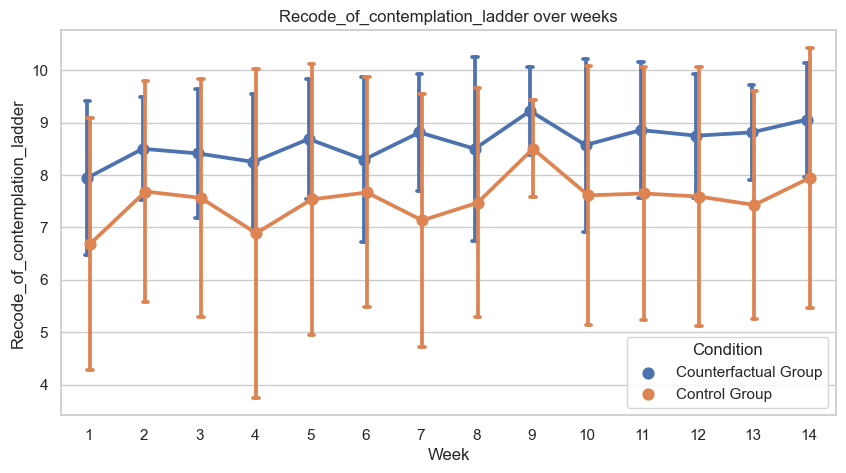


 Self_Efficacy_Coping_score

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 4.87 (2.34)
Week 2: 5.76 (2.12)
Week 3: 4.82 (2.41)
Week 4: 5.31 (2.89)
Week 5: 5.75 (2.79)
Week 6: 6.06 (2.59)
Week 7: 6.58 (2.61)
Week 8: 6.46 (2.90)
Week 9: 5.89 (2.66)
Week 10: 6.86 (1.95)
Week 11: 6.45 (2.32)
Week 12: 6.12 (2.74)
Week 13: 6.25 (2.63)
Week 14: 6.35 (2.05)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 4.95 (2.10)
Week 2: 4.77 (1.65)
Week 3: 5.02 (1.79)
Week 4: 5.04 (2.25)
Week 5: 4.82 (1.95)
Week 6: 4.56 (2.68)
Week 7: 4.58 (2.54)
Week 8: 4.61 (3.14)
Week 9: 5.29 (2.54)
Week 10: 4.72 (2.71)
Week 11: 5.13 (3.03)
Week 12: 4.88 (2.99)
Week 13: 4.26 (2.34)
Week 14: 5.22 (2.94)

T-test result:
T-statistic: 6.9772
P-value: 0.0000


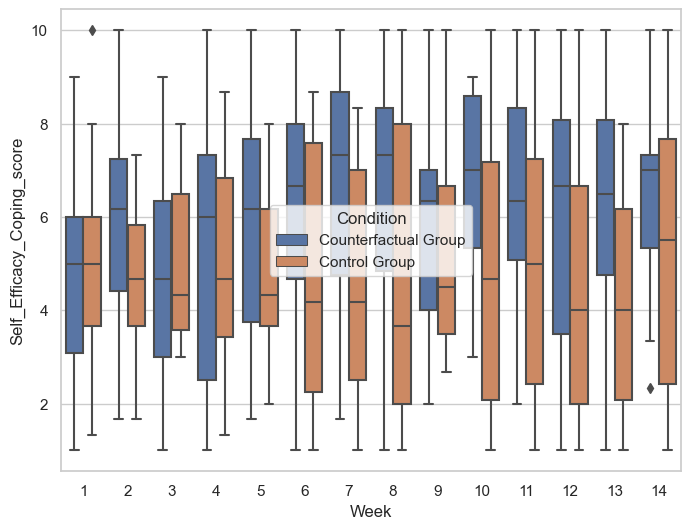

Significant Results found for Self_Efficacy_Coping_score:

                    Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Self_Efficacy_Coping_score
No. Observations:   451       Method:               ML                        
No. Groups:         37        Scale:                0.9998                    
Min. group size:    3         Log-Likelihood:       -714.0888                 
Max. group size:    14        Converged:            Yes                       
Mean group size:    12.2                                                      
------------------------------------------------------------------------------
                                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------
Intercept                            1.079    0.393  2.742 0.006  0.308  1.850
Condition[T.2.0]                    -0.443    0.303 -1.459 0.145 -1.037  0.152
Week          

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

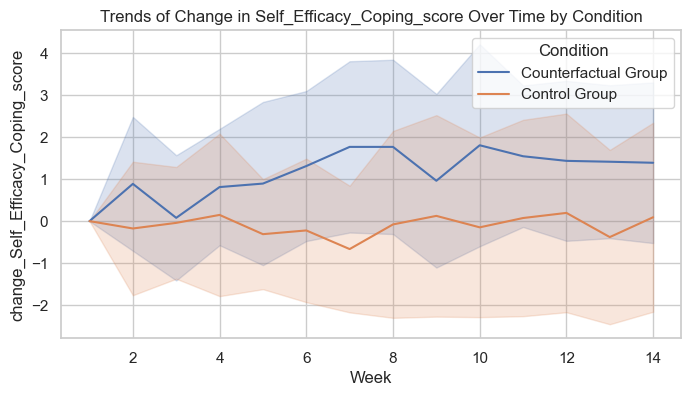

Week 7 Diference between CF & Control Groups:t-stat = 2.1982, p-value = 0.0358
Week 8 Diference between CF & Control Groups:t-stat = 1.7604, p-value = 0.0882
Week 10 Diference between CF & Control Groups:t-stat = 2.5871, p-value = 0.0148
Week 13 Diference between CF & Control Groups:t-stat = 2.1900, p-value = 0.0370
Week 2 Different to Base for Experimental: p-value = 0.0304
Week 4 Different to Base for Experimental: p-value = 0.0334
Week 6 Different to Base for Experimental: p-value = 0.0080
Week 7 Different to Base for Experimental: p-value = 0.0034
Week 8 Different to Base for Experimental: p-value = 0.0039
Week 10 Different to Base for Experimental: p-value = 0.0148
Week 11 Different to Base for Experimental: p-value = 0.0045
Week 12 Different to Base for Experimental: p-value = 0.0087
Week 13 Different to Base for Experimental: p-value = 0.0072


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

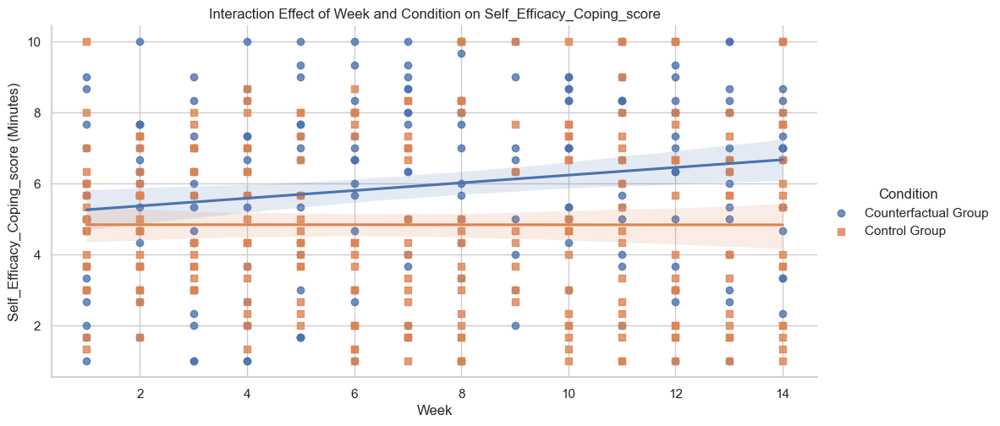

        Source      F  p-unc    ng2
0    Condition  0.728  0.412  0.049
1         Week  1.312  0.213  0.026
2  Interaction  2.074  0.019  0.040


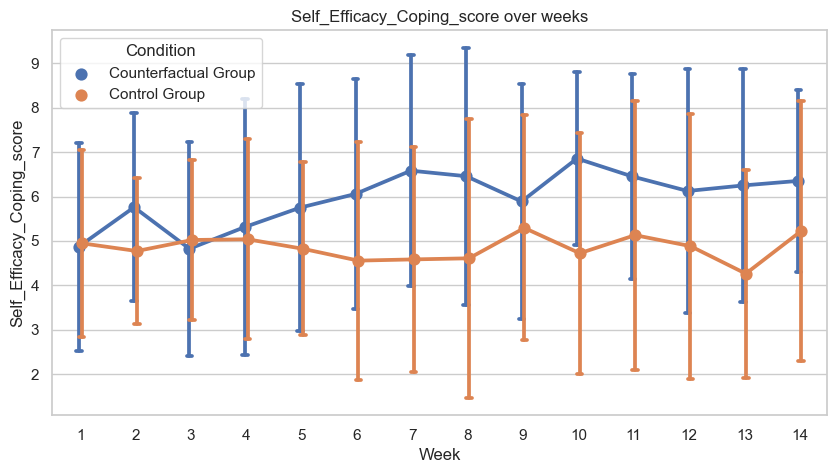


 Self_Efficacy_Task_score

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 8.22 (1.51)
Week 2: 8.36 (1.42)
Week 3: 8.10 (1.62)
Week 4: 8.28 (1.50)
Week 5: 8.44 (1.68)
Week 6: 8.37 (1.49)
Week 7: 8.84 (1.55)
Week 8: 8.64 (1.64)
Week 9: 8.94 (1.12)
Week 10: 8.48 (1.70)
Week 11: 8.55 (1.92)
Week 12: 8.53 (1.76)
Week 13: 8.27 (1.75)
Week 14: 8.57 (1.93)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 8.46 (1.47)
Week 2: 7.61 (1.62)
Week 3: 7.92 (1.81)
Week 4: 7.93 (1.53)
Week 5: 8.17 (1.92)
Week 6: 8.18 (1.73)
Week 7: 7.91 (2.05)
Week 8: 8.15 (1.93)
Week 9: 8.12 (1.49)
Week 10: 8.08 (1.59)
Week 11: 8.50 (1.56)
Week 12: 8.54 (1.33)
Week 13: 8.46 (1.33)
Week 14: 8.56 (1.53)

T-test result:
T-statistic: 3.1859
P-value: 0.0041


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


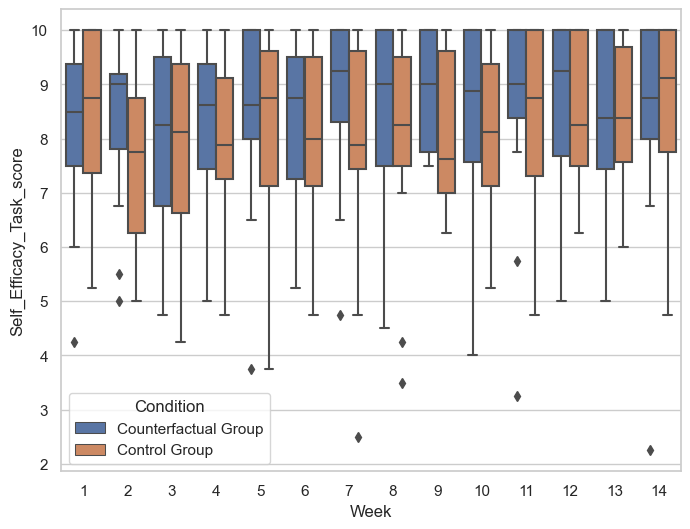

Significant Results found for Self_Efficacy_Task_score:

                   Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Self_Efficacy_Task_score
No. Observations:   451       Method:               ML                      
No. Groups:         37        Scale:                0.4470                  
Min. group size:    3         Log-Likelihood:       -525.1943               
Max. group size:    14        Converged:            Yes                     
Mean group size:    12.2                                                    
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                          1.280    0.659  1.942 0.052 -0.012  2.572
Condition[T.2.0]                  -0.616    0.246 -2.508 0.012 -1.097 -0.135
Week                               0.03

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

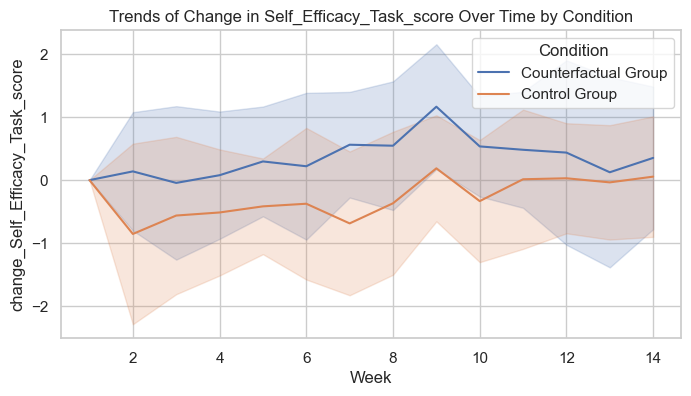

Week 7 Different to Base for Experimental: p-value = 0.0171
Week 8 Different to Base for Experimental: p-value = 0.0491
Week 9 Different to Base for Experimental: p-value = 0.0078
Week 10 Different to Base for Experimental: p-value = 0.0257
Week 2 Different to Base for Control: p-value = 0.0181
Week 4 Different to Base for Control: p-value = 0.0439
Week 7 Different to Base for Control: p-value = 0.0294


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

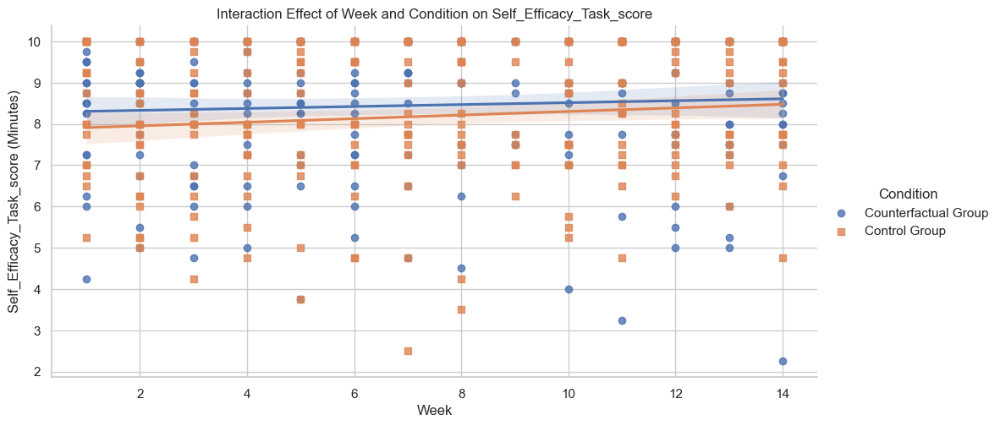

        Source      F  p-unc    ng2
0    Condition  0.628  0.445  0.048
1         Week  2.706  0.002  0.026
2  Interaction  1.618  0.086  0.016


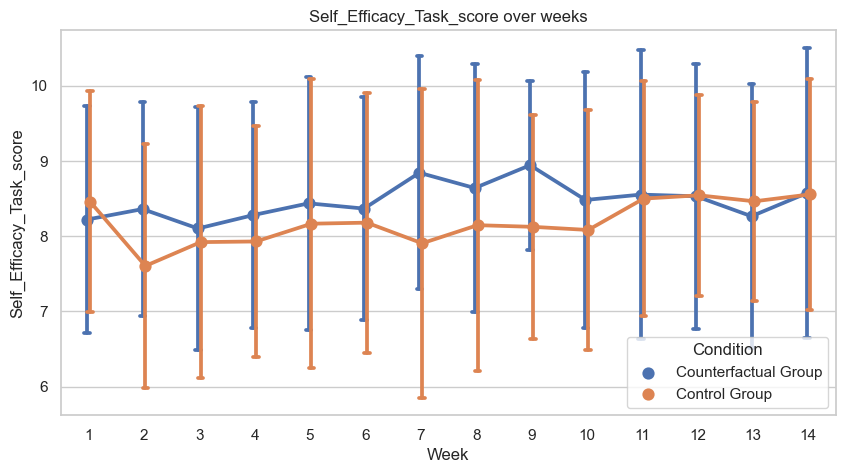


 Self_Efficacy_Scheduling_score

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 5.96 (1.71)
Week 2: 5.93 (2.13)
Week 3: 5.61 (2.40)
Week 4: 6.08 (2.58)
Week 5: 6.40 (2.23)
Week 6: 6.51 (2.12)
Week 7: 6.71 (2.35)
Week 8: 6.46 (2.55)
Week 9: 7.26 (1.89)
Week 10: 6.19 (1.95)
Week 11: 6.57 (2.31)
Week 12: 6.52 (2.09)
Week 13: 6.25 (2.30)
Week 14: 6.41 (1.88)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 5.40 (2.14)
Week 2: 4.72 (1.74)
Week 3: 4.79 (1.69)
Week 4: 4.43 (1.48)
Week 5: 4.24 (1.42)
Week 6: 3.96 (1.86)
Week 7: 4.02 (2.24)
Week 8: 4.29 (2.41)
Week 9: 4.92 (2.56)
Week 10: 4.52 (2.46)
Week 11: 5.24 (2.82)
Week 12: 4.16 (2.55)
Week 13: 3.83 (2.09)
Week 14: 4.72 (2.54)

T-test result:
T-statistic: 12.0761
P-value: 0.0000


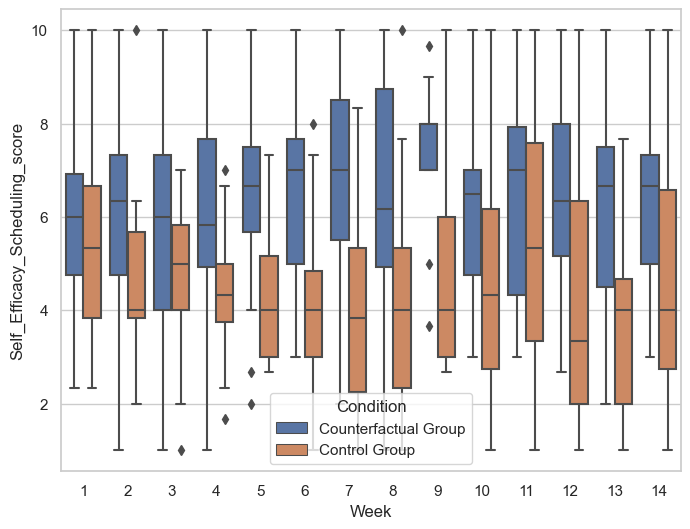

Significant Results found for Self_Efficacy_Scheduling_score:

                      Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Self_Efficacy_Scheduling_score
No. Observations:   451       Method:               ML                            
No. Groups:         37        Scale:                1.2093                        
Min. group size:    3         Log-Likelihood:       -759.3629                     
Max. group size:    14        Converged:            Yes                           
Mean group size:    12.2                                                          
----------------------------------------------------------------------------------
                                        Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------------
Intercept                                1.574    0.646  2.438 0.015  0.308  2.839
Condition[T.2.0]                        -0.847 

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

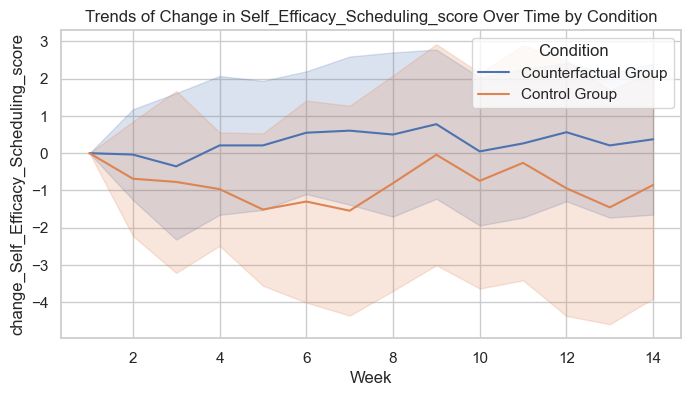

Week 2 Diference between CF & Control Groups:t-stat = 1.8789, p-value = 0.0691
Week 4 Diference between CF & Control Groups:t-stat = 2.2591, p-value = 0.0336
Week 5 Diference between CF & Control Groups:t-stat = 3.2207, p-value = 0.0035
Week 6 Diference between CF & Control Groups:t-stat = 3.7731, p-value = 0.0007
Week 7 Diference between CF & Control Groups:t-stat = 3.3068, p-value = 0.0025
Week 8 Diference between CF & Control Groups:t-stat = 2.5041, p-value = 0.0178
Week 9 Diference between CF & Control Groups:t-stat = 2.1262, p-value = 0.0535
Week 10 Diference between CF & Control Groups:t-stat = 2.1458, p-value = 0.0401
Week 12 Diference between CF & Control Groups:t-stat = 2.9199, p-value = 0.0065
Week 13 Diference between CF & Control Groups:t-stat = 3.0138, p-value = 0.0054
Week 4 Different to Base for Control: p-value = 0.0156
Week 5 Different to Base for Control: p-value = 0.0125
Week 7 Different to Base for Control: p-value = 0.0445


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

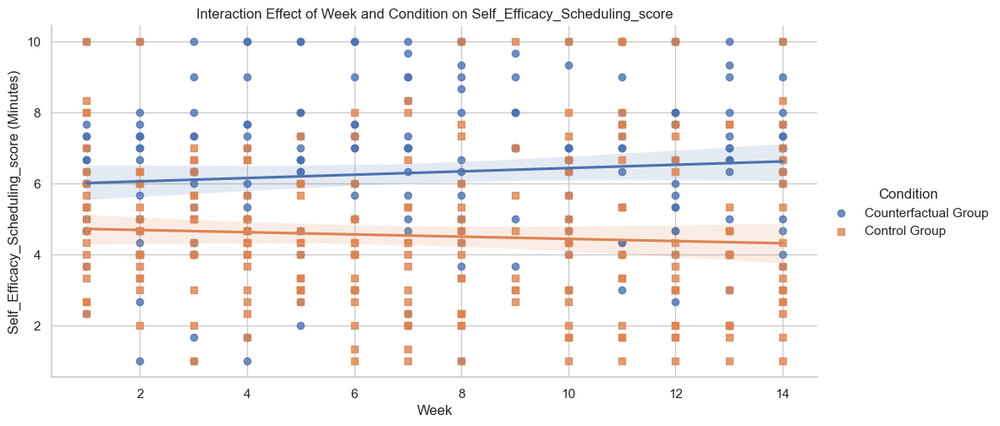

        Source      F  p-unc    ng2
0    Condition  5.973  0.033  0.261
1         Week  0.583  0.865  0.018
2  Interaction  1.026  0.430  0.032


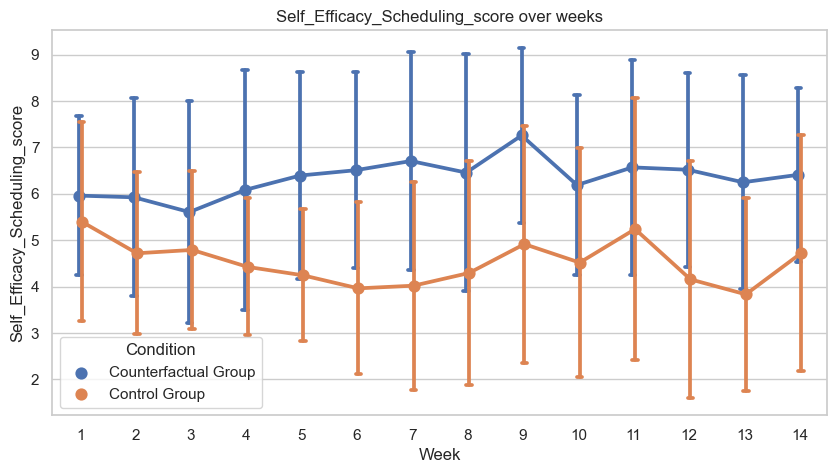


 Motivation_Intrinsic_score

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 3.69 (1.09)
Week 2: 4.32 (1.09)
Week 3: 4.25 (1.16)
Week 4: 4.42 (1.16)
Week 5: 4.43 (1.19)
Week 6: 4.49 (1.22)
Week 7: 4.77 (1.18)
Week 8: 4.67 (1.06)
Week 9: 4.58 (1.08)
Week 10: 4.68 (1.30)
Week 11: 4.91 (1.14)
Week 12: 4.83 (1.28)
Week 13: 4.61 (1.19)
Week 14: 4.75 (1.22)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 4.01 (0.98)
Week 2: 4.24 (1.32)
Week 3: 4.18 (1.49)
Week 4: 4.04 (1.41)
Week 5: 4.42 (1.30)
Week 6: 4.31 (1.44)
Week 7: 4.28 (1.40)
Week 8: 4.35 (1.44)
Week 9: 4.44 (1.29)
Week 10: 4.33 (1.50)
Week 11: 4.53 (1.34)
Week 12: 4.32 (1.55)
Week 13: 4.21 (1.50)
Week 14: 4.44 (1.42)

T-test result:
T-statistic: 4.2036
P-value: 0.0004


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


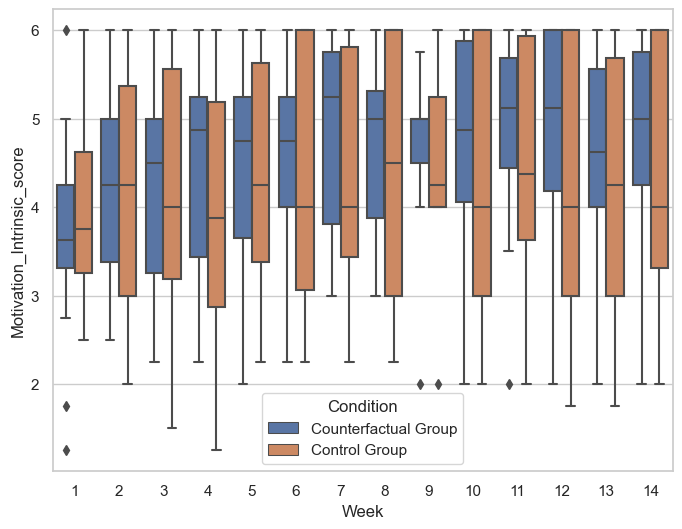

Significant Results found for Motivation_Intrinsic_score:

                    Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Motivation_Intrinsic_score
No. Observations:   450       Method:               ML                        
No. Groups:         37        Scale:                0.3141                    
Min. group size:    3         Log-Likelihood:       -447.7705                 
Max. group size:    14        Converged:            Yes                       
Mean group size:    12.2                                                      
------------------------------------------------------------------------------
                                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------
Intercept                            1.078    0.414  2.603 0.009  0.267  1.890
Condition[T.2.0]                    -0.210    0.213 -0.983 0.325 -0.628  0.208
Week          

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

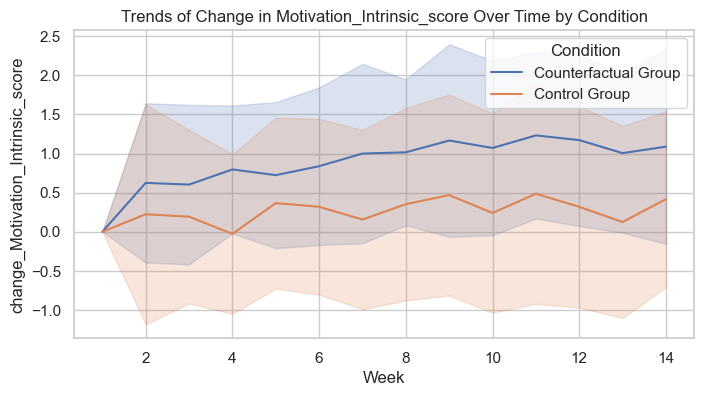

Week 2 Different to Base for Experimental: p-value = 0.0186
Week 3 Different to Base for Experimental: p-value = 0.0268
Week 4 Different to Base for Experimental: p-value = 0.0014
Week 5 Different to Base for Experimental: p-value = 0.0073
Week 6 Different to Base for Experimental: p-value = 0.0034
Week 7 Different to Base for Experimental: p-value = 0.0033
Week 8 Different to Base for Experimental: p-value = 0.0006
Week 9 Different to Base for Experimental: p-value = 0.0217
Week 10 Different to Base for Experimental: p-value = 0.0033
Week 11 Different to Base for Experimental: p-value = 0.0008
Week 12 Different to Base for Experimental: p-value = 0.0007
Week 13 Different to Base for Experimental: p-value = 0.0013


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

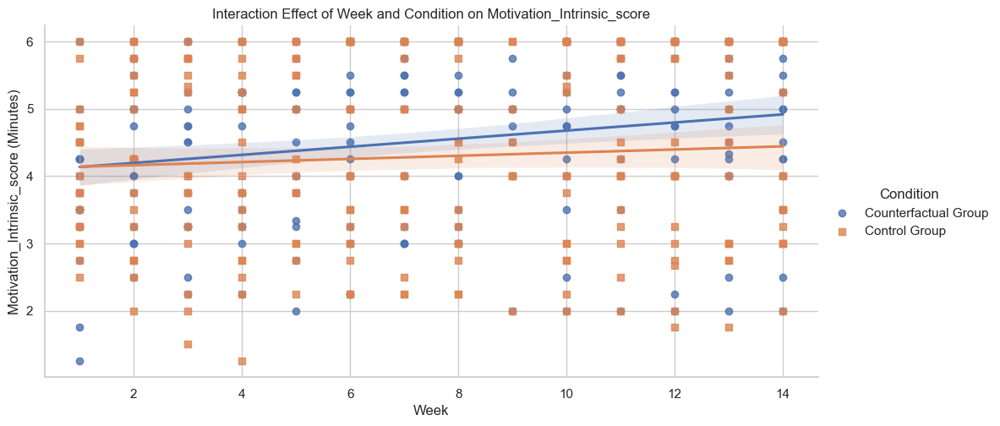

        Source      F  p-unc    ng2
0    Condition  0.128  0.727  0.009
1         Week  2.501  0.004  0.044
2  Interaction  2.021  0.023  0.036


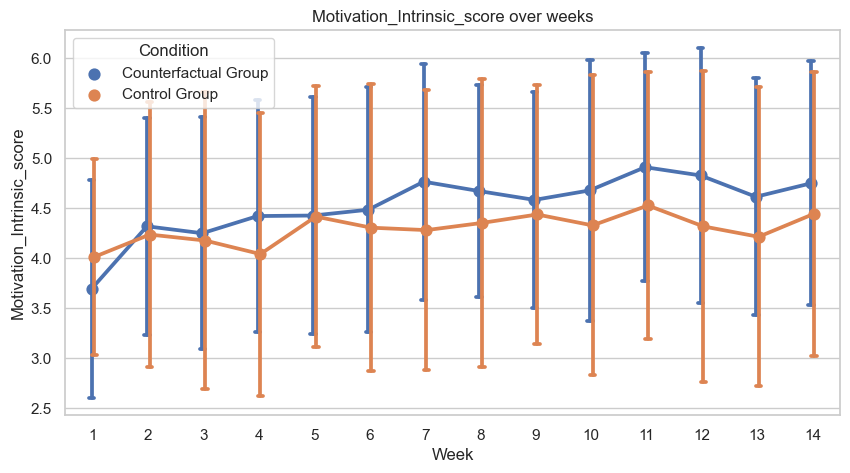


 Motivation_Extrinsic_score

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 3.18 (1.14)
Week 2: 3.50 (0.94)
Week 3: 3.93 (1.22)
Week 4: 3.77 (1.37)
Week 5: 3.91 (1.33)
Week 6: 3.93 (1.35)
Week 7: 3.86 (1.51)
Week 8: 4.16 (1.49)
Week 9: 4.22 (1.55)
Week 10: 4.45 (1.43)
Week 11: 4.27 (1.54)
Week 12: 4.06 (1.78)
Week 13: 4.16 (1.51)
Week 14: 4.22 (1.39)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 3.13 (1.18)
Week 2: 3.04 (1.22)
Week 3: 3.08 (1.30)
Week 4: 3.01 (1.17)
Week 5: 3.10 (1.18)
Week 6: 2.86 (1.35)
Week 7: 3.06 (1.30)
Week 8: 2.97 (1.23)
Week 9: 4.22 (0.69)
Week 10: 3.25 (1.42)
Week 11: 3.24 (1.71)
Week 12: 3.31 (1.62)
Week 13: 2.98 (1.31)
Week 14: 3.18 (1.38)

T-test result:
T-statistic: 7.3508
P-value: 0.0000


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


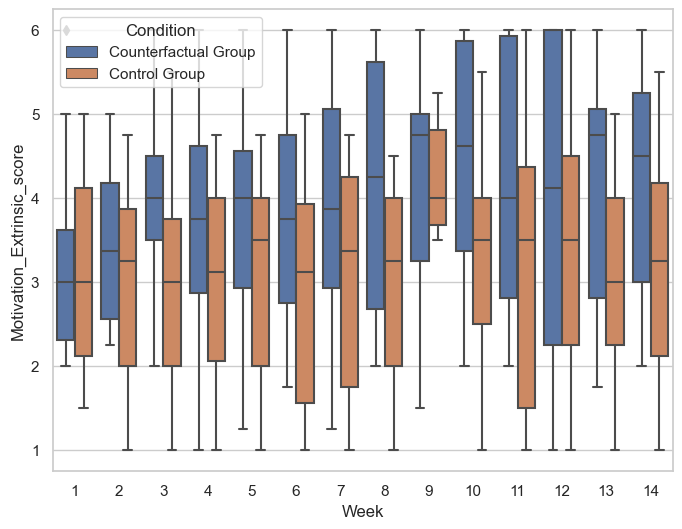

Significant Results found for Motivation_Extrinsic_score:

                    Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Motivation_Extrinsic_score
No. Observations:   450       Method:               ML                        
No. Groups:         37        Scale:                0.2892                    
Min. group size:    3         Log-Likelihood:       -436.1031                 
Max. group size:    14        Converged:            Yes                       
Mean group size:    12.2                                                      
------------------------------------------------------------------------------
                                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------
Intercept                            0.957    0.278  3.447 0.001  0.413  1.501
Condition[T.2.0]                    -0.528    0.177 -2.973 0.003 -0.875 -0.180
Week          

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

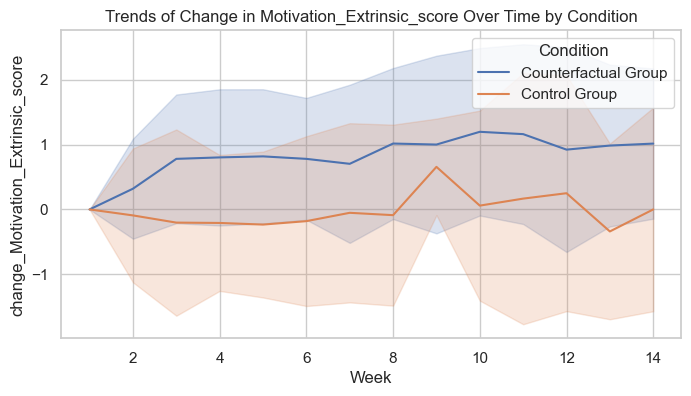

Week 3 Diference between CF & Control Groups:t-stat = 1.9324, p-value = 0.0626
Week 4 Diference between CF & Control Groups:t-stat = 1.7205, p-value = 0.0958
Week 5 Diference between CF & Control Groups:t-stat = 1.8010, p-value = 0.0821
Week 6 Diference between CF & Control Groups:t-stat = 2.3313, p-value = 0.0260
Week 8 Diference between CF & Control Groups:t-stat = 2.4826, p-value = 0.0190
Week 10 Diference between CF & Control Groups:t-stat = 2.3252, p-value = 0.0276
Week 11 Diference between CF & Control Groups:t-stat = 1.7934, p-value = 0.0832
Week 13 Diference between CF & Control Groups:t-stat = 2.2844, p-value = 0.0301
Week 3 Different to Base for Experimental: p-value = 0.0051
Week 4 Different to Base for Experimental: p-value = 0.0080
Week 5 Different to Base for Experimental: p-value = 0.0065
Week 6 Different to Base for Experimental: p-value = 0.0035
Week 7 Different to Base for Experimental: p-value = 0.0357
Week 8 Different to Base for Experimental: p-value = 0.0033
Week 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

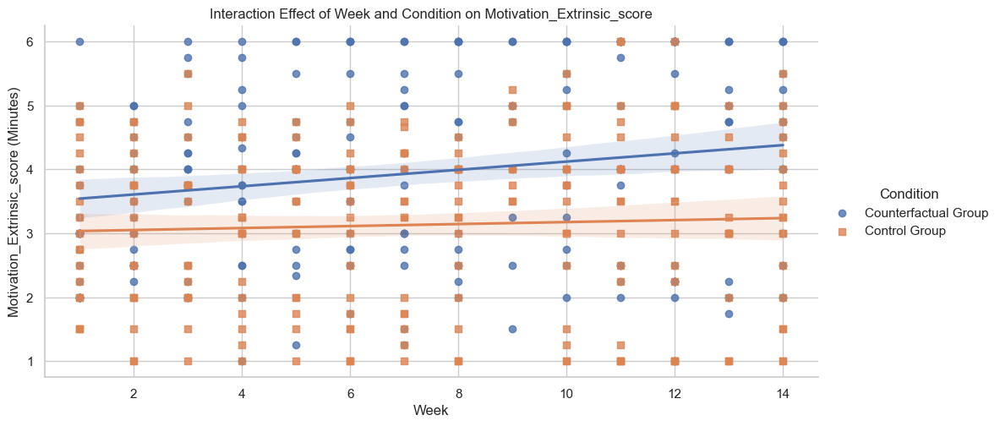

        Source      F  p-unc    ng2
0    Condition  0.008  0.930  0.001
1         Week  2.657  0.002  0.045
2  Interaction  1.585  0.096  0.027


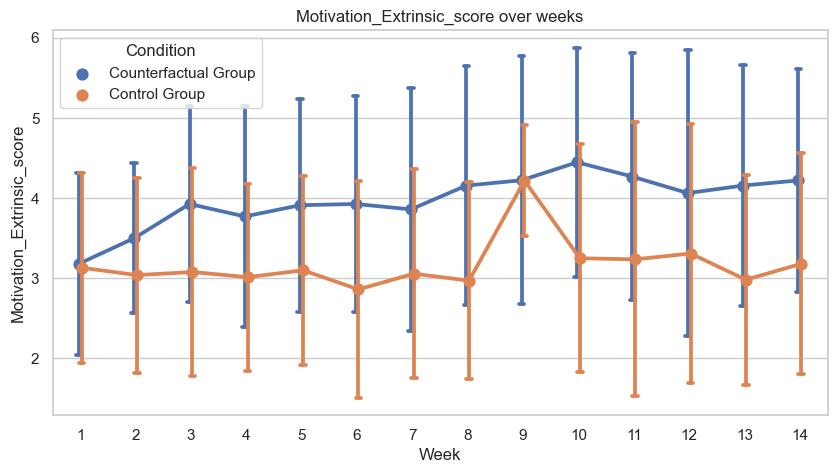


 Intention_to_Engage_in_Physical_Activity_score

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 5.28 (1.31)
Week 2: 5.87 (1.04)
Week 3: 5.65 (1.00)
Week 4: 5.75 (1.02)
Week 5: 6.19 (1.00)
Week 6: 5.49 (1.28)
Week 7: 5.81 (1.55)
Week 8: 6.00 (1.45)
Week 9: 5.74 (1.28)
Week 10: 6.02 (1.39)
Week 11: 5.95 (0.87)
Week 12: 5.81 (1.03)
Week 13: 5.83 (1.12)
Week 14: 6.18 (0.91)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 4.68 (1.36)
Week 2: 5.00 (1.01)
Week 3: 4.92 (1.21)
Week 4: 4.67 (1.51)
Week 5: 4.98 (1.16)
Week 6: 5.00 (1.56)
Week 7: 5.02 (1.47)
Week 8: 4.73 (1.65)
Week 9: 5.17 (1.08)
Week 10: 4.88 (1.52)
Week 11: 4.85 (1.91)
Week 12: 4.73 (1.71)
Week 13: 4.79 (1.60)
Week 14: 4.85 (1.53)

T-test result:
T-statistic: 14.4167
P-value: 0.0000


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


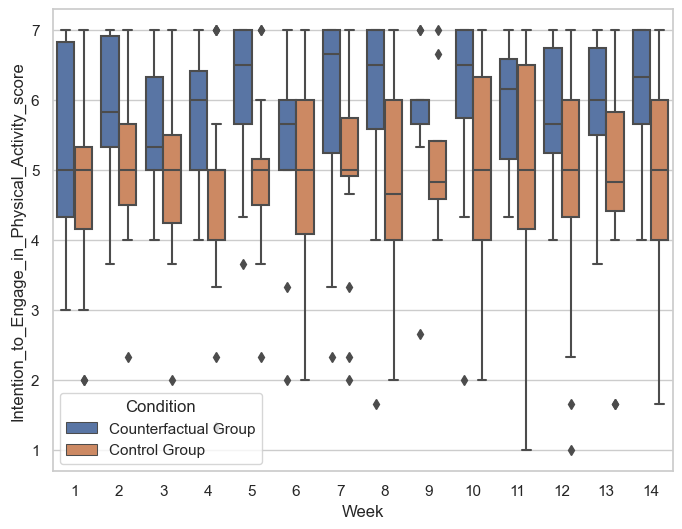

Significant Results found for Intention_to_Engage_in_Physical_Activity_score:

                              Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Intention_to_Engage_in_Physical_Activity_score
No. Observations:   450       Method:               ML                                            
No. Groups:         37        Scale:                0.5426                                        
Min. group size:    3         Log-Likelihood:       -562.6603                                     
Max. group size:    14        Converged:            Yes                                           
Mean group size:    12.2                                                                          
--------------------------------------------------------------------------------------------------
                                                        Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-------------------------------------------------------------

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

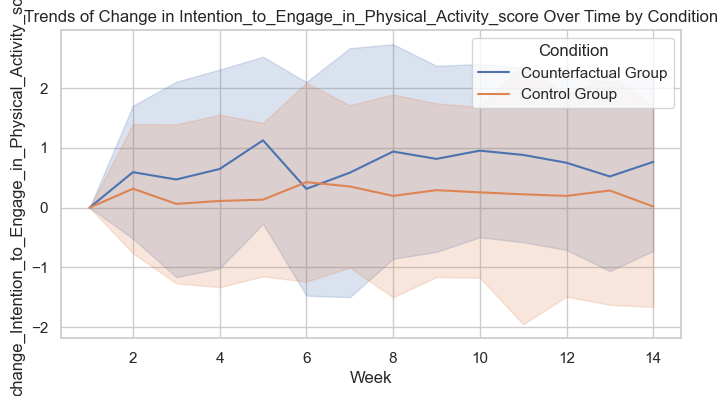

Week 2 Diference between CF & Control Groups:t-stat = 2.5826, p-value = 0.0142
Week 3 Diference between CF & Control Groups:t-stat = 1.8826, p-value = 0.0698
Week 4 Diference between CF & Control Groups:t-stat = 2.4747, p-value = 0.0192
Week 5 Diference between CF & Control Groups:t-stat = 3.0889, p-value = 0.0045
Week 8 Diference between CF & Control Groups:t-stat = 2.3594, p-value = 0.0248
Week 10 Diference between CF & Control Groups:t-stat = 2.1818, p-value = 0.0375
Week 11 Diference between CF & Control Groups:t-stat = 2.1768, p-value = 0.0392
Week 12 Diference between CF & Control Groups:t-stat = 2.2306, p-value = 0.0344
Week 13 Diference between CF & Control Groups:t-stat = 2.0480, p-value = 0.0523
Week 2 Different to Base for Experimental: p-value = 0.0371
Week 5 Different to Base for Experimental: p-value = 0.0057
Week 10 Different to Base for Experimental: p-value = 0.0287
Week 11 Different to Base for Experimental: p-value = 0.0417


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

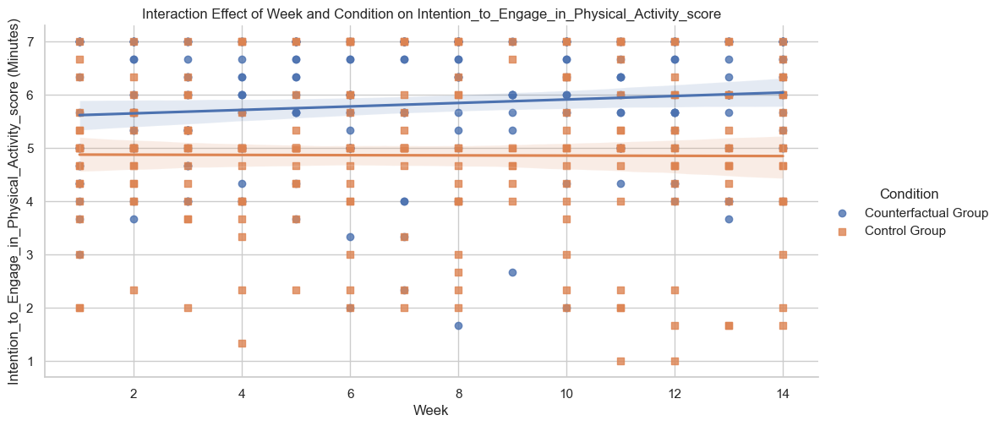

        Source      F  p-unc    ng2
0    Condition  2.991  0.112  0.133
1         Week  1.956  0.029  0.072
2  Interaction  0.957  0.496  0.037


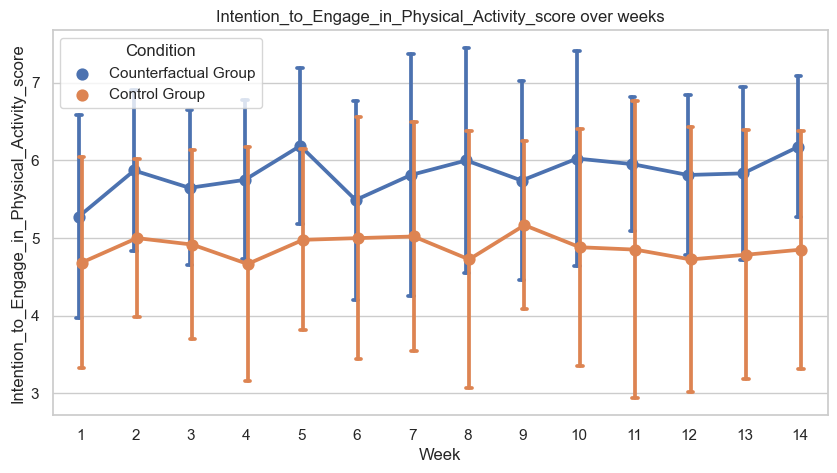


 Motivation

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 3.44 (0.84)
Week 2: 3.91 (0.56)
Week 3: 4.09 (0.69)
Week 4: 4.10 (0.80)
Week 5: 4.17 (0.78)
Week 6: 4.21 (0.72)
Week 7: 4.31 (0.73)
Week 8: 4.41 (0.80)
Week 9: 4.40 (0.84)
Week 10: 4.56 (0.94)
Week 11: 4.59 (0.96)
Week 12: 4.45 (0.99)
Week 13: 4.39 (0.89)
Week 14: 4.49 (0.88)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 3.57 (0.81)
Week 2: 3.64 (0.84)
Week 3: 3.63 (0.97)
Week 4: 3.53 (0.76)
Week 5: 3.76 (0.44)
Week 6: 3.58 (0.75)
Week 7: 3.67 (0.87)
Week 8: 3.66 (0.77)
Week 9: 4.33 (0.58)
Week 10: 3.79 (0.98)
Week 11: 3.88 (1.13)
Week 12: 3.81 (1.05)
Week 13: 3.60 (0.97)
Week 14: 3.81 (0.86)

T-test result:
T-statistic: 7.0716
P-value: 0.0000


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


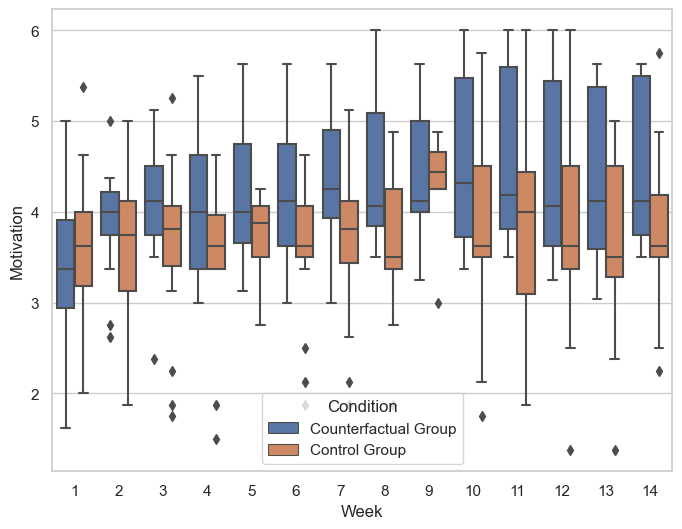

Significant Results found for Motivation:

             Mixed Linear Model Regression Results
Model:                MixedLM   Dependent Variable:   Motivation
No. Observations:     450       Method:               ML        
No. Groups:           37        Scale:                0.1787    
Min. group size:      3         Log-Likelihood:       -312.3116 
Max. group size:      14        Converged:            Yes       
Mean group size:      12.2                                      
----------------------------------------------------------------
                      Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------
Intercept              1.708    0.255  6.686 0.000  1.207  2.209
Condition[T.2.0]      -0.336    0.116 -2.893 0.004 -0.564 -0.108
Week                   0.055    0.013  4.085 0.000  0.028  0.081
Week:Condition[T.2.0] -0.040    0.019 -2.151 0.031 -0.077 -0.004
baseline_Motivation    0.609    0.071  8.617 0.000  0.471  0.

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

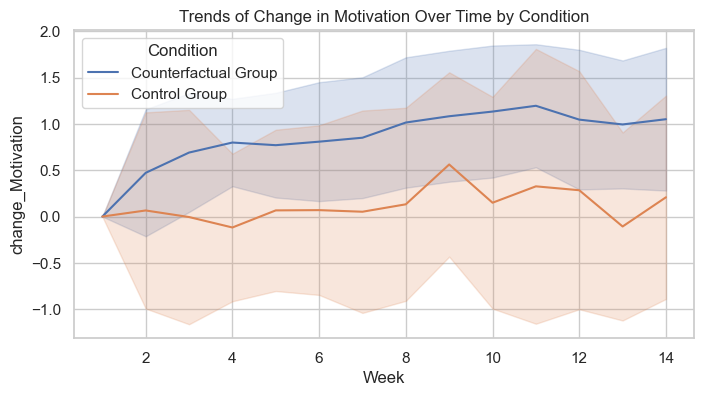

Week 4 Diference between CF & Control Groups:t-stat = 2.1142, p-value = 0.0426
Week 5 Diference between CF & Control Groups:t-stat = 1.8214, p-value = 0.0811
Week 6 Diference between CF & Control Groups:t-stat = 2.4975, p-value = 0.0177
Week 7 Diference between CF & Control Groups:t-stat = 2.2699, p-value = 0.0308
Week 8 Diference between CF & Control Groups:t-stat = 2.7503, p-value = 0.0099
Week 10 Diference between CF & Control Groups:t-stat = 2.2335, p-value = 0.0336
Week 11 Diference between CF & Control Groups:t-stat = 1.9132, p-value = 0.0654
Week 12 Diference between CF & Control Groups:t-stat = 1.7755, p-value = 0.0856
Week 13 Diference between CF & Control Groups:t-stat = 2.3060, p-value = 0.0291
Week 2 Different to Base for Experimental: p-value = 0.0095
Week 3 Different to Base for Experimental: p-value = 0.0004
Week 4 Different to Base for Experimental: p-value = 0.0000
Week 5 Different to Base for Experimental: p-value = 0.0001
Week 6 Different to Base for Experimental: p-

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

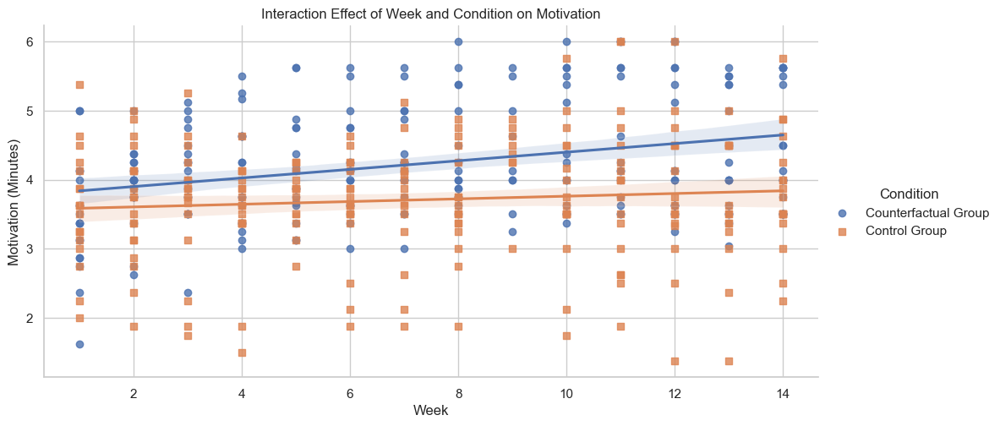

        Source      F  p-unc    ng2
0    Condition  0.049  0.829  0.003
1         Week  4.158  0.000  0.098
2  Interaction  2.779  0.001  0.068


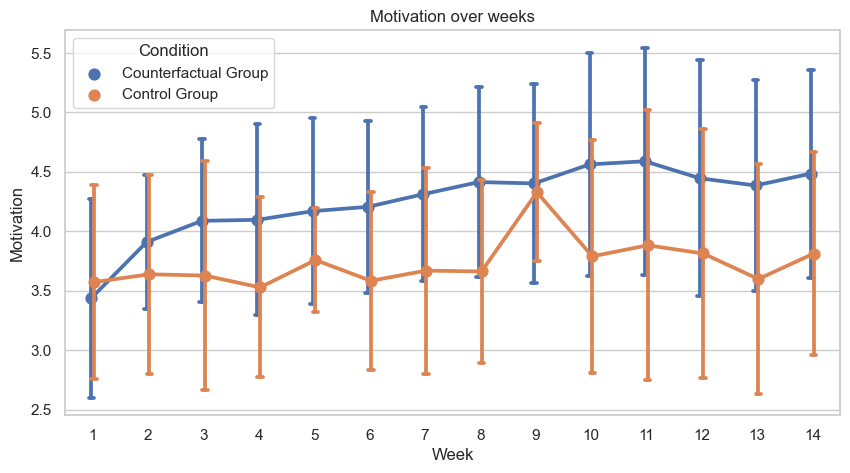


 Self_Efficacy

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 6.35 (1.47)
Week 2: 6.68 (1.58)
Week 3: 6.18 (1.66)
Week 4: 6.56 (1.85)
Week 5: 6.86 (1.89)
Week 6: 6.98 (1.74)
Week 7: 7.38 (1.86)
Week 8: 7.19 (2.08)
Week 9: 7.36 (1.51)
Week 10: 7.18 (1.56)
Week 11: 7.19 (1.79)
Week 12: 7.06 (1.88)
Week 13: 6.92 (1.92)
Week 14: 7.11 (1.68)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 6.27 (1.51)
Week 2: 5.70 (1.25)
Week 3: 5.91 (1.19)
Week 4: 5.80 (1.26)
Week 5: 5.74 (1.31)
Week 6: 5.57 (1.57)
Week 7: 5.50 (1.62)
Week 8: 5.68 (1.95)
Week 9: 6.11 (1.91)
Week 10: 5.77 (1.71)
Week 11: 6.29 (2.01)
Week 12: 5.86 (1.76)
Week 13: 5.52 (1.46)
Week 14: 6.17 (1.83)

T-test result:
T-statistic: 9.9248
P-value: 0.0000


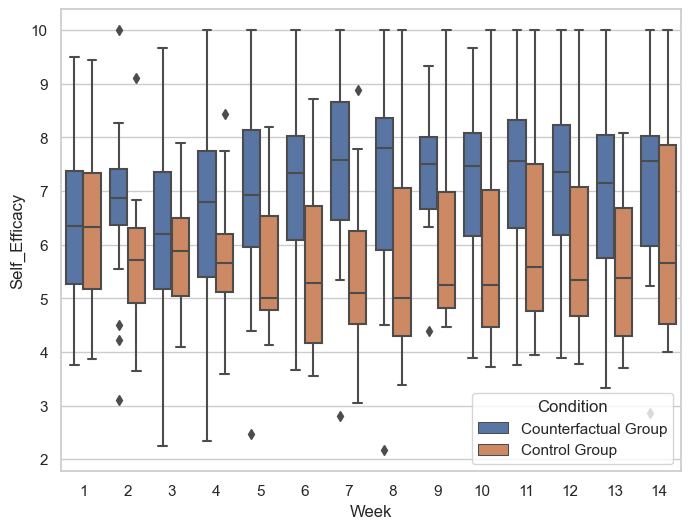

Significant Results found for Self_Efficacy:

              Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Self_Efficacy
No. Observations:   451       Method:               ML           
No. Groups:         37        Scale:                0.4377       
Min. group size:    3         Log-Likelihood:       -534.0597    
Max. group size:    14        Converged:            Yes          
Mean group size:    12.2                                         
-----------------------------------------------------------------
                       Coef.  Std.Err.   z    P>|z| [0.025 0.975]
-----------------------------------------------------------------
Intercept               1.010    0.479  2.108 0.035  0.071  1.949
Condition[T.2.0]       -0.614    0.210 -2.919 0.004 -1.026 -0.202
Week                    0.063    0.030  2.090 0.037  0.004  0.122
Week:Condition[T.2.0]  -0.048    0.042 -1.132 0.258 -0.130  0.035
baseline_Self_Efficacy  0.857    0.072 11.94

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

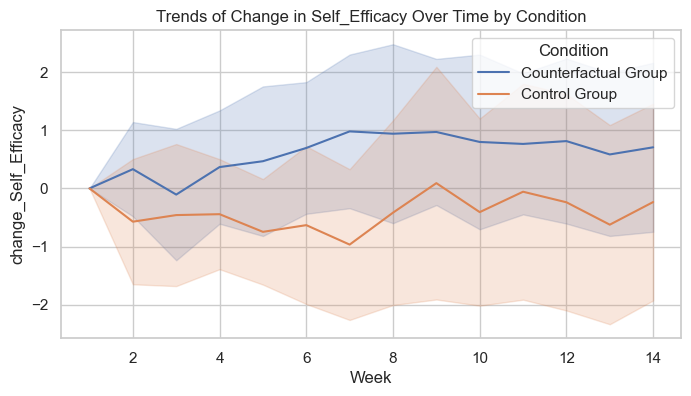

Week 2 Diference between CF & Control Groups:t-stat = 2.0943, p-value = 0.0442
Week 5 Diference between CF & Control Groups:t-stat = 1.9190, p-value = 0.0657
Week 6 Diference between CF & Control Groups:t-stat = 2.5090, p-value = 0.0173
Week 7 Diference between CF & Control Groups:t-stat = 3.0393, p-value = 0.0049
Week 8 Diference between CF & Control Groups:t-stat = 2.1395, p-value = 0.0405
Week 10 Diference between CF & Control Groups:t-stat = 2.4177, p-value = 0.0221
Week 12 Diference between CF & Control Groups:t-stat = 1.8883, p-value = 0.0685
Week 13 Diference between CF & Control Groups:t-stat = 2.2681, p-value = 0.0314
Week 6 Different to Base for Experimental: p-value = 0.0222
Week 7 Different to Base for Experimental: p-value = 0.0096
Week 8 Different to Base for Experimental: p-value = 0.0273
Week 9 Different to Base for Experimental: p-value = 0.0492
Week 11 Different to Base for Experimental: p-value = 0.0345
Week 12 Different to Base for Experimental: p-value = 0.0367
Wee

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

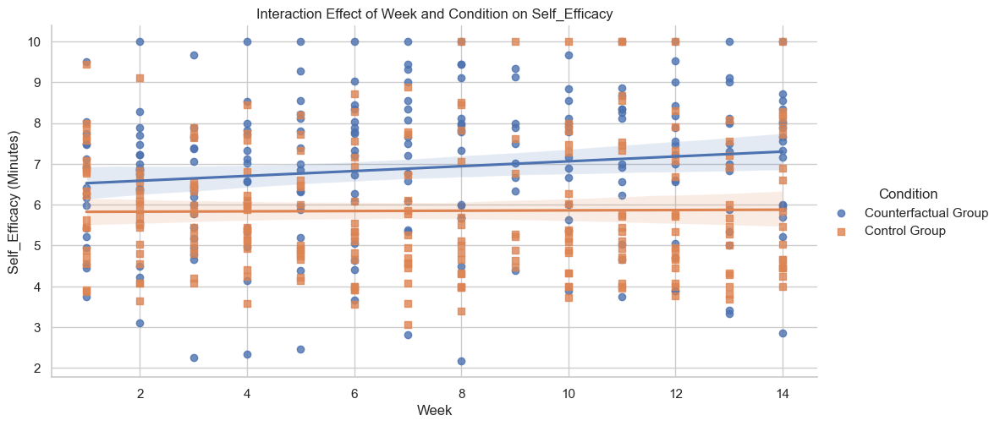

        Source      F  p-unc    ng2
0    Condition  2.413  0.149  0.151
1         Week  1.240  0.257  0.021
2  Interaction  1.808  0.047  0.030


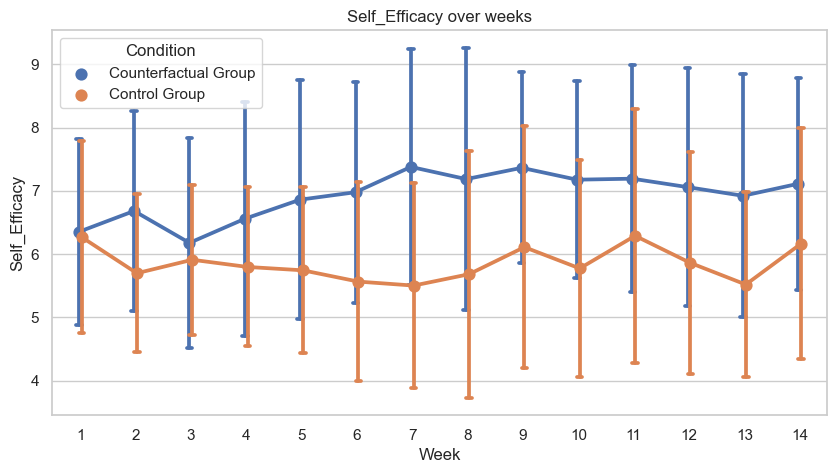


 Overall_Intention

Experimental Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 5.28 (1.31)
Week 2: 5.92 (0.73)
Week 3: 5.71 (0.72)
Week 4: 5.85 (0.75)
Week 5: 5.98 (0.77)
Week 6: 5.52 (0.94)
Week 7: 6.04 (0.93)
Week 8: 6.01 (0.98)
Week 9: 5.88 (1.14)
Week 10: 6.00 (1.19)
Week 11: 5.96 (0.80)
Week 12: 5.91 (1.03)
Week 13: 5.88 (1.00)
Week 14: 6.10 (0.78)

Control Group Mean (Std) survey by Week:
Week 0: nan (nan)
Week 1: 4.68 (1.36)
Week 2: 5.00 (1.01)
Week 3: 4.92 (1.21)
Week 4: 4.67 (1.51)
Week 5: 4.98 (1.16)
Week 6: 5.00 (1.56)
Week 7: 5.02 (1.47)
Week 8: 4.73 (1.65)
Week 9: 5.17 (1.08)
Week 10: 4.88 (1.52)
Week 11: 4.85 (1.91)
Week 12: 4.73 (1.71)
Week 13: 4.79 (1.60)
Week 14: 4.85 (1.53)

T-test result:
T-statistic: 17.5346
P-value: 0.0000


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


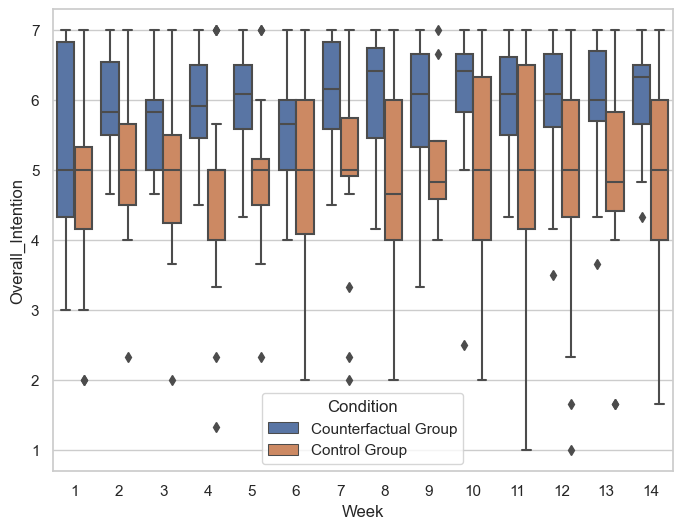

Significant Results found for Overall_Intention:

                Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Overall_Intention
No. Observations:   455       Method:               ML               
No. Groups:         37        Scale:                0.4532           
Min. group size:    3         Log-Likelihood:       -529.0761        
Max. group size:    14        Converged:            Yes              
Mean group size:    12.3                                             
---------------------------------------------------------------------
                           Coef.  Std.Err.   z    P>|z| [0.025 0.975]
---------------------------------------------------------------------
Intercept                   2.680    0.425  6.305 0.000  1.847  3.513
Condition[T.2.0]           -0.416    0.190 -2.193 0.028 -0.788 -0.044
Week                        0.030    0.022  1.383 0.167 -0.013  0.074
Week:Condition[T.2.0]      -0.031    0.031 -1.025 0.306 

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_2901/1860258532.py:99: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to T

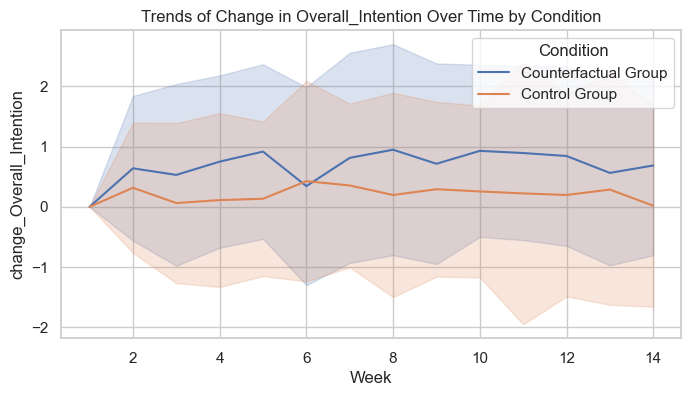

Week 2 Diference between CF & Control Groups:t-stat = 3.1709, p-value = 0.0033
Week 3 Diference between CF & Control Groups:t-stat = 2.2515, p-value = 0.0337
Week 4 Diference between CF & Control Groups:t-stat = 2.9569, p-value = 0.0066
Week 5 Diference between CF & Control Groups:t-stat = 2.8076, p-value = 0.0098
Week 7 Diference between CF & Control Groups:t-stat = 2.3469, p-value = 0.0271
Week 8 Diference between CF & Control Groups:t-stat = 2.7385, p-value = 0.0109
Week 10 Diference between CF & Control Groups:t-stat = 2.2908, p-value = 0.0294
Week 11 Diference between CF & Control Groups:t-stat = 2.2343, p-value = 0.0350
Week 12 Diference between CF & Control Groups:t-stat = 2.4182, p-value = 0.0227
Week 13 Diference between CF & Control Groups:t-stat = 2.1960, p-value = 0.0394
Week 2 Different to Base for Experimental: p-value = 0.0374
Week 5 Different to Base for Experimental: p-value = 0.0231
Week 8 Different to Base for Experimental: p-value = 0.0469
Week 10 Different to Base 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

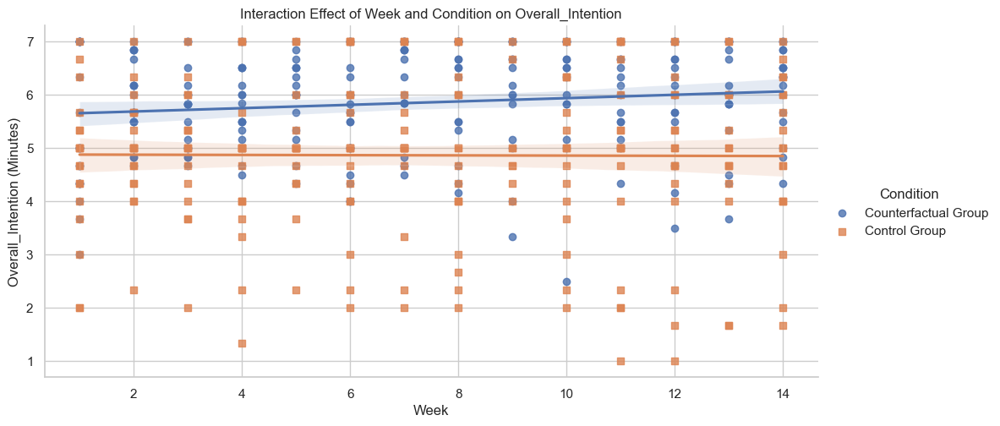

        Source      F  p-unc    ng2
0    Condition  9.989  0.008  0.303
1         Week  3.554  0.000  0.106
2  Interaction  1.015  0.439  0.033


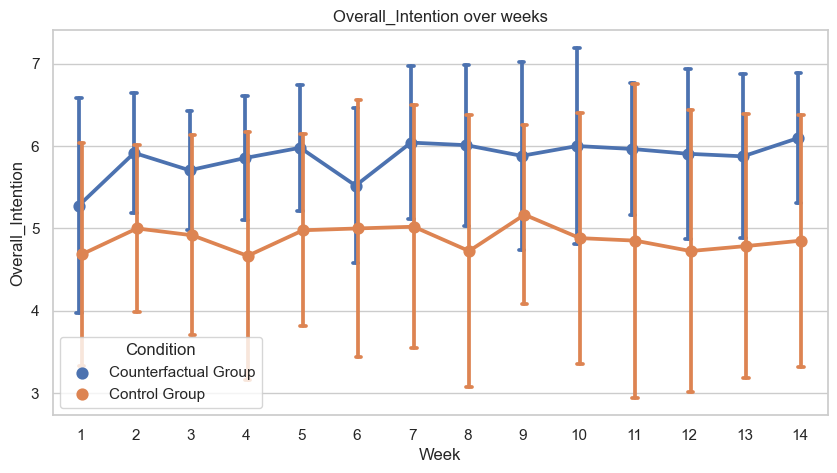

In [95]:
######### Hypothesis 2: Longitudinal Analysis of Survey Metrics over the interview weeks
# Function to check significant interaction in the mixed-effects model
def check_significant_interaction(model):
    # Check if the p-value for the interaction term (Week:Condition) is significant
    for param, pvalue in model.pvalues.items():
        if "Condition" in param and pvalue <= 0.9:
            return True
    return False
df_full_survey = df[['Participant_ID', 'Week','Condition','age']+ Survey_columns]

for survey_col in Survey_columns:
    df_survey = df_full_survey[['Participant_ID', 'Week','Condition','age', survey_col]]
    
    df_survey_baseline = df_survey[df_survey['Week'] == 1][['Participant_ID', survey_col]].rename(columns={survey_col: 'baseline_' + survey_col})
    # Merge baseline with the main dataframe
    df_survey = df_survey.merge(df_survey_baseline, on='Participant_ID')
    df_survey[f'change_{survey_col}'] = df_survey[survey_col] - df_survey[f'baseline_{survey_col}']

    metric_col = survey_col
    change_col = f'change_{survey_col}'
    print( '\n', metric_col)

    experimental_group = df_survey[df_survey['Condition'] == 1]
    control_group = df_survey[df_survey['Condition'] == 2]
    
    # Group by 'Week' and calculate the mean survey for each group
    mean_experimental = experimental_group[experimental_group['Week']>1].groupby('Week')[survey_col].mean()
    mean_control = control_group[control_group['Week']>1].groupby('Week')[survey_col].mean()

    # Perform an independent t-test to compare the means of the two groups
    # Drop any NaN values if necessary (in case there are weeks with missing data)
    t_stat, p_value = ttest_ind(mean_experimental.dropna(), mean_control.dropna(), equal_var=False)
    
    experimental_stats = experimental_group.groupby('Week')[survey_col].agg(['mean', 'std'])
    control_stats = control_group.groupby('Week')[survey_col].agg(['mean', 'std'])

    # Print the mean and std for the experimental group in the format: mean (std)
    print("\nExperimental Group Mean (Std) survey by Week:")
    for week, row in experimental_stats.iterrows():
        print(f"Week {week}: {row['mean']:.2f} ({row['std']:.2f})")

    # Print the mean and std for the control group in the format: mean (std)
    print("\nControl Group Mean (Std) survey by Week:")
    for week, row in control_stats.iterrows():
        print(f"Week {week}: {row['mean']:.2f} ({row['std']:.2f})")

    print(f"\nT-test result:")
    print(f"T-statistic: {t_stat:.4f}")
    print(f"P-value: {p_value:.4f}")

    baseline_experimental = experimental_group[survey_col][experimental_group['Week'] == 1]
    baseline_control = control_group[survey_col][control_group['Week'] == 1]

    # Perform t-test for each week
    t_stats_groups = []
    p_values_groups = []
    t_stats_prepost_experimental, p_values_prepost_experimental = [], []
    t_stats_prepost_control, p_values_prepost_control = [], []
    for week in range(1, 14):  # Weeks 1 to 13
        exp_week_data = experimental_group[experimental_group['Week'] == week][survey_col]
        ctrl_week_data = control_group[control_group['Week'] == week][survey_col]
        if week != 1 :
            t_stat_prepost, p_value_prepost = ttest_rel(baseline_experimental, exp_week_data, nan_policy='omit')
            t_stats_prepost_experimental.append(t_stat_prepost)
            p_values_prepost_experimental.append(p_value_prepost)
            
        if week != 1 :
            t_stat_prepost, p_value_prepost = ttest_rel(baseline_control, ctrl_week_data, nan_policy='omit')
            t_stats_prepost_control.append(t_stat_prepost)
            p_values_prepost_control.append(p_value_prepost)
            
        if len(exp_week_data) > 0 and len(ctrl_week_data) > 0:
            t_stat_groups, p_value_groups = ttest_ind(exp_week_data, ctrl_week_data, equal_var=False, nan_policy='omit')
            t_stats_groups.append(t_stat_groups)
            p_values_groups.append(p_value_groups)
    df_survey = df_survey.dropna(subset=[survey_col]).reset_index(drop=True) #[['Participant_ID', 'Week', 'Condition', survey_col]]
    
    fixed_effects=['Week','Condition']
    random_effect_col='Participant_ID'
    df_survey['Condition'] = df_survey['Condition'].astype('category')

#     formula = f"{survey_col} ~ {' * '.join(fixed_effects)}"
    formula = f"{survey_col} ~  Condition + Week +{'baseline_' + survey_col}+ Week:Condition" #+Week:Condition:{'baseline_' + survey_col}
    model = smf.mixedlm(formula, df_survey, groups=df_survey[random_effect_col], re_formula="~Week").fit(reml=False)

    if check_significant_interaction(model) and p_value<=0.1:
        df_survey['Condition'] = df_survey['Condition'].map({1: 'Counterfactual Group', 2: 'Control Group'})
        plt.figure(figsize=(8,6))
        sns.boxplot(x='Week', y=survey_col, 
                    hue='Condition', data=df_survey)
        plt.show()
        print(f"Significant Results found for {survey_col}:\n")
        print(model.summary())
        
        # Plot the trends over time for each group
        sns.set(style="whitegrid")

        plt.figure(figsize=(8, 4))
        sns.lineplot(x='Week', y=f'change_{survey_col}', hue='Condition', data=df_survey, ci="sd")
        plt.title(f'Trends of Change in {survey_col} Over Time by Condition')
        plt.xlabel('Week')
        plt.ylabel(f'change_{survey_col}')
        plt.show()

            # Weeks with significant CF Control Differences
        for week, p_value in enumerate(p_values_groups, start=1):
            if p_value < 0.1:
                print(f'Week {week} Diference between CF & Control Groups:t-stat = {t_stats_groups[week-1]:.4f}, p-value = {p_value:.4f}')
                
            # Weeks with significant Pre Post Differences for CF Group
        for week, p_value in enumerate(p_values_prepost_experimental, start=2):
            if p_value < 0.05:
                print(f'Week {week} Different to Base for Experimental: p-value = {p_value:.4f}')
            # Weeks with significant Pre Post Differences for Control Group
        for week, p_value in enumerate(p_values_prepost_control, start=2):
            if p_value < 0.05:
                print(f'Week {week} Different to Base for Control: p-value = {p_value:.4f}')

        # Interaction plot
        plt.figure(figsize=(10, 5))
        sns.lmplot(x='Week', y=survey_col, hue='Condition', data=df_survey, aspect=2, markers=["o", "s"])
        plt.title(f'Interaction Effect of Week and Condition on {survey_col}')
        plt.xlabel('Week')
        plt.ylabel(f'{survey_col} (Minutes)')
        plt.show()

        # Fit repeated measures ANOVA
        rm_anova = pg.mixed_anova(dv=survey_col, 
                               within='Week', 
                               subject='Participant_ID', 
                               between='Condition', 
                               data=df_survey, effsize='ng2')
        # Filter the rm_anova results to show only the relevant columns
        important_columns = ['Source', 'F', 'p-unc', 'ng2']  # Only show Source, F-value, p-value, and effect size (η²)
        print(rm_anova[important_columns].round(3))
        
        plt.figure(figsize=(10, 5))
        sns.pointplot(data=df_survey, x='Week', y=survey_col, hue='Condition', dodge=True, capsize=.1, errorbar='sd')
        _ = plt.title(f'{survey_col} over weeks')
        plt.show()


In [91]:
df_full_survey = df[['Participant_ID','age','Week','Condition']+ main_Survey_columns]


for survey_col in main_Survey_columns:
    df_survey = df_full_survey[['Participant_ID', 'Week','age', 'Condition', survey_col]]
    print( '\n', survey_col)
    
    df_survey_baseline = df_survey[df_survey['Week'] == 1][['Participant_ID', survey_col]].rename(columns={survey_col: 'baseline_' + survey_col})
    # Merge baseline with the main dataframe
    df_survey = df_survey.merge(df_survey_baseline, on='Participant_ID')
    df_survey[f'change_{survey_col}'] = df_survey[survey_col] - df_survey[f'baseline_{survey_col}']
    baseline_survey_col = 'baseline_' + survey_col

    df_survey = df_survey.dropna(subset=[survey_col]).reset_index(drop=True) #[['Participant_ID', 'Week', 'Condition','age','BMI', activity_col]]

    fixed_effects=[ 'Week','Condition']
    random_effect_col='Participant_ID'
    df_survey['Condition'] = df_survey['Condition'].astype('category')

    formula = f"{survey_col} ~ {' * '.join(fixed_effects)}"
    formula1 = f"{survey_col} ~ Week + Condition+age + Week:Condition"
    formula2 = f"{survey_col} ~ {baseline_survey_col} + Week + Condition+age + Week:Condition"
    formula3 = f"{survey_col} ~ {baseline_survey_col} + Week + Condition+age + Week:Condition + Week:Condition:age"
    formula4 = f"{survey_col} ~ {baseline_survey_col} +Condition + Week+age + Week:Condition + Week:Condition:{baseline_survey_col}" 
    formula = f"{survey_col} ~  {baseline_survey_col} + Condition + Week+age + Week:Condition + Week:Condition:{baseline_survey_col} +Week:Condition:age"  #+ Week:Condition:{'baseline_' + activity_col}
    
    model = smf.mixedlm(formula, df_survey, groups=df_survey[random_effect_col], re_formula="~Week").fit(reml=False)
    print(f"Main Model AIC: {model.aic}")
    log_likelihood = model.llf  # Log-likelihood
    k = len(model.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
    print(f"Manual AIC: {aic_manual}")
    print("Main Model Converged:", model.converged)

    formula_ = f"{survey_col} ~  Condition + Week + Week:Condition + Week:Condition:{baseline_survey_col} +Week:Condition:age"  #+ Week:Condition:{'baseline_' + activity_col}
    model_ = smf.mixedlm(formula, df_survey, groups=df_survey[random_effect_col]).fit(reml=False)
    print(f"\n2 Model AIC: {model_.aic}")
    log_likelihood = model_.llf  # Log-likelihood
    k = len(model_.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
    print(f"Manual AIC: {aic_manual}")
    print("2 Model Converged:", model_.converged)
    
    
    # Model 1: Random intercept
    model1 = smf.mixedlm(formula1, df_survey, groups=df_survey['Participant_ID'], re_formula="~Week").fit(reml=False)
    print(f"\nModel 1 AIC: {model1.aic}")
    log_likelihood = model1.llf  # Log-likelihood
    k = len(model1.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
    print(f"Manual AIC: {aic_manual}")
    print("Model Converged:", model1.converged)


    # Model 2: Random intercept + random slope for Week
    model2 = smf.mixedlm(formula2, df_survey, groups=df_survey['Participant_ID'], re_formula="~Week").fit(reml=False)
    print(f"\nModel 2 AIC: {model2.aic}")
    log_likelihood = model2.llf  # Log-likelihood
    k = len(model2.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
    print(f"Manual AIC: {aic_manual}")
    print("Model Converged:", model2.converged)


    # Model 3: Random intercept for participants + random intercept for baseline survey
    model3 = smf.mixedlm(formula3, df_survey, groups=df_survey['Participant_ID'], re_formula="~Week").fit(reml=False)
    print(f"\nModel 3 AIC: {model3.aic}")
    log_likelihood = model3.llf  # Log-likelihood
    k = len(model3.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
    print(f"Manual AIC: {aic_manual}")
    print("Model Converged:", model3.converged)

    
    # Model 2: Random intercept + random slope for Week
    model4 = smf.mixedlm(formula4, df_survey, groups=df_survey['Participant_ID'], re_formula="~Week").fit(reml=False)
    print(f"\nModel 4 AIC: {model4.aic}")
    log_likelihood = model1.llf  # Log-likelihood
    k = len(model1.params)  # Number of parameters
    aic_manual = -2 * log_likelihood + 2 * k
    print(f"Manual AIC: {aic_manual}")
    print("Model Converged:", model4.converged)


#     # Model 3: Random intercept for participants + random intercept for baseline activity
#     model3 = smf.mixedlm(formula3, df_activity, groups=df_activity['Participant_ID'], re_formula="~Week:Condition").fit(reml=True)
#     print(f"Model 3 AIC: {model3.aic}")
    
    
    best_model = min([model,model_, model1, model2, model3, model4], key=lambda x: x.aic)

    # Print the summary of the best model
    print(best_model.summary())
    
    model4.summary()


 Recode_of_contemplation_ladder


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


Main Model AIC: 1408.3367803305937
Manual AIC: 1406.3367803305937
Main Model Converged: True

2 Model AIC: 1439.7738773286374
Manual AIC: 1437.7738773286374
2 Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization fai


Model 1 AIC: 1548.0577878141166
Manual AIC: 1546.0577878141166
Model Converged: False


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)



Model 2 AIC: 1408.727939451328
Manual AIC: 1406.727939451328
Model Converged: True

Model 3 AIC: 1412.1488075554576
Manual AIC: 1410.1488075554576
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)



Model 4 AIC: 1405.0765677735749
Manual AIC: 1546.0577878141166
Model Converged: True
                                Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         Recode_of_contemplation_ladder
No. Observations:           449             Method:                     ML                            
No. Groups:                 37              Scale:                      0.9720                        
Min. group size:            3               Log-Likelihood:             -690.5383                     
Max. group size:            14              Converged:                  Yes                           
Mean group size:            12.1                                                                      
------------------------------------------------------------------------------------------------------
                                                            Coef.  Std.Err.   z    P>|z| [0.025 0.975]
--------------------

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


Main Model AIC: 1072.7856646787254
Manual AIC: 1070.7856646787254
Main Model Converged: True

2 Model AIC: 1094.4105327063694
Manual AIC: 1092.4105327063694
2 Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)



Model 1 AIC: 1120.5362887279703
Manual AIC: 1118.5362887279703
Model Converged: True

Model 2 AIC: 1070.32650238514
Manual AIC: 1068.32650238514
Model Converged: True

Model 3 AIC: 1069.035426971191
Manual AIC: 1067.035426971191
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)



Model 4 AIC: 1073.9516710562198
Manual AIC: 1118.5362887279703
Model Converged: True
                   Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Self_Efficacy_Task_score
No. Observations:   451       Method:               ML                      
No. Groups:         37        Scale:                0.4470                  
Min. group size:    3         Log-Likelihood:       -522.5177               
Max. group size:    14        Converged:            Yes                     
Mean group size:    12.2                                                    
----------------------------------------------------------------------------
                                  Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                          1.050    0.735  1.429 0.153 -0.390  2.489
Condition[T.2.0]                  -0.611    0.246 -2.486 0.013 -1.092 -0.129
baseline_S

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization fai


Model 1 AIC: 1649.8502046957078
Manual AIC: 1647.8502046957078
Model Converged: False

Model 2 AIC: 1538.7246972720422
Manual AIC: 1536.7246972720422
Model Converged: True

Model 3 AIC: 1542.254762568169
Manual AIC: 1540.254762568169
Model Converged: True

Model 4 AIC: 1535.8635996832409
Manual AIC: 1647.8502046957078
Model Converged: True
                                Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         Self_Efficacy_Scheduling_score
No. Observations:           451             Method:                     ML                            
No. Groups:                 37              Scale:                      1.2099                        
Min. group size:            3               Log-Likelihood:             -755.9318                     
Max. group size:            14              Converged:                  Yes                           
Mean group size:            12.2                                        

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


Main Model AIC: 918.1979972705517
Manual AIC: 916.1979972705517
Main Model Converged: True

2 Model AIC: 953.3930974706491
Manual AIC: 951.3930974706491
2 Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2262: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)



Model 1 AIC: 1049.7839874830179
Manual AIC: 1047.7839874830179
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)



Model 2 AIC: 915.4892577287724
Manual AIC: 913.4892577287724
Model Converged: True

Model 3 AIC: 915.5698424276261
Manual AIC: 913.5698424276261
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)



Model 4 AIC: 918.0130946863592
Manual AIC: 1047.7839874830179
Model Converged: True
                    Mixed Linear Model Regression Results
Model:              MixedLM   Dependent Variable:   Motivation_Intrinsic_score
No. Observations:   450       Method:               ML                        
No. Groups:         37        Scale:                0.3141                    
Min. group size:    3         Log-Likelihood:       -447.7446                 
Max. group size:    14        Converged:            Yes                       
Mean group size:    12.2                                                      
------------------------------------------------------------------------------
                                    Coef.  Std.Err.   z    P>|z| [0.025 0.975]
------------------------------------------------------------------------------
Intercept                            1.175    0.595  1.976 0.048  0.010  2.341
Condition[T.2.0]                    -0.212    0.213 -0.992 0.321 -0

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with lbfgs
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2201: ConvergenceWarning: Retrying MixedLM optimization with cg
  warnings.warn(
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization fai


Model 1 AIC: 970.0544127945423
Manual AIC: 968.0544127945423
Model Converged: False

Model 2 AIC: 892.1366518058699
Manual AIC: 890.1366518058699
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)



Model 3 AIC: 896.0935802989029
Manual AIC: 894.0935802989029
Model Converged: True

Model 4 AIC: 891.9798486135783
Manual AIC: 968.0544127945423
Model Converged: True
                              Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         Motivation_Extrinsic_score
No. Observations:           450             Method:                     ML                        
No. Groups:                 37              Scale:                      0.2891                    
Min. group size:            3               Log-Likelihood:             -433.9899                 
Max. group size:            14              Converged:                  Yes                       
Mean group size:            12.2                                                                  
--------------------------------------------------------------------------------------------------
                                                        Coef.  Std.Err.

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


Main Model AIC: 1140.995882075992
Manual AIC: 1138.995882075992
Main Model Converged: True

2 Model AIC: 1182.6183343132207
Manual AIC: 1180.6183343132207
2 Model Converged: True

Model 1 AIC: 1174.6983054933244
Manual AIC: 1172.6983054933244
Model Converged: True


/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)



Model 2 AIC: 1144.1317792959312
Manual AIC: 1142.1317792959312
Model Converged: True

Model 3 AIC: 1145.5162604406346
Manual AIC: 1143.5162604406346
Model Converged: True

Model 4 AIC: 1139.828938262166
Manual AIC: 1172.6983054933244
Model Converged: True
                                        Mixed Linear Model Regression Results
Model:                      MixedLM         Dependent Variable:         Intention_to_Engage_in_Physical_Activity_score
No. Observations:           450             Method:                     ML                                            
No. Groups:                 37              Scale:                      0.5415                                        
Min. group size:            3               Log-Likelihood:             -557.9145                                     
Max. group size:            14              Converged:                  Yes                                           
Mean group size:            12.2                                      

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/statsmodels/regression/mixed_linear_model.py:2238: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


In [187]:
import statsmodels.api as sm

df_exp = df[df['Condition'] == 1]  # Filter for experimental group

for act_col in main_activity_columns:
    for cf_col in main_CF_columns:
        for survey_col in main_Survey_columns:
            df_mediate = df_exp[[survey_col , act_col , cf_col] + [ 'Week']].dropna().reset_index(drop=True)
            
            # Outcome model: Activity ~ CF + Survey + Covariates
            outcome = df_mediate[act_col].dropna().reset_index(drop=True)
            outcome_predictors = f"{cf_col} + {survey_col} +  Week"
            outcome_exog = patsy.dmatrix(outcome_predictors, df_mediate, return_type='dataframe').reset_index(drop=True)
            outcome_model = sm.OLS(outcome, outcome_exog)

            # Mediator model: Survey ~ CF + Covariates
            mediator = df_mediate[survey_col]
            mediator_predictors = f"{cf_col} + Week"
            mediator_exog = patsy.dmatrix(mediator_predictors, df_mediate, return_type='dataframe')
            mediator_model = sm.OLS(mediator, mediator_exog)

            # Find positions of treatment variable in both models
            tx_pos = [outcome_exog.columns.get_loc(cf_col), mediator_exog.columns.get_loc(cf_col)]
            # Find position of mediator variable in outcome model
            med_pos = outcome_exog.columns.get_loc(survey_col)
            
            # Mediation analysis
            mediation = Mediation(outcome_model, mediator_model, tx_pos, med_pos)
            results = mediation.fit()
            summary_str = str(results.summary())
            acme_pvalue_line = [line for line in summary_str.split('\n') if 'ACME (average)' in line][0]
            acme_pvalue = float(acme_pvalue_line.split()[-1])
            ade_pvalue_line = [line for line in summary_str.split('\n') if 'ADE (average)' in line][0]
            ade_pvalue = float(ade_pvalue_line.split()[-1])
            
            if (acme_pvalue < 0.05) and (ade_pvalue < 0.05):
                print(f"--- {act_col} - {cf_col} - {survey_col} ---")
                print(results.summary(), '\n\n')
 


--- Weekly_Active_Minute_average - Overall_CF1 - Self_Efficacy_Coping_score ---
                          Estimate  Lower CI bound  Upper CI bound  P-value
ACME (control)            2.365155        0.634802        4.778800    0.002
ACME (treated)            2.365155        0.634802        4.778800    0.002
ADE (control)             4.492215        1.366153        7.673470    0.006
ADE (treated)             4.492215        1.366153        7.673470    0.006
Total effect              6.857371        3.300181       10.089017    0.000
Prop. mediated (control)  0.340073        0.101024        0.676516    0.002
Prop. mediated (treated)  0.340073        0.101024        0.676516    0.002
ACME (average)            2.365155        0.634802        4.778800    0.002
ADE (average)             4.492215        1.366153        7.673470    0.006
Prop. mediated (average)  0.340073        0.101024        0.676516    0.002 


--- Weekly_Active_Minute_average - Overall_CF1 - Self_Efficacy_Task_score ---
   

--- Weekly_Active_Minute_average - Overall_CF2 - Motivation ---
                          Estimate  Lower CI bound  Upper CI bound  P-value
ACME (control)            2.787472        0.810044        5.294448    0.004
ACME (treated)            2.787472        0.810044        5.294448    0.004
ADE (control)             4.304671        1.163945        7.524494    0.000
ADE (treated)             4.304671        1.163945        7.524494    0.000
Total effect              7.092143        3.703380       10.610740    0.000
Prop. mediated (control)  0.386852        0.129979        0.748517    0.004
Prop. mediated (treated)  0.386852        0.129979        0.748517    0.004
ACME (average)            2.787472        0.810044        5.294448    0.004
ADE (average)             4.304671        1.163945        7.524494    0.000
Prop. mediated (average)  0.386852        0.129979        0.748517    0.004 


--- avg_calories - Overall_CF1 - Recode_of_contemplation_ladder ---
                            E

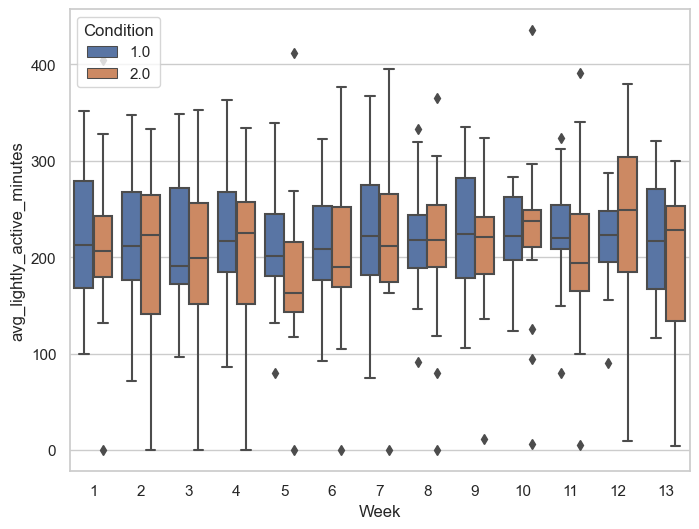


Significant Results found for avg_lightly_active_minutes:
                      Mixed Linear Model Regression Results
Model:                MixedLM    Dependent Variable:    avg_lightly_active_minutes
No. Observations:     189        Method:                REML                      
No. Groups:           18         Scale:                 1300.6970                 
Min. group size:      1          Log-Likelihood:        -958.8315                 
Max. group size:      12         Converged:             Yes                       
Mean group size:      10.5                                                        
----------------------------------------------------------------------------------
                                     Coef.   Std.Err.   z    P>|z|  [0.025  0.975]
----------------------------------------------------------------------------------
Intercept                             20.516   50.817  0.404 0.686 -79.083 120.115
Week                                  10.919    4.6

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

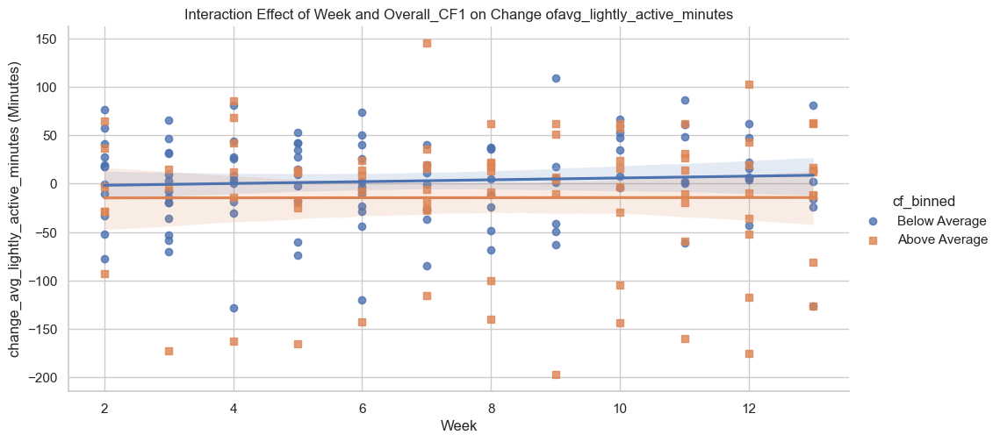

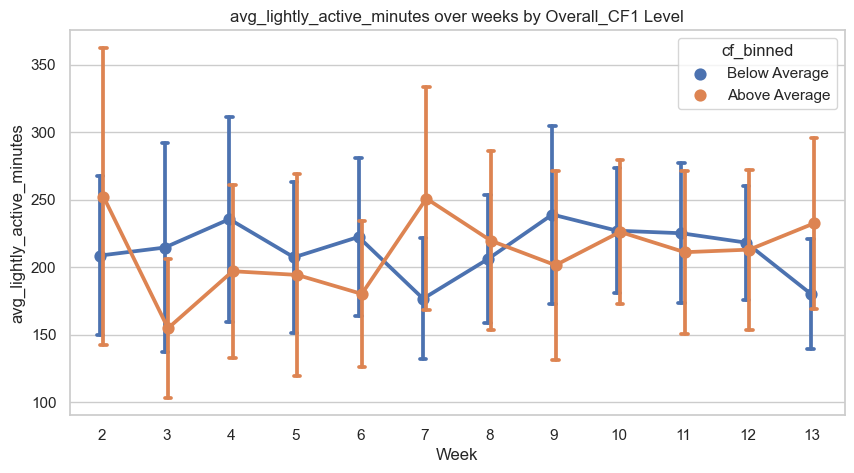


Significant correlation Overall_CF2 and avg_lightly_active_minutes: corr=0.1868, p=0.0101
Significant regression for Overall_CF2 predicting avg_lightly_active_minutes: p-value=0.0512
                                OLS Regression Results                                
Dep. Variable:     avg_lightly_active_minutes   R-squared:                       0.021
Model:                                    OLS   Adj. R-squared:                  0.010
Method:                         Least Squares   F-statistic:                     1.951
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):              0.145
Time:                                14:47:46   Log-Likelihood:                -1049.1
No. Observations:                         189   AIC:                             2104.
Df Residuals:                             186   BIC:                             2114.
Df Model:                                   2                                         
Covariance Type:                 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

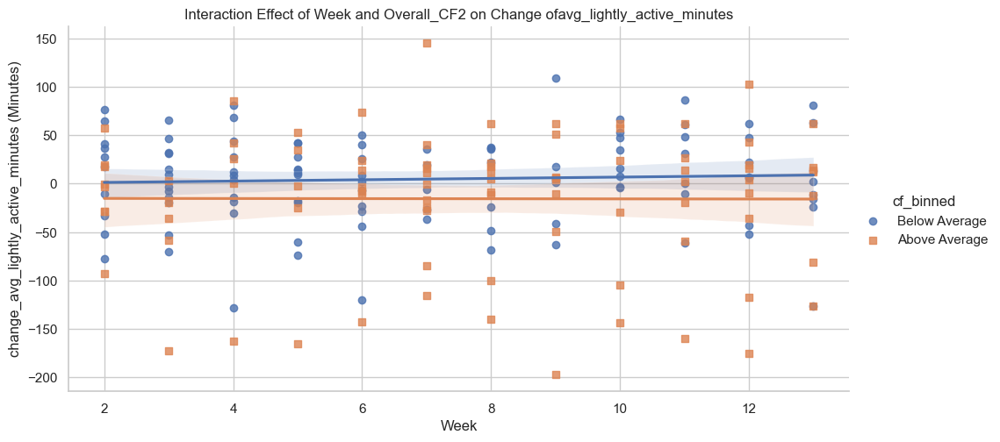

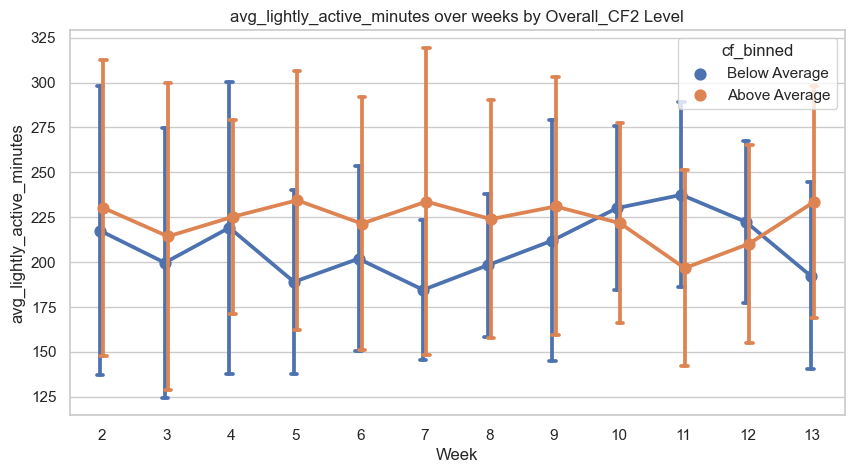


Significant Results found for avg_lightly_active_minutes:
                      Mixed Linear Model Regression Results
Model:                MixedLM    Dependent Variable:    avg_lightly_active_minutes
No. Observations:     189        Method:                REML                      
No. Groups:           18         Scale:                 1328.0690                 
Min. group size:      1          Log-Likelihood:        -960.6096                 
Max. group size:      12         Converged:             Yes                       
Mean group size:      10.5                                                        
----------------------------------------------------------------------------------
                                     Coef.   Std.Err.   z    P>|z|  [0.025  0.975]
----------------------------------------------------------------------------------
Intercept                             42.948   40.750  1.054 0.292 -36.920 122.817
Week                                   6.755    3.7

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

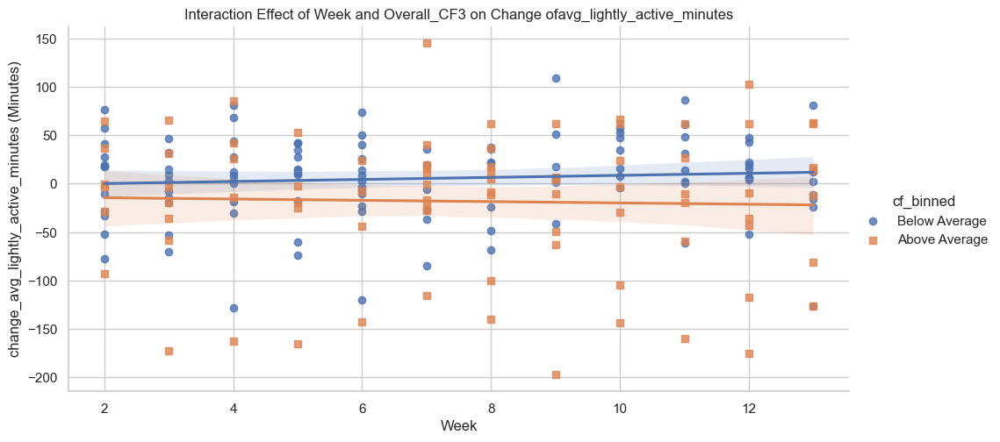

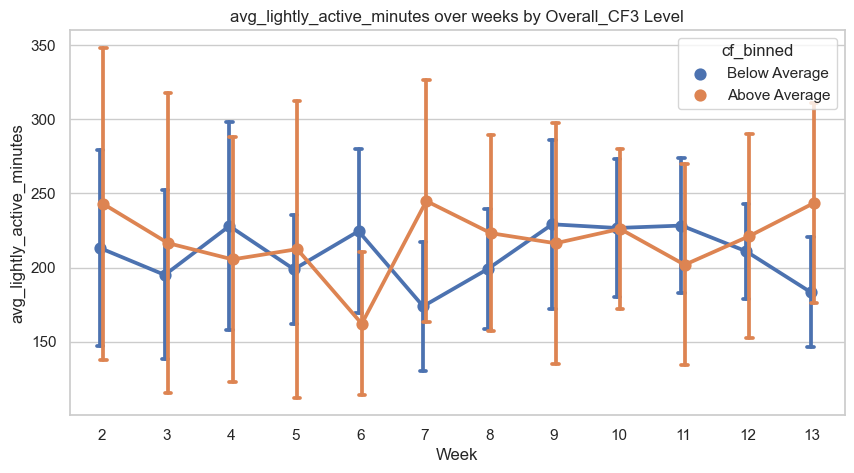


Significant Results found for avg_lightly_active_minutes:
                      Mixed Linear Model Regression Results
Model:               MixedLM    Dependent Variable:    avg_lightly_active_minutes
No. Observations:    467        Method:                REML                      
No. Groups:          37         Scale:                 2309.3472                 
Min. group size:     10         Log-Likelihood:        -2504.9393                
Max. group size:     13         Converged:             Yes                       
Mean group size:     12.6                                                        
---------------------------------------------------------------------------------
                                     Coef.   Std.Err.   z    P>|z| [0.025  0.975]
---------------------------------------------------------------------------------
Intercept                             72.741   17.929  4.057 0.000 37.601 107.881
Week                                   0.858    0.749  1.146 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

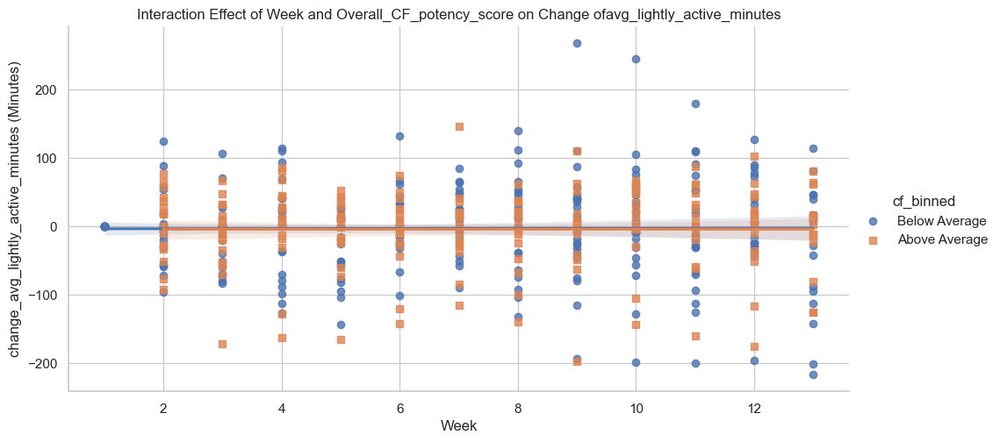

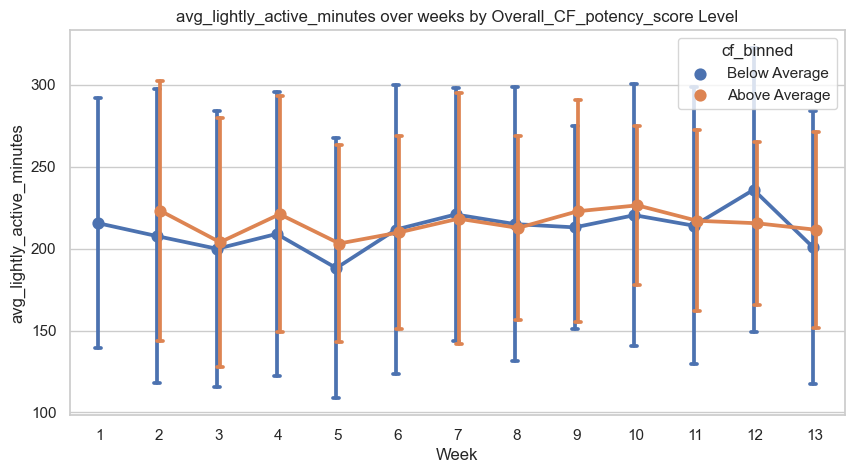


Significant correlation Overall_CF_Intention and avg_lightly_active_minutes: corr=0.1909, p=0.0085
Significant regression for Overall_CF_Intention predicting avg_lightly_active_minutes: p-value=0.0655
                                OLS Regression Results                                
Dep. Variable:     avg_lightly_active_minutes   R-squared:                       0.018
Model:                                    OLS   Adj. R-squared:                  0.008
Method:                         Least Squares   F-statistic:                     1.743
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):              0.178
Time:                                14:47:49   Log-Likelihood:                -1049.4
No. Observations:                         189   AIC:                             2105.
Df Residuals:                             186   BIC:                             2114.
Df Model:                                   2                                         
Covariance Type

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

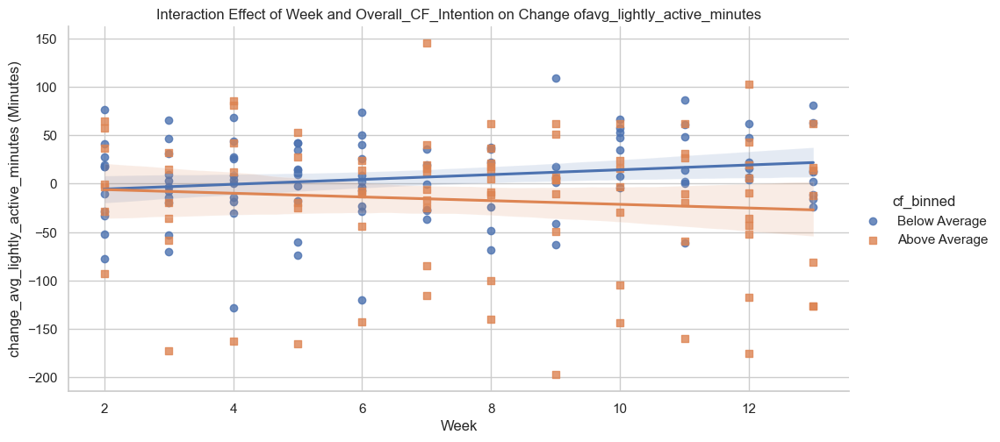

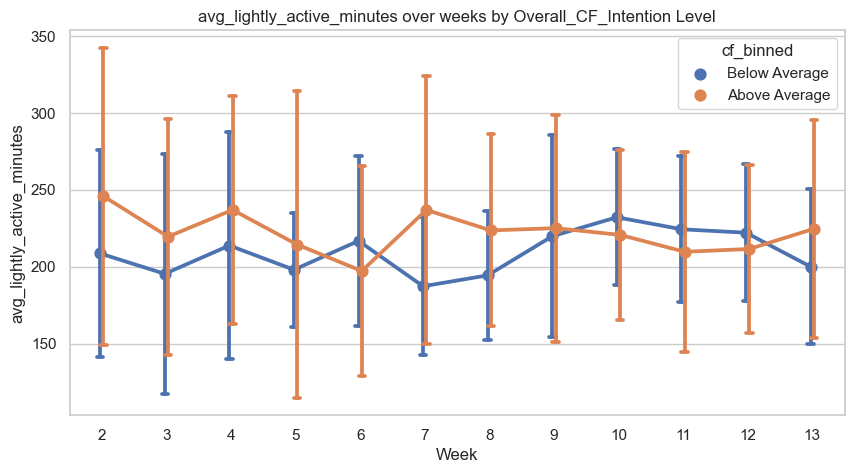


Effects of CF_columns on avg_lightly_active_minutes (sorted by effect size):
CF_column: Overall_CF_Intention, Coefficient: 8.7390, p-value: 0.0655
CF_column: Overall_CF2, Coefficient: 8.6497, p-value: 0.0512
CF_column: Overall_CF3, Coefficient: 5.5286, p-value: 0.1437
CF_column: Overall_CF1, Coefficient: 4.5094, p-value: 0.2970
CF_column: Overall_CF_potency_score, Coefficient: 0.1446, p-value: 0.4381
-------------------------------------------------- 



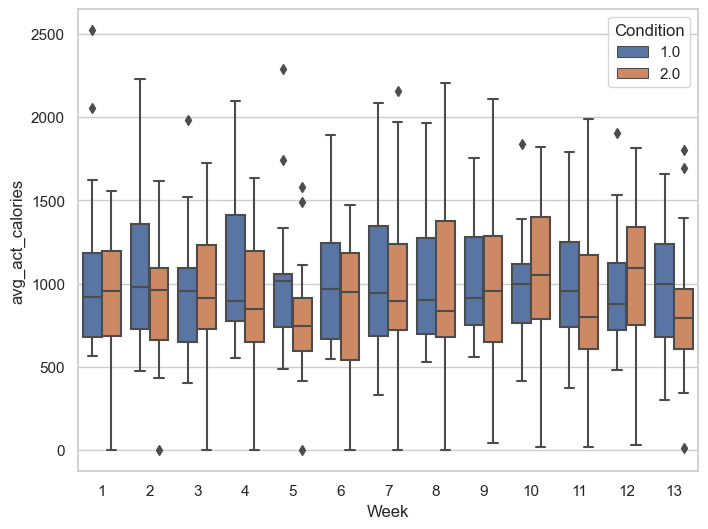


Significant correlation Overall_CF1 and avg_act_calories: corr=0.2051, p=0.0046
Significant regression for Overall_CF1 predicting avg_act_calories: p-value=0.0004
                            OLS Regression Results                            
Dep. Variable:       avg_act_calories   R-squared:                       0.070
Model:                            OLS   Adj. R-squared:                  0.060
Method:                 Least Squares   F-statistic:                     6.989
Date:                Mon, 30 Sep 2024   Prob (F-statistic):            0.00118
Time:                        14:47:50   Log-Likelihood:                -1398.5
No. Observations:                 189   AIC:                             2803.
Df Residuals:                     186   BIC:                             2813.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t  

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

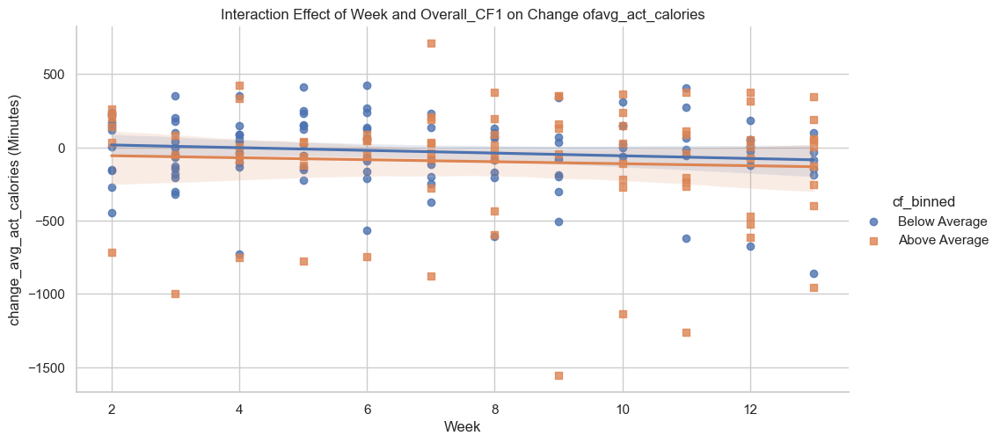

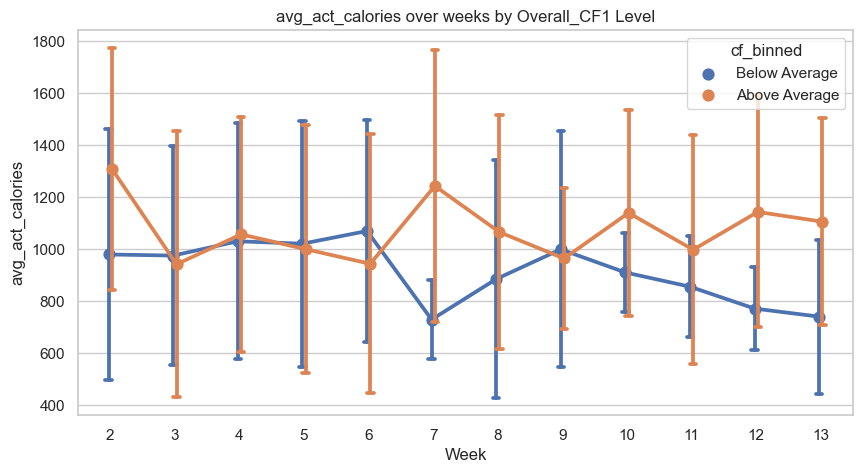


Significant correlation Overall_CF2 and avg_act_calories: corr=0.3210, p=0.0000
Significant regression for Overall_CF2 predicting avg_act_calories: p-value=0.0000
                            OLS Regression Results                            
Dep. Variable:       avg_act_calories   R-squared:                       0.104
Model:                            OLS   Adj. R-squared:                  0.095
Method:                 Least Squares   F-statistic:                     10.82
Date:                Mon, 30 Sep 2024   Prob (F-statistic):           3.59e-05
Time:                        14:47:50   Log-Likelihood:                -1395.0
No. Observations:                 189   AIC:                             2796.
Df Residuals:                     186   BIC:                             2806.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t  

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

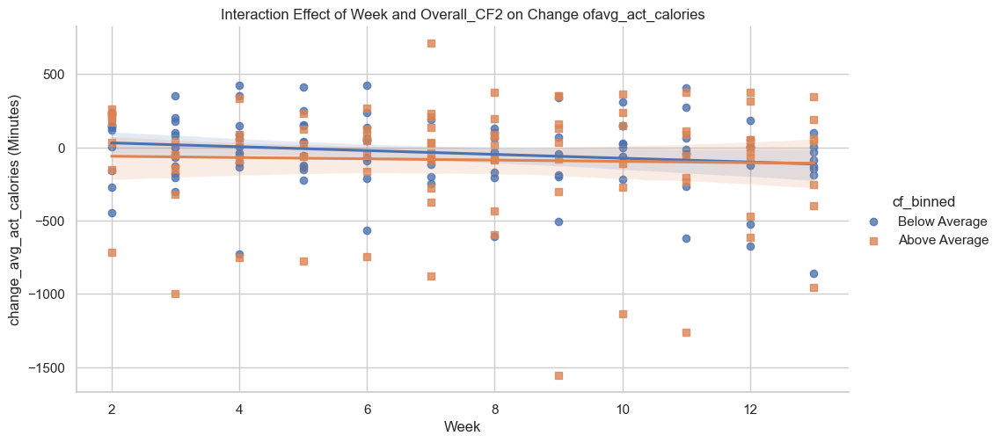

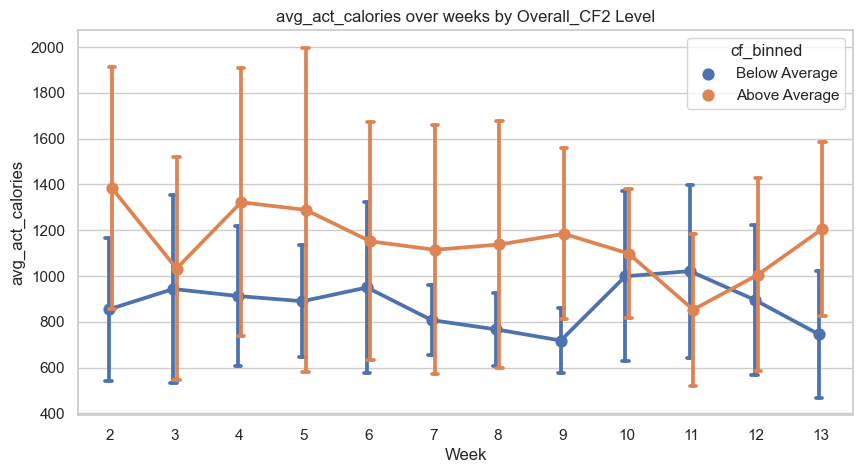


Significant correlation Overall_CF3 and avg_act_calories: corr=0.1105, p=0.1302
Significant regression for Overall_CF3 predicting avg_act_calories: p-value=0.0192
                            OLS Regression Results                            
Dep. Variable:       avg_act_calories   R-squared:                       0.034
Model:                            OLS   Adj. R-squared:                  0.023
Method:                 Least Squares   F-statistic:                     3.256
Date:                Mon, 30 Sep 2024   Prob (F-statistic):             0.0407
Time:                        14:47:51   Log-Likelihood:                -1402.1
No. Observations:                 189   AIC:                             2810.
Df Residuals:                     186   BIC:                             2820.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                  coef    std err          t  

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

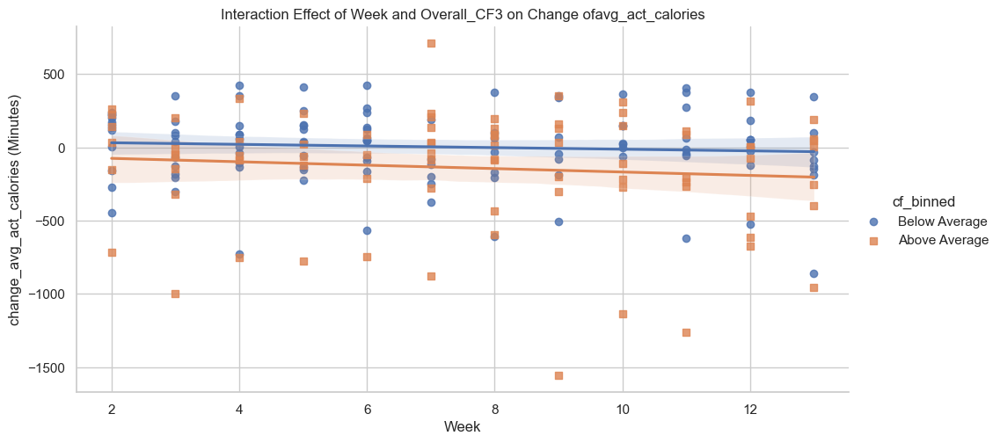

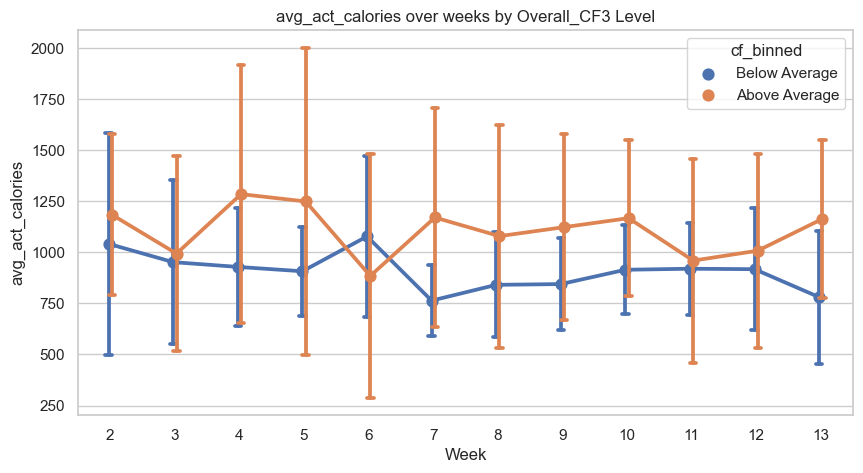


Significant correlation Overall_CF_potency_score and avg_act_calories: corr=0.0599, p=0.1964
Significant regression for Overall_CF_potency_score predicting avg_act_calories: p-value=0.0141
                            OLS Regression Results                            
Dep. Variable:       avg_act_calories   R-squared:                       0.013
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     3.037
Date:                Mon, 30 Sep 2024   Prob (F-statistic):             0.0490
Time:                        14:47:52   Log-Likelihood:                -3496.2
No. Observations:                 467   AIC:                             6998.
Df Residuals:                     464   BIC:                             7011.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                    

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

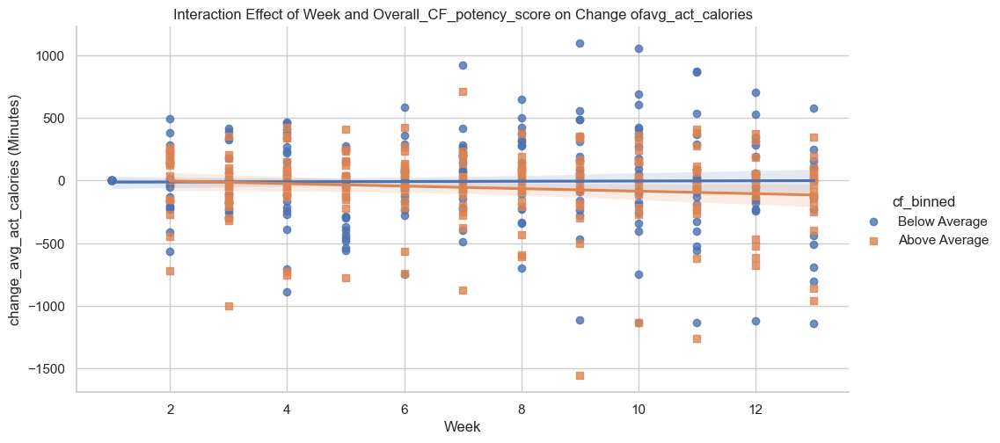

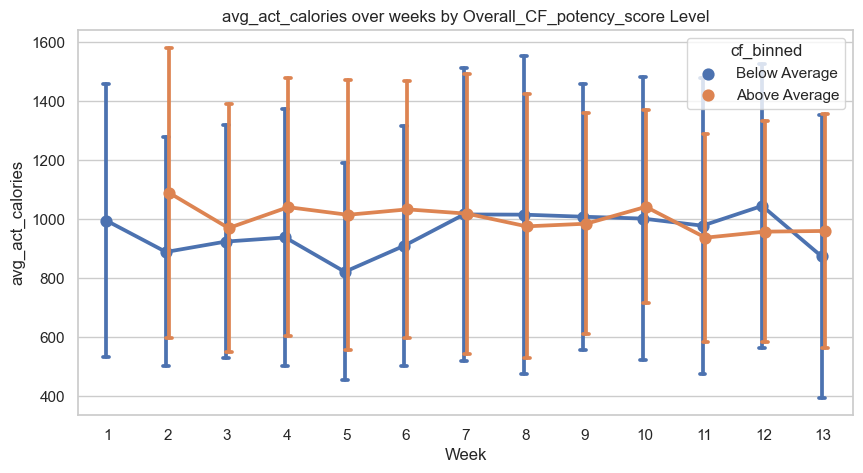


Significant correlation Overall_CF_Intention and avg_act_calories: corr=0.2619, p=0.0003
Significant regression for Overall_CF_Intention predicting avg_act_calories: p-value=0.0014
                            OLS Regression Results                            
Dep. Variable:       avg_act_calories   R-squared:                       0.058
Model:                            OLS   Adj. R-squared:                  0.048
Method:                 Least Squares   F-statistic:                     5.707
Date:                Mon, 30 Sep 2024   Prob (F-statistic):            0.00393
Time:                        14:47:52   Log-Likelihood:                -1399.7
No. Observations:                 189   AIC:                             2805.
Df Residuals:                     186   BIC:                             2815.
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                           c

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

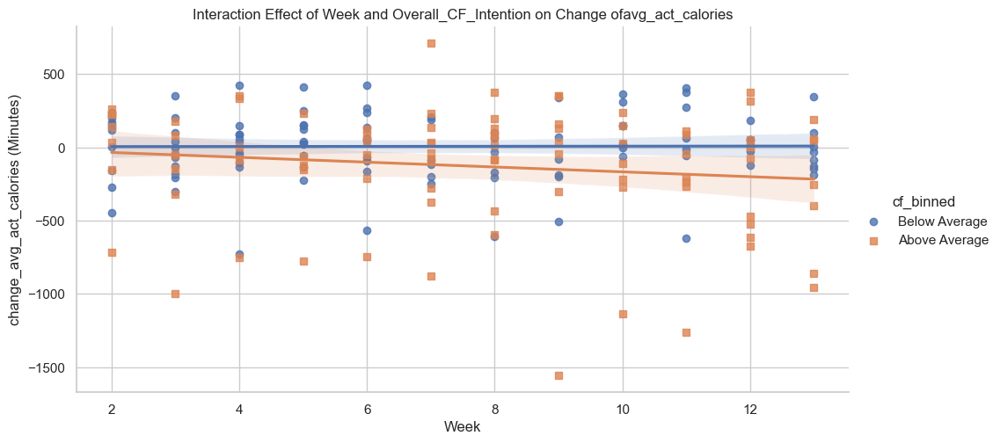

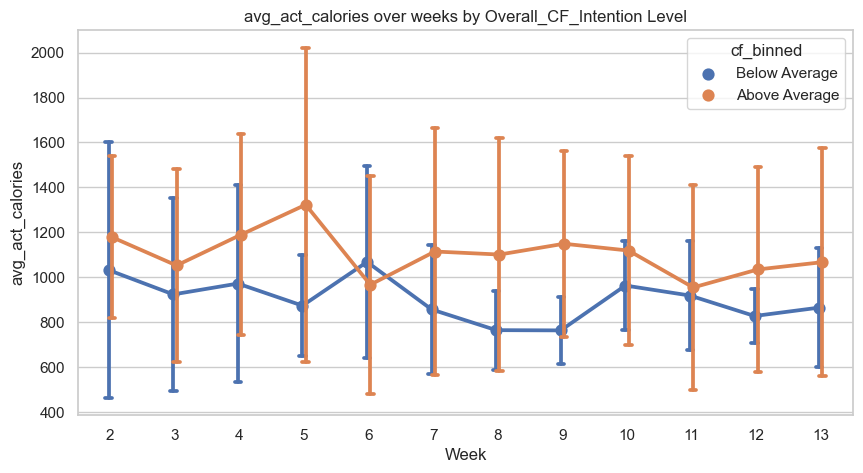


Effects of CF_columns on avg_act_calories (sorted by effect size):
CF_column: Overall_CF2, Coefficient: 124.8193, p-value: 0.0000
CF_column: Overall_CF1, Coefficient: 98.0592, p-value: 0.0004
CF_column: Overall_CF_Intention, Coefficient: 97.4112, p-value: 0.0014
CF_column: Overall_CF3, Coefficient: 57.3282, p-value: 0.0192
CF_column: Overall_CF_potency_score, Coefficient: 2.6937, p-value: 0.0141
-------------------------------------------------- 



In [34]:
######## Hypothesis 3: Counterfactual Impact on PA & Comparison of PA over Weeks between Groups
def run_spearman_correlation(df, col1, col2):
    corr, p_value = spearmanr(df[col1], df[col2])
    return corr, p_value

def check_significant_interaction(model):
    # Check if the p-value for the interaction term (Week:Condition) is significant
    for param, pvalue in model.pvalues.items():
        if "Week" in param and pvalue <= 0.9:
            return True
    return False

main_CF_columns = ['Overall_CF1','Overall_CF2','Overall_CF3','Overall_CF_potency_score','Overall_CF_Intention']
main_activity_columns = ['avg_lightly_active_minutes','avg_act_calories']

for activity_col in main_activity_columns:
    df_activity = df[['Participant_ID', 'Week', 'Condition','BMI', activity_col]].dropna()

    plt.figure(figsize=(8,6))
    sns.boxplot(x='Week', y=activity_col, 
                hue='Condition', data=df_activity)
    plt.show()
    experimental_group = df_activity[df_activity['Condition'] == 1]
    control_group = df_activity[df_activity['Condition'] == 2]
    
    mean_experimental = experimental_group.groupby('Week')[activity_col].mean()
    mean_control = control_group.groupby('Week')[activity_col].mean()
    pre = experimental_group[experimental_group['Week'] == 1][activity_col]
    # Perform t-test for each week
    t_stats_groups = []
    p_values_groups = []
    t_stats_prepost = []
    p_values_prepost = []
    for week in range(1, 14):  # Weeks 1 to 13
        exp_week_data = experimental_group[experimental_group['Week'] == week][activity_col]
        ctrl_week_data = control_group[control_group['Week'] == week][activity_col]
        if week != 1 and len(pre)==len(exp_week_data):
            t_stat_prepost, p_value_prepost = ttest_rel(pre, exp_week_data)
            t_stats_prepost.append(t_stat_prepost)
            p_values_prepost.append(p_value_prepost)
        if len(exp_week_data) > 0 and len(ctrl_week_data) > 0:
            t_stat_groups, p_value_groups = ttest_ind(exp_week_data, ctrl_week_data, equal_var=False, nan_policy='omit')
            t_stats_groups.append(t_stat_groups)
            p_values_groups.append(p_value_groups)
        
            # Weeks with significant CF Control Differences
        for week, p_value in enumerate(p_values_groups, start=1):
            if p_value < 0.05:
                print(f'Week {week} Diference between CF & Control Groups: p-value = {p_value:.4f}')
                
            # Weeks with significant Pre Post Differences for CF Group
        for week, p_value in enumerate(p_values_prepost, start=1):
            if p_value < 0.05:
                print(f'Week {week} Different to Base for Experimental: p-value = {p_value:.4f}')
        
    effect_results = []
    for cf_col in main_CF_columns:
        df_activity_baseline = df_activity[df_activity['Week'] == 1][['Participant_ID', activity_col]].rename(columns={activity_col: 'baseline_' + activity_col})
        df_CF_activity = df[['Participant_ID', 'Week', 'Condition', activity_col, cf_col]].dropna()

        # Merge baseline with the main dataframe
        df_CF_activity = df_CF_activity.merge(df_activity_baseline, on='Participant_ID')
        df_CF_activity[f'change_{activity_col}'] = df_CF_activity[activity_col] - df_CF_activity[f'baseline_{activity_col}']
        corr, p_value = run_spearman_correlation(df_CF_activity, cf_col, activity_col)
        
        X = df_CF_activity[[cf_col , 'Week']]
        #X['CF1_Week_Interaction'] = X[cf_col] * X['Week']
        X = sm.add_constant(X)
        y = df_CF_activity[activity_col]
        model = sm.OLS(y, X).fit()
        
        # Collect the effect size and p-values
        cf_coef = model.params[cf_col]  
        cf_p_value = model.pvalues[cf_col]  
        effect_results.append((cf_col, cf_coef, cf_p_value))
        
        if p_value < 0.1 or cf_p_value < 0.1:
            print(f"\nSignificant correlation {cf_col} and {activity_col}: corr={corr:.4f}, p={p_value:.4f}")
            print(f"Significant regression for {cf_col} predicting {activity_col}: p-value={model.pvalues[cf_col]:.4f}")

            print(model.summary())
            
        fixed_effects=['Week', 'Condition'] #+{'baseline_' + activity_col}
        random_effect_col='Participant_ID'

        df_CF_activity_experimental = df_CF_activity[df_CF_activity['Condition']==1]
        formula = f"{activity_col} ~ Week +{'baseline_' + activity_col}+ {cf_col}+Week:{cf_col}" # +Week:{'baseline_' + activity_col}
        model = smf.mixedlm(formula, df_CF_activity, groups=df_CF_activity[random_effect_col]).fit()

        
        if check_significant_interaction(model):
            print(f"\nSignificant Results found for {activity_col}:")
            print(model.summary())
            # Define bins and labels
            bins = [-float('inf'), df_CF_activity[cf_col].median(), float('inf')]
            labels = ["Below Average", "Above Average"]
            # Create the binned column
            df_CF_activity['cf_binned'] = pd.cut(df_CF_activity[cf_col], bins=bins, labels=labels)
            # Interaction plot
            plt.figure(figsize=(10, 5))
            sns.lmplot(x='Week', y=f'change_{activity_col}', hue='cf_binned', data=df_CF_activity, aspect=2, markers=["o", "s"])
            plt.title(f'Interaction Effect of Week and {cf_col} on Change of{activity_col}')
            plt.xlabel('Week')
            plt.ylabel(f'change_{activity_col} (Minutes)')
            plt.show()
            # Plot the trends over time for each group
            sns.set(style="whitegrid")

#             plt.figure(figsize=(8, 4))
#             sns.lineplot(x='Week', y=activity_col, hue='cf_binned', data=df_CF_activity, ci="sd")
#             plt.title(f'Trends of {activity_col} Over Time by {cf_col} Level')
#             plt.xlabel('Week')
#             plt.ylabel(activity_col)
#             plt.show()

            plt.figure(figsize=(10, 5))
            sns.pointplot(data=df_CF_activity, x='Week', y=activity_col, hue='cf_binned', dodge=True, capsize=.1, errorbar='sd')
            _ = plt.title(f'{activity_col} over weeks by {cf_col} Level')
            plt.show()
            
    # Sort the collected results by the absolute value of the coefficient (effect size)
    effect_results_sorted = sorted(effect_results, key=lambda x: abs(x[1]), reverse=True)

    # Display the sorted effects for the current activity column
    print(f"\nEffects of CF_columns on {activity_col} (sorted by effect size):")
    for cf_col, coef, p_value in effect_results_sorted:
        print(f"CF_column: {cf_col}, Coefficient: {coef:.4f}, p-value: {p_value:.4f}")
    print("-" * 50 , '\n')
    

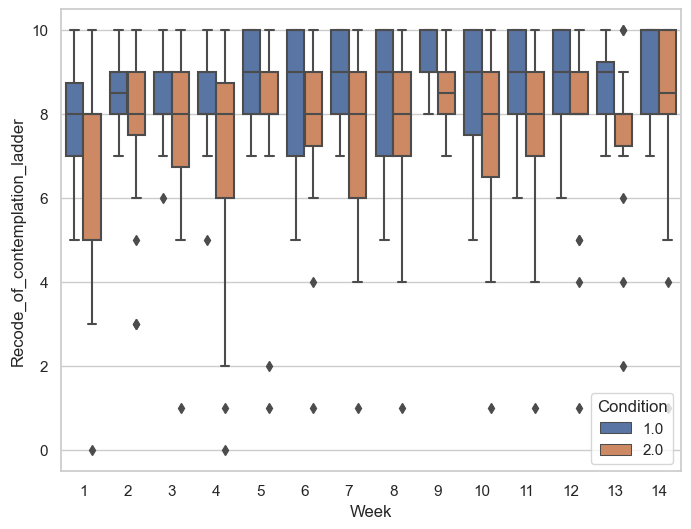

Week 7 Diference between CF & Control Groups: p-value = 0.0235
Week 7 Diference between CF & Control Groups: p-value = 0.0235
Week 7 Diference between CF & Control Groups: p-value = 0.0235
Week 7 Diference between CF & Control Groups: p-value = 0.0235
Week 7 Diference between CF & Control Groups: p-value = 0.0235
Week 7 Diference between CF & Control Groups: p-value = 0.0235
Week 7 Diference between CF & Control Groups: p-value = 0.0235
Week 13 Diference between CF & Control Groups: p-value = 0.0405

Significant correlation Overall_CF1 and Recode_of_contemplation_ladder: corr=0.3110, p=0.0000
Significant regression for Overall_CF1 predicting Recode_of_contemplation_ladder: p-value=0.0000
                                  OLS Regression Results                                  
Dep. Variable:     Recode_of_contemplation_ladder   R-squared:                       0.132
Model:                                        OLS   Adj. R-squared:                  0.123
Method:                       

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

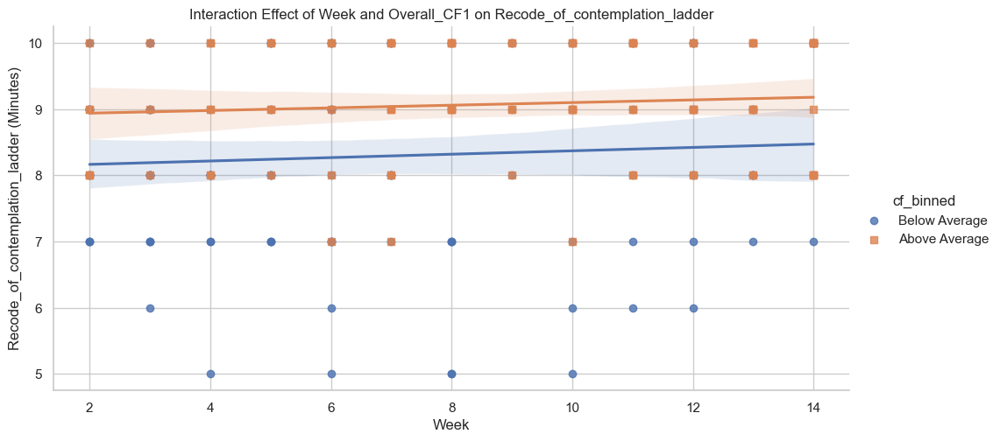

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

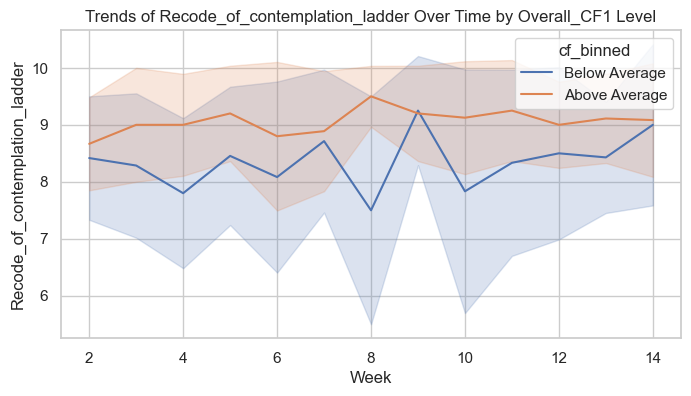

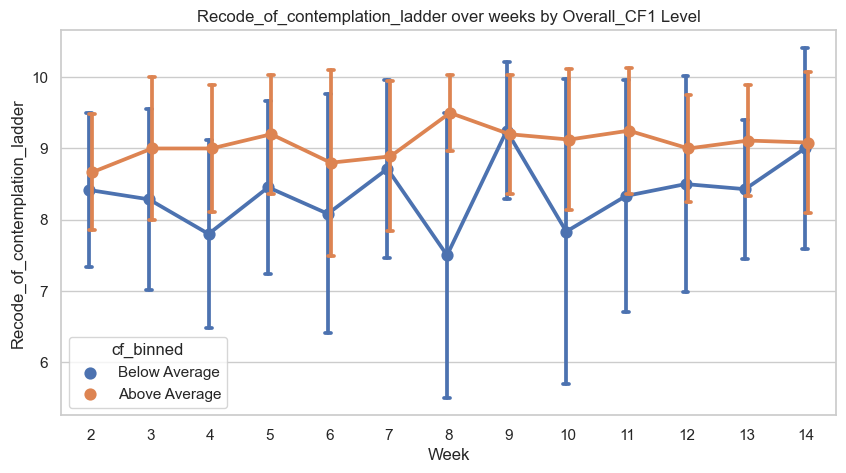


Significant correlation Overall_CF2 and Recode_of_contemplation_ladder: corr=0.3761, p=0.0000
Significant regression for Overall_CF2 predicting Recode_of_contemplation_ladder: p-value=0.0000
                                  OLS Regression Results                                  
Dep. Variable:     Recode_of_contemplation_ladder   R-squared:                       0.206
Model:                                        OLS   Adj. R-squared:                  0.198
Method:                             Least Squares   F-statistic:                     25.85
Date:                            Mon, 30 Sep 2024   Prob (F-statistic):           1.04e-10
Time:                                    14:10:55   Log-Likelihood:                -309.14
No. Observations:                             202   AIC:                             624.3
Df Residuals:                                 199   BIC:                             634.2
Df Model:                                       2                               

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

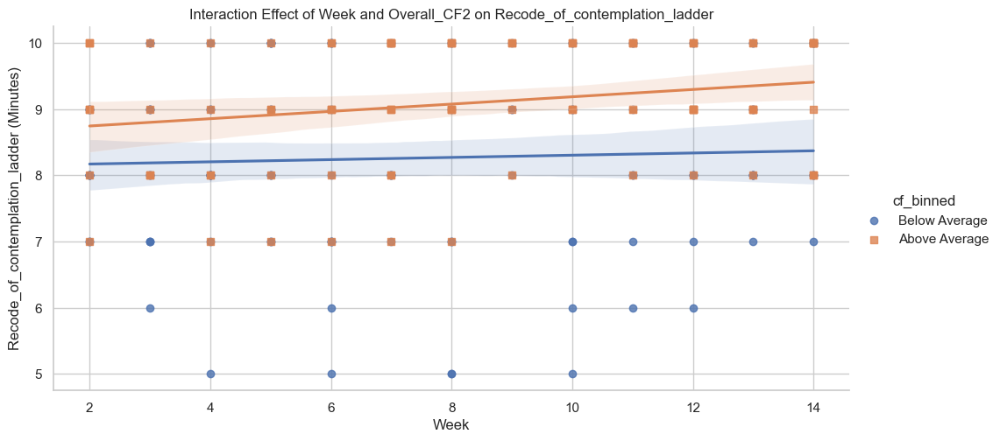

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

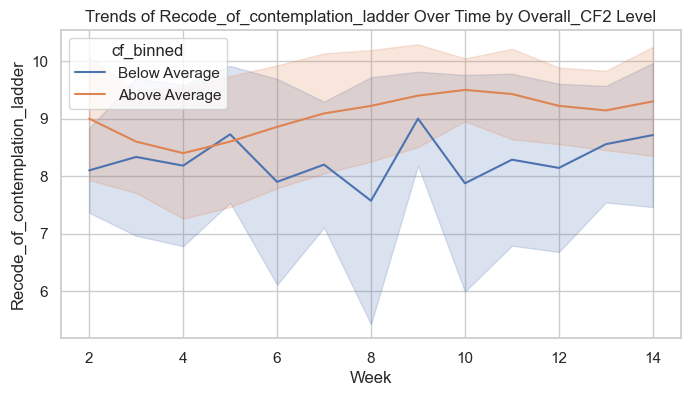

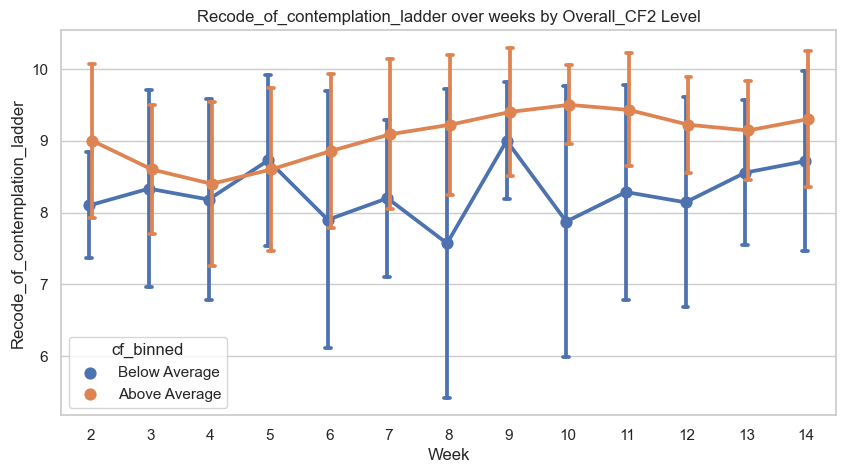


Significant correlation Overall_CF3 and Recode_of_contemplation_ladder: corr=0.2224, p=0.0015
Significant regression for Overall_CF3 predicting Recode_of_contemplation_ladder: p-value=0.0005
                                  OLS Regression Results                                  
Dep. Variable:     Recode_of_contemplation_ladder   R-squared:                       0.079
Model:                                        OLS   Adj. R-squared:                  0.069
Method:                             Least Squares   F-statistic:                     8.496
Date:                            Mon, 30 Sep 2024   Prob (F-statistic):           0.000288
Time:                                    14:10:56   Log-Likelihood:                -324.20
No. Observations:                             202   AIC:                             654.4
Df Residuals:                                 199   BIC:                             664.3
Df Model:                                       2                               

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

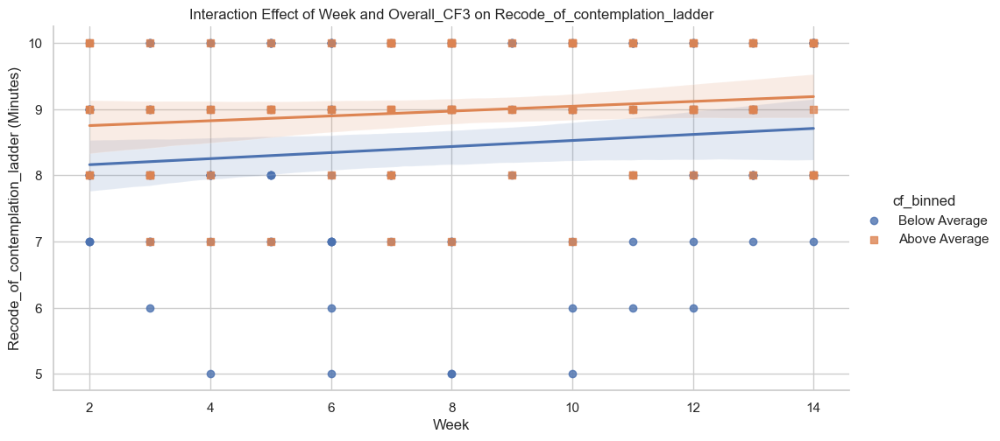

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

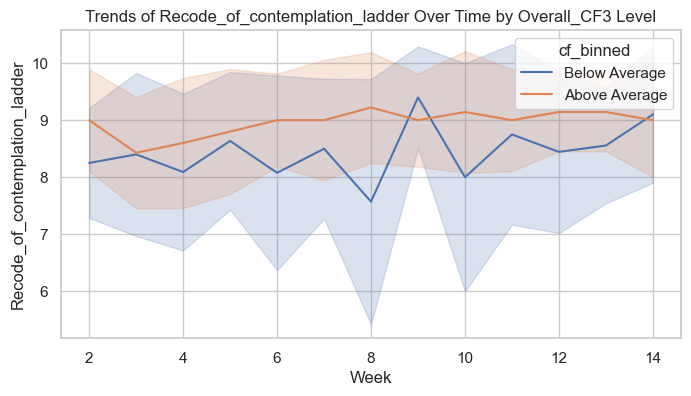

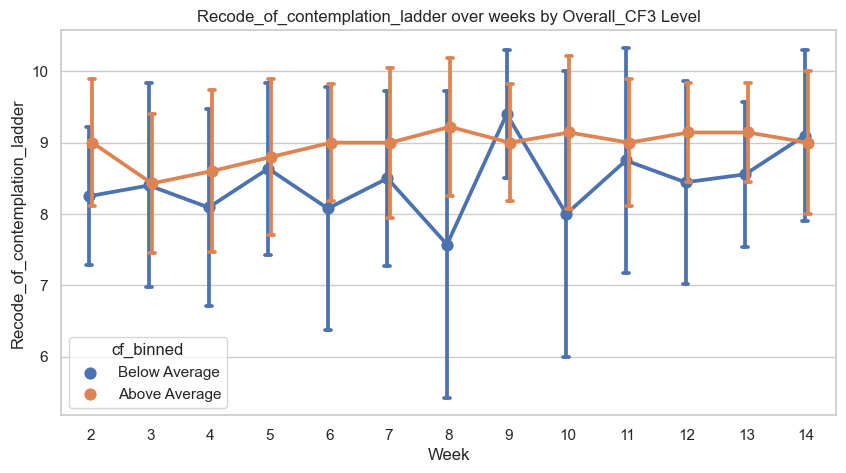


Significant correlation Overall_CF_potency_score and Recode_of_contemplation_ladder: corr=0.3015, p=0.0000
Significant regression for Overall_CF_potency_score predicting Recode_of_contemplation_ladder: p-value=0.0000
                                  OLS Regression Results                                  
Dep. Variable:     Recode_of_contemplation_ladder   R-squared:                       0.104
Model:                                        OLS   Adj. R-squared:                  0.100
Method:                             Least Squares   F-statistic:                     25.80
Date:                            Mon, 30 Sep 2024   Prob (F-statistic):           2.51e-11
Time:                                    14:10:57   Log-Likelihood:                -920.18
No. Observations:                             449   AIC:                             1846.
Df Residuals:                                 446   BIC:                             1859.
Df Model:                                       2     

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

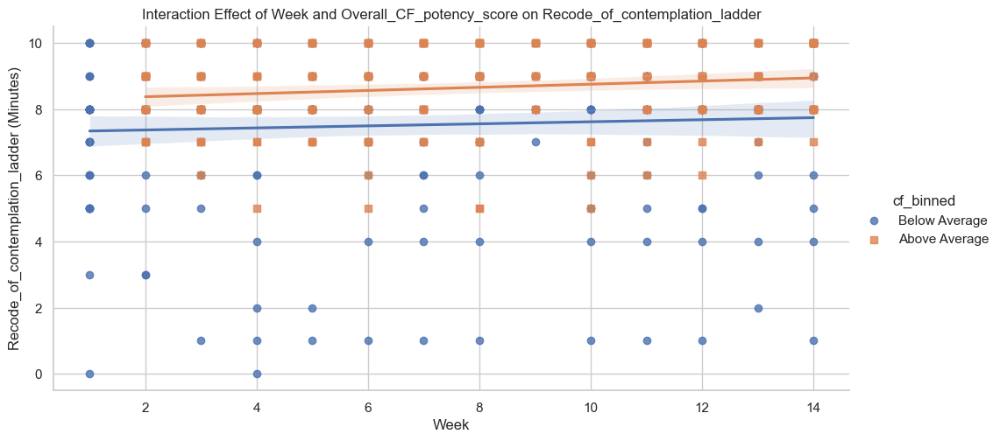

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

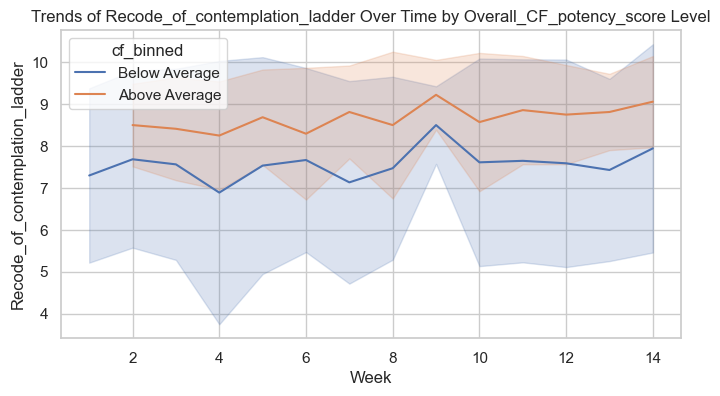

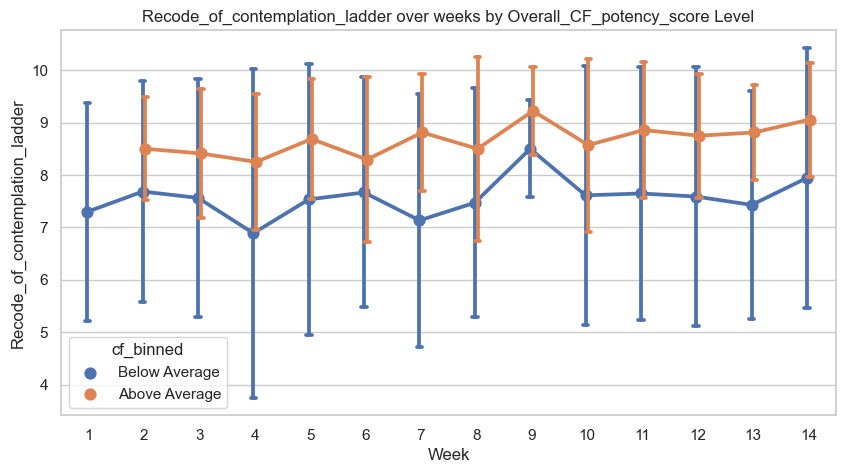


Significant correlation Overall_CF_Intention and Recode_of_contemplation_ladder: corr=0.3865, p=0.0000
Significant regression for Overall_CF_Intention predicting Recode_of_contemplation_ladder: p-value=0.0000
                                  OLS Regression Results                                  
Dep. Variable:     Recode_of_contemplation_ladder   R-squared:                       0.228
Model:                                        OLS   Adj. R-squared:                  0.221
Method:                             Least Squares   F-statistic:                     29.45
Date:                            Mon, 30 Sep 2024   Prob (F-statistic):           6.28e-12
Time:                                    14:10:58   Log-Likelihood:                -306.29
No. Observations:                             202   AIC:                             618.6
Df Residuals:                                 199   BIC:                             628.5
Df Model:                                       2             

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

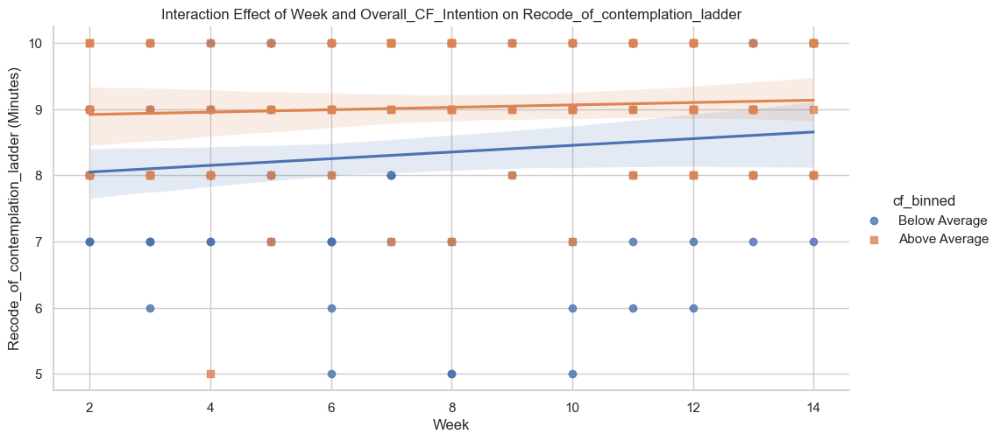

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

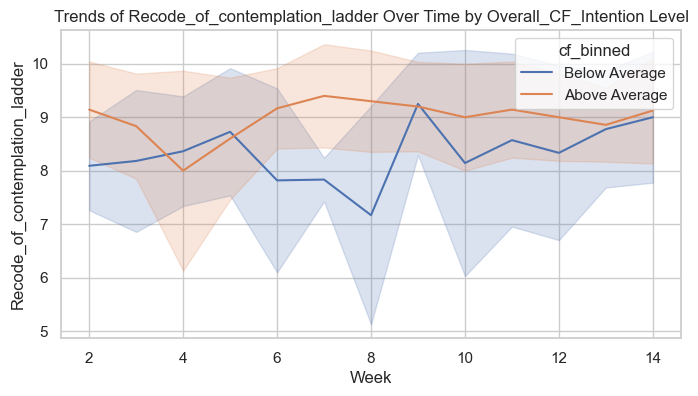

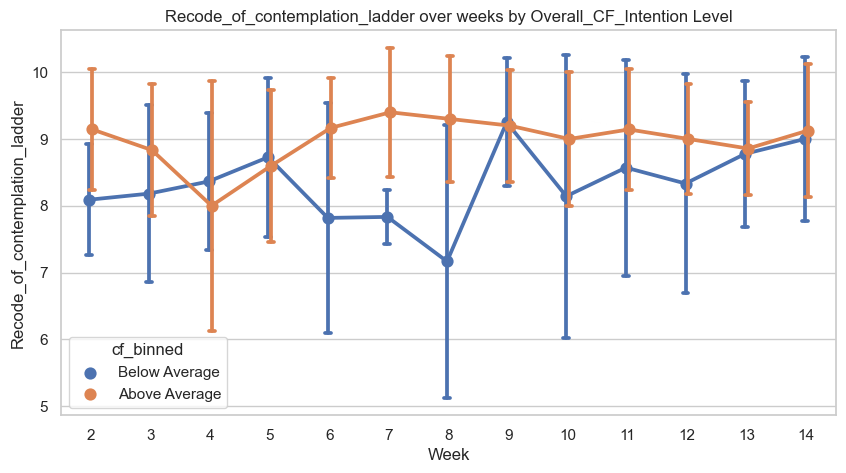


Effects of CF_columns on Recode_of_contemplation_ladder (sorted by effect size):
CF_column: Overall_CF_Intention, Coefficient: 0.6016, p-value: 0.0000
CF_column: Overall_CF2, Coefficient: 0.5281, p-value: 0.0000
CF_column: Overall_CF1, Coefficient: 0.3951, p-value: 0.0000
CF_column: Overall_CF3, Coefficient: 0.2495, p-value: 0.0005
CF_column: Overall_CF_potency_score, Coefficient: 0.0320, p-value: 0.0000
-------------------------------------------------- 



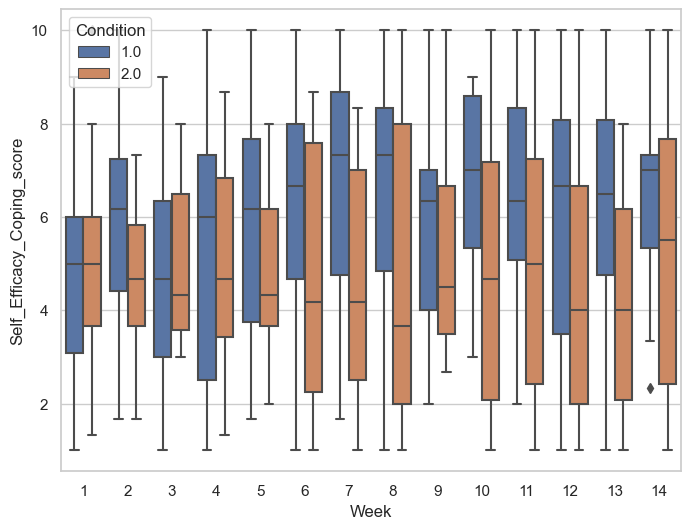

Week 1 Different to Base for Experimental: p-value = 0.0304
Week 1 Different to Base for Experimental: p-value = 0.0304
Week 1 Different to Base for Experimental: p-value = 0.0304
Week 1 Different to Base for Experimental: p-value = 0.0304
Week 1 Different to Base for Experimental: p-value = 0.0304
Week 7 Diference between CF & Control Groups: p-value = 0.0358
Week 1 Different to Base for Experimental: p-value = 0.0304
Week 7 Diference between CF & Control Groups: p-value = 0.0358
Week 1 Different to Base for Experimental: p-value = 0.0304
Week 7 Diference between CF & Control Groups: p-value = 0.0358
Week 1 Different to Base for Experimental: p-value = 0.0304
Week 7 Diference between CF & Control Groups: p-value = 0.0358
Week 10 Diference between CF & Control Groups: p-value = 0.0148
Week 1 Different to Base for Experimental: p-value = 0.0304
Week 7 Diference between CF & Control Groups: p-value = 0.0358
Week 10 Diference between CF & Control Groups: p-value = 0.0148
Week 1 Different 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

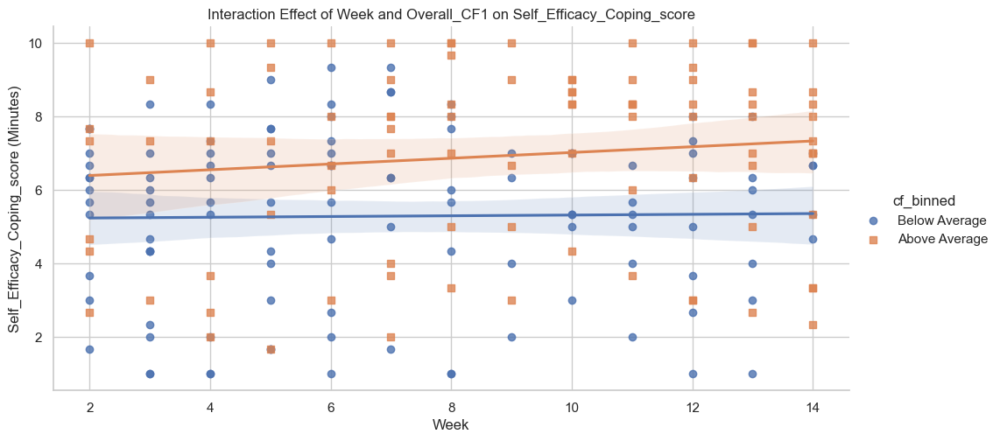

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

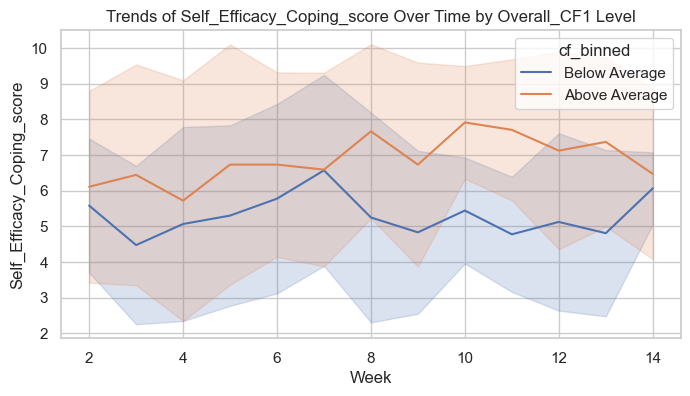

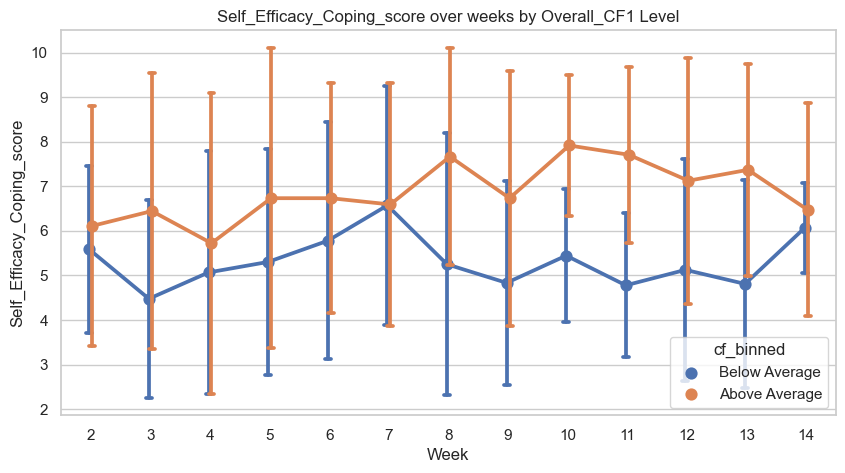


Significant correlation Overall_CF2 and Self_Efficacy_Coping_score: corr=0.4210, p=0.0000
Significant regression for Overall_CF2 predicting Self_Efficacy_Coping_score: p-value=0.0000
                                OLS Regression Results                                
Dep. Variable:     Self_Efficacy_Coping_score   R-squared:                       0.191
Model:                                    OLS   Adj. R-squared:                  0.183
Method:                         Least Squares   F-statistic:                     23.49
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):           6.92e-10
Time:                                14:10:59   Log-Likelihood:                -450.47
No. Observations:                         202   AIC:                             906.9
Df Residuals:                             199   BIC:                             916.9
Df Model:                                   2                                         
Covariance Type:                 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

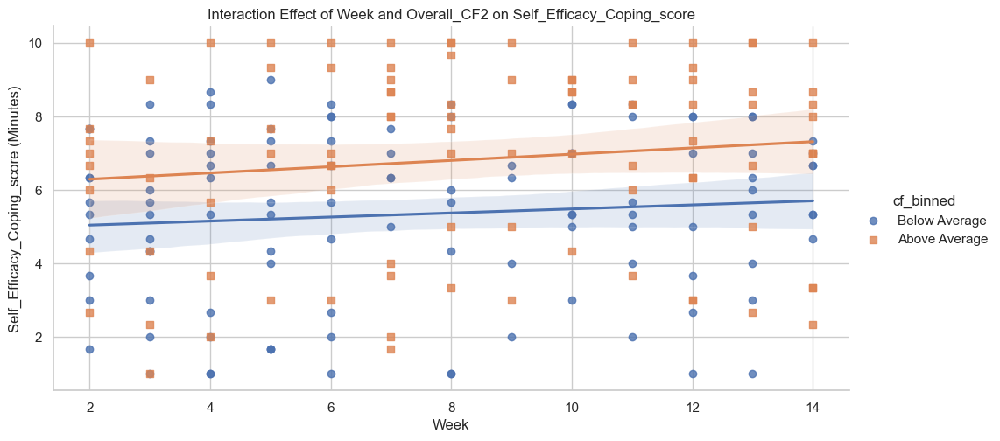

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

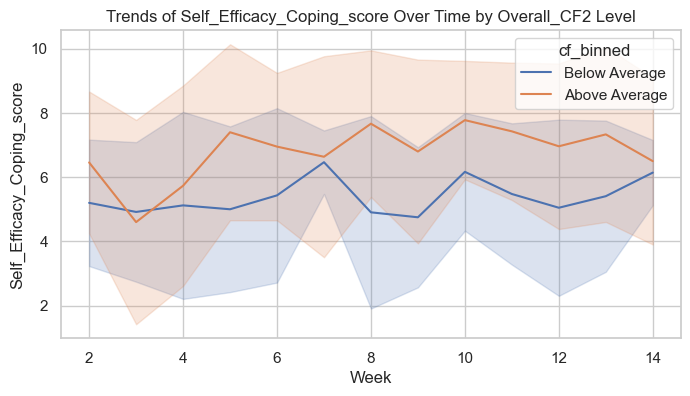

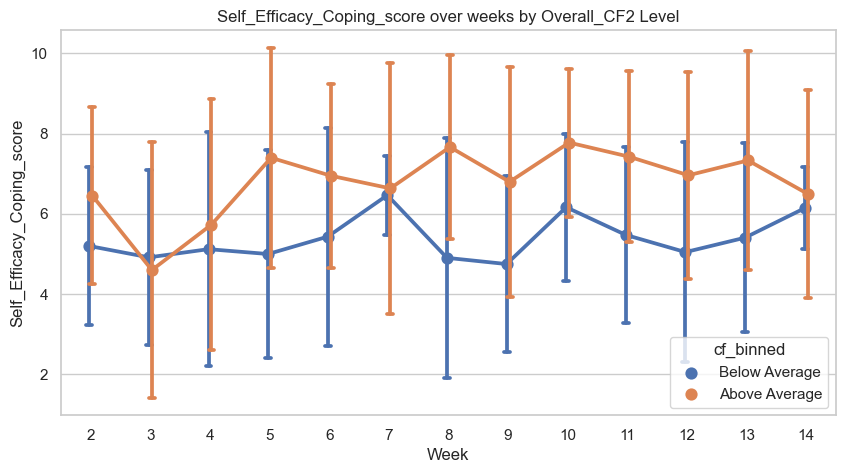


Significant correlation Overall_CF3 and Self_Efficacy_Coping_score: corr=0.1537, p=0.0289
Significant regression for Overall_CF3 predicting Self_Efficacy_Coping_score: p-value=0.0919
                                OLS Regression Results                                
Dep. Variable:     Self_Efficacy_Coping_score   R-squared:                       0.034
Model:                                    OLS   Adj. R-squared:                  0.024
Method:                         Least Squares   F-statistic:                     3.522
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):             0.0314
Time:                                14:11:00   Log-Likelihood:                -468.36
No. Observations:                         202   AIC:                             942.7
Df Residuals:                             199   BIC:                             952.6
Df Model:                                   2                                         
Covariance Type:                 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

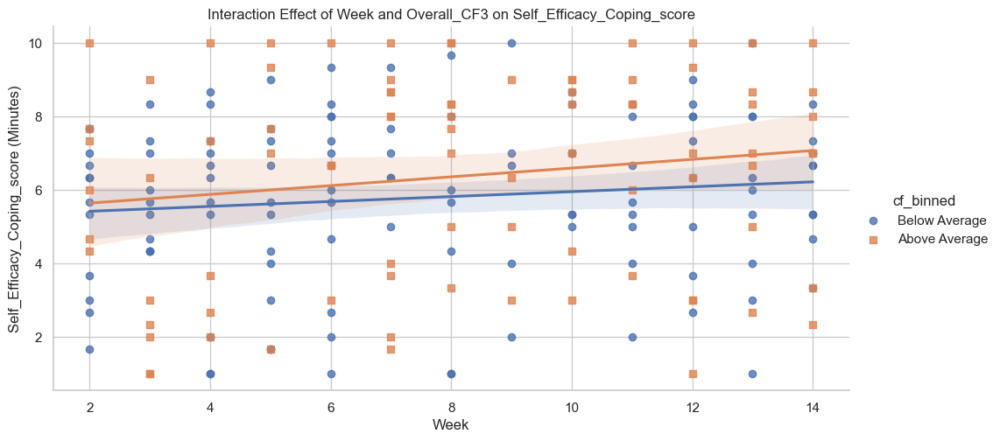

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

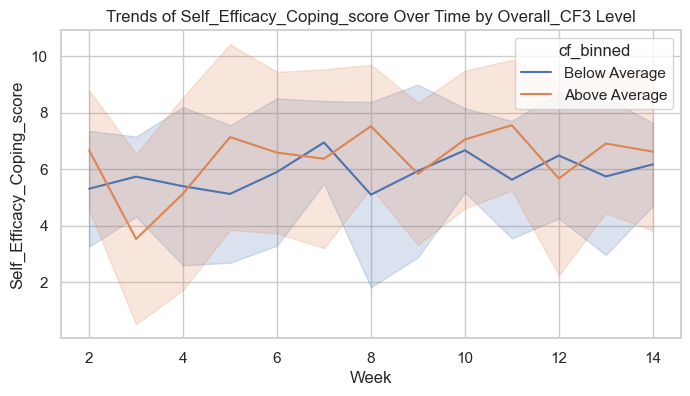

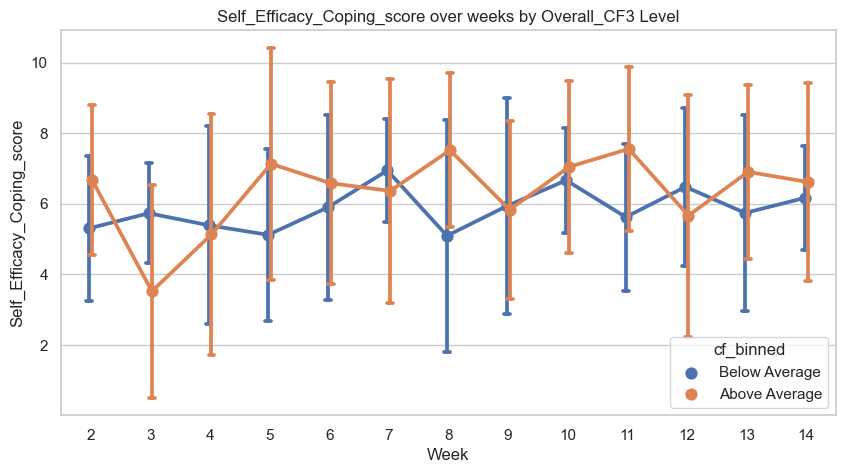


Significant correlation Overall_CF_potency_score and Self_Efficacy_Coping_score: corr=0.2822, p=0.0000
Significant regression for Overall_CF_potency_score predicting Self_Efficacy_Coping_score: p-value=0.0000
                                OLS Regression Results                                
Dep. Variable:     Self_Efficacy_Coping_score   R-squared:                       0.088
Model:                                    OLS   Adj. R-squared:                  0.084
Method:                         Least Squares   F-statistic:                     21.73
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):           9.83e-10
Time:                                14:11:01   Log-Likelihood:                -1039.8
No. Observations:                         451   AIC:                             2086.
Df Residuals:                             448   BIC:                             2098.
Df Model:                                   2                                         
Covaria

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

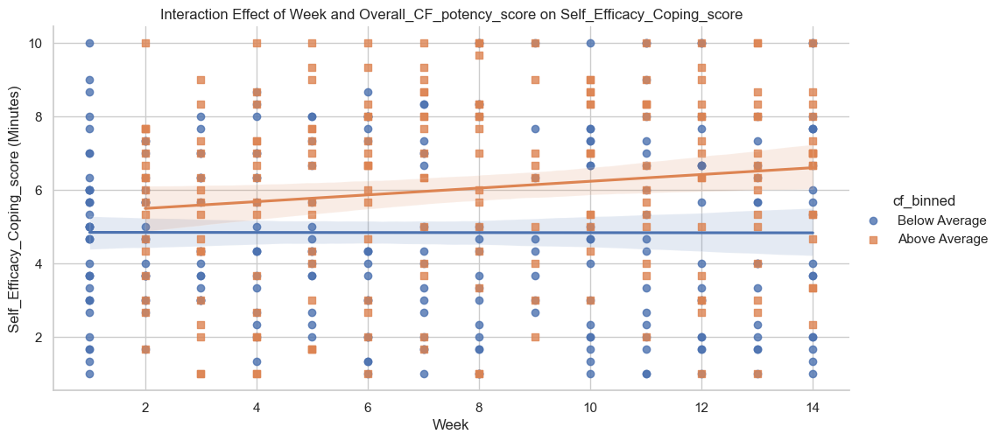

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

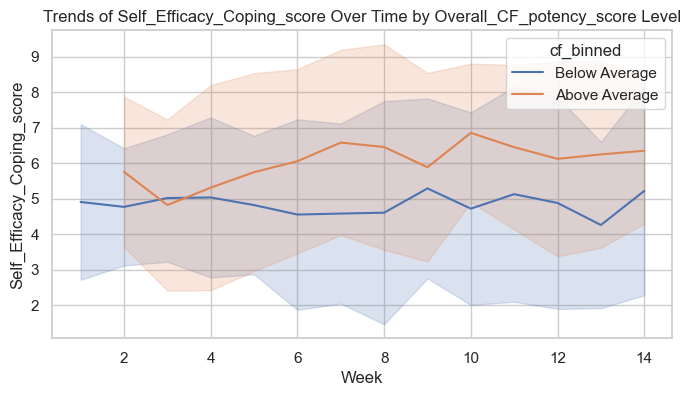

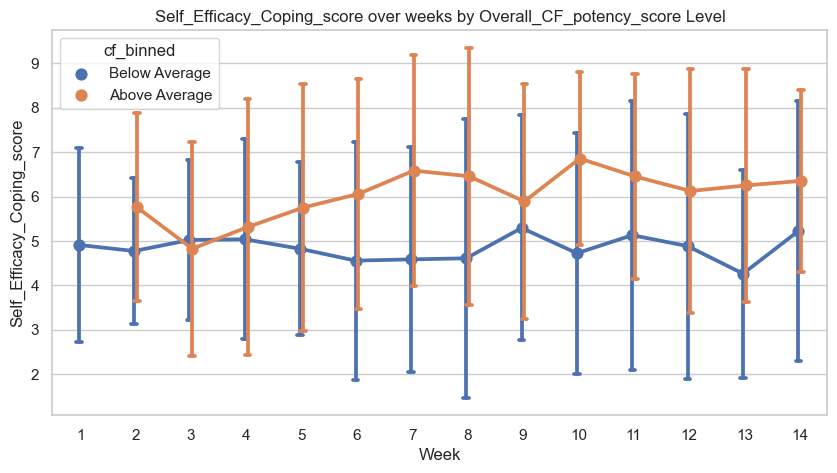


Significant correlation Overall_CF_Intention and Self_Efficacy_Coping_score: corr=0.3726, p=0.0000
Significant regression for Overall_CF_Intention predicting Self_Efficacy_Coping_score: p-value=0.0000
                                OLS Regression Results                                
Dep. Variable:     Self_Efficacy_Coping_score   R-squared:                       0.133
Model:                                    OLS   Adj. R-squared:                  0.124
Method:                         Least Squares   F-statistic:                     15.26
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):           6.83e-07
Time:                                14:11:02   Log-Likelihood:                -457.46
No. Observations:                         202   AIC:                             920.9
Df Residuals:                             199   BIC:                             930.9
Df Model:                                   2                                         
Covariance Type

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

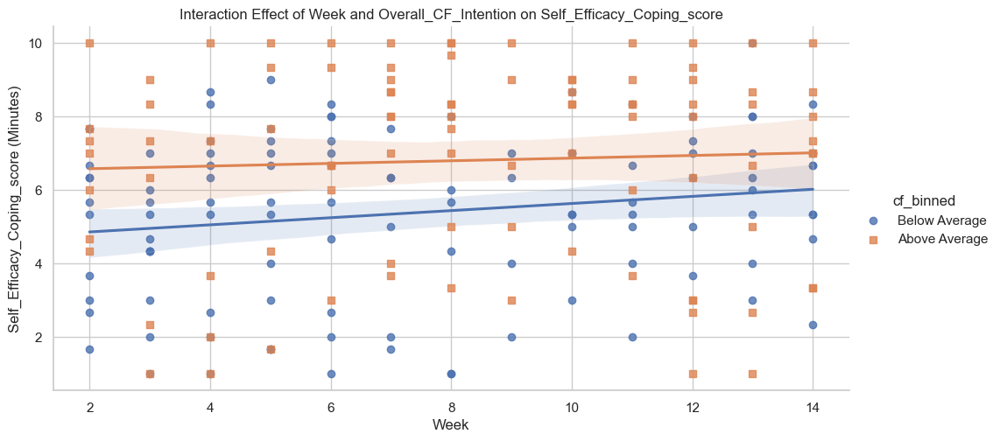

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

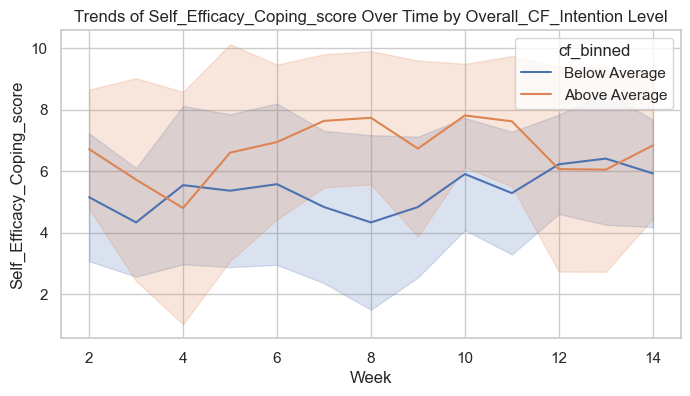

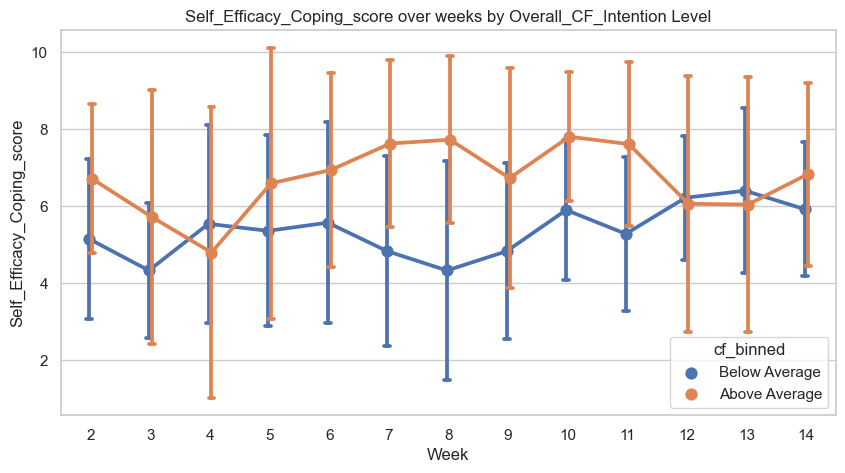


Effects of CF_columns on Self_Efficacy_Coping_score (sorted by effect size):
CF_column: Overall_CF2, Coefficient: 1.0115, p-value: 0.0000
CF_column: Overall_CF_Intention, Coefficient: 0.8847, p-value: 0.0000
CF_column: Overall_CF1, Coefficient: 0.8559, p-value: 0.0000
CF_column: Overall_CF3, Coefficient: 0.2448, p-value: 0.0919
CF_column: Overall_CF_potency_score, Coefficient: 0.0387, p-value: 0.0000
-------------------------------------------------- 



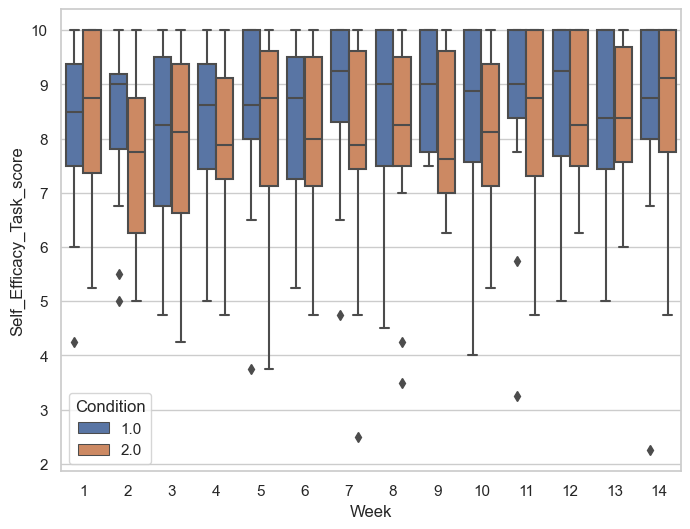


Significant correlation Overall_CF1 and Self_Efficacy_Task_score: corr=0.4542, p=0.0000
Significant regression for Overall_CF1 predicting Self_Efficacy_Task_score: p-value=0.0000
                               OLS Regression Results                               
Dep. Variable:     Self_Efficacy_Task_score   R-squared:                       0.177
Model:                                  OLS   Adj. R-squared:                  0.169
Method:                       Least Squares   F-statistic:                     21.37
Date:                      Mon, 30 Sep 2024   Prob (F-statistic):           3.90e-09
Time:                              14:11:03   Log-Likelihood:                -362.74
No. Observations:                       202   AIC:                             731.5
Df Residuals:                           199   BIC:                             741.4
Df Model:                                 2                                         
Covariance Type:                  nonrobust            

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

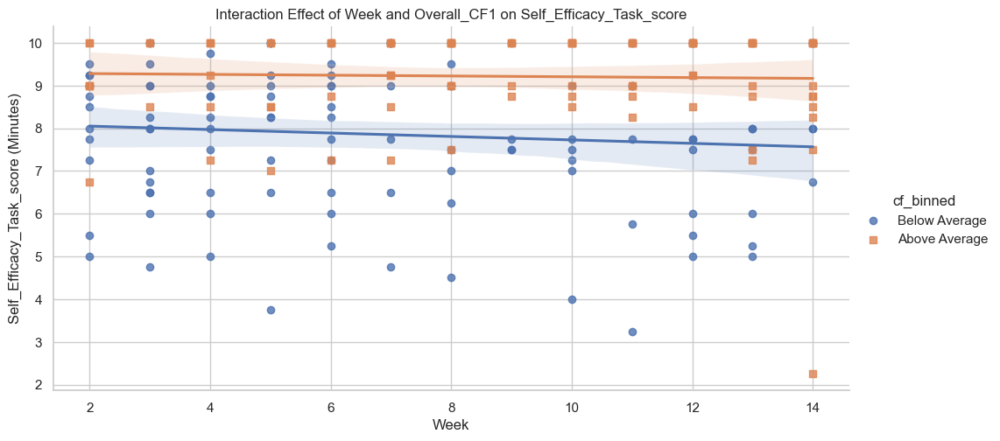

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

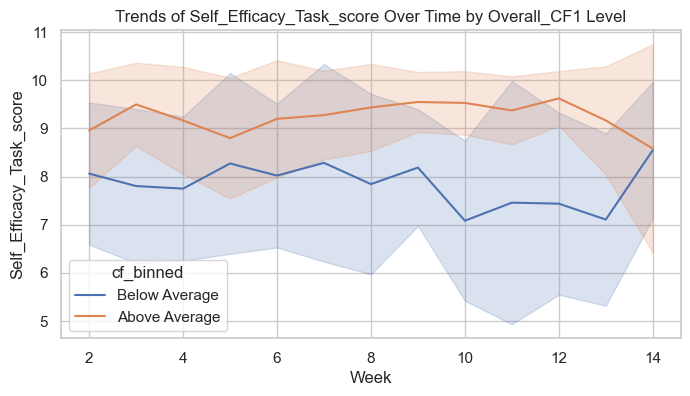

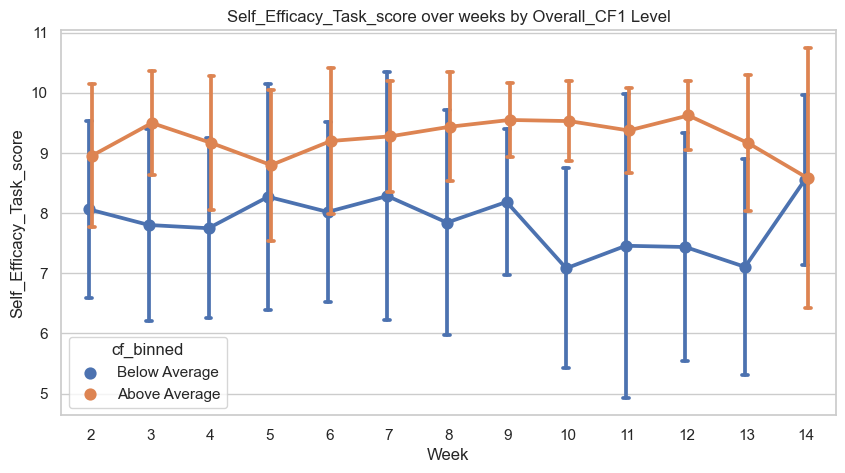


Significant correlation Overall_CF2 and Self_Efficacy_Task_score: corr=0.5073, p=0.0000
Significant regression for Overall_CF2 predicting Self_Efficacy_Task_score: p-value=0.0000
                               OLS Regression Results                               
Dep. Variable:     Self_Efficacy_Task_score   R-squared:                       0.198
Model:                                  OLS   Adj. R-squared:                  0.190
Method:                       Least Squares   F-statistic:                     24.58
Date:                      Mon, 30 Sep 2024   Prob (F-statistic):           2.88e-10
Time:                              14:11:03   Log-Likelihood:                -360.10
No. Observations:                       202   AIC:                             726.2
Df Residuals:                           199   BIC:                             736.1
Df Model:                                 2                                         
Covariance Type:                  nonrobust            

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

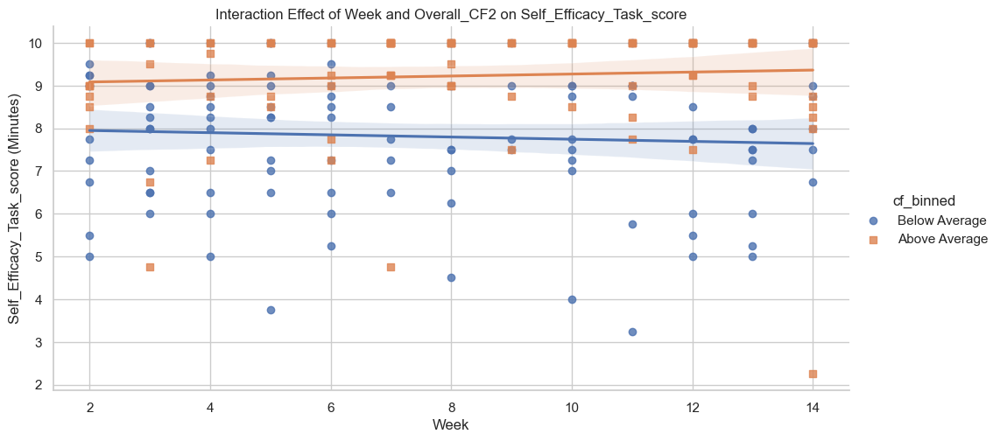

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

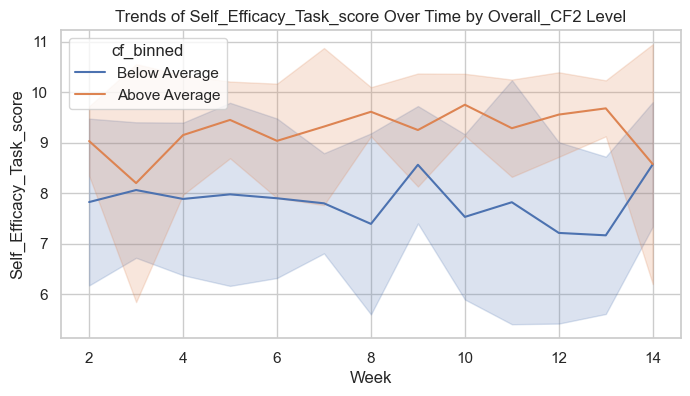

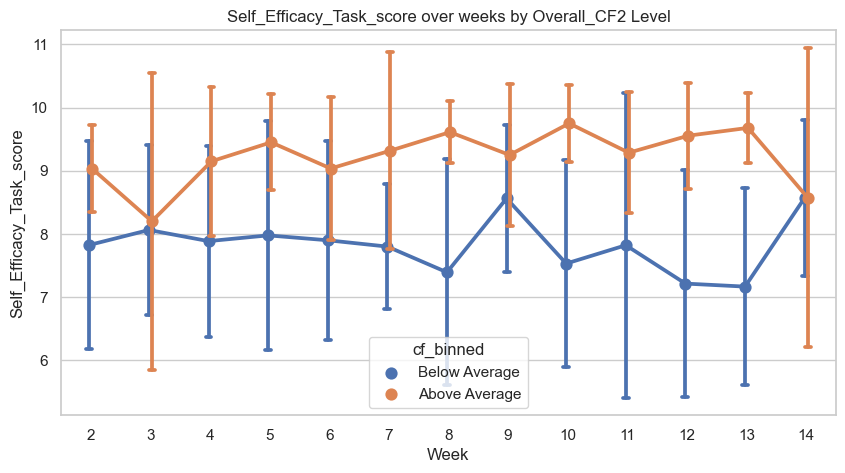


Significant correlation Overall_CF3 and Self_Efficacy_Task_score: corr=0.3674, p=0.0000
Significant regression for Overall_CF3 predicting Self_Efficacy_Task_score: p-value=0.0000
                               OLS Regression Results                               
Dep. Variable:     Self_Efficacy_Task_score   R-squared:                       0.099
Model:                                  OLS   Adj. R-squared:                  0.090
Method:                       Least Squares   F-statistic:                     10.90
Date:                      Mon, 30 Sep 2024   Prob (F-statistic):           3.23e-05
Time:                              14:11:04   Log-Likelihood:                -371.90
No. Observations:                       202   AIC:                             749.8
Df Residuals:                           199   BIC:                             759.7
Df Model:                                 2                                         
Covariance Type:                  nonrobust            

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

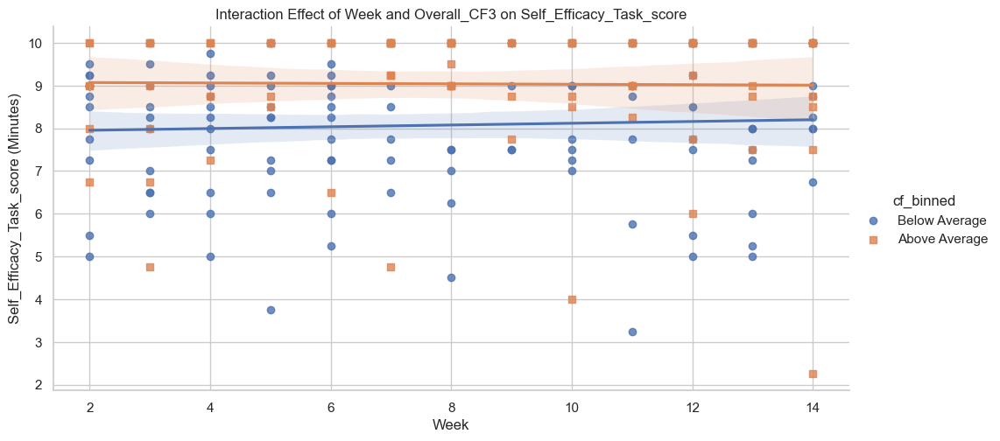

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

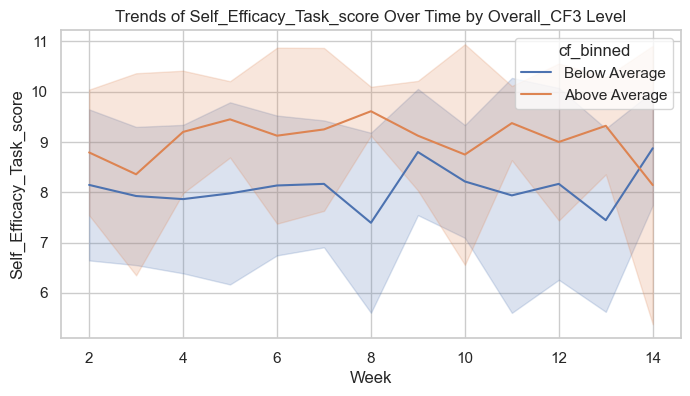

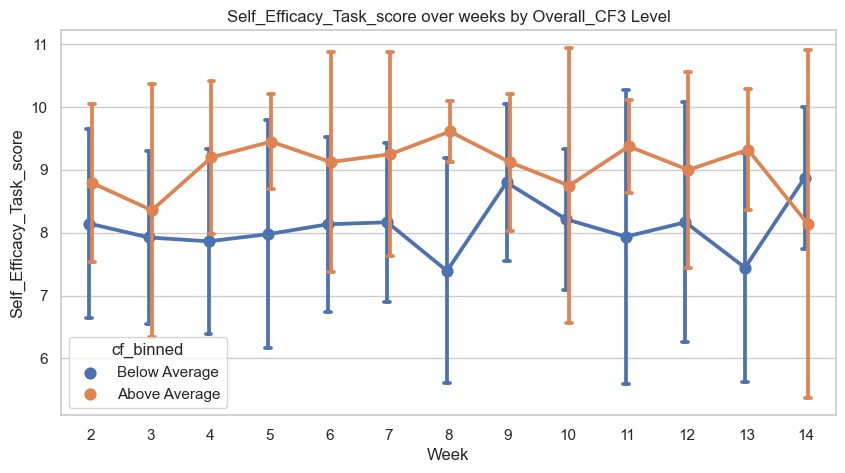


Significant correlation Overall_CF_potency_score and Self_Efficacy_Task_score: corr=0.2072, p=0.0000
Significant regression for Overall_CF_potency_score predicting Self_Efficacy_Task_score: p-value=0.0000
                               OLS Regression Results                               
Dep. Variable:     Self_Efficacy_Task_score   R-squared:                       0.047
Model:                                  OLS   Adj. R-squared:                  0.043
Method:                       Least Squares   F-statistic:                     11.09
Date:                      Mon, 30 Sep 2024   Prob (F-statistic):           1.99e-05
Time:                              14:11:05   Log-Likelihood:                -845.86
No. Observations:                       451   AIC:                             1698.
Df Residuals:                           448   BIC:                             1710.
Df Model:                                 2                                         
Covariance Type:             

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

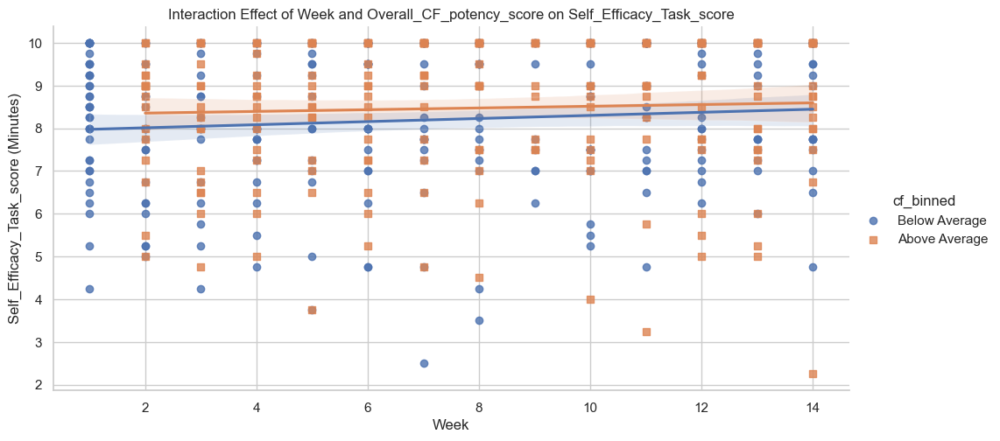

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

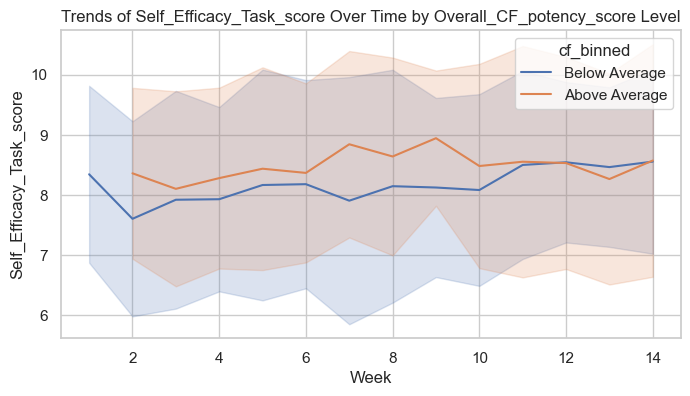

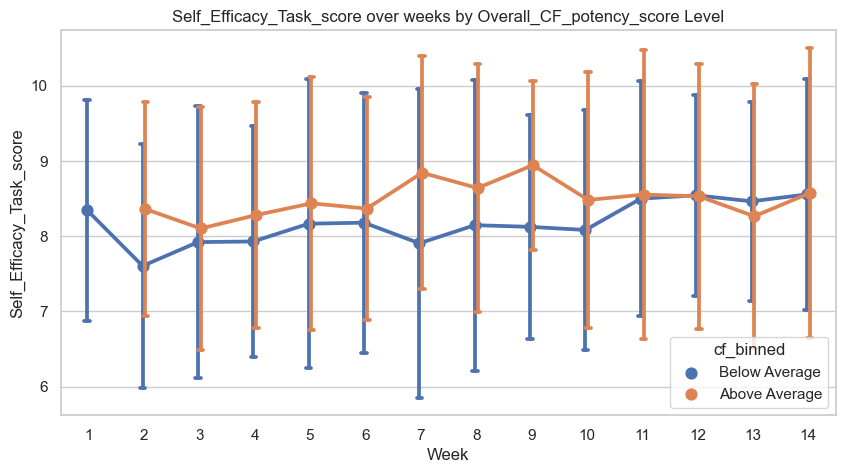


Significant correlation Overall_CF_Intention and Self_Efficacy_Task_score: corr=0.3631, p=0.0000
Significant regression for Overall_CF_Intention predicting Self_Efficacy_Task_score: p-value=0.0001
                               OLS Regression Results                               
Dep. Variable:     Self_Efficacy_Task_score   R-squared:                       0.080
Model:                                  OLS   Adj. R-squared:                  0.071
Method:                       Least Squares   F-statistic:                     8.691
Date:                      Mon, 30 Sep 2024   Prob (F-statistic):           0.000241
Time:                              14:11:06   Log-Likelihood:                -373.94
No. Observations:                       202   AIC:                             753.9
Df Residuals:                           199   BIC:                             763.8
Df Model:                                 2                                         
Covariance Type:                  non

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

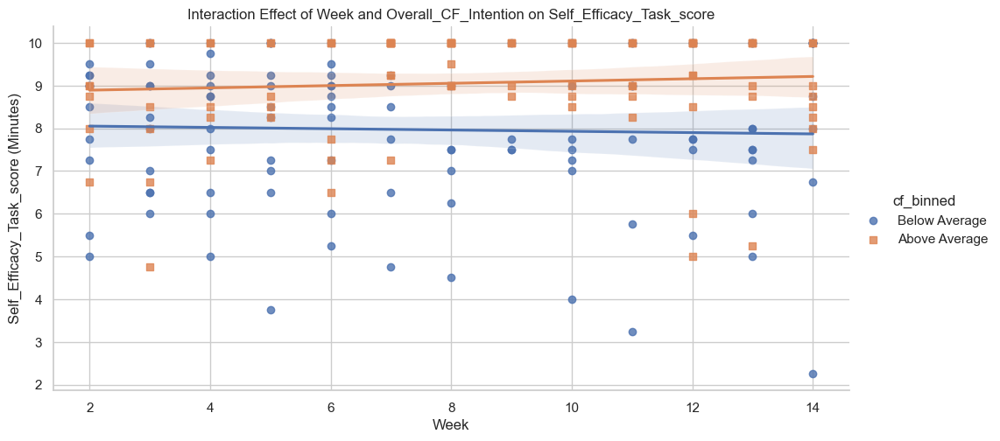

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

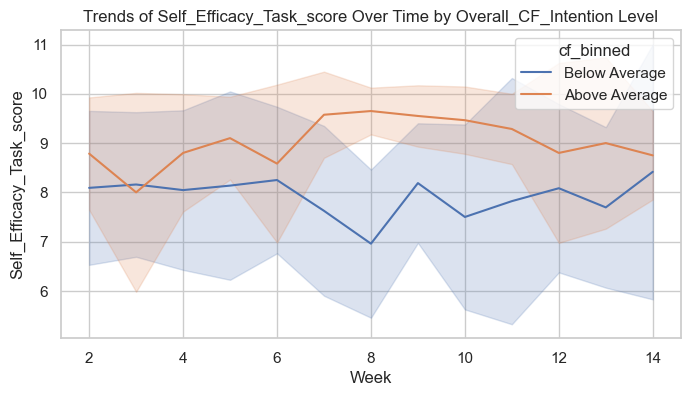

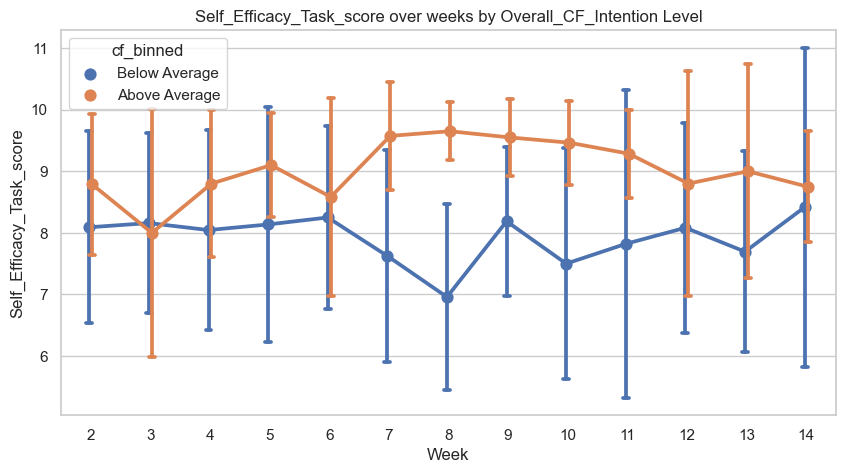


Effects of CF_columns on Self_Efficacy_Task_score (sorted by effect size):
CF_column: Overall_CF2, Coefficient: 0.6955, p-value: 0.0000
CF_column: Overall_CF1, Coefficient: 0.6361, p-value: 0.0000
CF_column: Overall_CF_Intention, Coefficient: 0.4727, p-value: 0.0001
CF_column: Overall_CF3, Coefficient: 0.4136, p-value: 0.0000
CF_column: Overall_CF_potency_score, Coefficient: 0.0172, p-value: 0.0000
-------------------------------------------------- 



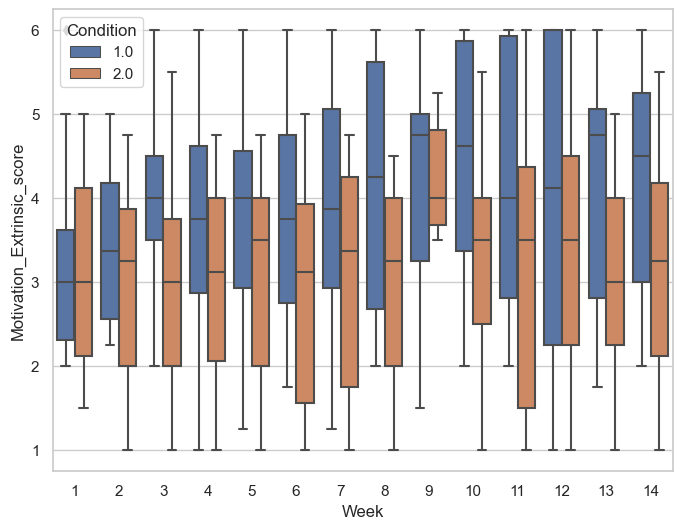

Week 6 Diference between CF & Control Groups: p-value = 0.0260
Week 6 Diference between CF & Control Groups: p-value = 0.0260
Week 6 Diference between CF & Control Groups: p-value = 0.0260
Week 8 Diference between CF & Control Groups: p-value = 0.0190
Week 6 Diference between CF & Control Groups: p-value = 0.0260
Week 8 Diference between CF & Control Groups: p-value = 0.0190
Week 6 Diference between CF & Control Groups: p-value = 0.0260
Week 8 Diference between CF & Control Groups: p-value = 0.0190
Week 10 Diference between CF & Control Groups: p-value = 0.0276
Week 6 Diference between CF & Control Groups: p-value = 0.0260
Week 8 Diference between CF & Control Groups: p-value = 0.0190
Week 10 Diference between CF & Control Groups: p-value = 0.0276
Week 6 Diference between CF & Control Groups: p-value = 0.0260
Week 8 Diference between CF & Control Groups: p-value = 0.0190
Week 10 Diference between CF & Control Groups: p-value = 0.0276
Week 6 Diference between CF & Control Groups: p-valu

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

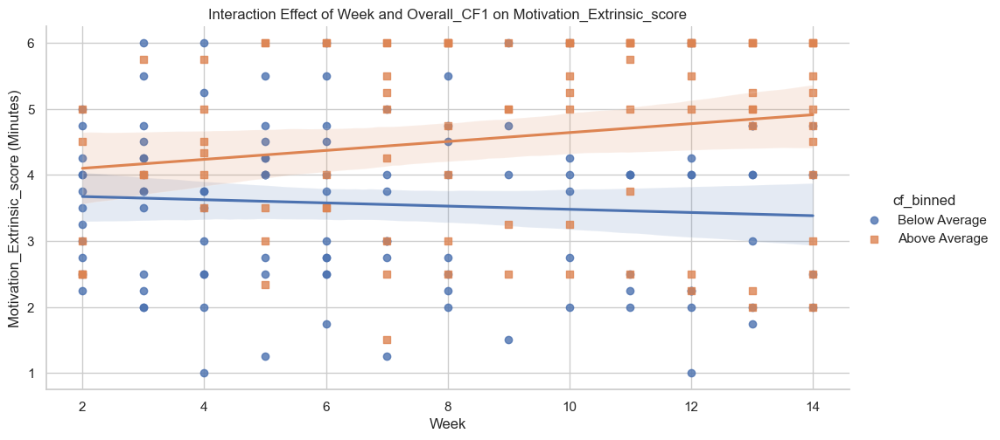

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

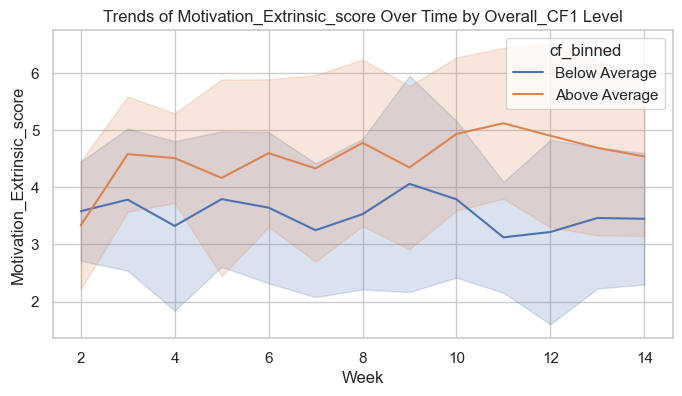

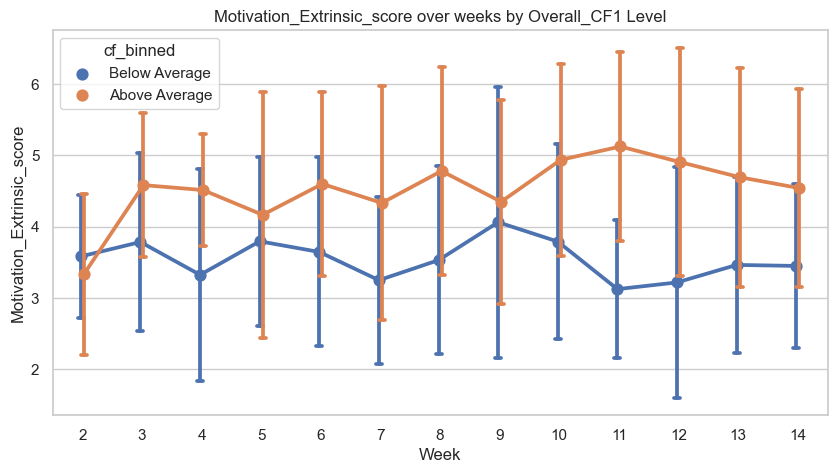


Significant correlation Overall_CF2 and Motivation_Extrinsic_score: corr=0.2898, p=0.0000
Significant regression for Overall_CF2 predicting Motivation_Extrinsic_score: p-value=0.0000
                                OLS Regression Results                                
Dep. Variable:     Motivation_Extrinsic_score   R-squared:                       0.098
Model:                                    OLS   Adj. R-squared:                  0.089
Method:                         Least Squares   F-statistic:                     10.78
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):           3.60e-05
Time:                                14:11:07   Log-Likelihood:                -342.95
No. Observations:                         202   AIC:                             691.9
Df Residuals:                             199   BIC:                             701.8
Df Model:                                   2                                         
Covariance Type:                 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

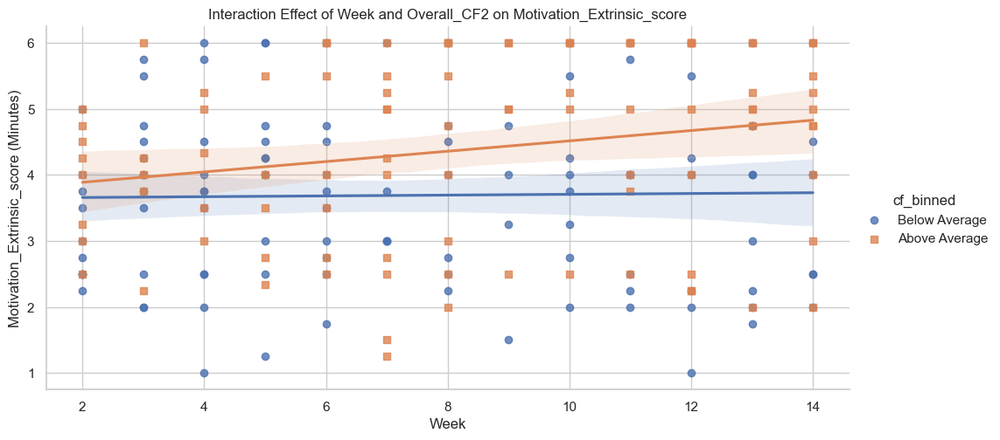

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

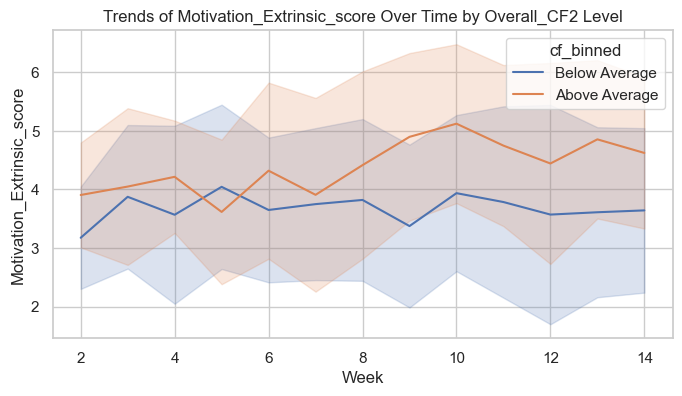

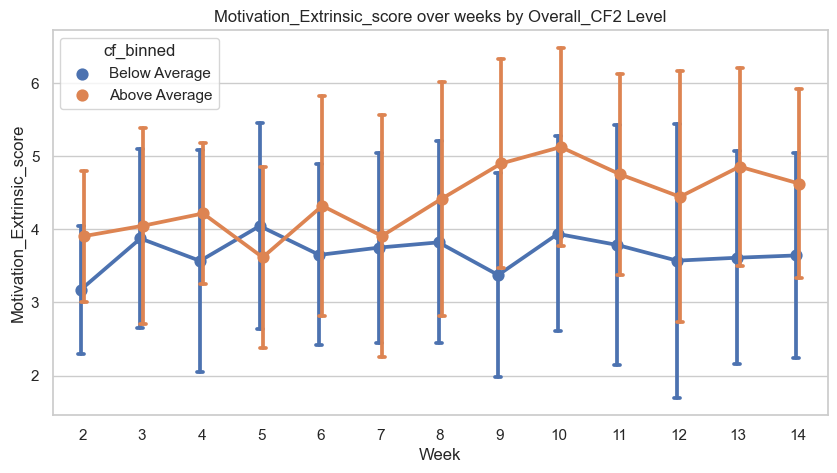


Significant correlation Overall_CF3 and Motivation_Extrinsic_score: corr=0.2226, p=0.0015
Significant regression for Overall_CF3 predicting Motivation_Extrinsic_score: p-value=0.0070
                                OLS Regression Results                                
Dep. Variable:     Motivation_Extrinsic_score   R-squared:                       0.054
Model:                                    OLS   Adj. R-squared:                  0.045
Method:                         Least Squares   F-statistic:                     5.695
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):            0.00394
Time:                                14:11:08   Log-Likelihood:                -347.72
No. Observations:                         202   AIC:                             701.4
Df Residuals:                             199   BIC:                             711.4
Df Model:                                   2                                         
Covariance Type:                 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

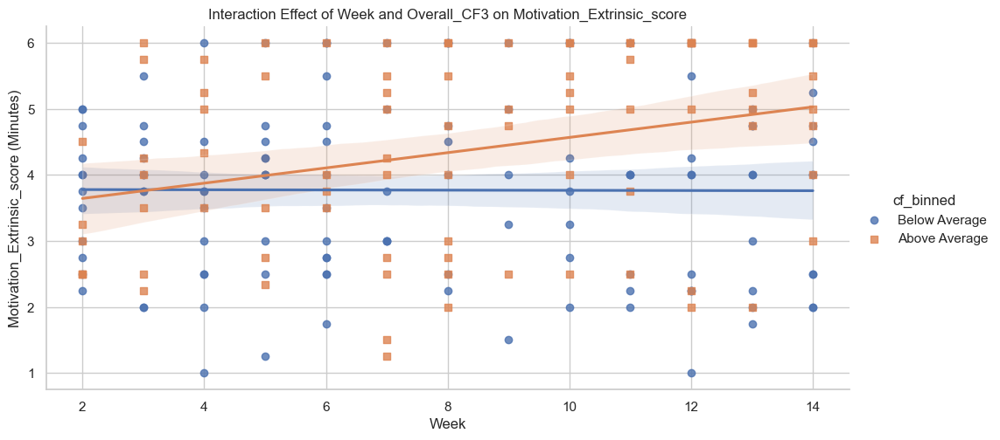

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

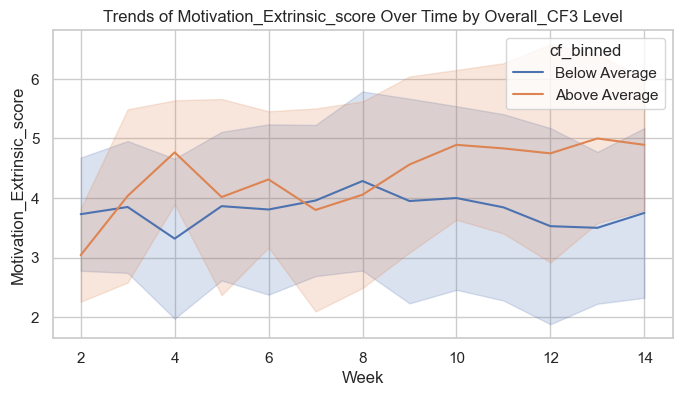

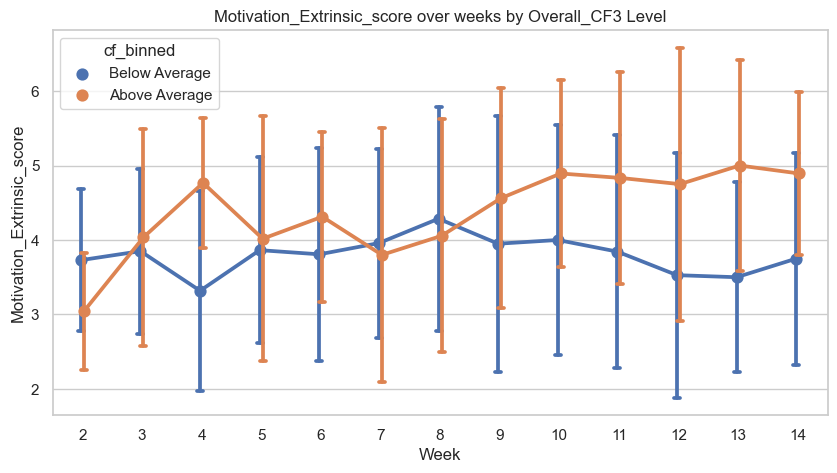


Significant correlation Overall_CF_potency_score and Motivation_Extrinsic_score: corr=0.3470, p=0.0000
Significant regression for Overall_CF_potency_score predicting Motivation_Extrinsic_score: p-value=0.0000
                                OLS Regression Results                                
Dep. Variable:     Motivation_Extrinsic_score   R-squared:                       0.143
Model:                                    OLS   Adj. R-squared:                  0.140
Method:                         Least Squares   F-statistic:                     37.43
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):           9.33e-16
Time:                                14:11:09   Log-Likelihood:                -758.20
No. Observations:                         450   AIC:                             1522.
Df Residuals:                             447   BIC:                             1535.
Df Model:                                   2                                         
Covaria

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

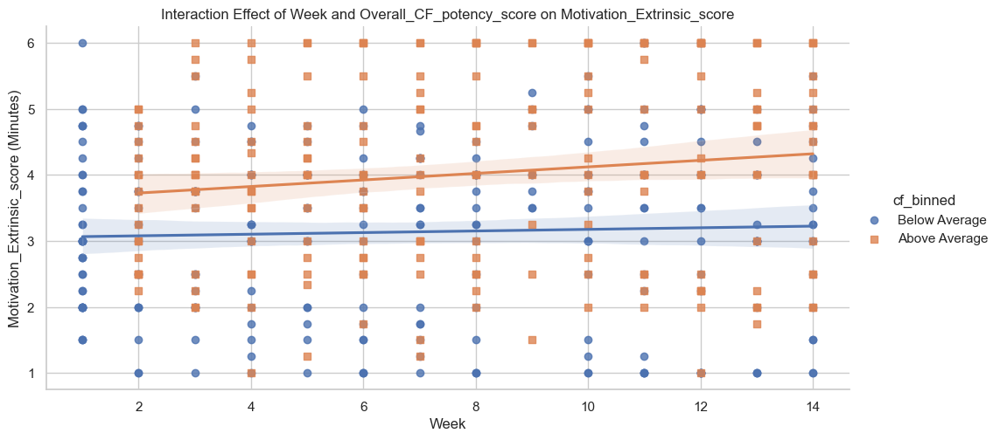

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

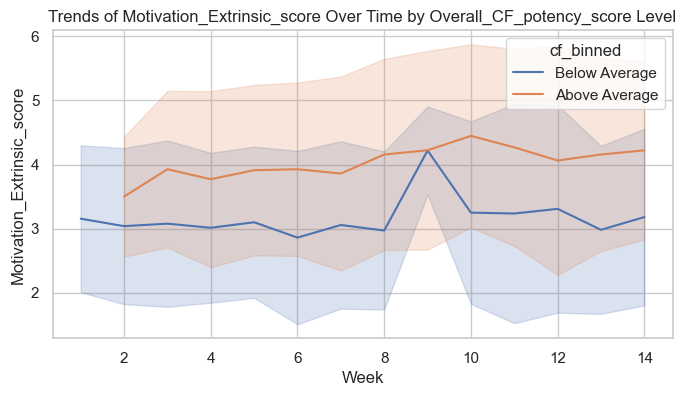

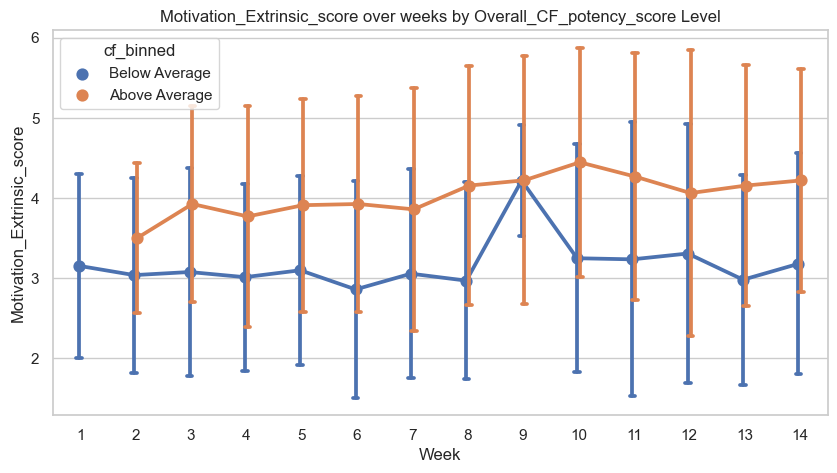


Significant correlation Overall_CF_Intention and Motivation_Extrinsic_score: corr=0.2275, p=0.0011
Significant regression for Overall_CF_Intention predicting Motivation_Extrinsic_score: p-value=0.0001
                                OLS Regression Results                                
Dep. Variable:     Motivation_Extrinsic_score   R-squared:                       0.089
Model:                                    OLS   Adj. R-squared:                  0.080
Method:                         Least Squares   F-statistic:                     9.777
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):           8.90e-05
Time:                                14:11:09   Log-Likelihood:                -343.87
No. Observations:                         202   AIC:                             693.7
Df Residuals:                             199   BIC:                             703.7
Df Model:                                   2                                         
Covariance Type

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

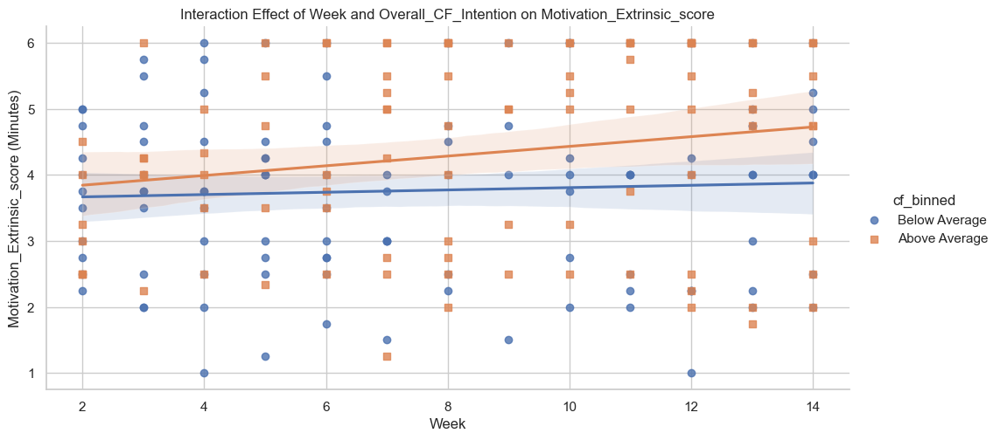

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

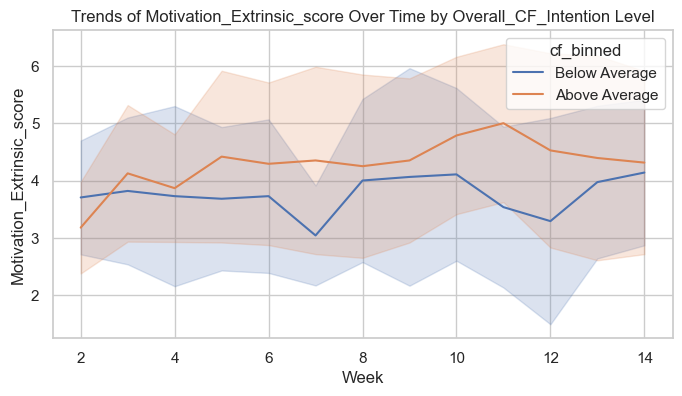

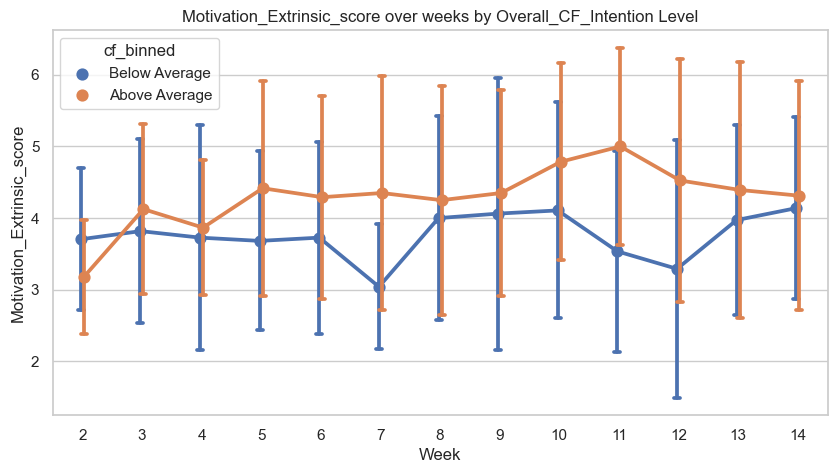


Effects of CF_columns on Motivation_Extrinsic_score (sorted by effect size):
CF_column: Overall_CF1, Coefficient: 0.4347, p-value: 0.0000
CF_column: Overall_CF_Intention, Coefficient: 0.3894, p-value: 0.0001
CF_column: Overall_CF2, Coefficient: 0.3822, p-value: 0.0000
CF_column: Overall_CF3, Coefficient: 0.2166, p-value: 0.0070
CF_column: Overall_CF_potency_score, Coefficient: 0.0272, p-value: 0.0000
-------------------------------------------------- 



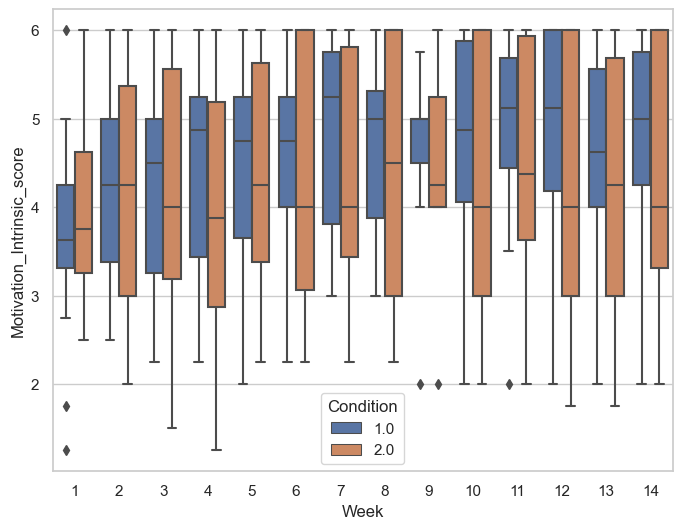

Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186
Week 1 Different to Base for Experimental: p-value = 0.0186

Significant correlation Overall_CF1 and Motivation_Intrinsic_score: corr=0.3101, p=0.0000
Significant regression for Overall_CF1 predicting Motivation_Intrinsic_score: p-value=0.0002
                                OLS Regression Results                                
Dep. Vari

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

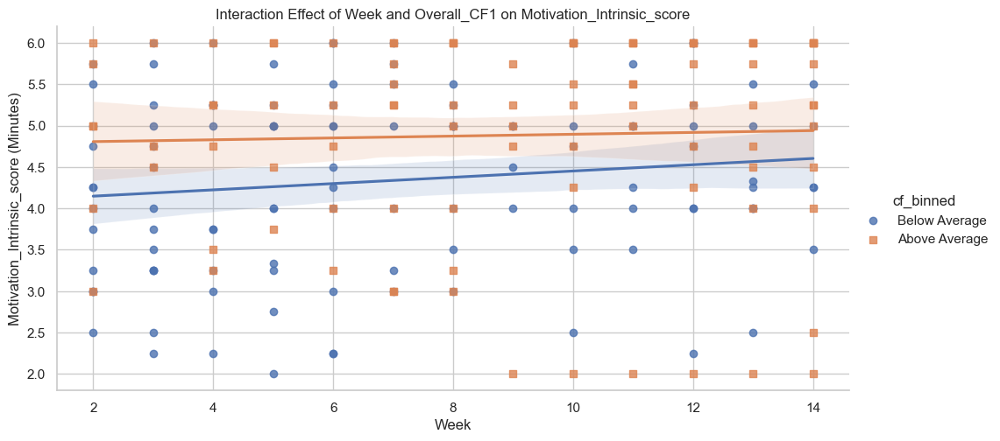

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

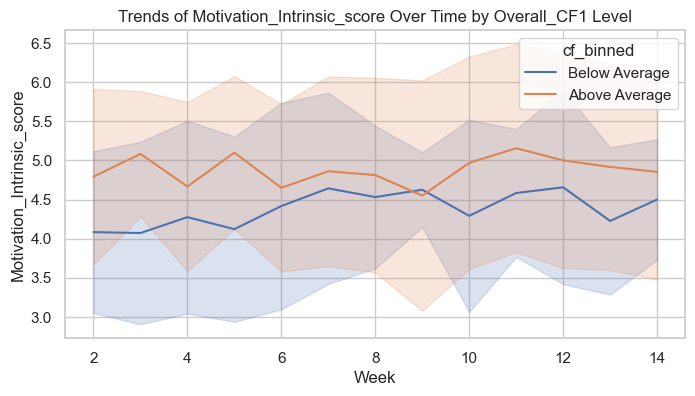

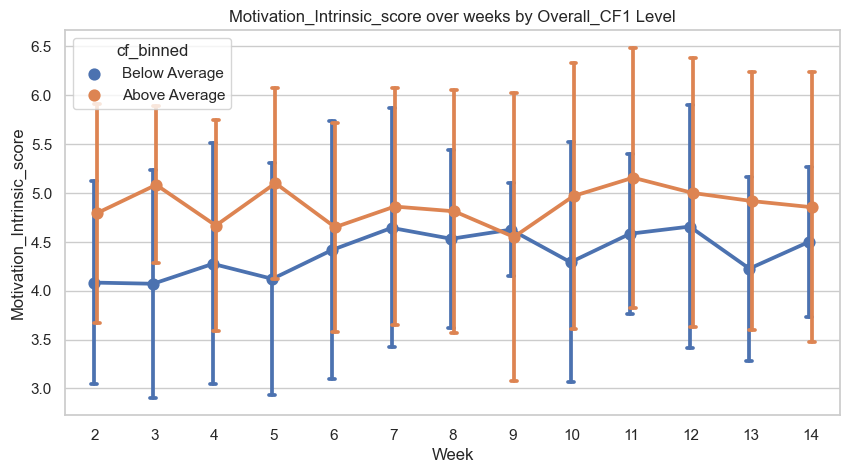


Significant correlation Overall_CF2 and Motivation_Intrinsic_score: corr=0.2139, p=0.0022
Significant regression for Overall_CF2 predicting Motivation_Intrinsic_score: p-value=0.0478
                                OLS Regression Results                                
Dep. Variable:     Motivation_Intrinsic_score   R-squared:                       0.039
Model:                                    OLS   Adj. R-squared:                  0.029
Method:                         Least Squares   F-statistic:                     4.027
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):             0.0193
Time:                                14:11:11   Log-Likelihood:                -311.94
No. Observations:                         202   AIC:                             629.9
Df Residuals:                             199   BIC:                             639.8
Df Model:                                   2                                         
Covariance Type:                 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

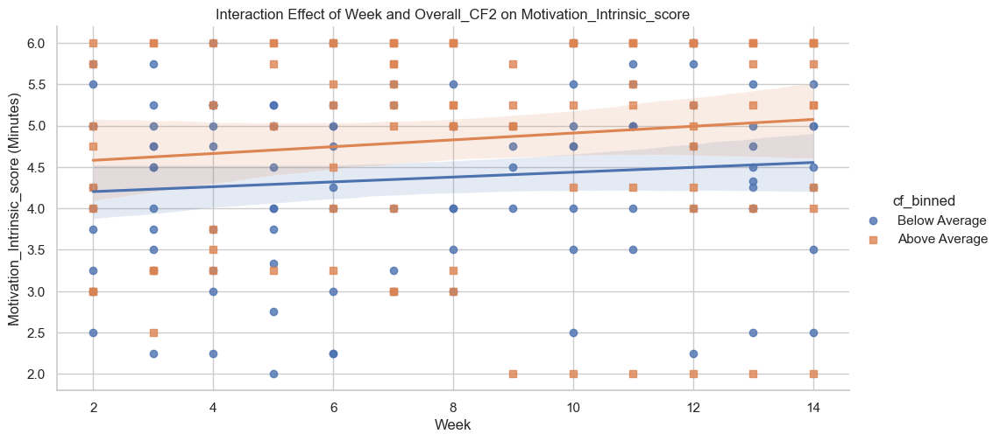

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

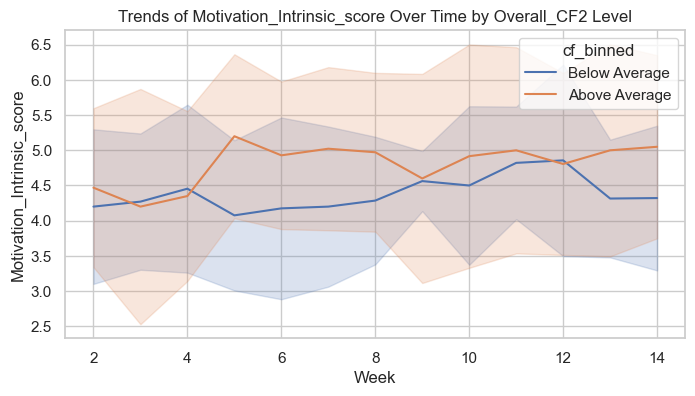

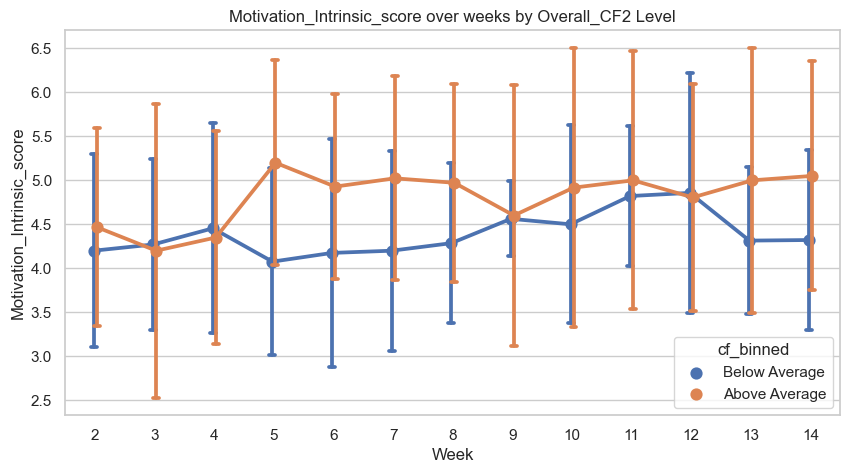


Significant Results found for Motivation_Intrinsic_score:
                   Mixed Linear Model Regression Results
Model:              MixedLM  Dependent Variable:  Motivation_Intrinsic_score
No. Observations:   202      Method:              REML                      
No. Groups:         18       Scale:               0.2432                    
Min. group size:    2        Log-Likelihood:      -180.3139                 
Max. group size:    13       Converged:           Yes                       
Mean group size:    11.2                                                    
----------------------------------------------------------------------------
                                    Coef. Std.Err.   z   P>|z| [0.025 0.975]
----------------------------------------------------------------------------
Intercept                           1.739    0.755 2.304 0.021  0.260  3.218
Week                                0.038    0.009 4.170 0.000  0.020  0.056
baseline_Motivation_Intrinsic_score 0

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

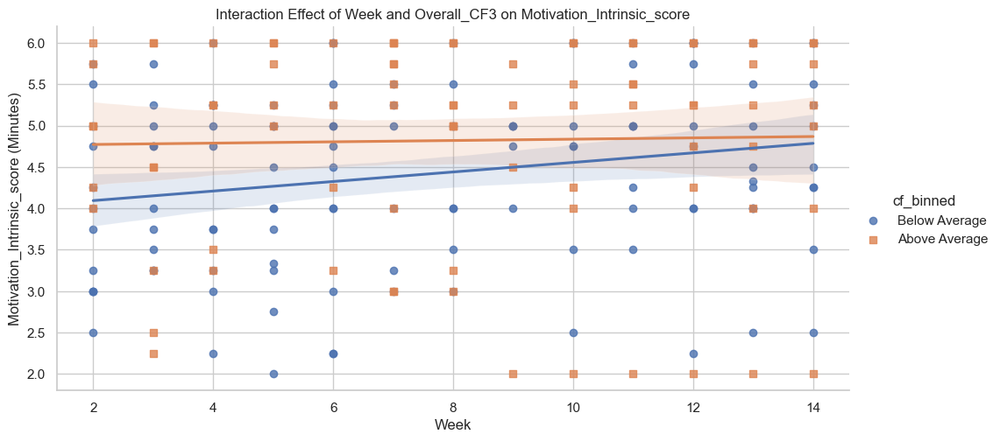

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

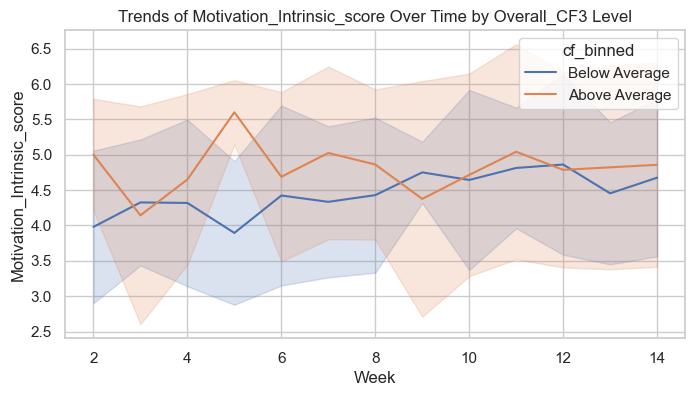

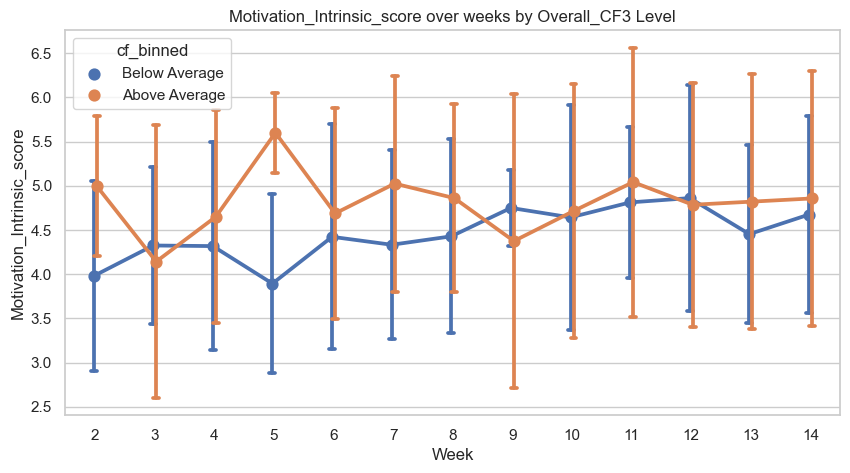


Significant correlation Overall_CF_potency_score and Motivation_Intrinsic_score: corr=0.1592, p=0.0007
Significant regression for Overall_CF_potency_score predicting Motivation_Intrinsic_score: p-value=0.0007
                                OLS Regression Results                                
Dep. Variable:     Motivation_Intrinsic_score   R-squared:                       0.043
Model:                                    OLS   Adj. R-squared:                  0.039
Method:                         Least Squares   F-statistic:                     9.990
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):           5.70e-05
Time:                                14:11:13   Log-Likelihood:                -738.07
No. Observations:                         450   AIC:                             1482.
Df Residuals:                             447   BIC:                             1494.
Df Model:                                   2                                         
Covaria

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

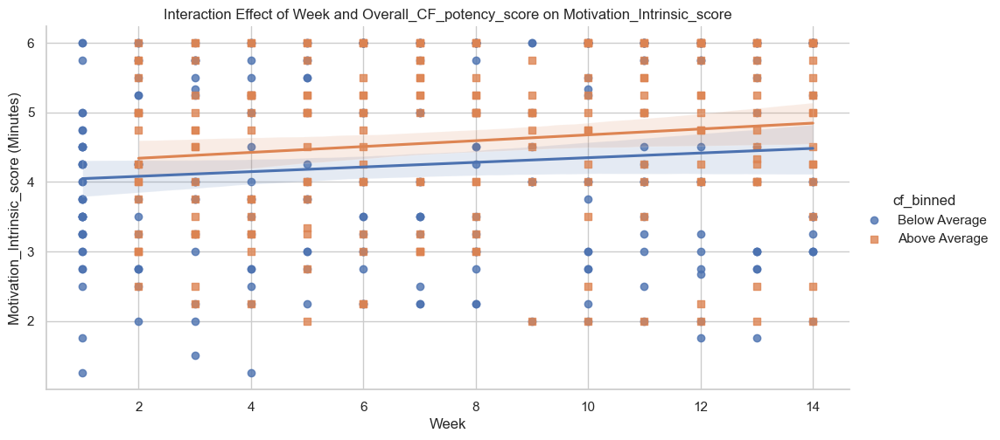

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

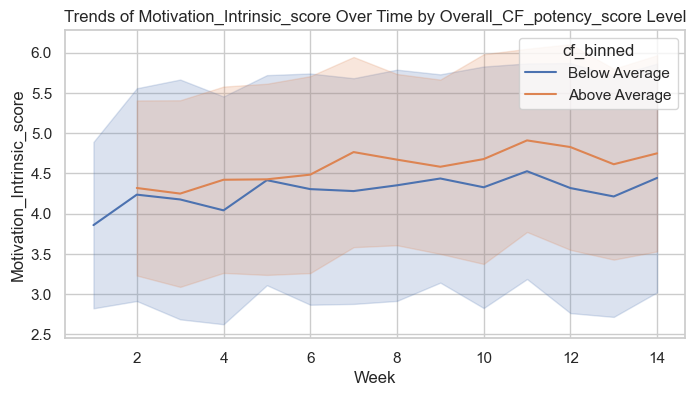

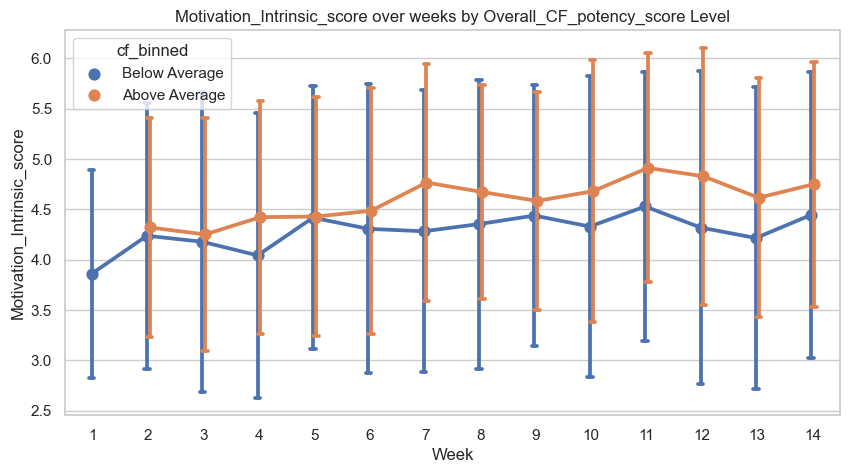


Significant correlation Overall_CF_Intention and Motivation_Intrinsic_score: corr=0.2150, p=0.0021
Significant regression for Overall_CF_Intention predicting Motivation_Intrinsic_score: p-value=0.1284
                                OLS Regression Results                                
Dep. Variable:     Motivation_Intrinsic_score   R-squared:                       0.031
Model:                                    OLS   Adj. R-squared:                  0.021
Method:                         Least Squares   F-statistic:                     3.193
Date:                        Mon, 30 Sep 2024   Prob (F-statistic):             0.0432
Time:                                14:11:14   Log-Likelihood:                -312.76
No. Observations:                         202   AIC:                             631.5
Df Residuals:                             199   BIC:                             641.4
Df Model:                                   2                                         
Covariance Type

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

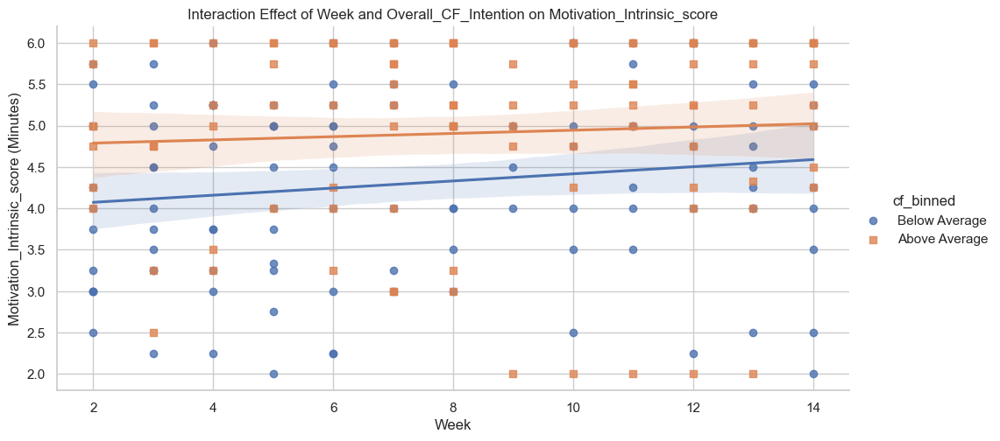

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

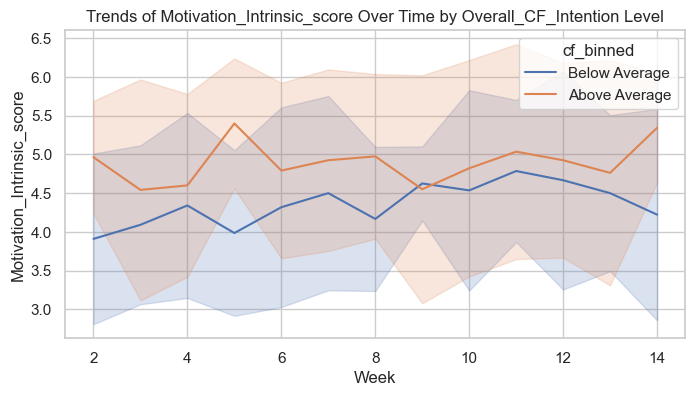

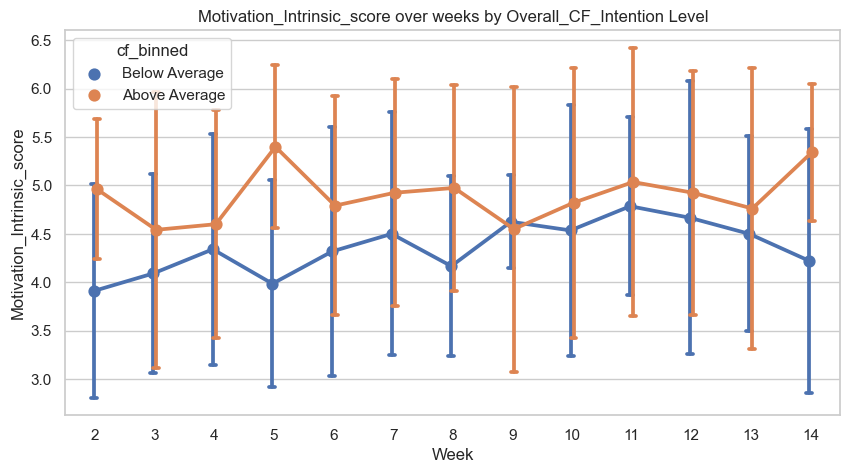


Effects of CF_columns on Motivation_Intrinsic_score (sorted by effect size):
CF_column: Overall_CF1, Coefficient: 0.2802, p-value: 0.0002
CF_column: Overall_CF2, Coefficient: 0.1566, p-value: 0.0478
CF_column: Overall_CF_Intention, Coefficient: 0.1297, p-value: 0.1284
CF_column: Overall_CF3, Coefficient: 0.0880, p-value: 0.1904
CF_column: Overall_CF_potency_score, Coefficient: 0.0107, p-value: 0.0007
-------------------------------------------------- 



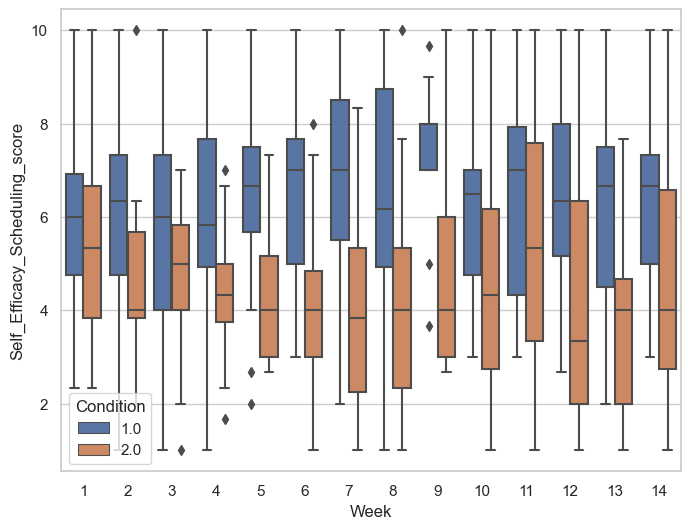

Week 4 Diference between CF & Control Groups: p-value = 0.0336
Week 4 Diference between CF & Control Groups: p-value = 0.0336
Week 5 Diference between CF & Control Groups: p-value = 0.0035
Week 4 Diference between CF & Control Groups: p-value = 0.0336
Week 5 Diference between CF & Control Groups: p-value = 0.0035
Week 6 Diference between CF & Control Groups: p-value = 0.0007
Week 4 Diference between CF & Control Groups: p-value = 0.0336
Week 5 Diference between CF & Control Groups: p-value = 0.0035
Week 6 Diference between CF & Control Groups: p-value = 0.0007
Week 7 Diference between CF & Control Groups: p-value = 0.0025
Week 4 Diference between CF & Control Groups: p-value = 0.0336
Week 5 Diference between CF & Control Groups: p-value = 0.0035
Week 6 Diference between CF & Control Groups: p-value = 0.0007
Week 7 Diference between CF & Control Groups: p-value = 0.0025
Week 8 Diference between CF & Control Groups: p-value = 0.0178
Week 4 Diference between CF & Control Groups: p-value =

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

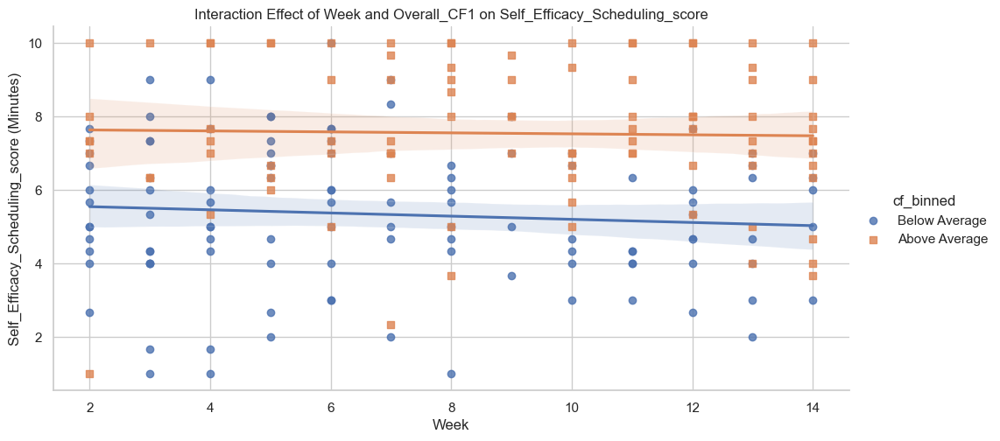

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

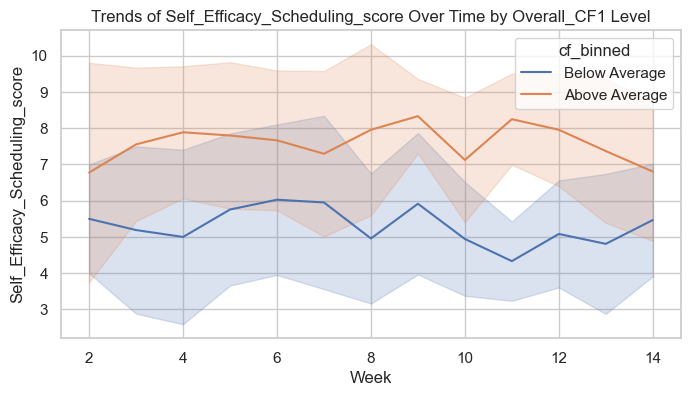

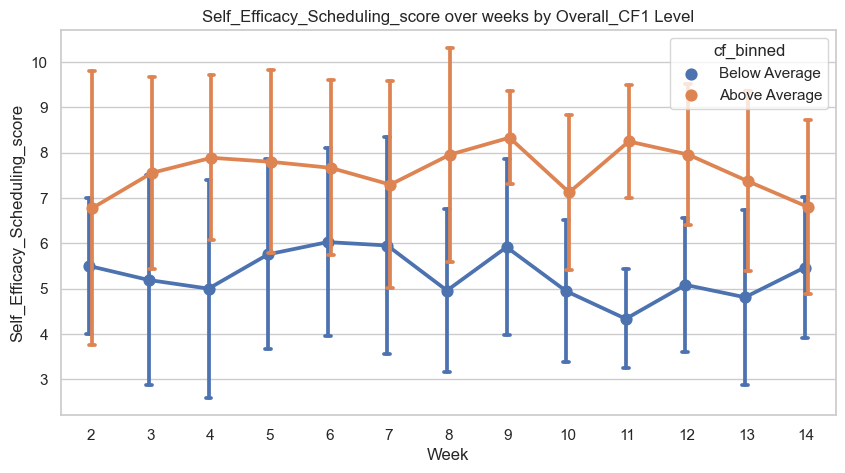


Significant correlation Overall_CF2 and Self_Efficacy_Scheduling_score: corr=0.5363, p=0.0000
Significant regression for Overall_CF2 predicting Self_Efficacy_Scheduling_score: p-value=0.0000
                                  OLS Regression Results                                  
Dep. Variable:     Self_Efficacy_Scheduling_score   R-squared:                       0.304
Model:                                        OLS   Adj. R-squared:                  0.297
Method:                             Least Squares   F-statistic:                     43.44
Date:                            Mon, 30 Sep 2024   Prob (F-statistic):           2.22e-16
Time:                                    14:11:16   Log-Likelihood:                -408.61
No. Observations:                             202   AIC:                             823.2
Df Residuals:                                 199   BIC:                             833.2
Df Model:                                       2                               

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

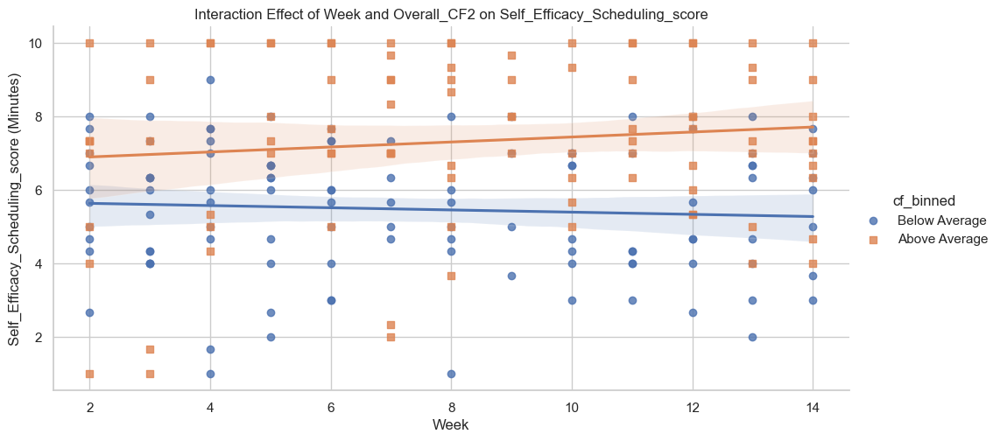

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

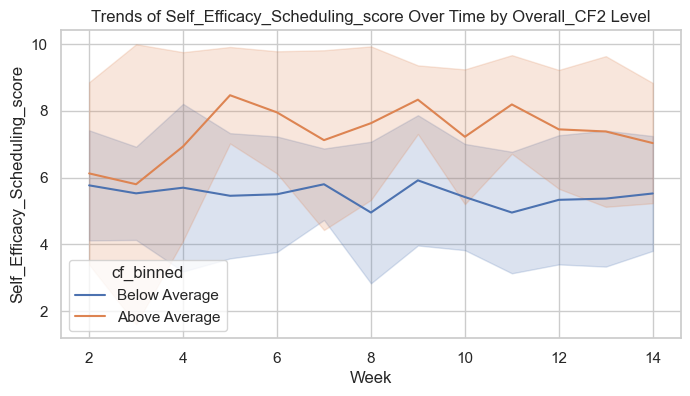

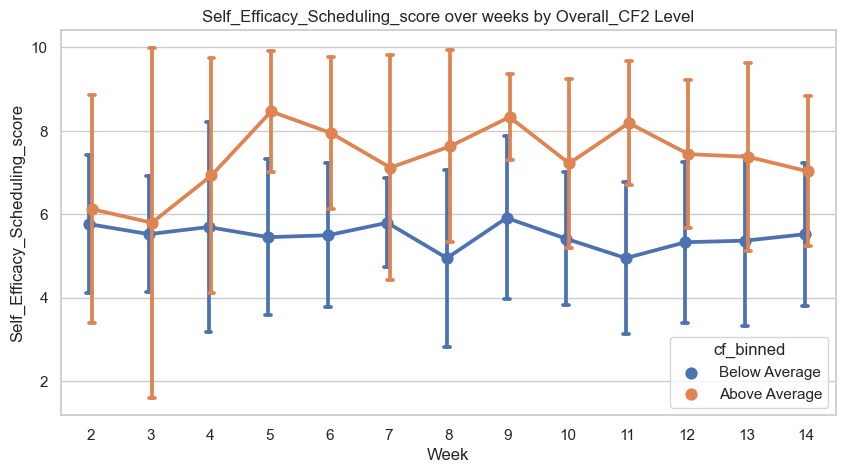


Significant correlation Overall_CF3 and Self_Efficacy_Scheduling_score: corr=0.4487, p=0.0000
Significant regression for Overall_CF3 predicting Self_Efficacy_Scheduling_score: p-value=0.0000
                                  OLS Regression Results                                  
Dep. Variable:     Self_Efficacy_Scheduling_score   R-squared:                       0.206
Model:                                        OLS   Adj. R-squared:                  0.198
Method:                             Least Squares   F-statistic:                     25.79
Date:                            Mon, 30 Sep 2024   Prob (F-statistic):           1.10e-10
Time:                                    14:11:17   Log-Likelihood:                -421.92
No. Observations:                             202   AIC:                             849.8
Df Residuals:                                 199   BIC:                             859.8
Df Model:                                       2                               

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

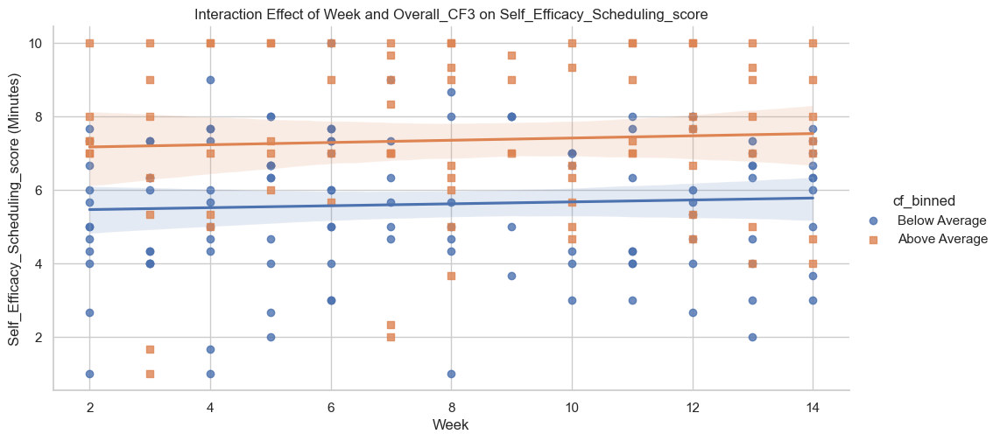

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

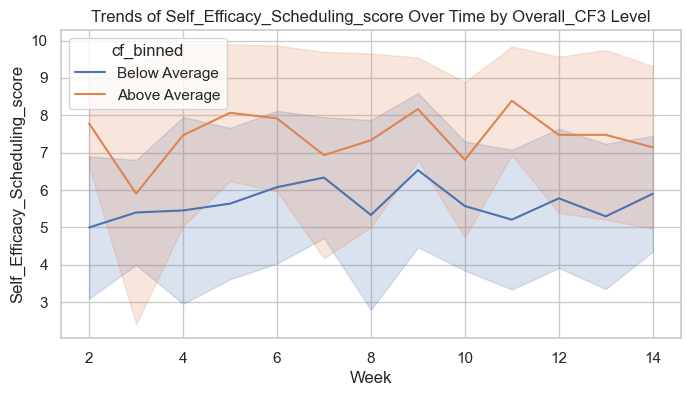

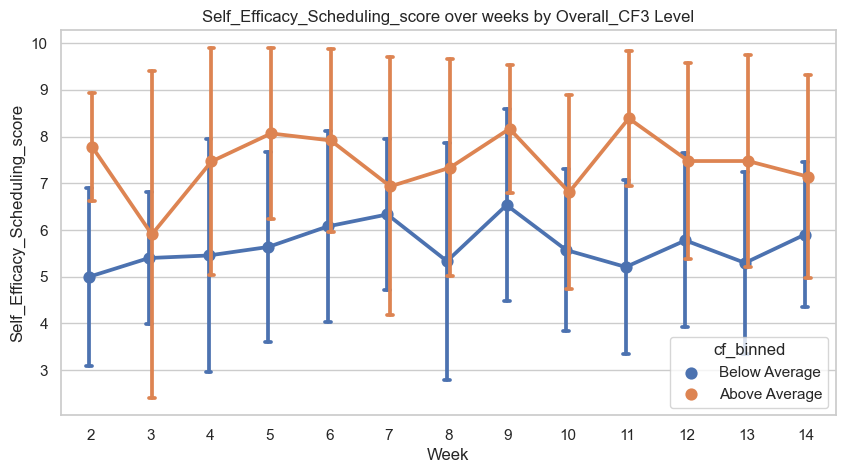


Significant correlation Overall_CF_potency_score and Self_Efficacy_Scheduling_score: corr=0.4531, p=0.0000
Significant regression for Overall_CF_potency_score predicting Self_Efficacy_Scheduling_score: p-value=0.0000
                                  OLS Regression Results                                  
Dep. Variable:     Self_Efficacy_Scheduling_score   R-squared:                       0.228
Model:                                        OLS   Adj. R-squared:                  0.225
Method:                             Least Squares   F-statistic:                     66.33
Date:                            Mon, 30 Sep 2024   Prob (F-statistic):           5.87e-26
Time:                                    14:11:18   Log-Likelihood:                -963.74
No. Observations:                             451   AIC:                             1933.
Df Residuals:                                 448   BIC:                             1946.
Df Model:                                       2     

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

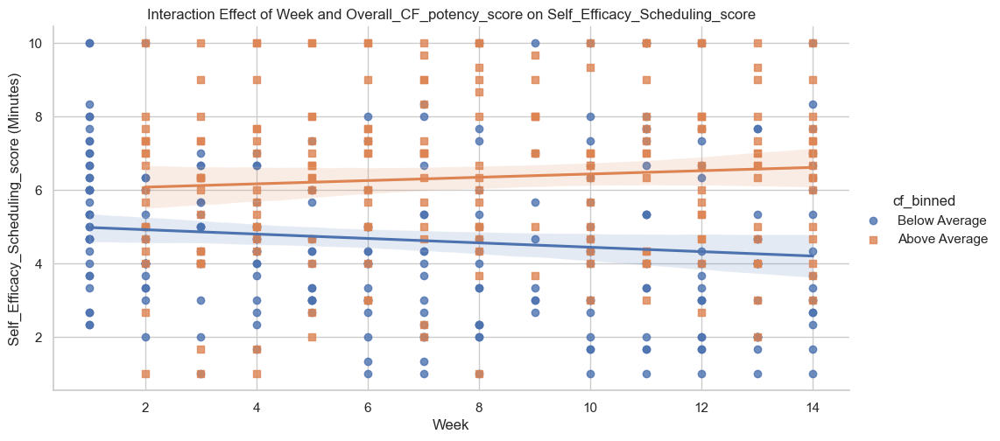

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

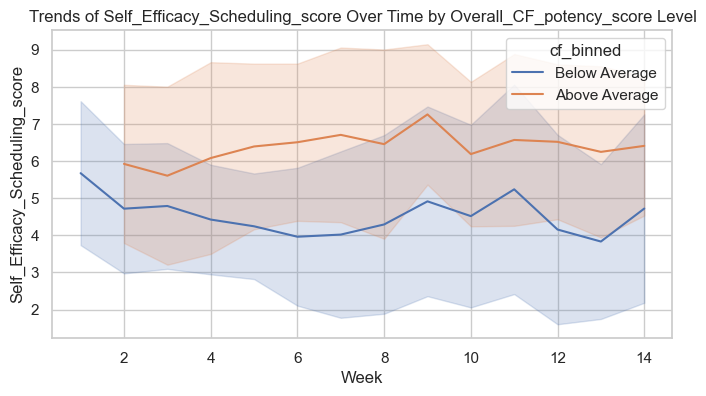

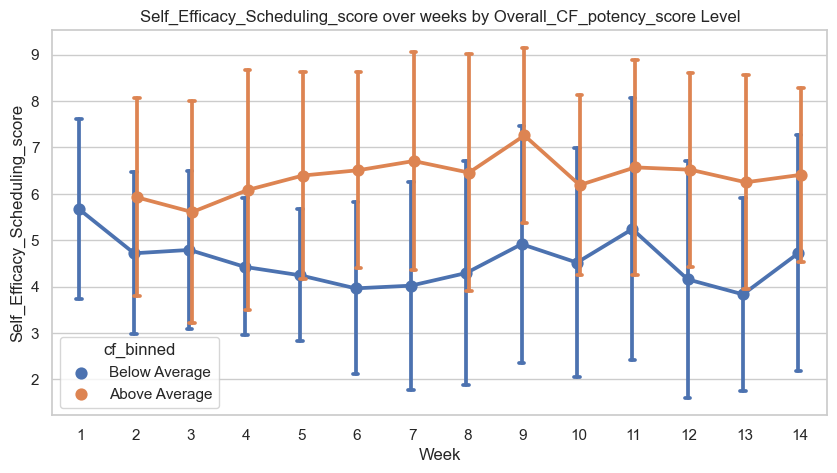


Significant correlation Overall_CF_Intention and Self_Efficacy_Scheduling_score: corr=0.5733, p=0.0000
Significant regression for Overall_CF_Intention predicting Self_Efficacy_Scheduling_score: p-value=0.0000
                                  OLS Regression Results                                  
Dep. Variable:     Self_Efficacy_Scheduling_score   R-squared:                       0.305
Model:                                        OLS   Adj. R-squared:                  0.298
Method:                             Least Squares   F-statistic:                     43.73
Date:                            Mon, 30 Sep 2024   Prob (F-statistic):           1.81e-16
Time:                                    14:11:18   Log-Likelihood:                -408.41
No. Observations:                             202   AIC:                             822.8
Df Residuals:                                 199   BIC:                             832.7
Df Model:                                       2             

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

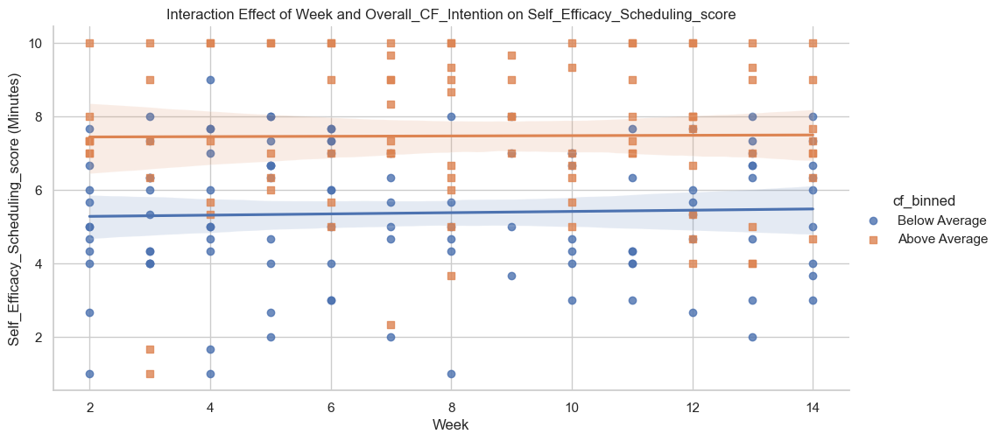

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

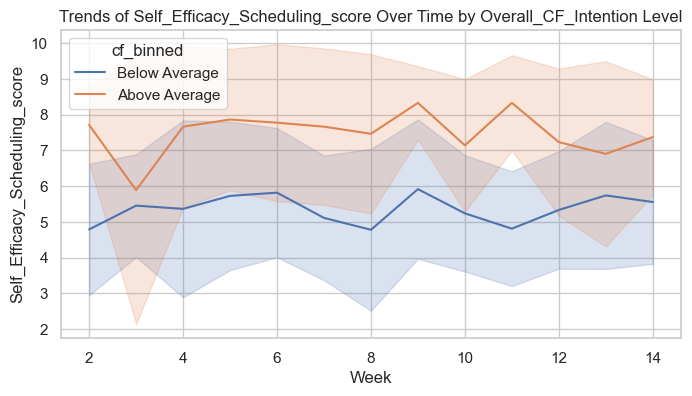

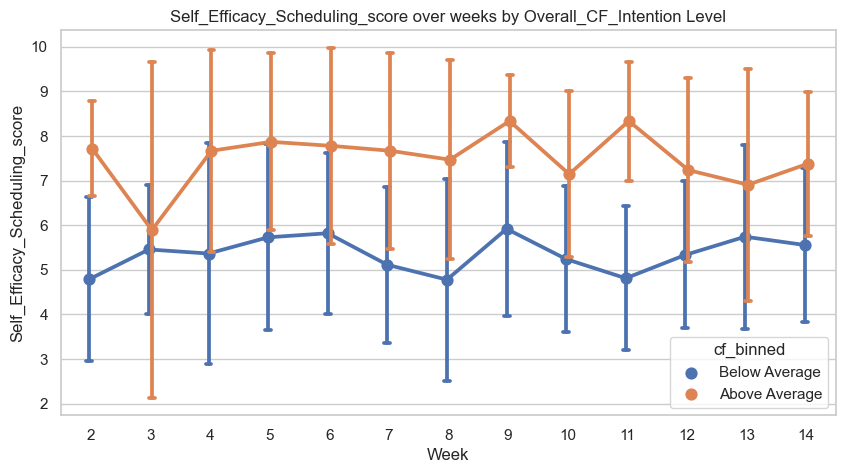


Effects of CF_columns on Self_Efficacy_Scheduling_score (sorted by effect size):
CF_column: Overall_CF_Intention, Coefficient: 1.2631, p-value: 0.0000
CF_column: Overall_CF1, Coefficient: 1.1705, p-value: 0.0000
CF_column: Overall_CF2, Coefficient: 1.1704, p-value: 0.0000
CF_column: Overall_CF3, Coefficient: 0.8124, p-value: 0.0000
CF_column: Overall_CF_potency_score, Coefficient: 0.0596, p-value: 0.0000
-------------------------------------------------- 



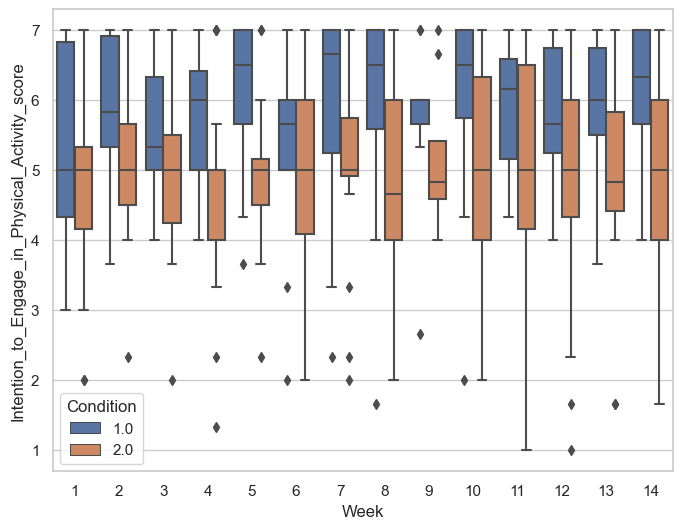

Week 2 Diference between CF & Control Groups: p-value = 0.0142
Week 1 Different to Base for Experimental: p-value = 0.0371
Week 2 Diference between CF & Control Groups: p-value = 0.0142
Week 1 Different to Base for Experimental: p-value = 0.0371
Week 2 Diference between CF & Control Groups: p-value = 0.0142
Week 4 Diference between CF & Control Groups: p-value = 0.0192
Week 1 Different to Base for Experimental: p-value = 0.0371
Week 2 Diference between CF & Control Groups: p-value = 0.0142
Week 4 Diference between CF & Control Groups: p-value = 0.0192
Week 5 Diference between CF & Control Groups: p-value = 0.0045
Week 1 Different to Base for Experimental: p-value = 0.0371
Week 2 Diference between CF & Control Groups: p-value = 0.0142
Week 4 Diference between CF & Control Groups: p-value = 0.0192
Week 5 Diference between CF & Control Groups: p-value = 0.0045
Week 1 Different to Base for Experimental: p-value = 0.0371
Week 2 Diference between CF & Control Groups: p-value = 0.0142
Week 4 

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

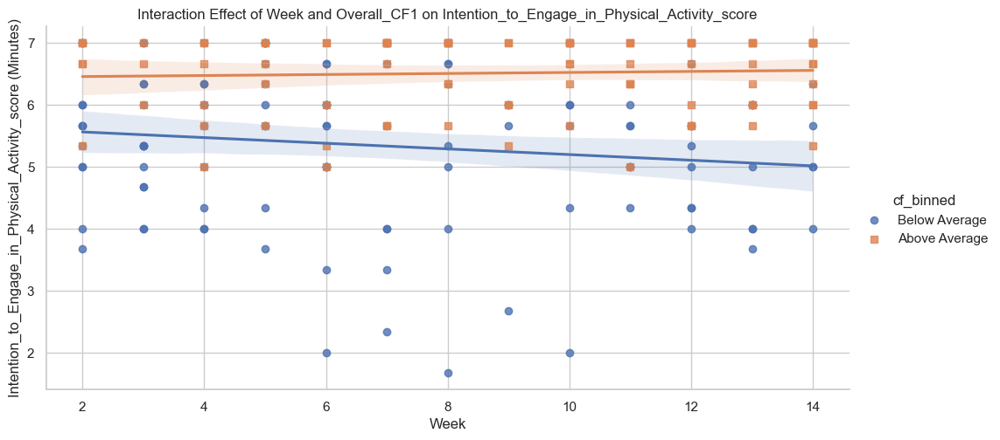

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

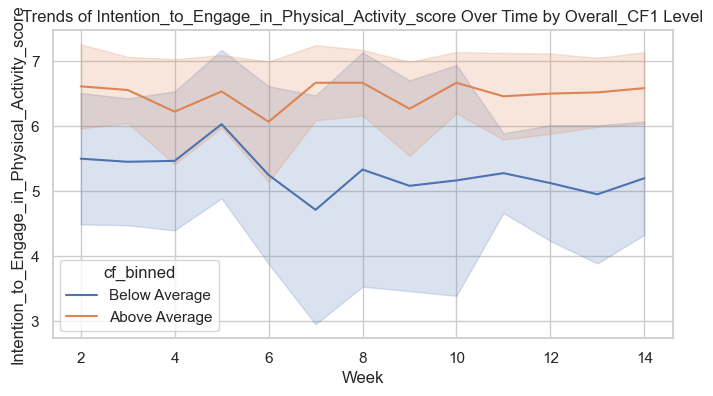

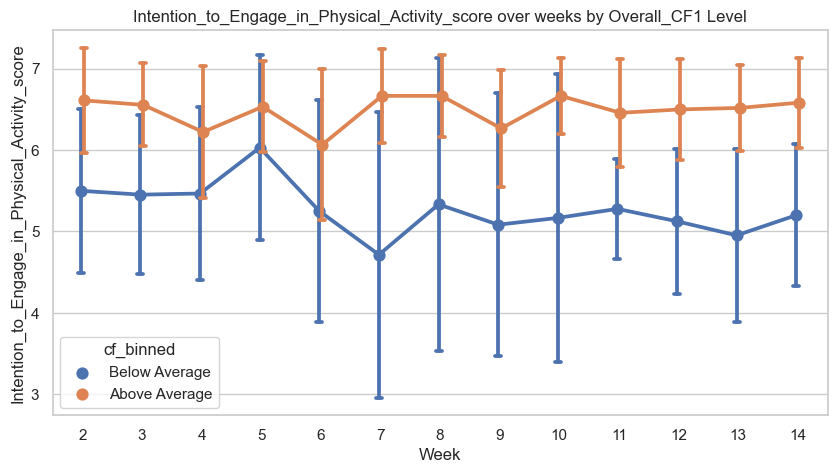


Significant correlation Overall_CF2 and Intention_to_Engage_in_Physical_Activity_score: corr=0.5054, p=0.0000
Significant regression for Overall_CF2 predicting Intention_to_Engage_in_Physical_Activity_score: p-value=0.0000
                                          OLS Regression Results                                          
Dep. Variable:     Intention_to_Engage_in_Physical_Activity_score   R-squared:                       0.194
Model:                                                        OLS   Adj. R-squared:                  0.186
Method:                                             Least Squares   F-statistic:                     23.98
Date:                                            Mon, 30 Sep 2024   Prob (F-statistic):           4.69e-10
Time:                                                    14:11:20   Log-Likelihood:                -291.09
No. Observations:                                             202   AIC:                             588.2
Df Residuals:              

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

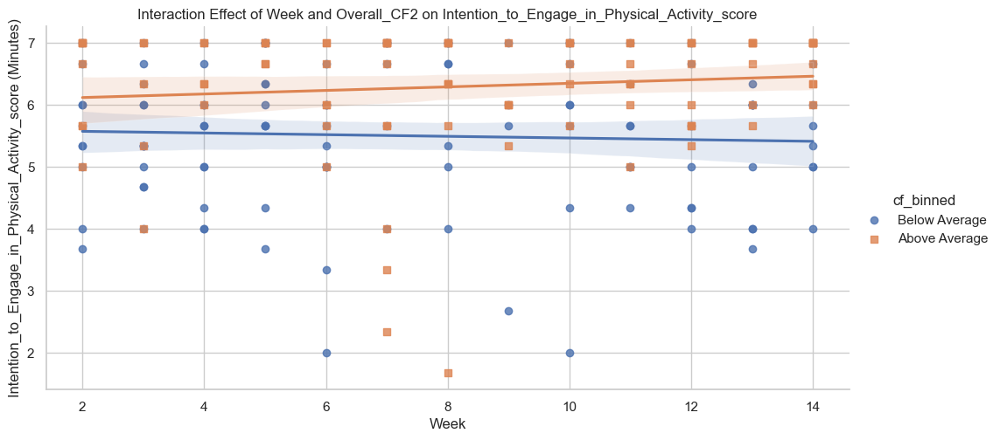

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

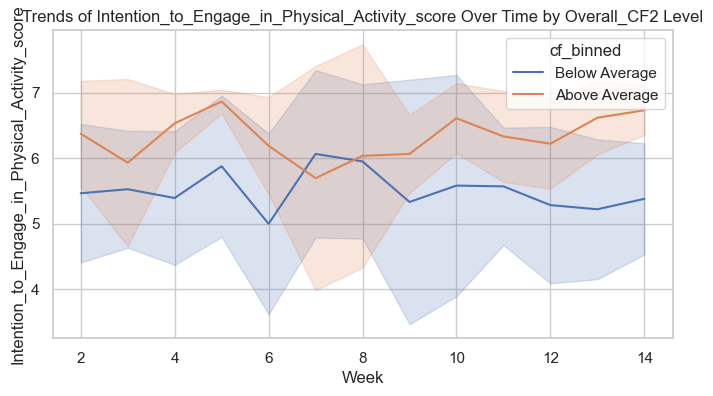

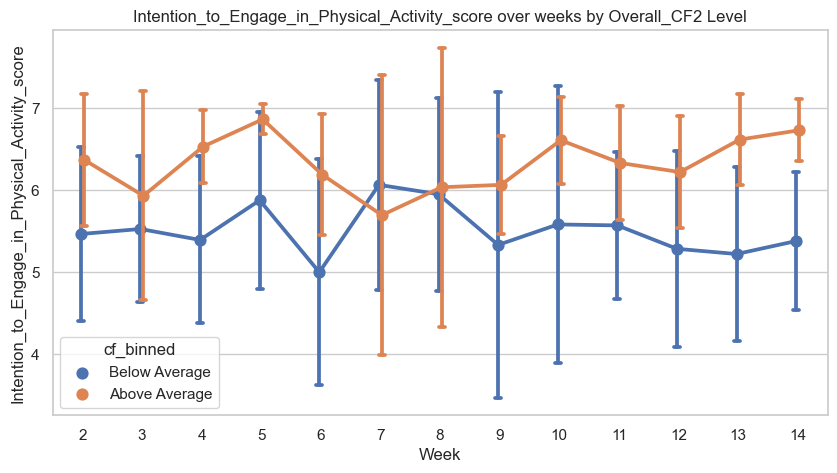


Significant correlation Overall_CF3 and Intention_to_Engage_in_Physical_Activity_score: corr=0.4516, p=0.0000
Significant regression for Overall_CF3 predicting Intention_to_Engage_in_Physical_Activity_score: p-value=0.0000
                                          OLS Regression Results                                          
Dep. Variable:     Intention_to_Engage_in_Physical_Activity_score   R-squared:                       0.169
Model:                                                        OLS   Adj. R-squared:                  0.161
Method:                                             Least Squares   F-statistic:                     20.30
Date:                                            Mon, 30 Sep 2024   Prob (F-statistic):           9.46e-09
Time:                                                    14:11:21   Log-Likelihood:                -294.14
No. Observations:                                             202   AIC:                             594.3
Df Residuals:              

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

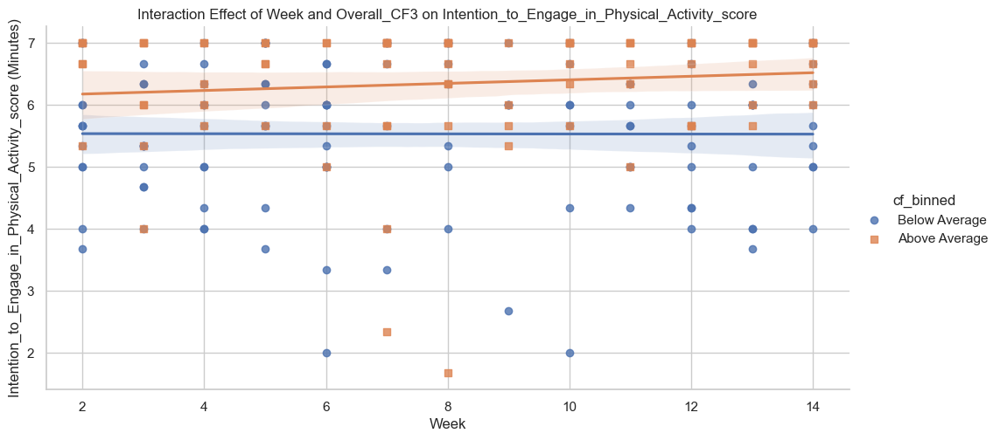

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

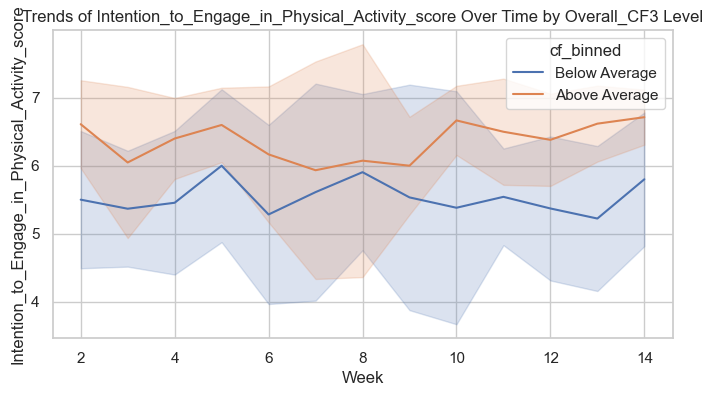

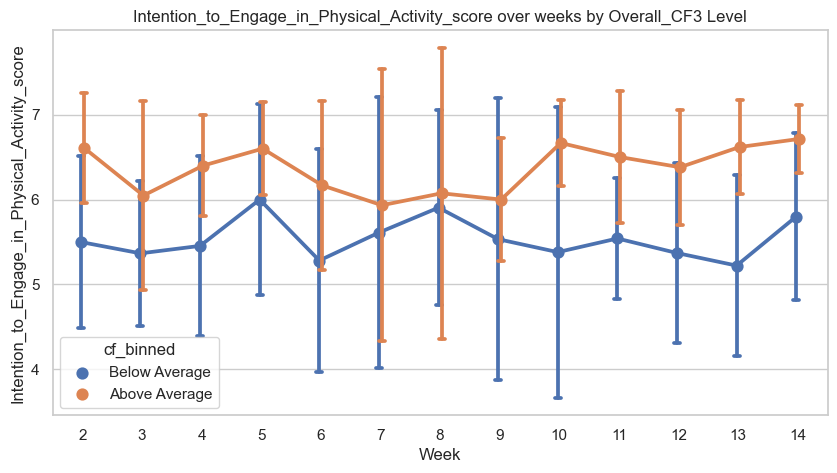


Significant correlation Overall_CF_potency_score and Intention_to_Engage_in_Physical_Activity_score: corr=0.4461, p=0.0000
Significant regression for Overall_CF_potency_score predicting Intention_to_Engage_in_Physical_Activity_score: p-value=0.0000
                                          OLS Regression Results                                          
Dep. Variable:     Intention_to_Engage_in_Physical_Activity_score   R-squared:                       0.186
Model:                                                        OLS   Adj. R-squared:                  0.182
Method:                                             Least Squares   F-statistic:                     51.05
Date:                                            Mon, 30 Sep 2024   Prob (F-statistic):           1.08e-20
Time:                                                    14:11:22   Log-Likelihood:                -743.22
No. Observations:                                             450   AIC:                             1492.
D

/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


<Figure size 1000x500 with 0 Axes>

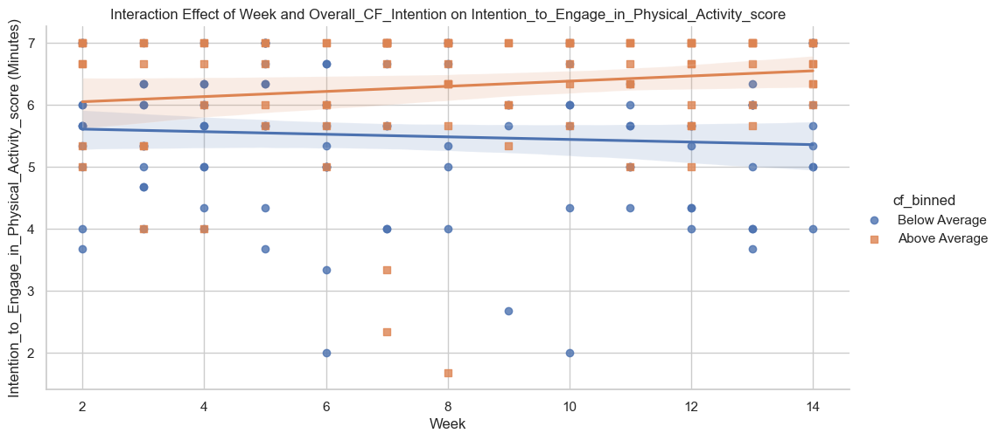

/var/folders/zx/wy99c06540n6q85dj4866rx00000gn/T/ipykernel_46651/2231606914.py:111: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):
/Users/mahsanabbasi/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1057: FutureWarning: The default of observed=False is deprecated and will be changed to True in 

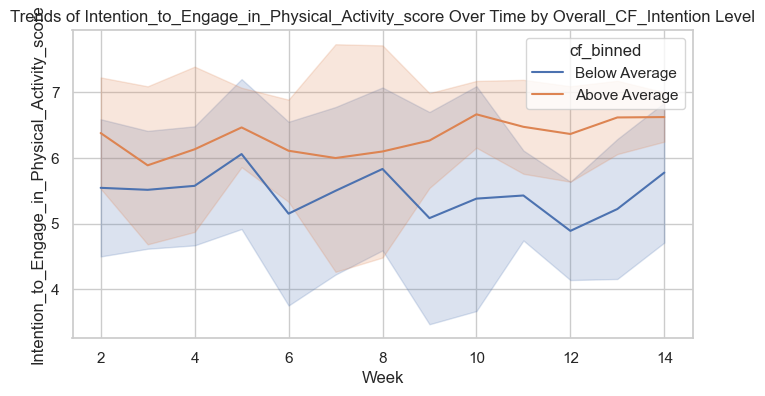

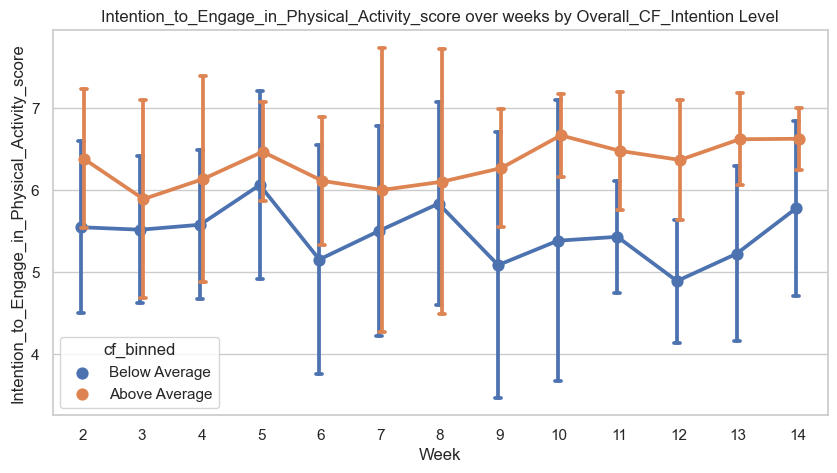


Effects of CF_columns on Intention_to_Engage_in_Physical_Activity_score (sorted by effect size):
CF_column: Overall_CF_Intention, Coefficient: 0.5071, p-value: 0.0000
CF_column: Overall_CF1, Coefficient: 0.4890, p-value: 0.0000
CF_column: Overall_CF2, Coefficient: 0.4859, p-value: 0.0000
CF_column: Overall_CF3, Coefficient: 0.3841, p-value: 0.0000
CF_column: Overall_CF_potency_score, Coefficient: 0.0320, p-value: 0.0000
-------------------------------------------------- 



In [26]:
######## Hypothesis 4: Counterfactual Impact on Survey Scores & Comparison of Survey Scores over Weeks between Groups
def run_spearman_correlation(df, col1, col2):
    corr, p_value = spearmanr(df[col1], df[col2])
    return corr, p_value

def check_significant_interaction(model):
    # Check if the p-value for the interaction term (Week:Condition) is significant
    for param, pvalue in model.pvalues.items():
        if "Week" in param and pvalue <= 0.9:
            return True
    return False

main_CF_columns = ['Overall_CF1','Overall_CF2','Overall_CF3','Overall_CF_potency_score','Overall_CF_Intention']
main_Survey_columns = ['Recode_of_contemplation_ladder','Self_Efficacy_Coping_score','Self_Efficacy_Task_score', 
'Motivation_Extrinsic_score', 'Motivation_Intrinsic_score','Self_Efficacy_Scheduling_score',
'Intention_to_Engage_in_Physical_Activity_score']

for survey_col in main_Survey_columns:
    df_Survey = df[['Participant_ID', 'Week', 'Condition', survey_col]].dropna()

    plt.figure(figsize=(8,6))
    sns.boxplot(x='Week', y=survey_col, 
                hue='Condition', data=df_Survey)
    plt.show()
    experimental_group = df_Survey[df_Survey['Condition'] == 1]
    control_group = df_Survey[df_Survey['Condition'] == 2]
    
    mean_experimental = experimental_group.groupby('Week')[survey_col].mean()
    mean_control = control_group.groupby('Week')[survey_col].mean()
    pre = experimental_group[experimental_group['Week'] == 1][survey_col]
    # Perform t-test for each week
    t_stats_groups = []
    p_values_groups = []
    t_stats_prepost = []
    p_values_prepost = []
    for week in range(1, 14):  # Weeks 1 to 13
        exp_week_data = experimental_group[experimental_group['Week'] == week][survey_col]
        ctrl_week_data = control_group[control_group['Week'] == week][survey_col]
        if week != 1 and len(pre)==len(exp_week_data):
            t_stat_prepost, p_value_prepost = ttest_rel(pre, exp_week_data)
            t_stats_prepost.append(t_stat_prepost)
            p_values_prepost.append(p_value_prepost)
        if len(exp_week_data) > 0 and len(ctrl_week_data) > 0:
            t_stat_groups, p_value_groups = ttest_ind(exp_week_data, ctrl_week_data, equal_var=False, nan_policy='omit')
            t_stats_groups.append(t_stat_groups)
            p_values_groups.append(p_value_groups)
        
            # Weeks with significant CF Control Differences
        for week, p_value in enumerate(p_values_groups, start=1):
            if p_value < 0.05:
                print(f'Week {week} Diference between CF & Control Groups: p-value = {p_value:.4f}')
                
            # Weeks with significant Pre Post Differences for CF Group
        for week, p_value in enumerate(p_values_prepost, start=1):
            if p_value < 0.05:
                print(f'Week {week} Different to Base for Experimental: p-value = {p_value:.4f}')
        
    effect_results = []
    for cf_col in main_CF_columns:
        df_survey_baseline = df_Survey[df_Survey['Week'] == 1][['Participant_ID', survey_col]].rename(columns={survey_col: 'baseline_' + survey_col})
        df_CF_Survey = df[['Participant_ID', 'Week', 'Condition', survey_col, cf_col]].dropna()

        # Merge baseline with the main dataframe
        df_CF_Survey = df_CF_Survey.merge(df_survey_baseline, on='Participant_ID')
        corr, p_value = run_spearman_correlation(df_CF_Survey, cf_col, survey_col)
        
        X = df_CF_Survey[[cf_col , 'Week']]
        #X['CF1_Week_Interaction'] = X[cf_col] * X['Week']
        X = sm.add_constant(X)
        y = df_CF_Survey[survey_col]
        model = sm.OLS(y, X).fit()
        
        # Collect the effect size and p-values
        cf_coef = model.params[cf_col]  
        cf_p_value = model.pvalues[cf_col]  
        effect_results.append((cf_col, cf_coef, cf_p_value))
        
        if p_value < 0.05 or cf_p_value < 0.05:
            print(f"\nSignificant correlation {cf_col} and {survey_col}: corr={corr:.4f}, p={p_value:.4f}")
            print(f"Significant regression for {cf_col} predicting {survey_col}: p-value={model.pvalues[cf_col]:.4f}")

            print(model.summary())
            
        fixed_effects=['Week', 'Condition'] #+{'baseline_' + survey_col}
        random_effect_col='Participant_ID'

    #     formula = f"{survey_col} ~ {' * '.join(fixed_effects)}"
        formula = f"{survey_col} ~ Week +{'baseline_' + survey_col}+ {cf_col}" #+Week:Condition:{'baseline_' + survey_col}
        model = smf.mixedlm(formula, df_CF_Survey, groups=df_CF_Survey[random_effect_col]).fit()

        
        if check_significant_interaction(model):
            print(f"\nSignificant Results found for {survey_col}:")
            print(model.summary())
            # Define bins and labels
            bins = [-float('inf'), df_CF_Survey[cf_col].median(), float('inf')]
            labels = ["Below Average", "Above Average"]
            # Create the binned column
            df_CF_Survey['cf_binned'] = pd.cut(df_CF_Survey[cf_col], bins=bins, labels=labels)
            # Interaction plot
            plt.figure(figsize=(10, 5))
            sns.lmplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, aspect=2, markers=["o", "s"])
            plt.title(f'Interaction Effect of Week and {cf_col} on {survey_col}')
            plt.xlabel('Week')
            plt.ylabel(f'{survey_col} (Minutes)')
            plt.show()
            # Plot the trends over time for each group
            sns.set(style="whitegrid")

            plt.figure(figsize=(8, 4))
            sns.lineplot(x='Week', y=survey_col, hue='cf_binned', data=df_CF_Survey, ci="sd")
            plt.title(f'Trends of {survey_col} Over Time by {cf_col} Level')
            plt.xlabel('Week')
            plt.ylabel(survey_col)
            plt.show()
#             # Fit repeated measures ANOVA
#             rm_anova = pg.mixed_anova(dv=survey_col, 
#                                    within='Week', 
#                                    subject='Participant_ID', 
#                                    between='cf_binned', 
#                                    data=df_CF_Survey, effsize='ng2')
#             # Filter the rm_anova results to show only the relevant columns
#             important_columns = ['Source', 'F', 'p-unc', 'ng2']  # Only show Source, F-value, p-value, and effect size (η²)
#             print(rm_anova[important_columns].round(3))
            plt.figure(figsize=(10, 5))
            sns.pointplot(data=df_CF_Survey, x='Week', y=survey_col, hue='cf_binned', dodge=True, capsize=.1, errorbar='sd')
            _ = plt.title(f'{survey_col} over weeks by {cf_col} Level')
            plt.show()
            
    # Sort the collected results by the absolute value of the coefficient (effect size)
    effect_results_sorted = sorted(effect_results, key=lambda x: abs(x[1]), reverse=True)

    # Display the sorted effects for the current survey column
    print(f"\nEffects of CF_columns on {survey_col} (sorted by effect size):")
    for cf_col, coef, p_value in effect_results_sorted:
        print(f"CF_column: {cf_col}, Coefficient: {coef:.4f}, p-value: {p_value:.4f}")
    print("-" * 50 , '\n')
    

In [17]:
######### Hypothesis 3: Comparison of Self-Efficacy Scores
df_CF_Survey
#df_CF_Survey[df_CF_Survey['Week'] == 1][['Participant_ID', survey_col]].rename(columns={survey_col: 'baseline_' + survey_col})


,Participant_ID,Week,Condition,Recode_of_contemplation_ladder,Potency_score_for_CF3,baseline_Recode_of_contemplation_ladder
0,1,1,1.0,5.0,0.0,5.0
1,1,2,1.0,8.0,49.0,5.0
2,1,3,1.0,8.0,35.0,5.0
3,1,4,1.0,5.0,28.0,5.0
4,1,5,1.0,8.0,25.0,5.0
...,...,...,...,...,...,...
444,41,5,1.0,9.0,42.0,6.0
445,41,6,1.0,9.0,30.0,6.0
446,41,7,1.0,10.0,49.0,6.0
447,41,8,1.0,10.0,35.0,6.0


In [86]:
model4.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                                        Mixed Linear Model Regression Results
======================================================================================================================
Model:                      MixedLM         Dependent Variable:         Intention_to_Engage_in_Physical_Activity_score
No. Observations:           450             Method:                     ML                                            
No. Groups:                 37              Scale:                      0.5415                                        
Min. group size:            3               Log-Likelihood:             -557.9145                                     
Max. group size:            14              Converged:                  Yes                                           
Mean group size:            12.2                                                                                      
----------------------------------------------------------------------------------------------------------------------
                                                                            Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------------------------------------------------
Intercept                                                                    2.971    0.609  4.880 0.000  1.778  4.164
Condition[T.2.0]                                                            -0.383    0.215 -1.785 0.074 -0.804  0.038
baseline_Intention_to_Engage_in_Physical_Activity_score                      0.574    0.082  7.010 0.000  0.414  0.735
Week                                                                         0.249    0.087  2.873 0.004  0.079  0.419
Week:Condition[T.2.0]                                                       -0.135    0.113 -1.197 0.231 -0.357  0.086
age                                                                         -0.011    0.011 -1.073 0.283 -0.032  0.009
Week:Condition[1.0]:baseline_Intention_to_Engage_in_Physical_Activity_score -0.041    0.016 -2.540 0.011 -0.072 -0.009
Week:Condition[2.0]:baseline_Intention_to_Engage_in_Physical_Activity_score -0.025    0.015 -1.658 0.097 -0.054  0.004
Group Var                                                                    0.220    0.134                           
Group x Week Cov                                                             0.030    0.013                           
Week Var                                                                     0.004    0.002                           
======================================================================================================================

"""

In [92]:
model4.summary()

<class 'statsmodels.iolib.summary2.Summary'>
"""
                                        Mixed Linear Model Regression Results
======================================================================================================================
Model:                      MixedLM         Dependent Variable:         Intention_to_Engage_in_Physical_Activity_score
No. Observations:           450             Method:                     ML                                            
No. Groups:                 37              Scale:                      0.5415                                        
Min. group size:            3               Log-Likelihood:             -557.9145                                     
Max. group size:            14              Converged:                  Yes                                           
Mean group size:            12.2                                                                                      
----------------------------------------------------------------------------------------------------------------------
                                                                            Coef.  Std.Err.   z    P>|z| [0.025 0.975]
----------------------------------------------------------------------------------------------------------------------
Intercept                                                                    2.971    0.609  4.880 0.000  1.778  4.164
Condition[T.2.0]                                                            -0.383    0.215 -1.785 0.074 -0.804  0.038
baseline_Intention_to_Engage_in_Physical_Activity_score                      0.574    0.082  7.010 0.000  0.414  0.735
Week                                                                         0.249    0.087  2.873 0.004  0.079  0.419
Week:Condition[T.2.0]                                                       -0.135    0.113 -1.197 0.231 -0.357  0.086
age                                                                         -0.011    0.011 -1.073 0.283 -0.032  0.009
Week:Condition[1.0]:baseline_Intention_to_Engage_in_Physical_Activity_score -0.041    0.016 -2.540 0.011 -0.072 -0.009
Week:Condition[2.0]:baseline_Intention_to_Engage_in_Physical_Activity_score -0.025    0.015 -1.658 0.097 -0.054  0.004
Group Var                                                                    0.220    0.134                           
Group x Week Cov                                                             0.030    0.013                           
Week Var                                                                     0.004    0.002                           
======================================================================================================================

"""